**Chapter 18 – Reinforcement Learning**

# Setup

First, let's import a few common modules, ensure MatplotLib plots figures inline and prepare a function to save the figures. We also check that Python 3.5 or later is installed (although Python 2.x may work, it is deprecated so we strongly recommend you use Python 3 instead), as well as Scikit-Learn ≥0.20 and TensorFlow ≥2.0.

In [1]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os

# to make this notebook's output stable across runs
np.random.seed(42)
tf.random.set_seed(42)

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')

# Introduction to OpenAI gym

In this notebook we will be using [OpenAI gym](https://gym.openai.com/), a great toolkit for developing and comparing Reinforcement Learning algorithms. It provides many environments for your learning *agents* to interact with. Let's start by importing `gym`:

In [2]:
import gym

Let's list all the available environments:

In [3]:
gym.envs.registry.all()

dict_values([EnvSpec(Copy-v0), EnvSpec(RepeatCopy-v0), EnvSpec(ReversedAddition-v0), EnvSpec(ReversedAddition3-v0), EnvSpec(DuplicatedInput-v0), EnvSpec(Reverse-v0), EnvSpec(CartPole-v0), EnvSpec(CartPole-v1), EnvSpec(MountainCar-v0), EnvSpec(MountainCarContinuous-v0), EnvSpec(Pendulum-v0), EnvSpec(Acrobot-v1), EnvSpec(LunarLander-v2), EnvSpec(LunarLanderContinuous-v2), EnvSpec(BipedalWalker-v3), EnvSpec(BipedalWalkerHardcore-v3), EnvSpec(CarRacing-v0), EnvSpec(Blackjack-v0), EnvSpec(KellyCoinflip-v0), EnvSpec(KellyCoinflipGeneralized-v0), EnvSpec(FrozenLake-v0), EnvSpec(FrozenLake8x8-v0), EnvSpec(CliffWalking-v0), EnvSpec(NChain-v0), EnvSpec(Roulette-v0), EnvSpec(Taxi-v3), EnvSpec(GuessingGame-v0), EnvSpec(HotterColder-v0), EnvSpec(Reacher-v2), EnvSpec(Pusher-v2), EnvSpec(Thrower-v2), EnvSpec(Striker-v2), EnvSpec(InvertedPendulum-v2), EnvSpec(InvertedDoublePendulum-v2), EnvSpec(HalfCheetah-v2), EnvSpec(HalfCheetah-v3), EnvSpec(Hopper-v2), EnvSpec(Hopper-v3), EnvSpec(Swimmer-v2), EnvSp

The Cart-Pole is a very simple environment composed of a cart that can move left or right, and pole placed vertically on top of it. The agent must move the cart left or right to keep the pole upright.

![cart-pole](images/openai-gym.png "Cart-Pole")

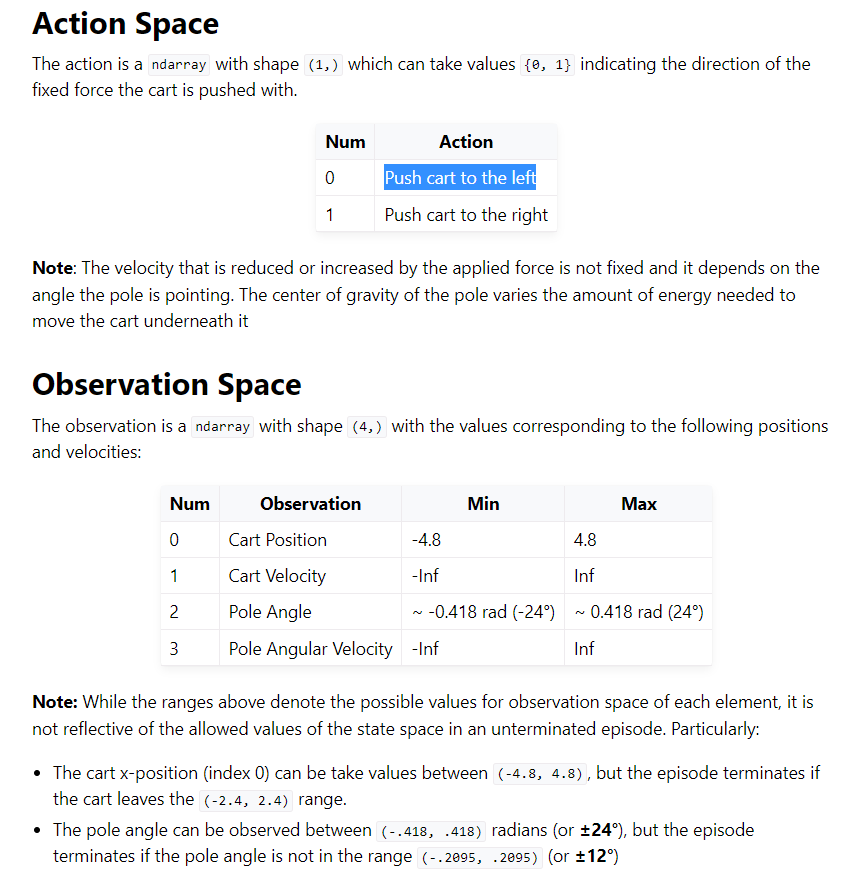

https://www.gymlibrary.dev/environments/classic_control/cart_pole/

In [75]:
env = gym.make('CartPole-v1')

Let's initialize the environment by calling is `reset()` method. This returns an observation:

In [76]:
env.seed(42)
obs = env.reset()

In [77]:
env.observation_space

Box(4,)

Observations vary depending on the environment. In this case it is a 1D NumPy array composed of 4 floats: they represent the cart's horizontal position, its velocity, the angle of the pole (0 = vertical), and the angular velocity.

In [78]:
obs

array([-0.01258566, -0.00156614,  0.04207708, -0.00180545])

Now let's view the environment:

![cart-pole](images/cart-pole-image1.png "Cart-Pole")

Let's see how to interact with an environment. Your agent will need to select an action from an "action space" (the set of possible actions). Let's see what this environment's action space looks like:

In [41]:
env.action_space

Discrete(2)

Yep, just two possible actions: accelerate towards the left or towards the right. Since the pole is leaning toward the right (`obs[2] > 0`), let's accelerate the cart toward the right:

In [79]:
obs

array([-0.01258566, -0.00156614,  0.04207708, -0.00180545])

In [135]:
action = 0 # accelerate right

# The step() method executes the given action and returns four values
obs, reward, done, info = env.step(action)

# obs = This is the new observation

# reward = In this environment, you get a reward of 1.0 at every step, no matter what you do,
# so the goal is to keep the episode running as long as possible

# done = This value will be True when the episode is over. This will happen when the pole
# tilts too much, or goes off the screen, or after 200 steps (in this last case, you have
# won). After that, the environment must be reset before it can be used again.

# info = This environment-specific dictionary can provide some extra information that
# you may find useful for debugging or for training.

obs, done, reward, info

(array([ 0.16058277,  1.1527675 , -0.1285188 , -1.40572078]), False, 1.0, {})

In [146]:
def play_game_sk(seed=None):
    env._max_episode_steps = 2000
    if seed:
        env.seed(seed)
    obs = env.reset()
    print("Started. Obs: ", obs)
    count = 0
    while True:
        if obs[2] > 0:
            action = 1
        else:
            action = 0
        obs, reward, done, info = env.step(action)
        count += 1
        print(f"{count} - Obs: {obs}, Reward: {reward}, Done: {done}, Info: {info}")
        if done:
            print(f"Done! Actions: {count}")
            break
    return count

In [147]:
rewards = [play_game_sk() for _ in range(100)]

Started. Obs:  [ 0.00686485  0.03700738  0.01226966 -0.01874855]
1 - Obs: [ 0.00760499  0.23195124  0.01189469 -0.30753514], Reward: 1.0, Done: False, Info: {}
2 - Obs: [ 0.01224402  0.4269017   0.00574398 -0.59644319], Reward: 1.0, Done: False, Info: {}
3 - Obs: [ 0.02078205  0.6219428  -0.00618488 -0.88731129], Reward: 1.0, Done: False, Info: {}
4 - Obs: [ 0.03322091  0.42690534 -0.0239311  -0.59657904], Reward: 1.0, Done: False, Info: {}
5 - Obs: [ 0.04175901  0.23212632 -0.03586269 -0.31152924], Reward: 1.0, Done: False, Info: {}
6 - Obs: [ 0.04640154  0.03753316 -0.04209327 -0.03036855], Reward: 1.0, Done: False, Info: {}
7 - Obs: [ 0.0471522  -0.15696066 -0.04270064  0.24874199], Reward: 1.0, Done: False, Info: {}
8 - Obs: [ 0.04401299 -0.35144761 -0.0377258   0.52765632], Reward: 1.0, Done: False, Info: {}
9 - Obs: [ 0.03698404 -0.54601902 -0.02717267  0.80821702], Reward: 1.0, Done: False, Info: {}
10 - Obs: [ 0.02606366 -0.74075827 -0.01100833  1.09223027], Reward: 1.0, Done: 

Started. Obs:  [ 0.02601866  0.03071303 -0.00982161 -0.03916754]
1 - Obs: [ 0.02663292 -0.16426671 -0.01060496  0.25040047], Reward: 1.0, Done: False, Info: {}
2 - Obs: [ 0.02334758 -0.35923563 -0.00559695  0.5397196 ], Reward: 1.0, Done: False, Info: {}
3 - Obs: [ 0.01616287 -0.55427846  0.00519744  0.83063376], Reward: 1.0, Done: False, Info: {}
4 - Obs: [ 0.0050773  -0.35922793  0.02181012  0.53958996], Reward: 1.0, Done: False, Info: {}
5 - Obs: [-0.00210726 -0.16441925  0.03260192  0.25385811], Reward: 1.0, Done: False, Info: {}
6 - Obs: [-0.00539564  0.03022239  0.03767908 -0.02836594], Reward: 1.0, Done: False, Info: {}
7 - Obs: [-0.00479119  0.2247843   0.03711176 -0.30892664], Reward: 1.0, Done: False, Info: {}
8 - Obs: [-2.95507467e-04  4.19358362e-01  3.09332279e-02 -5.89678410e-01], Reward: 1.0, Done: False, Info: {}
9 - Obs: [ 0.00809166  0.61403383  0.01913966 -0.872459  ], Reward: 1.0, Done: False, Info: {}
10 - Obs: [ 0.02037234  0.80889035  0.00169048 -1.15906353], Rew

33 - Obs: [ 0.01898781  1.70642316  0.04076499 -2.02946464], Reward: 1.0, Done: False, Info: {}
34 - Obs: [ 5.31162762e-02  1.90110123e+00  1.75696662e-04 -2.30925756e+00], Reward: 1.0, Done: False, Info: {}
35 - Obs: [ 0.0911383   2.09622157 -0.04600945 -2.60188642], Reward: 1.0, Done: False, Info: {}
36 - Obs: [ 0.13306273  1.90148491 -0.09804718 -2.32361254], Reward: 1.0, Done: False, Info: {}
37 - Obs: [ 0.17109243  1.70738056 -0.14451943 -2.0626341 ], Reward: 1.0, Done: False, Info: {}
38 - Obs: [ 0.20524004  1.5139982  -0.18577212 -1.81792548], Reward: 1.0, Done: False, Info: {}
39 - Obs: [ 0.23552001  1.32136496 -0.22213063 -1.58825069], Reward: 1.0, Done: True, Info: {}
Done! Actions: {count}
Started. Obs:  [ 0.04466601  0.01782837 -0.01490157 -0.02781264]
1 - Obs: [ 0.04502257 -0.17707674 -0.01545782  0.26013168], Reward: 1.0, Done: False, Info: {}
2 - Obs: [ 0.04148104 -0.37197466 -0.01025519  0.5478992 ], Reward: 1.0, Done: False, Info: {}
3 - Obs: [ 3.40415446e-02 -5.669510

Started. Obs:  [-0.01304567  0.02151303 -0.01830695  0.00124295]
1 - Obs: [-0.01261541 -0.17334165 -0.01828209  0.28809405], Reward: 1.0, Done: False, Info: {}
2 - Obs: [-0.01608225 -0.36819818 -0.01252021  0.57495537], Reward: 1.0, Done: False, Info: {}
3 - Obs: [-0.02344621 -0.5631424  -0.0010211   0.86366793], Reward: 1.0, Done: False, Info: {}
4 - Obs: [-0.03470906 -0.75825043  0.01625225  1.15602962], Reward: 1.0, Done: False, Info: {}
5 - Obs: [-0.04987407 -0.5633441   0.03937285  0.86848669], Reward: 1.0, Done: False, Info: {}
6 - Obs: [-0.06114095 -0.36877932  0.05674258  0.58843833], Reward: 1.0, Done: False, Info: {}
7 - Obs: [-0.06851654 -0.17449596  0.06851135  0.31415569], Reward: 1.0, Done: False, Info: {}
8 - Obs: [-0.07200645  0.01958655  0.07479446  0.04384148], Reward: 1.0, Done: False, Info: {}
9 - Obs: [-0.07161472  0.21356072  0.07567129 -0.22433724], Reward: 1.0, Done: False, Info: {}
10 - Obs: [-0.06734351  0.40752417  0.07118455 -0.49222368], Reward: 1.0, Done: 

42 - Obs: [-0.00316302  1.93722667  0.00548313 -2.3599559 ], Reward: 1.0, Done: False, Info: {}
43 - Obs: [ 0.03558151  2.13229935 -0.04171599 -2.65094849], Reward: 1.0, Done: False, Info: {}
44 - Obs: [ 0.0782275   1.93751383 -0.09473496 -2.37128535], Reward: 1.0, Done: False, Info: {}
45 - Obs: [ 0.11697778  1.74335061 -0.14216067 -2.10915689], Reward: 1.0, Done: False, Info: {}
46 - Obs: [ 0.15184479  1.54990931 -0.1843438  -1.86357665], Reward: 1.0, Done: False, Info: {}
47 - Obs: [ 0.18284298  1.35722428 -0.22161534 -1.63333681], Reward: 1.0, Done: True, Info: {}
Done! Actions: {count}
Started. Obs:  [-0.02829262  0.02851887  0.03553449  0.03433412]
1 - Obs: [-0.02772224  0.2231137   0.03622117 -0.24692892], Reward: 1.0, Done: False, Info: {}
2 - Obs: [-0.02325997  0.41770012  0.0312826  -0.52797041], Reward: 1.0, Done: False, Info: {}
3 - Obs: [-0.01490597  0.6123683   0.02072319 -0.81063423], Reward: 1.0, Done: False, Info: {}
4 - Obs: [-0.0026586   0.8072003   0.0045105  -1.096

4 - Obs: [ 0.03001338  0.7319038   0.01643855 -1.07838072], Reward: 1.0, Done: False, Info: {}
5 - Obs: [ 0.04465146  0.92680483 -0.00512906 -1.36586006], Reward: 1.0, Done: False, Info: {}
6 - Obs: [ 0.06318756  0.73174748 -0.03244626 -1.07478581], Reward: 1.0, Done: False, Info: {}
7 - Obs: [ 0.0778225   0.53706896 -0.05394198 -0.79245926], Reward: 1.0, Done: False, Info: {}
8 - Obs: [ 0.08856388  0.34272742 -0.06979117 -0.51722221], Reward: 1.0, Done: False, Info: {}
9 - Obs: [ 0.09541843  0.14865398 -0.08013561 -0.24732269], Reward: 1.0, Done: False, Info: {}
10 - Obs: [ 0.09839151 -0.04523749 -0.08508206  0.01904652], Reward: 1.0, Done: False, Info: {}
11 - Obs: [ 0.09748676 -0.23904274 -0.08470113  0.28371886], Reward: 1.0, Done: False, Info: {}
12 - Obs: [ 0.09270591 -0.4328609  -0.07902676  0.54853147], Reward: 1.0, Done: False, Info: {}
13 - Obs: [ 0.08404869 -0.62678894 -0.06805613  0.81530598], Reward: 1.0, Done: False, Info: {}
14 - Obs: [ 0.07151291 -0.82091629 -0.05175001

33 - Obs: [-0.07876293 -1.75890077  0.02193472  2.29261271], Reward: 1.0, Done: False, Info: {}
34 - Obs: [-0.11394095 -1.56398769  0.06778697  2.00676171], Reward: 1.0, Done: False, Info: {}
35 - Obs: [-0.1452207  -1.36963405  0.1079222   1.7358149 ], Reward: 1.0, Done: False, Info: {}
36 - Obs: [-0.17261338 -1.17589571  0.1426385   1.47856571], Reward: 1.0, Done: False, Info: {}
37 - Obs: [-0.19613129 -0.98277413  0.17220982  1.23361891], Reward: 1.0, Done: False, Info: {}
38 - Obs: [-0.21578678 -0.79023266  0.19688219  0.99945848], Reward: 1.0, Done: False, Info: {}
39 - Obs: [-0.23159143 -0.59820889  0.21687136  0.77449745], Reward: 1.0, Done: True, Info: {}
Done! Actions: {count}
Started. Obs:  [ 0.04867073 -0.03572977 -0.03324457 -0.00139756]
1 - Obs: [ 0.04795614 -0.23035956 -0.03327253  0.28061371], Reward: 1.0, Done: False, Info: {}
2 - Obs: [ 0.04334895 -0.42499148 -0.02766025  0.56261969], Reward: 1.0, Done: False, Info: {}
3 - Obs: [ 0.03484912 -0.61971459 -0.01640786  0.84

In [148]:
max(rewards), min(rewards), sum(rewards)/len(rewards)

(68, 25, 42.57)

Notice that the cart is now moving toward the right (`obs[1] > 0`). The pole is still tilted toward the right (`obs[2] > 0`), but its angular velocity is now negative (`obs[3] < 0`), so it will likely be tilted toward the left after the next step.

In [158]:
def play_game_sk_1(seed=None):
    env._max_episode_steps = 5000
    if seed:
        env.seed(seed)
    obs = env.reset()
    print("Started. Obs: ", obs)
    count = 0
    while True:
        if obs[2]+obs[3] > 0:
            action = 1
        else:
            action = 0
        obs, reward, done, info = env.step(action)
        count += 1
        print(f"{count} - Obs: {obs}, Reward: {reward}, Done: {done}, Info: {info}")
        if done:
            print(f"Done! Actions: {count}")
            break
    return count


In [157]:
def test_policy(pl):
    rewards = [pl() for _ in range(100)]
    print(max(rewards), min(rewards), sum(rewards)/len(rewards))
test_policy(play_game_sk_1)

Started. Obs:  [-0.01567828  0.03357201 -0.04715974  0.04482298]
1 - Obs: [-0.01500684 -0.16084308 -0.04626328  0.32226156], Reward: 1.0, Done: False, Info: {}
2 - Obs: [-0.0182237   0.03490609 -0.03981805  0.01535542], Reward: 1.0, Done: False, Info: {}
3 - Obs: [-0.01752558 -0.15962287 -0.03951094  0.29521416], Reward: 1.0, Done: False, Info: {}
4 - Obs: [-0.02071804  0.03603944 -0.03360666 -0.00966344], Reward: 1.0, Done: False, Info: {}
5 - Obs: [-0.01999725 -0.15858483 -0.03379993  0.27222962], Reward: 1.0, Done: False, Info: {}
6 - Obs: [-0.02316895  0.0370027  -0.02835533 -0.0309194 ], Reward: 1.0, Done: False, Info: {}
7 - Obs: [-0.02242889 -0.15770138 -0.02897372  0.25268398], Reward: 1.0, Done: False, Info: {}
8 - Obs: [-0.02558292  0.03782205 -0.02392004 -0.04899516], Reward: 1.0, Done: False, Info: {}
9 - Obs: [-0.02482648 -0.15694889 -0.02489994  0.23604585], Reward: 1.0, Done: False, Info: {}
10 - Obs: [-0.02796546  0.0385198  -0.02017903 -0.06438612], Reward: 1.0, Done: 

554 - Obs: [-1.55493999  0.04884841  0.00659024 -0.29223449], Reward: 1.0, Done: False, Info: {}
555 - Obs: [-1.55396302e+00 -1.46366887e-01  7.45552911e-04  2.51960712e-03], Reward: 1.0, Done: False, Info: {}
556 - Obs: [-1.55689036e+00  4.87443642e-02  7.95945054e-04 -2.89927995e-01], Reward: 1.0, Done: False, Info: {}
557 - Obs: [-1.55591547 -0.14638893 -0.00500261  0.00300586], Reward: 1.0, Done: False, Info: {}
558 - Obs: [-1.55884325 -0.34143878 -0.0049425   0.29410621], Reward: 1.0, Done: False, Info: {}
559 - Obs: [-1.56567203e+00 -1.46246711e-01  9.39626486e-04 -1.31402779e-04], Reward: 1.0, Done: False, Info: {}
560 - Obs: [-1.56859696e+00  4.88617516e-02  9.36998431e-04 -2.92517718e-01], Reward: 1.0, Done: False, Info: {}
561 - Obs: [-1.56761972e+00 -1.46273547e-01 -4.91335593e-03  4.60578640e-04], Reward: 1.0, Done: False, Info: {}
562 - Obs: [-1.5705452  -0.34132469 -0.00490414  0.29158924], Reward: 1.0, Done: False, Info: {}
563 - Obs: [-1.57737169e+00 -1.46133158e-01  9.

339 - Obs: [-0.1095871  -0.20658874 -0.00331676  0.29347064], Reward: 1.0, Done: False, Info: {}
340 - Obs: [-0.11371888 -0.01141966  0.00255265 -0.0002565 ], Reward: 1.0, Done: False, Info: {}
341 - Obs: [-0.11394727  0.18366559  0.00254752 -0.29213294], Reward: 1.0, Done: False, Info: {}
342 - Obs: [-0.11027396 -0.01149259 -0.00329514  0.00135236], Reward: 1.0, Done: False, Info: {}
343 - Obs: [-0.11050381 -0.20656713 -0.00326809  0.29299381], Reward: 1.0, Done: False, Info: {}
344 - Obs: [-0.11463516 -0.01139874  0.00259179 -0.00071804], Reward: 1.0, Done: False, Info: {}
345 - Obs: [-0.11486313  0.18368595  0.00257743 -0.2925821 ], Reward: 1.0, Done: False, Info: {}
346 - Obs: [-0.11118941 -0.01147266 -0.00327422  0.0009126 ], Reward: 1.0, Done: False, Info: {}
347 - Obs: [-0.11141886 -0.2065475  -0.00325596  0.29256068], Reward: 1.0, Done: False, Info: {}
348 - Obs: [-0.11554981 -0.01137928  0.00259525 -0.00114736], Reward: 1.0, Done: False, Info: {}
349 - Obs: [-0.1157774   0.183

957 - Obs: [-0.25473567 -0.20626265  0.00155297  0.28627154], Reward: 1.0, Done: False, Info: {}
958 - Obs: [-0.25886092 -0.01116288  0.0072784  -0.00592119], Reward: 1.0, Done: False, Info: {}
959 - Obs: [-0.25908418  0.18385394  0.00715998 -0.29629883], Reward: 1.0, Done: False, Info: {}
960 - Obs: [-0.2554071  -0.01136935  0.001234   -0.00136639], Reward: 1.0, Done: False, Info: {}
961 - Obs: [-0.25563449 -0.20650898  0.00120667  0.29170562], Reward: 1.0, Done: False, Info: {}
962 - Obs: [-0.25976467 -0.01140425  0.00704079 -0.00059649], Reward: 1.0, Done: False, Info: {}
963 - Obs: [-0.25999275  0.18361602  0.00702886 -0.29104968], Reward: 1.0, Done: False, Info: {}
964 - Obs: [-0.25632043 -0.01160544  0.00120786  0.00384176], Reward: 1.0, Done: False, Info: {}
965 - Obs: [-0.25655254  0.18349916  0.0012847  -0.28845983], Reward: 1.0, Done: False, Info: {}
966 - Obs: [-0.25288256 -0.01164108 -0.0044845   0.004628  ], Reward: 1.0, Done: False, Info: {}
967 - Obs: [-0.25311538  0.183

1459 - Obs: [-0.36559776 -0.20649481 -0.00442516  0.29140059], Reward: 1.0, Done: False, Info: {}
1460 - Obs: [-0.36972766 -0.01131004  0.00140285 -0.00267469], Reward: 1.0, Done: False, Info: {}
1461 - Obs: [-0.36995386 -0.20645208  0.00134936  0.29045053], Reward: 1.0, Done: False, Info: {}
1462 - Obs: [-0.3740829  -0.0113494   0.00715837 -0.00180652], Reward: 1.0, Done: False, Info: {}
1463 - Obs: [-0.37430989  0.18366916  0.00712224 -0.29222233], Reward: 1.0, Done: False, Info: {}
1464 - Obs: [-0.37063651 -0.01155361  0.00127779  0.00269833], Reward: 1.0, Done: False, Info: {}
1465 - Obs: [-0.37086758  0.18354999  0.00133176 -0.28958117], Reward: 1.0, Done: False, Info: {}
1466 - Obs: [-0.36719658 -0.01159092 -0.00445986  0.00352149], Reward: 1.0, Done: False, Info: {}
1467 - Obs: [-0.3674284  -0.20664863 -0.00438943  0.29479394], Reward: 1.0, Done: False, Info: {}
1468 - Obs: [-0.37156137 -0.01146438  0.00150645  0.00072989], Reward: 1.0, Done: False, Info: {}
1469 - Obs: [-0.3717

1940 - Obs: [-0.4794777  -0.01113358  0.00161585 -0.00656747], Reward: 1.0, Done: False, Info: {}
1941 - Obs: [-0.47970037 -0.20627866  0.0014845   0.28662484], Reward: 1.0, Done: False, Info: {}
1942 - Obs: [-0.48382594 -0.01117791  0.007217   -0.00558952], Reward: 1.0, Done: False, Info: {}
1943 - Obs: [-0.4840495   0.1838398   0.00710521 -0.29598669], Reward: 1.0, Done: False, Info: {}
1944 - Obs: [-0.4803727  -0.01138272  0.00118548 -0.00107139], Reward: 1.0, Done: False, Info: {}
1945 - Obs: [-0.48060036  0.18372221  0.00116405 -0.29338004], Reward: 1.0, Done: False, Info: {}
1946 - Obs: [-4.76925913e-01 -1.14163215e-02 -4.70355145e-03 -3.30220366e-04], Reward: 1.0, Done: False, Info: {}
1947 - Obs: [-0.47715424 -0.2064705  -0.00471016  0.29086498], Reward: 1.0, Done: False, Info: {}
1948 - Obs: [-0.48128365 -0.01128171  0.00110714 -0.00329975], Reward: 1.0, Done: False, Info: {}
1949 - Obs: [-0.48150928 -0.20641952  0.00104115  0.28973229], Reward: 1.0, Done: False, Info: {}
1950

2473 - Obs: [-0.60131411 -0.20647983  0.00114907  0.29106269], Reward: 1.0, Done: False, Info: {}
2474 - Obs: [-0.6054437  -0.01137428  0.00697032 -0.00125762], Reward: 1.0, Done: False, Info: {}
2475 - Obs: [-0.60567119  0.18364701  0.00694517 -0.2917332 ], Reward: 1.0, Done: False, Info: {}
2476 - Obs: [-0.60199825 -0.01157327  0.00111051  0.00313203], Reward: 1.0, Done: False, Info: {}
2477 - Obs: [-0.60222971  0.18353274  0.00117315 -0.28920031], Reward: 1.0, Done: False, Info: {}
2478 - Obs: [-0.59855906 -0.01160592 -0.00461086  0.00385239], Reward: 1.0, Done: False, Info: {}
2479 - Obs: [-0.59879118 -0.20666145 -0.00453381  0.29507697], Reward: 1.0, Done: False, Info: {}
2480 - Obs: [-0.60292441 -0.01147515  0.00136773  0.0009676 ], Reward: 1.0, Done: False, Info: {}
2481 - Obs: [-0.60315391  0.18362716  0.00138708 -0.29128347], Reward: 1.0, Done: False, Info: {}
2482 - Obs: [-0.59948137 -0.01151455 -0.00443859  0.0018366 ], Reward: 1.0, Done: False, Info: {}
2483 - Obs: [-0.5997

2989 - Obs: [-0.71151676 -0.20649909 -0.0097508   0.29151081], Reward: 1.0, Done: False, Info: {}
2990 - Obs: [-0.71564674 -0.01123948 -0.00392058 -0.00423138], Reward: 1.0, Done: False, Info: {}
2991 - Obs: [-0.71587153 -0.20630498 -0.00400521  0.28721198], Reward: 1.0, Done: False, Info: {}
2992 - Obs: [-0.71999763 -0.01112614  0.00173903 -0.00673146], Reward: 1.0, Done: False, Info: {}
2993 - Obs: [-0.72022016 -0.20627299  0.0016044   0.28649964], Reward: 1.0, Done: False, Info: {}
2994 - Obs: [-0.72434562 -0.01117396  0.00733439 -0.00567684], Reward: 1.0, Done: False, Info: {}
2995 - Obs: [-0.72456909  0.18384205  0.00722086 -0.29603668], Reward: 1.0, Done: False, Info: {}
2996 - Obs: [-0.72089225 -0.0113821   0.00130012 -0.00108518], Reward: 1.0, Done: False, Info: {}
2997 - Obs: [-0.7211199   0.18372118  0.00127842 -0.29335762], Reward: 1.0, Done: False, Info: {}
2998 - Obs: [-7.17445472e-01 -1.14189707e-02 -4.58873228e-03 -2.71774572e-04], Reward: 1.0, Done: False, Info: {}
2999

3516 - Obs: [-0.83978794 -0.0115038   0.0015263   0.00159959], Reward: 1.0, Done: False, Info: {}
3517 - Obs: [-0.84001801  0.18359623  0.00155829 -0.29060138], Reward: 1.0, Done: False, Info: {}
3518 - Obs: [-0.83634609 -0.01154791 -0.00425374  0.0025726 ], Reward: 1.0, Done: False, Info: {}
3519 - Obs: [-0.83657705 -0.2066086  -0.00420228  0.29391039], Reward: 1.0, Done: False, Info: {}
3520 - Obs: [-8.40709218e-01 -1.14269884e-02  1.67592296e-03 -9.49048242e-05], Reward: 1.0, Done: False, Info: {}
3521 - Obs: [-0.84093776  0.18367089  0.00167402 -0.29224859], Reward: 1.0, Done: False, Info: {}
3522 - Obs: [-0.83726434 -0.01147489 -0.00417095  0.00096184], Reward: 1.0, Done: False, Info: {}
3523 - Obs: [-0.83749384 -0.20653678 -0.00415171  0.29232586], Reward: 1.0, Done: False, Info: {}
3524 - Obs: [-0.84162457 -0.01135588  0.00169481 -0.00166356], Reward: 1.0, Done: False, Info: {}
3525 - Obs: [-0.84185169  0.18374173  0.00166154 -0.29381127], Reward: 1.0, Done: False, Info: {}
3526

4030 - Obs: [-0.96120357 -0.0113321   0.00736976 -0.00218806], Reward: 1.0, Done: False, Info: {}
4031 - Obs: [-0.96143021  0.18368338  0.007326   -0.29253666], Reward: 1.0, Done: False, Info: {}
4032 - Obs: [-0.95775654 -0.01154225  0.00147526  0.00244776], Reward: 1.0, Done: False, Info: {}
4033 - Obs: [-0.95798739  0.18355851  0.00152422 -0.28976934], Reward: 1.0, Done: False, Info: {}
4034 - Obs: [-0.95431622 -0.01158514 -0.00427117  0.00339392], Reward: 1.0, Done: False, Info: {}
4035 - Obs: [-0.95454792 -0.20664558 -0.00420329  0.29472619], Reward: 1.0, Done: False, Info: {}
4036 - Obs: [-9.58680833e-01 -1.14639556e-02  1.69123552e-03  7.20576647e-04], Reward: 1.0, Done: False, Info: {}
4037 - Obs: [-0.95891011  0.1836337   0.00170565 -0.29142827], Reward: 1.0, Done: False, Info: {}
4038 - Obs: [-0.95523744 -0.01151253 -0.00412292  0.00179211], Reward: 1.0, Done: False, Info: {}
4039 - Obs: [-0.95546769 -0.20657511 -0.00408708  0.29317136], Reward: 1.0, Done: False, Info: {}
4040

4555 - Obs: [-1.07342927 -0.20668476 -0.00429326  0.29559068], Reward: 1.0, Done: False, Info: {}
4556 - Obs: [-1.07756296 -0.01150186  0.00161856  0.00155682], Reward: 1.0, Done: False, Info: {}
4557 - Obs: [-1.077793    0.18359684  0.00164969 -0.29061499], Reward: 1.0, Done: False, Info: {}
4558 - Obs: [-1.07412106 -0.0115486  -0.00416261  0.00258777], Reward: 1.0, Done: False, Info: {}
4559 - Obs: [-1.07435204 -0.20661061 -0.00411085  0.29395444], Reward: 1.0, Done: False, Info: {}
4560 - Obs: [-1.07848425e+00 -1.14302867e-02  1.76823770e-03 -2.21457175e-05], Reward: 1.0, Done: False, Info: {}
4561 - Obs: [-1.07871285  0.18366626  0.00176779 -0.29214665], Reward: 1.0, Done: False, Info: {}
4562 - Obs: [-1.07503953 -0.01148085 -0.00407514  0.00109329], Reward: 1.0, Done: False, Info: {}
4563 - Obs: [-1.07526915 -0.20654412 -0.00405327  0.29248768], Reward: 1.0, Done: False, Info: {}
4564 - Obs: [-1.07940003 -0.01136462  0.00179648 -0.00147083], Reward: 1.0, Done: False, Info: {}
4565

132 - Obs: [-0.1479476  -0.04051087  0.0003875   0.00135386], Reward: 1.0, Done: False, Info: {}
133 - Obs: [-0.14875782  0.15460552  0.00041457 -0.29120679], Reward: 1.0, Done: False, Info: {}
134 - Obs: [-0.14566571 -0.04052234 -0.00540956  0.00160686], Reward: 1.0, Done: False, Info: {}
135 - Obs: [-0.14647615 -0.2355663  -0.00537742  0.29257811], Reward: 1.0, Done: False, Info: {}
136 - Obs: [-0.15118748 -0.04036809  0.00047414 -0.00179592], Reward: 1.0, Done: False, Info: {}
137 - Obs: [-0.15199484 -0.23549684  0.00043822  0.29103656], Reward: 1.0, Done: False, Info: {}
138 - Obs: [-0.15670478 -0.04038114  0.00625895 -0.00150812], Reward: 1.0, Done: False, Info: {}
139 - Obs: [-0.1575124   0.15465049  0.00622879 -0.29220972], Reward: 1.0, Done: False, Info: {}
140 - Obs: [-0.15441939 -0.04055971  0.00038459  0.00243116], Reward: 1.0, Done: False, Info: {}
141 - Obs: [-0.15523058  0.15455672  0.00043322 -0.2901304 ], Reward: 1.0, Done: False, Info: {}
142 - Obs: [-0.15213945 -0.040

618 - Obs: [-0.54506728 -0.04036106  0.00730221 -0.00195102], Reward: 1.0, Done: False, Info: {}
619 - Obs: [-0.54587451  0.15465541  0.00726319 -0.2923211 ], Reward: 1.0, Done: False, Info: {}
620 - Obs: [-0.5427814  -0.04056934  0.00141676  0.00264366], Reward: 1.0, Done: False, Info: {}
621 - Obs: [-0.54359278  0.15453226  0.00146964 -0.28959192], Reward: 1.0, Done: False, Info: {}
622 - Obs: [-0.54050214 -0.04061062 -0.0043222   0.00355415], Reward: 1.0, Done: False, Info: {}
623 - Obs: [-0.54131435 -0.23567032 -0.00425112  0.29487024], Reward: 1.0, Done: False, Info: {}
624 - Obs: [-0.54602776 -0.04048802  0.00164629  0.00084962], Reward: 1.0, Done: False, Info: {}
625 - Obs: [-0.54683752  0.15461029  0.00166328 -0.29131343], Reward: 1.0, Done: False, Info: {}
626 - Obs: [-0.54374531 -0.04053534 -0.00416299  0.00189361], Reward: 1.0, Done: False, Info: {}
627 - Obs: [-0.54455602 -0.23559734 -0.00412512  0.29326016], Reward: 1.0, Done: False, Info: {}
628 - Obs: [-0.54926797 -0.040

1092 - Obs: [-9.24614704e-01 -4.04781461e-02  1.19650618e-03  6.31876741e-04], Reward: 1.0, Done: False, Info: {}
1093 - Obs: [-0.92542427  0.15462663  0.00120914 -0.2916733 ], Reward: 1.0, Done: False, Info: {}
1094 - Obs: [-0.92233173 -0.04051255 -0.00462432  0.00139073], Reward: 1.0, Done: False, Info: {}
1095 - Obs: [-0.92314199 -0.23556787 -0.00459651  0.29261105], Reward: 1.0, Done: False, Info: {}
1096 - Obs: [-0.92785334 -0.04038069  0.00125571 -0.001518  ], Reward: 1.0, Done: False, Info: {}
1097 - Obs: [-0.92866096 -0.23552063  0.00122535  0.29156085], Reward: 1.0, Done: False, Info: {}
1098 - Obs: [-9.33371369e-01 -4.04161674e-02  7.05657036e-03 -7.35362332e-04], Reward: 1.0, Done: False, Info: {}
1099 - Obs: [-0.93417969  0.15460388  0.00704186 -0.29118353], Reward: 1.0, Done: False, Info: {}
1100 - Obs: [-0.93108762 -0.04061777  0.00121819  0.00371197], Reward: 1.0, Done: False, Info: {}
1101 - Obs: [-0.93189997  0.15448669  0.00129243 -0.28858635], Reward: 1.0, Done: Fals

1532 - Obs: [-1.28058457 -0.040342    0.00151106 -0.00237145], Reward: 1.0, Done: False, Info: {}
1533 - Obs: [-1.28139141 -0.23548559  0.00146363  0.29078785], Reward: 1.0, Done: False, Info: {}
1534 - Obs: [-1.28610112 -0.04038454  0.00727939 -0.00143311], Reward: 1.0, Done: False, Info: {}
1535 - Obs: [-1.28690881  0.15463226  0.00725072 -0.29181044], Reward: 1.0, Done: False, Info: {}
1536 - Obs: [-1.28381617 -0.04059232  0.00141451  0.00315043], Reward: 1.0, Done: False, Info: {}
1537 - Obs: [-1.28462801  0.15450932  0.00147752 -0.28908587], Reward: 1.0, Done: False, Info: {}
1538 - Obs: [-1.28153783 -0.04063367 -0.00430419  0.00406269], Reward: 1.0, Done: False, Info: {}
1539 - Obs: [-1.2823505  -0.23569363 -0.00422294  0.29538449], Reward: 1.0, Done: False, Info: {}
1540 - Obs: [-1.28706437 -0.04051173  0.00168475  0.00137271], Reward: 1.0, Done: False, Info: {}
1541 - Obs: [-1.28787461  0.15458602  0.0017122  -0.29077818], Reward: 1.0, Done: False, Info: {}
1542 - Obs: [-1.2847

2212 - Obs: [-1.83069818e+00 -4.01427122e-02  1.51983828e-03 -6.76763944e-03], Reward: 1.0, Done: False, Info: {}
2213 - Obs: [-1.83150103e+00 -2.35286427e-01  1.38448549e-03  2.86394427e-01], Reward: 1.0, Done: False, Info: {}
2214 - Obs: [-1.83620676 -0.04018425  0.00711237 -0.00585152], Reward: 1.0, Done: False, Info: {}
2215 - Obs: [-1.83701045  0.15483498  0.00699534 -0.29628195], Reward: 1.0, Done: False, Info: {}
2216 - Obs: [-1.83391375e+00 -4.03859900e-02  1.06970458e-03 -1.40104074e-03], Reward: 1.0, Done: False, Info: {}
2217 - Obs: [-1.83472147e+00 -2.35523266e-01  1.04168376e-03  2.91619199e-01], Reward: 1.0, Done: False, Info: {}
2218 - Obs: [-1.83943193e+00 -4.04161831e-02  6.87406774e-03 -7.35011718e-04], Reward: 1.0, Done: False, Info: {}
2219 - Obs: [-1.84024026  0.15460651  0.00685937 -0.29124118], Reward: 1.0, Done: False, Info: {}
2220 - Obs: [-1.83714813e+00 -4.06125691e-02  1.03454383e-03  3.59718803e-03], Reward: 1.0, Done: False, Info: {}
2221 - Obs: [-1.837960

2744 - Obs: [-2.26108450e+00 -4.05738544e-02  1.59927055e-03  2.74316702e-03], Reward: 1.0, Done: False, Info: {}
2745 - Obs: [-2.26189598e+00  1.54525124e-01  1.65413389e-03 -2.89434742e-01], Reward: 1.0, Done: False, Info: {}
2746 - Obs: [-2.25880548 -0.04062038 -0.00413456  0.00376942], Reward: 1.0, Done: False, Info: {}
2747 - Obs: [-2.25961788 -0.23568279 -0.00405917  0.29514498], Reward: 1.0, Done: False, Info: {}
2748 - Obs: [-2.26433154e+00 -4.05032027e-02  1.84372716e-03  1.18462390e-03], Reward: 1.0, Done: False, Info: {}
2749 - Obs: [-2.26514160e+00  1.54592258e-01  1.86741963e-03 -2.90916015e-01], Reward: 1.0, Done: False, Info: {}
2750 - Obs: [-2.26204976 -0.04055627 -0.0039509   0.00235529], Reward: 1.0, Done: False, Info: {}
2751 - Obs: [-2.26286088 -0.23562134 -0.00390379  0.29378904], Reward: 1.0, Done: False, Info: {}
2752 - Obs: [-2.26757331e+00 -4.04439473e-02  1.97198601e-03 -1.22523054e-04], Reward: 1.0, Done: False, Info: {}
2753 - Obs: [-2.26838219e+00  1.546496

530 - Obs: [-0.07792839 -0.0107333  -0.00434786  0.00343488], Reward: 1.0, Done: False, Info: {}
531 - Obs: [-0.07814305 -0.20579262 -0.00427916  0.29474284], Reward: 1.0, Done: False, Info: {}
532 - Obs: [-0.0822589  -0.01060993  0.0016157   0.0007134 ], Reward: 1.0, Done: False, Info: {}
533 - Obs: [-0.0824711   0.18448881  0.00162997 -0.29145931], Reward: 1.0, Done: False, Info: {}
534 - Obs: [-0.07878133 -0.01065634 -0.00419922  0.00173724], Reward: 1.0, Done: False, Info: {}
535 - Obs: [-0.07899445 -0.20571782 -0.00416448  0.29309231], Reward: 1.0, Done: False, Info: {}
536 - Obs: [-0.08310881 -0.01053674  0.00169737 -0.00090112], Reward: 1.0, Done: False, Info: {}
537 - Obs: [-0.08331954  0.18456083  0.00167935 -0.29304803], Reward: 1.0, Done: False, Info: {}
538 - Obs: [-0.07962833 -0.01058503 -0.00418161  0.00016407], Reward: 1.0, Done: False, Info: {}
539 - Obs: [-0.07984003 -0.20564676 -0.00417833  0.29152472], Reward: 1.0, Done: False, Info: {}
540 - Obs: [-0.08395296 -0.010

1144 - Obs: [-0.21171485 -0.01061982  0.00131287  0.0009317 ], Reward: 1.0, Done: False, Info: {}
1145 - Obs: [-0.21192725  0.18448327  0.00133151 -0.29133671], Reward: 1.0, Done: False, Info: {}
1146 - Obs: [-0.20823758 -0.01065764 -0.00449523  0.00176586], Reward: 1.0, Done: False, Info: {}
1147 - Obs: [-0.20845074 -0.20571483 -0.00445991  0.2930271 ], Reward: 1.0, Done: False, Info: {}
1148 - Obs: [-0.21256503 -0.01052958  0.00140063 -0.00105908], Reward: 1.0, Done: False, Info: {}
1149 - Obs: [-0.21277562  0.18457226  0.00137945 -0.29329976], Reward: 1.0, Done: False, Info: {}
1150 - Obs: [-2.09084178e-01 -1.05693334e-02 -4.48654393e-03 -1.82091092e-04], Reward: 1.0, Done: False, Info: {}
1151 - Obs: [-0.20929557 -0.20562665 -0.00449019  0.29108191], Reward: 1.0, Done: False, Info: {}
1152 - Obs: [-0.2134081  -0.01044097  0.00133145 -0.00301378], Reward: 1.0, Done: False, Info: {}
1153 - Obs: [-0.21361692 -0.20558199  0.00127118  0.29008894], Reward: 1.0, Done: False, Info: {}
1154

1924 - Obs: [-0.37670049 -0.01045518  0.00076753 -0.00270031], Reward: 1.0, Done: False, Info: {}
1925 - Obs: [-0.37690959 -0.20558813  0.00071353  0.29022468], Reward: 1.0, Done: False, Info: {}
1926 - Obs: [-0.38102136 -0.01047636  0.00651802 -0.00223312], Reward: 1.0, Done: False, Info: {}
1927 - Obs: [-0.38123088  0.18455151  0.00647336 -0.29285243], Reward: 1.0, Done: False, Info: {}
1928 - Obs: [-0.37753985 -0.01066213  0.00061631  0.00186506], Reward: 1.0, Done: False, Info: {}
1929 - Obs: [-0.3777531   0.18445097  0.00065361 -0.29062335], Reward: 1.0, Done: False, Info: {}
1930 - Obs: [-0.37406408 -0.01068029 -0.00515886  0.00226564], Reward: 1.0, Done: False, Info: {}
1931 - Obs: [-0.37427768 -0.20572788 -0.00511355  0.29331643], Reward: 1.0, Done: False, Info: {}
1932 - Obs: [-0.37839224 -0.0105334   0.00075278 -0.00097484], Reward: 1.0, Done: False, Info: {}
1933 - Obs: [-0.37860291 -0.20566614  0.00073329  0.2919455 ], Reward: 1.0, Done: False, Info: {}
1934 - Obs: [-0.3827

2499 - Obs: [-0.49446911 -0.20578389 -0.00445111  0.29455045], Reward: 1.0, Done: False, Info: {}
2500 - Obs: [-4.98584788e-01 -1.05987594e-02  1.43990286e-03  4.67038868e-04], Reward: 1.0, Done: False, Info: {}
2501 - Obs: [-0.49879676  0.18450251  0.00144924 -0.29176123], Reward: 1.0, Done: False, Info: {}
2502 - Obs: [-0.49510671 -0.01064007 -0.00438598  0.00137841], Reward: 1.0, Done: False, Info: {}
2503 - Obs: [-0.49531951 -0.20569885 -0.00435841  0.29267429], Reward: 1.0, Done: False, Info: {}
2504 - Obs: [-0.49943349 -0.01051503  0.00149507 -0.00138003], Reward: 1.0, Done: False, Info: {}
2505 - Obs: [-0.49964379  0.18458545  0.00146747 -0.29359087], Reward: 1.0, Done: False, Info: {}
2506 - Obs: [-4.95952083e-01 -1.05573933e-02 -4.40434492e-03 -4.45482675e-04], Reward: 1.0, Done: False, Info: {}
2507 - Obs: [-0.49616323 -0.2056159  -0.00441325  0.29084457], Reward: 1.0, Done: False, Info: {}
2508 - Obs: [-0.50027555 -0.0104313   0.00140364 -0.00322697], Reward: 1.0, Done: Fals

3192 - Obs: [-0.64500956 -0.01031112  0.00212322 -0.00587814], Reward: 1.0, Done: False, Info: {}
3193 - Obs: [-0.64521579 -0.20546346  0.00200566  0.28747393], Reward: 1.0, Done: False, Info: {}
3194 - Obs: [-0.64932506 -0.01037017  0.00775514 -0.00457575], Reward: 1.0, Done: False, Info: {}
3195 - Obs: [-0.64953246  0.18463971  0.00766363 -0.29480178], Reward: 1.0, Done: False, Info: {}
3196 - Obs: [-6.45839664e-01 -1.05906545e-02  1.76758952e-03  2.88248993e-04], Reward: 1.0, Done: False, Info: {}
3197 - Obs: [-0.64605148  0.1845059   0.00177335 -0.29183646], Reward: 1.0, Done: False, Info: {}
3198 - Obs: [-0.64236136 -0.01064129 -0.00406337  0.00140523], Reward: 1.0, Done: False, Info: {}
3199 - Obs: [-0.64257419 -0.20570473 -0.00403527  0.29280335], Reward: 1.0, Done: False, Info: {}
3200 - Obs: [-0.64668828 -0.01052548  0.0018208  -0.00114951], Reward: 1.0, Done: False, Info: {}
3201 - Obs: [-0.64689879  0.18457031  0.00179781 -0.2932574 ], Reward: 1.0, Done: False, Info: {}
3202

3876 - Obs: [-0.7896692  -0.01047776  0.0012016  -0.00220207], Reward: 1.0, Done: False, Info: {}
3877 - Obs: [-0.78987875 -0.20561693  0.00115756  0.29085973], Reward: 1.0, Done: False, Info: {}
3878 - Obs: [-0.79399109 -0.0105115   0.00697475 -0.00145789], Reward: 1.0, Done: False, Info: {}
3879 - Obs: [-0.79420132  0.18450973  0.0069456  -0.29193206], Reward: 1.0, Done: False, Info: {}
3880 - Obs: [-0.79051113 -0.01071056  0.00110696  0.0029333 ], Reward: 1.0, Done: False, Info: {}
3881 - Obs: [-0.79072534  0.1843955   0.00116562 -0.28940016], Reward: 1.0, Done: False, Info: {}
3882 - Obs: [-0.78703743 -0.01074305 -0.00462238  0.00365016], Reward: 1.0, Done: False, Info: {}
3883 - Obs: [-0.78725229 -0.20579841 -0.00454938  0.29487109], Reward: 1.0, Done: False, Info: {}
3884 - Obs: [-7.91368256e-01 -1.06118967e-02  1.34804279e-03  7.56838253e-04], Reward: 1.0, Done: False, Info: {}
3885 - Obs: [-0.79158049  0.1844907   0.00136318 -0.29150046], Reward: 1.0, Done: False, Info: {}
3886

4417 - Obs: [-0.90414871  0.18436463  0.00186352 -0.28872006], Reward: 1.0, Done: False, Info: {}
4418 - Obs: [-0.90046142 -0.01078385 -0.00391089  0.00455002], Reward: 1.0, Done: False, Info: {}
4419 - Obs: [-0.9006771   0.18439397 -0.00381989 -0.28936427], Reward: 1.0, Done: False, Info: {}
4420 - Obs: [-0.89698922 -0.0106733  -0.00960717  0.00211146], Reward: 1.0, Done: False, Info: {}
4421 - Obs: [-0.89720269 -0.20565616 -0.00956494  0.29174779], Reward: 1.0, Done: False, Info: {}
4422 - Obs: [-0.90131581 -0.01039914 -0.00372999 -0.00393638], Reward: 1.0, Done: False, Info: {}
4423 - Obs: [-0.90152379 -0.2054674  -0.00380871  0.28756736], Reward: 1.0, Done: False, Info: {}
4424 - Obs: [-0.90563314 -0.01029135  0.00194263 -0.00631437], Reward: 1.0, Done: False, Info: {}
4425 - Obs: [-0.90583897 -0.2054411   0.00181635  0.28698085], Reward: 1.0, Done: False, Info: {}
4426 - Obs: [-0.90994779 -0.0103451   0.00755596 -0.00512866], Reward: 1.0, Done: False, Info: {}
4427 - Obs: [-0.9101

183 - Obs: [ 0.06592147 -0.18236962  0.00128717  0.29001358], Reward: 1.0, Done: False, Info: {}
184 - Obs: [ 0.06227408  0.01273396  0.00708745 -0.00226311], Reward: 1.0, Done: False, Info: {}
185 - Obs: [ 0.06252876  0.20775355  0.00704218 -0.29270146], Reward: 1.0, Done: False, Info: {}
186 - Obs: [0.06668383 0.0125319  0.00118815 0.00219413], Reward: 1.0, Done: False, Info: {}
187 - Obs: [ 0.06693447  0.2076368   0.00123204 -0.29011368], Reward: 1.0, Done: False, Info: {}
188 - Obs: [ 0.0710872   0.0124973  -0.00457024  0.00295756], Reward: 1.0, Done: False, Info: {}
189 - Obs: [ 0.07133715 -0.18255881 -0.00451108  0.29419503], Reward: 1.0, Done: False, Info: {}
190 - Obs: [6.76859729e-02 1.26271623e-02 1.37281568e-03 9.27901946e-05], Reward: 1.0, Done: False, Info: {}
191 - Obs: [ 0.06793852  0.2077294   0.00137467 -0.29215668], Reward: 1.0, Done: False, Info: {}
192 - Obs: [ 0.0720931   0.01258787 -0.00446846  0.00095948], Reward: 1.0, Done: False, Info: {}
193 - Obs: [ 0.0723448

803 - Obs: [ 0.22254919  0.20763093  0.00131464 -0.28998443], Reward: 1.0, Done: False, Info: {}
804 - Obs: [ 0.22670181  0.01249026 -0.00448505  0.00311283], Reward: 1.0, Done: False, Info: {}
805 - Obs: [ 0.22695161 -0.18256708 -0.0044228   0.2943773 ], Reward: 1.0, Done: False, Info: {}
806 - Obs: [0.22330027 0.01261764 0.00146475 0.00030278], Reward: 1.0, Done: False, Info: {}
807 - Obs: [ 0.22355262  0.20771856  0.0014708  -0.29191764], Reward: 1.0, Done: False, Info: {}
808 - Obs: [ 0.22770699  0.01257567 -0.00436755  0.00122879], Reward: 1.0, Done: False, Info: {}
809 - Obs: [ 0.22795851 -0.18248338 -0.00434297  0.29253051], Reward: 1.0, Done: False, Info: {}
810 - Obs: [ 0.22430884  0.01270023  0.00150764 -0.00151896], Reward: 1.0, Done: False, Info: {}
811 - Obs: [ 0.22456284 -0.18244331  0.00147726  0.29163926], Reward: 1.0, Done: False, Info: {}
812 - Obs: [ 0.22091398  0.01265754  0.00731004 -0.00057739], Reward: 1.0, Done: False, Info: {}
813 - Obs: [ 0.22116713  0.2076739

1383 - Obs: [ 0.36906693 -0.18239481  0.0014503   0.2905692 ], Reward: 1.0, Done: False, Info: {}
1384 - Obs: [ 0.36541903  0.01270644  0.00726168 -0.00165597], Reward: 1.0, Done: False, Info: {}
1385 - Obs: [ 0.36567316  0.20772349  0.00722856 -0.29203893], Reward: 1.0, Done: False, Info: {}
1386 - Obs: [0.36982763 0.01249923 0.00138778 0.002915  ], Reward: 1.0, Done: False, Info: {}
1387 - Obs: [ 0.37007761  0.20760125  0.00144608 -0.28932974], Reward: 1.0, Done: False, Info: {}
1388 - Obs: [ 0.37422964  0.01245871 -0.00434051  0.00380891], Reward: 1.0, Done: False, Info: {}
1389 - Obs: [ 0.37447881 -0.18260073 -0.00426433  0.2951192 ], Reward: 1.0, Done: False, Info: {}
1390 - Obs: [0.3708268  0.01258176 0.00163805 0.00109442], Reward: 1.0, Done: False, Info: {}
1391 - Obs: [ 0.37107843  0.20768018  0.00165994 -0.29107123], Reward: 1.0, Done: False, Info: {}
1392 - Obs: [ 0.37523204  0.0125346  -0.00416149  0.00213476], Reward: 1.0, Done: False, Info: {}
1393 - Obs: [ 0.37548273 -0.

2240 - Obs: [ 5.89443154e-01  1.26531720e-02 -3.78863571e-03 -4.80966592e-04], Reward: 1.0, Done: False, Info: {}
2241 - Obs: [ 0.58969622 -0.18241424 -0.00379826  0.2910042 ], Reward: 1.0, Done: False, Info: {}
2242 - Obs: [ 0.58604793  0.01276166  0.00202183 -0.00287423], Reward: 1.0, Done: False, Info: {}
2243 - Obs: [ 0.58630317 -0.18238923  0.00196434  0.29044592], Reward: 1.0, Done: False, Info: {}
2244 - Obs: [ 0.58265538  0.01270466  0.00777326 -0.00161683], Reward: 1.0, Done: False, Info: {}
2245 - Obs: [ 0.58290947  0.20771427  0.00774093 -0.29183709], Reward: 1.0, Done: False, Info: {}
2246 - Obs: [0.58706376 0.01248281 0.00190418 0.00327714], Reward: 1.0, Done: False, Info: {}
2247 - Obs: [ 0.58731342  0.2075774   0.00196973 -0.28880439], Reward: 1.0, Done: False, Info: {}
2248 - Obs: [ 0.59146496  0.01242742 -0.00380636  0.00449912], Reward: 1.0, Done: False, Info: {}
2249 - Obs: [ 0.59171351  0.20760375 -0.00371638 -0.28938233], Reward: 1.0, Done: False, Info: {}
2250 - O

2899 - Obs: [ 0.75207991  0.20762885  0.00079083 -0.28993787], Reward: 1.0, Done: False, Info: {}
2900 - Obs: [ 0.75623249  0.01249563 -0.00500792  0.00299437], Reward: 1.0, Done: False, Info: {}
2901 - Obs: [ 0.7564824  -0.18255414 -0.00494804  0.29409304], Reward: 1.0, Done: False, Info: {}
2902 - Obs: [ 7.52831316e-01  1.26380012e-02  9.33824303e-04 -1.46311030e-04], Reward: 1.0, Done: False, Info: {}
2903 - Obs: [ 0.75308408  0.20774655  0.0009309  -0.29253446], Reward: 1.0, Done: False, Info: {}
2904 - Obs: [ 7.57239007e-01  1.26113360e-02 -4.91979109e-03  4.41915836e-04], Reward: 1.0, Done: False, Info: {}
2905 - Obs: [ 0.75749123 -0.18243971 -0.00491095  0.29156854], Reward: 1.0, Done: False, Info: {}
2906 - Obs: [ 0.75384244  0.01275191  0.00092042 -0.00265919], Reward: 1.0, Done: False, Info: {}
2907 - Obs: [ 0.75409748 -0.18238322  0.00086723  0.290314  ], Reward: 1.0, Done: False, Info: {}
2908 - Obs: [ 0.75044981  0.01272635  0.00667351 -0.00209529], Reward: 1.0, Done: Fals

3528 - Obs: [ 0.91485797  0.01253396 -0.00446726  0.00214879], Reward: 1.0, Done: False, Info: {}
3529 - Obs: [ 0.91510865 -0.18252364 -0.00442429  0.2934189 ], Reward: 1.0, Done: False, Info: {}
3530 - Obs: [ 9.11458179e-01  1.26611108e-02  1.44409062e-03 -6.56093940e-04], Reward: 1.0, Done: False, Info: {}
3531 - Obs: [ 0.9117114   0.20776232  0.00143097 -0.29288304], Reward: 1.0, Done: False, Info: {}
3532 - Obs: [ 9.15866648e-01  1.26199975e-02 -4.42669212e-03  2.50848595e-04], Reward: 1.0, Done: False, Info: {}
3533 - Obs: [ 0.91611905 -0.18243819 -0.00442168  0.29153382], Reward: 1.0, Done: False, Info: {}
3534 - Obs: [ 0.91247028  0.01274653  0.001409   -0.00254036], Reward: 1.0, Done: False, Info: {}
3535 - Obs: [ 0.91272521 -0.1823956   0.00135819  0.29058679], Reward: 1.0, Done: False, Info: {}
3536 - Obs: [ 0.9090773   0.01270696  0.00716993 -0.00166747], Reward: 1.0, Done: False, Info: {}
3537 - Obs: [ 0.90933144  0.20772535  0.00713658 -0.2920796 ], Reward: 1.0, Done: Fals

4312 - Obs: [ 1.10512378  0.01292353  0.00700176 -0.00644514], Reward: 1.0, Done: False, Info: {}
4313 - Obs: [ 1.10538225  0.20794437  0.00687285 -0.29691073], Reward: 1.0, Done: False, Info: {}
4314 - Obs: [ 1.10954114e+00  1.27251224e-02  9.34639980e-04 -2.06816543e-03], Reward: 1.0, Done: False, Info: {}
4315 - Obs: [ 1.10979564e+00 -1.82410220e-01  8.93276671e-04  2.90909505e-01], Reward: 1.0, Done: False, Info: {}
4316 - Obs: [ 1.10614744  0.01269898  0.00671147 -0.00149156], Reward: 1.0, Done: False, Info: {}
4317 - Obs: [ 1.10640142  0.20772404  0.00668164 -0.2920494 ], Reward: 1.0, Done: False, Info: {}
4318 - Obs: [1.11055590e+00 1.25074623e-02 8.40647544e-04 2.73331585e-03], Reward: 1.0, Done: False, Info: {}
4319 - Obs: [ 1.11080605e+00  2.07617347e-01  8.95313861e-04 -2.89684258e-01], Reward: 1.0, Done: False, Info: {}
4320 - Obs: [ 1.1149584   0.01248264 -0.00489837  0.00328091], Reward: 1.0, Done: False, Info: {}
4321 - Obs: [ 1.11520805 -0.18256872 -0.00483275  0.294414

4792 - Obs: [ 1.23414935  0.01282534 -0.00381337 -0.00427885], Reward: 1.0, Done: False, Info: {}
4793 - Obs: [ 1.23440586 -0.18224172 -0.00389895  0.28719848], Reward: 1.0, Done: False, Info: {}
4794 - Obs: [ 1.23076103  0.01293562  0.00184502 -0.00671159], Reward: 1.0, Done: False, Info: {}
4795 - Obs: [ 1.23101974 -0.18221275  0.00171079  0.28655289], Reward: 1.0, Done: False, Info: {}
4796 - Obs: [ 1.22737548  0.01288477  0.00744185 -0.00558998], Reward: 1.0, Done: False, Info: {}
4797 - Obs: [ 1.22763318  0.2078992   0.00733005 -0.29591565], Reward: 1.0, Done: False, Info: {}
4798 - Obs: [ 1.23179116e+00  1.26735270e-02  1.41173323e-03 -9.29988503e-04], Reward: 1.0, Done: False, Info: {}
4799 - Obs: [ 1.23204463  0.2077752   0.00139313 -0.29316716], Reward: 1.0, Done: False, Info: {}
4800 - Obs: [ 1.23620014e+00  1.26334172e-02 -4.47020979e-03 -4.51857499e-05], Reward: 1.0, Done: False, Info: {}
4801 - Obs: [ 1.2364528  -0.18242414 -0.00447111  0.29122399], Reward: 1.0, Done: Fals

474 - Obs: [ 0.32244362  0.03743317 -0.00179513 -0.00110975], Reward: 1.0, Done: False, Info: {}
475 - Obs: [ 0.32319229 -0.15766299 -0.00181732  0.29100625], Reward: 1.0, Done: False, Info: {}
476 - Obs: [ 0.32003903  0.03748483  0.0040028  -0.00224929], Reward: 1.0, Done: False, Info: {}
477 - Obs: [ 0.32078872  0.23254914  0.00395782 -0.2936666 ], Reward: 1.0, Done: False, Info: {}
478 - Obs: [ 3.25439708e-01  3.73709900e-02 -1.91551539e-03  2.61936696e-04], Reward: 1.0, Done: False, Info: {}
479 - Obs: [ 0.32618713 -0.15772344 -0.00191028  0.29233988], Reward: 1.0, Done: False, Info: {}
480 - Obs: [ 0.32303266  0.0374257   0.00393652 -0.00094491], Reward: 1.0, Done: False, Info: {}
481 - Obs: [ 0.32378117  0.23249097  0.00391762 -0.29238322], Reward: 1.0, Done: False, Info: {}
482 - Obs: [ 0.32843099  0.03731338 -0.00193004  0.00153269], Reward: 1.0, Done: False, Info: {}
483 - Obs: [ 0.32917726 -0.15778083 -0.00189939  0.29360604], Reward: 1.0, Done: False, Info: {}
484 - Obs: [3.

1209 - Obs: [ 0.86805005  0.23257923  0.004483   -0.2943315 ], Reward: 1.0, Done: False, Info: {}
1210 - Obs: [ 8.72701635e-01  3.73936565e-02 -1.40362736e-03 -2.38074875e-04], Reward: 1.0, Done: False, Info: {}
1211 - Obs: [ 0.87344951 -0.15770814 -0.00140839  0.29200166], Reward: 1.0, Done: False, Info: {}
1212 - Obs: [ 0.87029535  0.03743387  0.00443164 -0.00112512], Reward: 1.0, Done: False, Info: {}
1213 - Obs: [ 0.87104402  0.23249198  0.00440914 -0.29240652], Reward: 1.0, Done: False, Info: {}
1214 - Obs: [ 0.87569386  0.03730744 -0.00143899  0.00166372], Reward: 1.0, Done: False, Info: {}
1215 - Obs: [ 0.87644001  0.23245    -0.00140571 -0.29147288], Reward: 1.0, Done: False, Info: {}
1216 - Obs: [ 8.81089012e-01  3.73481237e-02 -7.23517160e-03  7.66375314e-04], Reward: 1.0, Done: False, Info: {}
1217 - Obs: [ 0.88183597 -0.15766932 -0.00721984  0.29115776], Reward: 1.0, Done: False, Info: {}
1218 - Obs: [ 0.87868259  0.03755483 -0.00139669 -0.00379344], Reward: 1.0, Done: Fals

1849 - Obs: [ 1.3465455   0.2324404   0.00459786 -0.29126893], Reward: 1.0, Done: False, Info: {}
1850 - Obs: [ 1.35119431e+00  3.72531900e-02 -1.22751381e-03  2.86055909e-03], Reward: 1.0, Done: False, Info: {}
1851 - Obs: [ 1.35193937e+00  2.32392724e-01 -1.17030263e-03 -2.90209410e-01], Reward: 1.0, Done: False, Info: {}
1852 - Obs: [ 1.35658723  0.03728748 -0.00697449  0.00210419], Reward: 1.0, Done: False, Info: {}
1853 - Obs: [ 1.35733297 -0.15773376 -0.00693241  0.29257844], Reward: 1.0, Done: False, Info: {}
1854 - Obs: [ 1.35417830e+00  3.74863476e-02 -1.08083828e-03 -2.28278845e-03], Reward: 1.0, Done: False, Info: {}
1855 - Obs: [ 1.35492803e+00 -1.57620086e-01 -1.12649404e-03  2.90058925e-01], Reward: 1.0, Done: False, Info: {}
1856 - Obs: [ 1.35177562  0.03751791  0.00467468 -0.00297907], Reward: 1.0, Done: False, Info: {}
1857 - Obs: [ 1.35252598  0.23257251  0.0046151  -0.29418342], Reward: 1.0, Done: False, Info: {}
1858 - Obs: [ 1.35717743e+00  3.73850648e-02 -1.268565

2419 - Obs: [ 1.76884467  0.23245192  0.00963642 -0.29153799], Reward: 1.0, Done: False, Info: {}
2420 - Obs: [1.77349371 0.0371939  0.00380566 0.0041685 ], Reward: 1.0, Done: False, Info: {}
2421 - Obs: [ 1.77423759  0.23226107  0.00388903 -0.28731127], Reward: 1.0, Done: False, Info: {}
2422 - Obs: [ 1.77888281  0.03708387 -0.0018572   0.00659568], Reward: 1.0, Done: False, Info: {}
2423 - Obs: [ 1.77962449e+00  2.32232407e-01 -1.72528441e-03 -2.86672632e-01], Reward: 1.0, Done: False, Info: {}
2424 - Obs: [ 1.78426914  0.0371351  -0.00745874  0.00546566], Reward: 1.0, Done: False, Info: {}
2425 - Obs: [ 1.78501184 -0.15787909 -0.00734942  0.29578596], Reward: 1.0, Done: False, Info: {}
2426 - Obs: [ 1.78185426e+00  3.73468605e-02 -1.43370476e-03  7.94231068e-04], Reward: 1.0, Done: False, Info: {}
2427 - Obs: [ 1.78260119e+00 -1.57754500e-01 -1.41782014e-03  2.93024462e-01], Reward: 1.0, Done: False, Info: {}
2428 - Obs: [ 1.77944610e+00  3.73876373e-02  4.44266910e-03 -1.05288819e-

3114 - Obs: [ 2.28846128e+00  3.74577455e-02  9.75126380e-03 -1.65192264e-03], Reward: 1.0, Done: False, Info: {}
3115 - Obs: [ 2.28921044  0.2324385   0.00971823 -0.29124233], Reward: 1.0, Done: False, Info: {}
3116 - Obs: [2.29385921 0.03717934 0.00389338 0.0044897 ], Reward: 1.0, Done: False, Info: {}
3117 - Obs: [ 2.29460279  0.23224524  0.00398317 -0.28696228], Reward: 1.0, Done: False, Info: {}
3118 - Obs: [ 2.29924770e+00  3.70667094e-02 -1.75607274e-03  6.97424074e-03], Reward: 1.0, Done: False, Info: {}
3119 - Obs: [ 2.29998903e+00  2.32213801e-01 -1.61658792e-03 -2.86262231e-01], Reward: 1.0, Done: False, Info: {}
3120 - Obs: [ 2.30463331  0.03711494 -0.00734183  0.0059104 ], Reward: 1.0, Done: False, Info: {}
3121 - Obs: [ 2.30537561 -0.15790095 -0.00722362  0.29626788], Reward: 1.0, Done: False, Info: {}
3122 - Obs: [ 2.30221759e+00  3.73232296e-02 -1.29826704e-03  1.31551732e-03], Reward: 1.0, Done: False, Info: {}
3123 - Obs: [ 2.30296405e+00  2.32463776e-01 -1.27195670e-

525 - Obs: [ 1.8464491   0.17694679 -0.0039994   0.00228532], Reward: 1.0, Done: False, Info: {}
526 - Obs: [ 1.84998804 -0.01811757 -0.00395369  0.29370371], Reward: 1.0, Done: False, Info: {}
527 - Obs: [ 1.84962569e+00  1.77060525e-01  1.92038513e-03 -2.23524504e-04], Reward: 1.0, Done: False, Info: {}
528 - Obs: [ 1.8531669   0.37215488  0.00191591 -0.29229993], Reward: 1.0, Done: False, Info: {}
529 - Obs: [ 1.86060999e+00  1.77005666e-01 -3.93008392e-03  9.86637115e-04], Reward: 1.0, Done: False, Info: {}
530 - Obs: [ 1.86415011 -0.0180597  -0.00391035  0.29242699], Reward: 1.0, Done: False, Info: {}
531 - Obs: [ 1.86378891e+00  1.77117784e-01  1.93818858e-03 -1.48664326e-03], Reward: 1.0, Done: False, Info: {}
532 - Obs: [ 1.86733127  0.37221189  0.00190846 -0.29355742], Reward: 1.0, Done: False, Info: {}
533 - Obs: [ 1.87477551e+00  1.77062776e-01 -3.96269265e-03 -2.73202653e-04], Reward: 1.0, Done: False, Info: {}
534 - Obs: [ 1.87831676 -0.01800212 -0.00396816  0.29115682], R

458 - Obs: [ 0.17996604  0.01610505 -0.00310088  0.00074413], Reward: 1.0, Done: False, Info: {}
459 - Obs: [ 0.18028814 -0.17897229 -0.003086    0.29244708], Reward: 1.0, Done: False, Info: {}
460 - Obs: [ 0.17670869  0.01619352  0.00276295 -0.00120753], Reward: 1.0, Done: False, Info: {}
461 - Obs: [ 0.17703257  0.21127574  0.0027388  -0.29301743], Reward: 1.0, Done: False, Info: {}
462 - Obs: [ 0.18125808  0.01611485 -0.00312155  0.00052801], Reward: 1.0, Done: False, Info: {}
463 - Obs: [ 0.18158038 -0.1789622  -0.00311099  0.29222442], Reward: 1.0, Done: False, Info: {}
464 - Obs: [ 0.17800113  0.01620397  0.0027335  -0.00143805], Reward: 1.0, Done: False, Info: {}
465 - Obs: [ 0.17832521  0.21128661  0.00270473 -0.29325727], Reward: 1.0, Done: False, Info: {}
466 - Obs: [ 0.18255094  0.0161262  -0.00316041  0.00027746], Reward: 1.0, Done: False, Info: {}
467 - Obs: [ 0.18287347 -0.17895028 -0.00315486  0.29196157], Reward: 1.0, Done: False, Info: {}
468 - Obs: [ 0.17929446  0.016

1113 - Obs: [ 0.38754346  0.21112326  0.0013889  -0.28965168], Reward: 1.0, Done: False, Info: {}
1114 - Obs: [ 0.39176593  0.01598153 -0.00440414  0.00346896], Reward: 1.0, Done: False, Info: {}
1115 - Obs: [ 0.39208556 -0.17907698 -0.00433476  0.29475908], Reward: 1.0, Done: False, Info: {}
1116 - Obs: [0.38850402 0.0161065  0.00156042 0.0007122 ], Reward: 1.0, Done: False, Info: {}
1117 - Obs: [ 0.38882615  0.21120603  0.00157467 -0.29147799], Reward: 1.0, Done: False, Info: {}
1118 - Obs: [ 0.39305027  0.01606167 -0.00425489  0.00170115], Reward: 1.0, Done: False, Info: {}
1119 - Obs: [ 0.3933715  -0.17899901 -0.00422087  0.29303858], Reward: 1.0, Done: False, Info: {}
1120 - Obs: [ 0.38979152  0.01618287  0.0016399  -0.00097256], Reward: 1.0, Done: False, Info: {}
1121 - Obs: [ 0.39011518  0.21128126  0.00162045 -0.29313763], Reward: 1.0, Done: False, Info: {}
1122 - Obs: [ 3.94340804e-01  1.61362464e-02 -4.24230088e-03  5.59279105e-05], Reward: 1.0, Done: False, Info: {}
1123 - O

1849 - Obs: [ 0.62512929 -0.17885315  0.00088265  0.28981406], Reward: 1.0, Done: False, Info: {}
1850 - Obs: [ 0.62155223  0.0162562   0.00667893 -0.00259036], Reward: 1.0, Done: False, Info: {}
1851 - Obs: [ 0.62187735  0.21128174  0.00662712 -0.29315854], Reward: 1.0, Done: False, Info: {}
1852 - Obs: [0.62610298 0.01606593 0.00076395 0.0016071 ], Reward: 1.0, Done: False, Info: {}
1853 - Obs: [ 0.6264243   0.21117692  0.00079609 -0.29083469], Reward: 1.0, Done: False, Info: {}
1854 - Obs: [ 0.63064784  0.01604362 -0.0050206   0.00209921], Reward: 1.0, Done: False, Info: {}
1855 - Obs: [ 0.63096871 -0.17900597 -0.00497862  0.29319386], Reward: 1.0, Done: False, Info: {}
1856 - Obs: [ 0.62738859  0.01618661  0.00088526 -0.00105509], Reward: 1.0, Done: False, Info: {}
1857 - Obs: [ 0.62771233 -0.17894803  0.00086416  0.29190701], Reward: 1.0, Done: False, Info: {}
1858 - Obs: [ 6.24133366e-01  1.61615937e-02  6.70230057e-03 -5.03241265e-04], Reward: 1.0, Done: False, Info: {}
1859 - O

2450 - Obs: [ 8.15219515e-01  1.61735132e-02  6.63665577e-03 -7.66185822e-04], Reward: 1.0, Done: False, Info: {}
2451 - Obs: [ 0.81554299  0.21119966  0.00662133 -0.2913478 ], Reward: 1.0, Done: False, Info: {}
2452 - Obs: [8.19766979e-01 1.59839259e-02 7.94376051e-04 3.41603853e-03], Reward: 1.0, Done: False, Info: {}
2453 - Obs: [ 0.82008666  0.21109448  0.0008627  -0.28901615], Reward: 1.0, Done: False, Info: {}
2454 - Obs: [ 0.82430855  0.01596023 -0.00491763  0.00393874], Reward: 1.0, Done: False, Info: {}
2455 - Obs: [ 0.82462775 -0.17909085 -0.00483885  0.29506605], Reward: 1.0, Done: False, Info: {}
2456 - Obs: [0.82104593 0.01609975 0.00106247 0.00086096], Reward: 1.0, Done: False, Info: {}
2457 - Obs: [ 0.82136793  0.21120645  0.00107969 -0.29148656], Reward: 1.0, Done: False, Info: {}
2458 - Obs: [ 0.82559206  0.01606912 -0.00475004  0.00153669], Reward: 1.0, Done: False, Info: {}
2459 - Obs: [ 0.82591344 -0.17898439 -0.00471931  0.29271715], Reward: 1.0, Done: False, Info:

3082 - Obs: [ 1.02698517e+00  1.61536179e-02 -4.33331772e-03 -3.27282877e-04], Reward: 1.0, Done: False, Info: {}
3083 - Obs: [ 1.02730824 -0.17890592 -0.00433986  0.29098529], Reward: 1.0, Done: False, Info: {}
3084 - Obs: [ 1.02373012  0.01627764  0.00147984 -0.00306322], Reward: 1.0, Done: False, Info: {}
3085 - Obs: [ 1.02405567 -0.1788655   0.00141858  0.29008625], Reward: 1.0, Done: False, Info: {}
3086 - Obs: [ 1.02047836  0.01623619  0.0072203  -0.00214894], Reward: 1.0, Done: False, Info: {}
3087 - Obs: [ 1.02080309  0.21125386  0.00717732 -0.29254505], Reward: 1.0, Done: False, Info: {}
3088 - Obs: [1.02502816 0.01603031 0.00132642 0.00239284], Reward: 1.0, Done: False, Info: {}
3089 - Obs: [ 1.02534877  0.21113321  0.00137428 -0.28987129], Reward: 1.0, Done: False, Info: {}
3090 - Obs: [ 1.02957143  0.01599169 -0.00442315  0.00324475], Reward: 1.0, Done: False, Info: {}
3091 - Obs: [ 1.02989127 -0.17906655 -0.00435825  0.29452885], Reward: 1.0, Done: False, Info: {}
3092 - O

3633 - Obs: [ 1.20094766e+00 -1.78912377e-01  1.17713801e-03  2.91120456e-01], Reward: 1.0, Done: False, Info: {}
3634 - Obs: [ 1.19736942e+00  1.61927699e-02  6.99954714e-03 -1.19098280e-03], Reward: 1.0, Done: False, Info: {}
3635 - Obs: [ 1.19769327  0.21121364  0.00697573 -0.29165727], Reward: 1.0, Done: False, Info: {}
3636 - Obs: [1.20191754e+00 1.59929254e-02 1.14258200e-03 3.21752263e-03], Reward: 1.0, Done: False, Info: {}
3637 - Obs: [ 1.2022374   0.21109847  0.00120693 -0.28910469], Reward: 1.0, Done: False, Info: {}
3638 - Obs: [ 1.20645937  0.01595933 -0.00457516  0.00395865], Reward: 1.0, Done: False, Info: {}
3639 - Obs: [ 1.20677856 -0.17909671 -0.00449599  0.29519455], Reward: 1.0, Done: False, Info: {}
3640 - Obs: [1.20319662e+00 1.60890501e-02 1.40790278e-03 1.09705861e-03], Reward: 1.0, Done: False, Info: {}
3641 - Obs: [ 1.2035184   0.21119078  0.00142984 -0.29114133], Reward: 1.0, Done: False, Info: {}
3642 - Obs: [ 1.20774222  0.01604847 -0.00439298  0.00199221],

4279 - Obs: [ 1.41334171 -0.17894933 -0.0042034   0.2919427 ], Reward: 1.0, Done: False, Info: {}
4280 - Obs: [ 1.40976272  0.0162323   0.00163546 -0.00206296], Reward: 1.0, Done: False, Info: {}
4281 - Obs: [ 1.41008737 -0.17891307  0.0015942   0.29113553], Reward: 1.0, Done: False, Info: {}
4282 - Obs: [ 1.40650911e+00  1.61861155e-02  7.41690810e-03 -1.04418236e-03], Reward: 1.0, Done: False, Info: {}
4283 - Obs: [ 1.40683283  0.21120092  0.00739602 -0.29137779], Reward: 1.0, Done: False, Info: {}
4284 - Obs: [1.41105685 0.01597429 0.00156847 0.00362855], Reward: 1.0, Done: False, Info: {}
4285 - Obs: [ 1.41137633  0.21107372  0.00164104 -0.28855909], Reward: 1.0, Done: False, Info: {}
4286 - Obs: [ 1.41559781  0.0159284  -0.00413014  0.00464095], Reward: 1.0, Done: False, Info: {}
4287 - Obs: [ 1.41591638  0.21110934 -0.00403732 -0.28934222], Reward: 1.0, Done: False, Info: {}
4288 - Obs: [ 1.42013856  0.01604519 -0.00982417  0.00206465], Reward: 1.0, Done: False, Info: {}
4289 - O

Started. Obs:  [-0.04719977  0.04994735 -0.01321494  0.00803415]
1 - Obs: [-0.04620083 -0.14498261 -0.01305426  0.29651848], Reward: 1.0, Done: False, Info: {}
2 - Obs: [-0.04910048  0.05032298 -0.00712389 -0.00025279], Reward: 1.0, Done: False, Info: {}
3 - Obs: [-0.04809402 -0.14469608 -0.00712894  0.29017398], Reward: 1.0, Done: False, Info: {}
4 - Obs: [-0.05098794  0.05052679 -0.00132546 -0.00474878], Reward: 1.0, Done: False, Info: {}
5 - Obs: [-0.0499774  -0.14457612 -0.00142044  0.28751565], Reward: 1.0, Done: False, Info: {}
6 - Obs: [-0.05286893  0.05056606  0.00432987 -0.00561493], Reward: 1.0, Done: False, Info: {}
7 - Obs: [-0.05185761 -0.14461772  0.00421757  0.28843097], Reward: 1.0, Done: False, Info: {}
8 - Obs: [-0.05474996  0.05044383  0.00998619 -0.0029188 ], Reward: 1.0, Done: False, Info: {}
9 - Obs: [-0.05374108  0.24542115  0.00992782 -0.2924343 ], Reward: 1.0, Done: False, Info: {}
10 - Obs: [-0.04883266  0.05015907  0.00407913  0.00336312], Reward: 1.0, Done: 

722 - Obs: [0.66760908 0.05010666 0.00395439 0.00451915], Reward: 1.0, Done: False, Info: {}
723 - Obs: [ 0.66861121  0.24517168  0.00404477 -0.2869135 ], Reward: 1.0, Done: False, Info: {}
724 - Obs: [ 0.67351465  0.04999228 -0.0016935   0.00704236], Reward: 1.0, Done: False, Info: {}
725 - Obs: [ 0.67451449  0.24513848 -0.00155265 -0.2861744 ], Reward: 1.0, Done: False, Info: {}
726 - Obs: [ 0.67941726  0.0500387  -0.00727614  0.00601843], Reward: 1.0, Done: False, Info: {}
727 - Obs: [ 0.68041804 -0.14497815 -0.00715577  0.29639679], Reward: 1.0, Done: False, Info: {}
728 - Obs: [ 0.67751847  0.05024508 -0.00122783  0.00146567], Reward: 1.0, Done: False, Info: {}
729 - Obs: [ 0.67852337  0.24538462 -0.00119852 -0.2916044 ], Reward: 1.0, Done: False, Info: {}
730 - Obs: [ 0.68343107  0.05027978 -0.00703061  0.00070029], Reward: 1.0, Done: False, Info: {}
731 - Obs: [ 0.68443666 -0.14474064 -0.0070166   0.29115671], Reward: 1.0, Done: False, Info: {}
732 - Obs: [ 0.68154185  0.0504806

1282 - Obs: [ 1.23107506e+00  5.03574283e-02  4.46385606e-03 -1.01266011e-03], Reward: 1.0, Done: False, Info: {}
1283 - Obs: [ 1.23208221  0.24541508  0.0044436  -0.29228385], Reward: 1.0, Done: False, Info: {}
1284 - Obs: [ 1.23699051  0.05023005 -0.00140207  0.00179721], Reward: 1.0, Done: False, Info: {}
1285 - Obs: [ 1.23799511  0.24537208 -0.00136613 -0.29132776], Reward: 1.0, Done: False, Info: {}
1286 - Obs: [ 1.24290255e+00  5.02696375e-02 -7.19268498e-03  9.23997816e-04], Reward: 1.0, Done: False, Info: {}
1287 - Obs: [ 1.24390794 -0.14474843 -0.00717421  0.29132889], Reward: 1.0, Done: False, Info: {}
1288 - Obs: [ 1.24101297  0.05047508 -0.00134763 -0.00360803], Reward: 1.0, Done: False, Info: {}
1289 - Obs: [ 1.24202248 -0.14462752 -0.00141979  0.2886494 ], Reward: 1.0, Done: False, Info: {}
1290 - Obs: [ 1.23912993  0.05051465  0.0043532  -0.00448097], Reward: 1.0, Done: False, Info: {}
1291 - Obs: [ 1.24014022 -0.14466946  0.00426358  0.28957225], Reward: 1.0, Done: Fals

2017 - Obs: [ 1.97456875e+00  2.45341288e-01 -1.65182029e-03 -2.90648324e-01], Reward: 1.0, Done: False, Info: {}
2018 - Obs: [ 1.97947558e+00  5.02429293e-02 -7.46478678e-03  1.51317978e-03], Reward: 1.0, Done: False, Info: {}
2019 - Obs: [ 1.98048044 -0.14477117 -0.00743452  0.29183156], Reward: 1.0, Done: False, Info: {}
2020 - Obs: [ 1.97758501e+00  5.04559872e-02 -1.59789200e-03 -3.18682071e-03], Reward: 1.0, Done: False, Info: {}
2021 - Obs: [ 1.97859413e+00 -1.44643012e-01 -1.66162842e-03  2.88991524e-01], Reward: 1.0, Done: False, Info: {}
2022 - Obs: [ 1.97570127  0.05050259  0.0041182  -0.004215  ], Reward: 1.0, Done: False, Info: {}
2023 - Obs: [ 1.97671132 -0.14467817  0.0040339   0.28976442], Reward: 1.0, Done: False, Info: {}
2024 - Obs: [ 1.97381776e+00  5.03860236e-02  9.82919042e-03 -1.64353358e-03], Reward: 1.0, Done: False, Info: {}
2025 - Obs: [ 1.97482548  0.24536564  0.00979632 -0.2912091 ], Reward: 1.0, Done: False, Info: {}
2026 - Obs: [1.97973279 0.05010539 0.0

111 - Obs: [-0.03590097  0.17663494  0.00658564 -0.29207712], Reward: 1.0, Done: False, Info: {}
112 - Obs: [-0.03236827 -0.01858029  0.0007441   0.00267554], Reward: 1.0, Done: False, Info: {}
113 - Obs: [-0.03273987  0.17653099  0.00079761 -0.28977252], Reward: 1.0, Done: False, Info: {}
114 - Obs: [-0.02920926 -0.01860233 -0.00499784  0.00316185], Reward: 1.0, Done: False, Info: {}
115 - Obs: [-0.0295813  -0.21365225 -0.0049346   0.29426372], Reward: 1.0, Done: False, Info: {}
116 - Obs: [-3.38543467e-02 -1.84602951e-02  9.50669676e-04  2.85833545e-05], Reward: 1.0, Done: False, Info: {}
117 - Obs: [-0.03422355  0.17664801  0.00095124 -0.29235424], Reward: 1.0, Done: False, Info: {}
118 - Obs: [-0.03069059 -0.01848749 -0.00489584  0.00062854], Reward: 1.0, Done: False, Info: {}
119 - Obs: [-0.03106034 -0.21353889 -0.00488327  0.29176276], Reward: 1.0, Done: False, Info: {}
120 - Obs: [-0.03533112 -0.01834765  0.00095198 -0.00245628], Reward: 1.0, Done: False, Info: {}
121 - Obs: [-0

843 - Obs: [-0.29835787 -0.21366777 -0.0046358   0.29460541], Reward: 1.0, Done: False, Info: {}
844 - Obs: [-0.30263123 -0.01848003  0.0012563   0.00046403], Reward: 1.0, Done: False, Info: {}
845 - Obs: [-0.30300083  0.17662388  0.00126558 -0.29182225], Reward: 1.0, Done: False, Info: {}
846 - Obs: [-0.29946835 -0.0185161  -0.00457086  0.00125955], Reward: 1.0, Done: False, Info: {}
847 - Obs: [-0.29983867 -0.2135722  -0.00454567  0.29249682], Reward: 1.0, Done: False, Info: {}
848 - Obs: [-0.30411012 -0.01838573  0.00130427 -0.00161628], Reward: 1.0, Done: False, Info: {}
849 - Obs: [-0.30447783 -0.21352636  0.00127194  0.29147788], Reward: 1.0, Done: False, Info: {}
850 - Obs: [-0.30874836 -0.01842257  0.0071015  -0.00080363], Reward: 1.0, Done: False, Info: {}
851 - Obs: [-0.30911681  0.17659682  0.00708543 -0.29123751], Reward: 1.0, Done: False, Info: {}
852 - Obs: [-0.30558488 -0.01862544  0.00126068  0.00367163], Reward: 1.0, Done: False, Info: {}
853 - Obs: [-0.30595738  0.176

1460 - Obs: [-0.53004266 -0.01834458  0.00118055 -0.00252407], Reward: 1.0, Done: False, Info: {}
1461 - Obs: [-0.53040955 -0.21348344  0.00113006  0.2905311 ], Reward: 1.0, Done: False, Info: {}
1462 - Obs: [-0.53467922 -0.01837762  0.00694069 -0.0017952 ], Reward: 1.0, Done: False, Info: {}
1463 - Obs: [-0.53504677  0.17664411  0.00690478 -0.2922802 ], Reward: 1.0, Done: False, Info: {}
1464 - Obs: [-0.53151389 -0.01857561  0.00105918  0.00257238], Reward: 1.0, Done: False, Info: {}
1465 - Obs: [-0.5318854   0.17653113  0.00111063 -0.28977617], Reward: 1.0, Done: False, Info: {}
1466 - Obs: [-0.52835478 -0.01860664 -0.0046849   0.00325682], Reward: 1.0, Done: False, Info: {}
1467 - Obs: [-0.52872691 -0.21366109 -0.00461976  0.29445794], Reward: 1.0, Done: False, Info: {}
1468 - Obs: [-5.33000132e-01 -1.84735775e-02  1.26939709e-03  3.21590975e-04], Reward: 1.0, Done: False, Info: {}
1469 - Obs: [-0.5333696   0.17663015  0.00127583 -0.29196056], Reward: 1.0, Done: False, Info: {}
1470

2029 - Obs: [-0.74012382  0.17657152  0.00157197 -0.29066774], Reward: 1.0, Done: False, Info: {}
2030 - Obs: [-0.73659239 -0.01857281 -0.00424138  0.00251055], Reward: 1.0, Done: False, Info: {}
2031 - Obs: [-0.73696385 -0.21363367 -0.00419117  0.29385226], Reward: 1.0, Done: False, Info: {}
2032 - Obs: [-7.41236520e-01 -1.84522195e-02  1.68587470e-03 -1.49551763e-04], Reward: 1.0, Done: False, Info: {}
2033 - Obs: [-0.74160556  0.17664551  0.00168288 -0.29230009], Reward: 1.0, Done: False, Info: {}
2034 - Obs: [-0.73807265 -0.01850039 -0.00416312  0.00091312], Reward: 1.0, Done: False, Info: {}
2035 - Obs: [-0.73844266 -0.21356239 -0.00414486  0.29227963], Reward: 1.0, Done: False, Info: {}
2036 - Obs: [-0.74271391 -0.01838159  0.00170074 -0.00170764], Reward: 1.0, Done: False, Info: {}
2037 - Obs: [-0.74308154 -0.21352789  0.00166658  0.2915114 ], Reward: 1.0, Done: False, Info: {}
2038 - Obs: [-7.47352100e-01 -1.84297409e-02  7.49681231e-03 -6.45436678e-04], Reward: 1.0, Done: Fals

2713 - Obs: [-9.92614746e-01  1.76659842e-01  9.50319745e-04 -2.92615263e-01], Reward: 1.0, Done: False, Info: {}
2714 - Obs: [-9.89081549e-01 -1.84756463e-02 -4.90198552e-03  3.67230553e-04], Reward: 1.0, Done: False, Info: {}
2715 - Obs: [-0.98945106 -0.21352695 -0.00489464  0.2914995 ], Reward: 1.0, Done: False, Info: {}
2716 - Obs: [-9.93721601e-01 -1.83355556e-02  9.35349074e-04 -2.72311020e-03], Reward: 1.0, Done: False, Info: {}
2717 - Obs: [-9.94088312e-01 -2.13470909e-01  8.80886870e-04  2.90254784e-01], Reward: 1.0, Done: False, Info: {}
2718 - Obs: [-0.99835773 -0.01836153  0.00668598 -0.00215019], Reward: 1.0, Done: False, Info: {}
2719 - Obs: [-0.99872496  0.1766639   0.00664298 -0.29271613], Reward: 1.0, Done: False, Info: {}
2720 - Obs: [-9.95191683e-01 -1.85521326e-02  7.88656081e-04  2.05447727e-03], Reward: 1.0, Done: False, Info: {}
2721 - Obs: [-9.95562726e-01  1.76558499e-01  8.29745627e-04 -2.90379515e-01], Reward: 1.0, Done: False, Info: {}
2722 - Obs: [-0.992031

3382 - Obs: [-1.24354589 -0.01827897  0.00784774 -0.00397142], Reward: 1.0, Done: False, Info: {}
3383 - Obs: [-1.24391147  0.17672956  0.00776831 -0.29416799], Reward: 1.0, Done: False, Info: {}
3384 - Obs: [-1.24037688e+00 -1.85022811e-02  1.88495248e-03  9.54788982e-04], Reward: 1.0, Done: False, Info: {}
3385 - Obs: [-1.24074693  0.17659259  0.00190405 -0.29113282], Reward: 1.0, Done: False, Info: {}
3386 - Obs: [-1.23721508 -0.01855646 -0.00391861  0.00215002], Reward: 1.0, Done: False, Info: {}
3387 - Obs: [-1.23758621 -0.213622   -0.00387561  0.293594  ], Reward: 1.0, Done: False, Info: {}
3388 - Obs: [-1.24185865e+00 -1.84450042e-02  1.99627228e-03 -3.08712933e-04], Reward: 1.0, Done: False, Info: {}
3389 - Obs: [-1.24222755  0.17664826  0.0019901  -0.29236112], Reward: 1.0, Done: False, Info: {}
3390 - Obs: [-1.23869458e+00 -1.85020088e-02 -3.85712445e-03  9.48789512e-04], Reward: 1.0, Done: False, Info: {}
3391 - Obs: [-1.23906462 -0.21356843 -0.00383815  0.29241226], Reward:

3898 - Obs: [-1.43400389 -0.01817632  0.00699019 -0.00623589], Reward: 1.0, Done: False, Info: {}
3899 - Obs: [-1.43436741  0.17684469  0.00686548 -0.29670515], Reward: 1.0, Done: False, Info: {}
3900 - Obs: [-1.43083052e+00 -1.83744599e-02  9.31372580e-04 -1.86490195e-03], Reward: 1.0, Done: False, Info: {}
3901 - Obs: [-1.43119801e+00 -2.13509756e-01  8.94074541e-04  2.91111739e-01], Reward: 1.0, Done: False, Info: {}
3902 - Obs: [-1.43546820e+00 -1.84005646e-02  6.71630932e-03 -1.28907355e-03], Reward: 1.0, Done: False, Info: {}
3903 - Obs: [-1.43583622  0.17662442  0.00669053 -0.29184538], Reward: 1.0, Done: False, Info: {}
3904 - Obs: [-1.43230373e+00 -1.85922809e-02  8.53620273e-04  2.94012554e-03], Reward: 1.0, Done: False, Info: {}
3905 - Obs: [-1.43267557e+00  1.76517418e-01  9.12422784e-04 -2.89473352e-01], Reward: 1.0, Done: False, Info: {}
3906 - Obs: [-1.42914522 -0.01861753 -0.00487704  0.0034972 ], Reward: 1.0, Done: False, Info: {}
3907 - Obs: [-1.42951758 -0.2136692  -

4562 - Obs: [-1.67135051 -0.01824504 -0.00436445 -0.00471982], Reward: 1.0, Done: False, Info: {}
4563 - Obs: [-1.67171541 -0.21330413 -0.00445884  0.28658288], Reward: 1.0, Done: False, Info: {}
4564 - Obs: [-1.67598150e+00 -1.81188753e-02  1.27281489e-03 -7.50299133e-03], Reward: 1.0, Done: False, Info: {}
4565 - Obs: [-1.67634387e+00 -2.13259057e-01  1.12275506e-03  2.85581252e-01], Reward: 1.0, Done: False, Info: {}
4566 - Obs: [-1.68060906 -0.01815314  0.00683438 -0.00674735], Reward: 1.0, Done: False, Info: {}
4567 - Obs: [-1.68097212  0.17687014  0.00669943 -0.29726614], Reward: 1.0, Done: False, Info: {}
4568 - Obs: [-1.67743472e+00 -1.83466730e-02  7.54110214e-04 -2.47787870e-03], Reward: 1.0, Done: False, Info: {}
4569 - Obs: [-1.67780165e+00 -2.13479431e-01  7.04552640e-04  2.90442884e-01], Reward: 1.0, Done: False, Info: {}
4570 - Obs: [-1.68207124 -0.01836753  0.00651341 -0.00201775], Reward: 1.0, Done: False, Info: {}
4571 - Obs: [-1.68243859  0.1766604   0.00647306 -0.29

182 - Obs: [-0.51140885 -0.33200776 -0.00163615  0.28873095], Reward: 1.0, Done: False, Info: {}
183 - Obs: [-0.51804901 -0.13686251  0.00413847 -0.00446756], Reward: 1.0, Done: False, Info: {}
184 - Obs: [-0.52078626 -0.33204357  0.00404912  0.28951823], Reward: 1.0, Done: False, Info: {}
185 - Obs: [-0.52742713 -0.13697959  0.00983948 -0.0018849 ], Reward: 1.0, Done: False, Info: {}
186 - Obs: [-0.53016672  0.05799987  0.00980178 -0.29144718], Reward: 1.0, Done: False, Info: {}
187 - Obs: [-0.52900673 -0.13726046  0.00397284  0.00431092], Reward: 1.0, Done: False, Info: {}
188 - Obs: [-0.53175193  0.05780429  0.00405906 -0.28711589], Reward: 1.0, Done: False, Info: {}
189 - Obs: [-0.53059585 -0.13737531 -0.00168326  0.00684446], Reward: 1.0, Done: False, Info: {}
190 - Obs: [-0.53334335  0.05777074 -0.00154637 -0.28636908], Reward: 1.0, Done: False, Info: {}
191 - Obs: [-0.53218794 -0.13732912 -0.00727375  0.00582574], Reward: 1.0, Done: False, Info: {}
192 - Obs: [-0.53493452 -0.332

834 - Obs: [-2.29871792e+00 -3.31972634e-01 -2.05504038e-03  2.87956654e-01], Reward: 1.0, Done: False, Info: {}
835 - Obs: [-2.30535737 -0.13682144  0.00370409 -0.0053737 ], Reward: 1.0, Done: False, Info: {}
836 - Obs: [-2.3080938  -0.33199631  0.00359662  0.2884756 ], Reward: 1.0, Done: False, Info: {}
837 - Obs: [-2.31473373 -0.13692584  0.00936613 -0.00307082], Reward: 1.0, Done: False, Info: {}
838 - Obs: [-2.31747224  0.05806055  0.00930471 -0.29278396], Reward: 1.0, Done: False, Info: {}
839 - Obs: [-2.31631103 -0.13719282  0.00344904  0.00281896], Reward: 1.0, Done: False, Info: {}
840 - Obs: [-2.31905489  0.05787949  0.00350541 -0.28877376], Reward: 1.0, Done: False, Info: {}
841 - Obs: [-2.31789730e+00 -1.37292269e-01 -2.27006091e-03  5.01267627e-03], Reward: 1.0, Done: False, Info: {}
842 - Obs: [-2.32064314e+00  5.78621648e-02 -2.16980738e-03 -2.88385617e-01], Reward: 1.0, Done: False, Info: {}
843 - Obs: [-2.3194859  -0.13722878 -0.00793752  0.00361218], Reward: 1.0, Done

155 - Obs: [ 0.15072443 -0.15006616 -0.00148121  0.29236116], Reward: 1.0, Done: False, Info: {}
156 - Obs: [ 0.1477231   0.04507687  0.00436602 -0.00078856], Reward: 1.0, Done: False, Info: {}
157 - Obs: [ 0.14862464  0.24013594  0.00435024 -0.29209076], Reward: 1.0, Done: False, Info: {}
158 - Obs: [ 0.15342736  0.04495223 -0.00149157  0.001961  ], Reward: 1.0, Done: False, Info: {}
159 - Obs: [ 0.1543264   0.24009554 -0.00145235 -0.29119216], Reward: 1.0, Done: False, Info: {}
160 - Obs: [ 0.15912832  0.04499433 -0.00727619  0.00103235], Reward: 1.0, Done: False, Info: {}
161 - Obs: [ 0.1600282  -0.15002252 -0.00725555  0.2914107 ], Reward: 1.0, Done: False, Info: {}
162 - Obs: [ 0.15702775  0.04520213 -0.00142733 -0.00355168], Reward: 1.0, Done: False, Info: {}
163 - Obs: [ 0.15793179 -0.14989932 -0.00149837  0.28868057], Reward: 1.0, Done: False, Info: {}
164 - Obs: [ 0.15493381  0.04524397  0.00427524 -0.00447455], Reward: 1.0, Done: False, Info: {}
165 - Obs: [ 0.15583869 -0.149

796 - Obs: [ 0.7320711   0.04498455 -0.00770908  0.00124812], Reward: 1.0, Done: False, Info: {}
797 - Obs: [ 0.73297079 -0.150026   -0.00768412  0.29148881], Reward: 1.0, Done: False, Info: {}
798 - Obs: [ 0.72997027  0.04520467 -0.00185434 -0.00360766], Reward: 1.0, Done: False, Info: {}
799 - Obs: [ 0.73087436 -0.14989064 -0.00192649  0.28848963], Reward: 1.0, Done: False, Info: {}
800 - Obs: [ 0.72787655  0.04525873  0.0038433  -0.00480028], Reward: 1.0, Done: False, Info: {}
801 - Obs: [ 0.72878172 -0.14991813  0.00374729  0.28909278], Reward: 1.0, Done: False, Info: {}
802 - Obs: [ 0.72578336  0.04515019  0.00952915 -0.00240594], Reward: 1.0, Done: False, Info: {}
803 - Obs: [ 0.72668636  0.24013419  0.00948103 -0.29206714], Reward: 1.0, Done: False, Info: {}
804 - Obs: [0.73148905 0.04487835 0.00363969 0.00359084], Reward: 1.0, Done: False, Info: {}
805 - Obs: [ 0.73238661  0.23994791  0.0037115  -0.2879415 ], Reward: 1.0, Done: False, Info: {}
806 - Obs: [ 0.73718557  0.0447732

1602 - Obs: [ 1.45422056e+00  4.50020932e-02 -1.61070128e-03  8.61110739e-04], Reward: 1.0, Done: False, Info: {}
1603 - Obs: [ 1.45512061 -0.15009672 -0.00159348  0.29303541], Reward: 1.0, Done: False, Info: {}
1604 - Obs: [ 1.45211867e+00  4.50479130e-02  4.26722907e-03 -1.49655629e-04], Reward: 1.0, Done: False, Info: {}
1605 - Obs: [ 1.45301963  0.24010841  0.00426424 -0.29148317], Reward: 1.0, Done: False, Info: {}
1606 - Obs: [ 1.4578218   0.04492591 -0.00156543  0.00254159], Reward: 1.0, Done: False, Info: {}
1607 - Obs: [ 1.45872032  0.24007028 -0.0015146  -0.29063484], Reward: 1.0, Done: False, Info: {}
1608 - Obs: [ 1.46352172  0.04496996 -0.00732729  0.00157002], Reward: 1.0, Done: False, Info: {}
1609 - Obs: [ 1.46442112 -0.15004615 -0.00729589  0.29193212], Reward: 1.0, Done: False, Info: {}
1610 - Obs: [ 1.46142020e+00  4.51790685e-02 -1.45724980e-03 -3.04288386e-03], Reward: 1.0, Done: False, Info: {}
1611 - Obs: [ 1.46232378 -0.14992195 -0.00151811  0.28917991], Reward:

2472 - Obs: [ 2.23403402  0.04520281  0.00423769 -0.00356663], Reward: 1.0, Done: False, Info: {}
2473 - Obs: [ 2.23493807  0.24026373  0.00416636 -0.2949095 ], Reward: 1.0, Done: False, Info: {}
2474 - Obs: [ 2.23974335e+00  4.50826294e-02 -1.73183178e-03 -9.15489051e-04], Reward: 1.0, Done: False, Info: {}
2475 - Obs: [ 2.24064500e+00 -1.50014442e-01 -1.75014156e-03  2.91220521e-01], Reward: 1.0, Done: False, Info: {}
2476 - Obs: [ 2.23764471e+00  4.51324202e-02  4.07426886e-03 -2.01386540e-03], Reward: 1.0, Done: False, Info: {}
2477 - Obs: [ 2.23854736  0.2401957   0.00403399 -0.29340853], Reward: 1.0, Done: False, Info: {}
2478 - Obs: [ 2.24335127e+00  4.50164715e-02 -1.83417907e-03  5.43926112e-04], Reward: 1.0, Done: False, Info: {}
2479 - Obs: [ 2.24425160e+00 -1.50079127e-01 -1.82330055e-03  2.92647583e-01], Reward: 1.0, Done: False, Info: {}
2480 - Obs: [ 2.24125002e+00  4.50687732e-02  4.02965111e-03 -6.09830545e-04], Reward: 1.0, Done: False, Info: {}
2481 - Obs: [ 2.242151

553 - Obs: [ 0.34984321  0.23188921  0.00966648 -0.29184136], Reward: 1.0, Done: False, Info: {}
554 - Obs: [0.35448099 0.03663077 0.00382966 0.00387452], Reward: 1.0, Done: False, Info: {}
555 - Obs: [ 0.35521361  0.23169759  0.00390715 -0.28759765], Reward: 1.0, Done: False, Info: {}
556 - Obs: [ 0.35984756  0.03652014 -0.00184481  0.00631499], Reward: 1.0, Done: False, Info: {}
557 - Obs: [ 0.36057796  0.2316685  -0.00171851 -0.28694943], Reward: 1.0, Done: False, Info: {}
558 - Obs: [ 0.36521133  0.0365711  -0.0074575   0.005191  ], Reward: 1.0, Done: False, Info: {}
559 - Obs: [ 0.36594275 -0.15844311 -0.00735368  0.2955117 ], Reward: 1.0, Done: False, Info: {}
560 - Obs: [ 0.36277389  0.0367829  -0.00144344  0.00051864], Reward: 1.0, Done: False, Info: {}
561 - Obs: [ 0.36350955 -0.15831832 -0.00143307  0.2927458 ], Reward: 1.0, Done: False, Info: {}
562 - Obs: [ 0.36034318  0.03682403  0.00442185 -0.00038876], Reward: 1.0, Done: False, Info: {}
563 - Obs: [ 0.36107966  0.2318822

1227 - Obs: [ 0.84988403  0.23192604  0.00407761 -0.29263776], Reward: 1.0, Done: False, Info: {}
1228 - Obs: [ 0.85452255  0.03674619 -0.00177515  0.0013284 ], Reward: 1.0, Done: False, Info: {}
1229 - Obs: [ 0.85525747 -0.15835026 -0.00174858  0.29345072], Reward: 1.0, Done: False, Info: {}
1230 - Obs: [8.52090466e-01 3.67965797e-02 4.12043660e-03 2.16827013e-04], Reward: 1.0, Done: False, Info: {}
1231 - Obs: [ 0.8528264   0.2318592   0.00412477 -0.29116321], Reward: 1.0, Done: False, Info: {}
1232 - Obs: [ 0.85746358  0.03667867 -0.00169849  0.00281776], Reward: 1.0, Done: False, Info: {}
1233 - Obs: [ 0.85819716  0.23182494 -0.00164214 -0.29040057], Reward: 1.0, Done: False, Info: {}
1234 - Obs: [ 0.86283365  0.03672645 -0.00745015  0.00176399], Reward: 1.0, Done: False, Info: {}
1235 - Obs: [ 0.86356818 -0.15828787 -0.00741487  0.29208702], Reward: 1.0, Done: False, Info: {}
1236 - Obs: [ 0.86040243  0.03693901 -0.00157313 -0.0029252 ], Reward: 1.0, Done: False, Info: {}
1237 - O

1788 - Obs: [ 1.26674382e+00  3.68544371e-02 -1.54317552e-03 -1.05947649e-03], Reward: 1.0, Done: False, Info: {}
1789 - Obs: [ 1.26748091 -0.15824535 -0.00156437  0.29113616], Reward: 1.0, Done: False, Info: {}
1790 - Obs: [ 1.264316    0.03689887  0.00425836 -0.00203974], Reward: 1.0, Done: False, Info: {}
1791 - Obs: [ 1.26505398  0.2319595   0.00421756 -0.29337606], Reward: 1.0, Done: False, Info: {}
1792 - Obs: [ 1.26969317e+00  3.67776671e-02 -1.64995789e-03  6.34034081e-04], Reward: 1.0, Done: False, Info: {}
1793 - Obs: [ 1.27042872 -0.15832058 -0.00163728  0.29279592], Reward: 1.0, Done: False, Info: {}
1794 - Obs: [ 1.26726231e+00  3.68246744e-02  4.21864125e-03 -4.02929592e-04], Reward: 1.0, Done: False, Info: {}
1795 - Obs: [ 1.2679988   0.23188587  0.00421058 -0.29175184], Reward: 1.0, Done: False, Info: {}
1796 - Obs: [ 1.27263652  0.03670414 -0.00162445  0.00225607], Reward: 1.0, Done: False, Info: {}
1797 - Obs: [ 1.2733706   0.23184935 -0.00157933 -0.29093895], Reward:

2439 - Obs: [ 1.74205816  0.23188343  0.0043693  -0.29169823], Reward: 1.0, Done: False, Info: {}
2440 - Obs: [ 1.74669583e+00  3.66994483e-02 -1.46466240e-03  2.35951111e-03], Reward: 1.0, Done: False, Info: {}
2441 - Obs: [ 1.74742982e+00  2.31842374e-01 -1.41747218e-03 -2.90785174e-01], Reward: 1.0, Done: False, Info: {}
2442 - Obs: [ 1.75206667e+00  3.67406634e-02 -7.23317567e-03  1.45036118e-03], Reward: 1.0, Done: False, Info: {}
2443 - Obs: [ 1.75280148 -0.15827681 -0.00720417  0.29184238], Reward: 1.0, Done: False, Info: {}
2444 - Obs: [ 1.74963594e+00  3.69471154e-02 -1.36732075e-03 -3.10391234e-03], Reward: 1.0, Done: False, Info: {}
2445 - Obs: [ 1.75037488e+00 -1.58155200e-01 -1.42939899e-03  2.89147295e-01], Reward: 1.0, Done: False, Info: {}
2446 - Obs: [ 1.74721178  0.03698711  0.00435355 -0.00398611], Reward: 1.0, Done: False, Info: {}
2447 - Obs: [ 1.74795152  0.23204635  0.00427382 -0.29529226], Reward: 1.0, Done: False, Info: {}
2448 - Obs: [ 1.75259245e+00  3.686373

3077 - Obs: [ 2.21563331e+00  2.31859557e-01 -1.99026420e-03 -2.91164024e-01], Reward: 1.0, Done: False, Info: {}
3078 - Obs: [ 2.22027050e+00  3.67660407e-02 -7.81354467e-03  8.90533658e-04], Reward: 1.0, Done: False, Info: {}
3079 - Obs: [ 2.22100582 -0.15824299 -0.00779573  0.29109799], Reward: 1.0, Done: False, Info: {}
3080 - Obs: [ 2.21784096e+00  3.69892500e-02 -1.97377427e-03 -4.03339212e-03], Reward: 1.0, Done: False, Info: {}
3081 - Obs: [ 2.21858075e+00 -1.58104339e-01 -2.05444212e-03  2.88026132e-01], Reward: 1.0, Done: False, Info: {}
3082 - Obs: [ 2.21541866  0.03704685  0.00370608 -0.00530404], Reward: 1.0, Done: False, Info: {}
3083 - Obs: [ 2.2161596  -0.15812806  0.0036      0.28854589], Reward: 1.0, Done: False, Info: {}
3084 - Obs: [ 2.21299704  0.03694237  0.00937092 -0.00299946], Reward: 1.0, Done: False, Info: {}
3085 - Obs: [ 2.21373589  0.23192869  0.00931093 -0.29271108], Reward: 1.0, Done: False, Info: {}
3086 - Obs: [2.21837446 0.03667523 0.00345671 0.002893

461 - Obs: [-0.05963801  0.19095246  0.00677616 -0.29279368], Reward: 1.0, Done: False, Info: {}
462 - Obs: [-0.05581896 -0.00426545  0.00092029  0.00201864], Reward: 1.0, Done: False, Info: {}
463 - Obs: [-0.05590427  0.19084329  0.00096066 -0.29037379], Reward: 1.0, Done: False, Info: {}
464 - Obs: [-0.0520874  -0.00429234 -0.00484682  0.00261197], Reward: 1.0, Done: False, Info: {}
465 - Obs: [-0.05217325 -0.19934445 -0.00479458  0.29376173], Reward: 1.0, Done: False, Info: {}
466 - Obs: [-0.05616014 -0.00415447  0.00108066 -0.00042947], Reward: 1.0, Done: False, Info: {}
467 - Obs: [-0.05624322  0.19095197  0.00107207 -0.29277124], Reward: 1.0, Done: False, Info: {}
468 - Obs: [-0.05242419 -0.00418525 -0.00478336  0.00024961], Reward: 1.0, Done: False, Info: {}
469 - Obs: [-0.05250789 -0.19923828 -0.00477836  0.29141949], Reward: 1.0, Done: False, Info: {}
470 - Obs: [-0.05649266 -0.00404852  0.00105003 -0.00276663], Reward: 1.0, Done: False, Info: {}
471 - Obs: [-0.05657363 -0.199

1057 - Obs: [-0.10160861 -0.19938981 -0.00444303  0.29476159], Reward: 1.0, Done: False, Info: {}
1058 - Obs: [-0.1055964  -0.0042048   0.00145221  0.00068071], Reward: 1.0, Done: False, Info: {}
1059 - Obs: [-0.1056805   0.1908963   0.00146582 -0.29154367], Reward: 1.0, Done: False, Info: {}
1060 - Obs: [-0.10186257 -0.00424652 -0.00436505  0.0016012 ], Reward: 1.0, Done: False, Info: {}
1061 - Obs: [-0.10194751 -0.1993056  -0.00433303  0.29290371], Reward: 1.0, Done: False, Info: {}
1062 - Obs: [-0.10593362 -0.00412214  0.00152504 -0.00114264], Reward: 1.0, Done: False, Info: {}
1063 - Obs: [-0.10601606  0.19097791  0.00150219 -0.29334401], Reward: 1.0, Done: False, Info: {}
1064 - Obs: [-0.1021965  -0.00416543 -0.00436469 -0.00018769], Reward: 1.0, Done: False, Info: {}
1065 - Obs: [-0.10227981 -0.19922451 -0.00436844  0.29111493], Reward: 1.0, Done: False, Info: {}
1066 - Obs: [-0.1062643  -0.00404055  0.00145386 -0.00294254], Reward: 1.0, Done: False, Info: {}
1067 - Obs: [-0.1063

1709 - Obs: [-0.16382345  0.19090471  0.00686342 -0.29174063], Reward: 1.0, Done: False, Info: {}
1710 - Obs: [-0.16000536 -0.00431442  0.0010286   0.00309901], Reward: 1.0, Done: False, Info: {}
1711 - Obs: [-0.16009165  0.19079276  0.00109058 -0.2892592 ], Reward: 1.0, Done: False, Info: {}
1712 - Obs: [-0.15627579 -0.00434472 -0.0046946   0.00376748], Reward: 1.0, Done: False, Info: {}
1713 - Obs: [-0.15636269 -0.19939903 -0.00461925  0.29496552], Reward: 1.0, Done: False, Info: {}
1714 - Obs: [-0.16035067 -0.00421153  0.00128006  0.00082933], Reward: 1.0, Done: False, Info: {}
1715 - Obs: [-0.1604349   0.19089204  0.00129665 -0.29144944], Reward: 1.0, Done: False, Info: {}
1716 - Obs: [-0.15661706 -0.00424838 -0.00453234  0.00164215], Reward: 1.0, Done: False, Info: {}
1717 - Obs: [-0.15670202 -0.19930504 -0.0044995   0.29289163], Reward: 1.0, Done: False, Info: {}
1718 - Obs: [-0.16068812 -0.00411922  0.00135833 -0.00120698], Reward: 1.0, Done: False, Info: {}
1719 - Obs: [-0.1607

2527 - Obs: [-0.22822034 -0.19923277  0.00131193  0.29128965], Reward: 1.0, Done: False, Info: {}
2528 - Obs: [-0.232205   -0.00412955  0.00713772 -0.00097922], Reward: 1.0, Done: False, Info: {}
2529 - Obs: [-0.23228759  0.19088931  0.00711814 -0.29140159], Reward: 1.0, Done: False, Info: {}
2530 - Obs: [-0.2284698  -0.00433341  0.00129011  0.00351778], Reward: 1.0, Done: False, Info: {}
2531 - Obs: [-0.22855647  0.19077002  0.00136046 -0.28875782], Reward: 1.0, Done: False, Info: {}
2532 - Obs: [-0.22474107 -0.00437131 -0.00441469  0.00435387], Reward: 1.0, Done: False, Info: {}
2533 - Obs: [-0.22482849 -0.19942967 -0.00432762  0.29564065], Reward: 1.0, Done: False, Info: {}
2534 - Obs: [-0.22881709 -0.00424629  0.0015852   0.00159601], Reward: 1.0, Done: False, Info: {}
2535 - Obs: [-0.22890201  0.19085289  0.00161712 -0.29058635], Reward: 1.0, Done: False, Info: {}
2536 - Obs: [-0.22508496 -0.00429208 -0.00419461  0.00260616], Reward: 1.0, Done: False, Info: {}
2537 - Obs: [-0.2251

3129 - Obs: [-0.28237835  0.19088939  0.00719549 -0.29140349], Reward: 1.0, Done: False, Info: {}
3130 - Obs: [-0.27856056 -0.00433442  0.00136742  0.00354009], Reward: 1.0, Done: False, Info: {}
3131 - Obs: [-0.27864725  0.1907679   0.00143823 -0.28871108], Reward: 1.0, Done: False, Info: {}
3132 - Obs: [-0.27483189 -0.00437453 -0.004336    0.0044251 ], Reward: 1.0, Done: False, Info: {}
3133 - Obs: [-0.27491938  0.19080933 -0.00424749 -0.28962273], Reward: 1.0, Done: False, Info: {}
3134 - Obs: [-0.2711032  -0.00425179 -0.01003995  0.00171756], Reward: 1.0, Done: False, Info: {}
3135 - Obs: [-0.27118823 -0.19922833 -0.0100056   0.29121593], Reward: 1.0, Done: False, Info: {}
3136 - Obs: [-0.2751728  -0.00396515 -0.00418128 -0.00460577], Reward: 1.0, Done: False, Info: {}
3137 - Obs: [-0.2752521  -0.19902689 -0.00427339  0.28675498], Reward: 1.0, Done: False, Info: {}
3138 - Obs: [-0.27923264 -0.00384425  0.00146171 -0.00727267], Reward: 1.0, Done: False, Info: {}
3139 - Obs: [-0.2793

3947 - Obs: [-0.34675093  0.19088746  0.00110774 -0.29134817], Reward: 1.0, Done: False, Info: {}
3948 - Obs: [-0.34293318 -0.00425027 -0.00471922  0.00168392], Reward: 1.0, Done: False, Info: {}
3949 - Obs: [-0.34301819 -0.19930423 -0.00468554  0.29287415], Reward: 1.0, Done: False, Info: {}
3950 - Obs: [-0.34700427 -0.00411578  0.00117194 -0.00128285], Reward: 1.0, Done: False, Info: {}
3951 - Obs: [-0.34708659 -0.19925452  0.00114628  0.29176961], Reward: 1.0, Done: False, Info: {}
3952 - Obs: [-0.35107168 -0.00414893  0.00698167 -0.00055157], Reward: 1.0, Done: False, Info: {}
3953 - Obs: [-0.35115465  0.1908722   0.00697064 -0.29102354], Reward: 1.0, Done: False, Info: {}
3954 - Obs: [-0.34733721 -0.00434845  0.00115017  0.00384967], Reward: 1.0, Done: False, Info: {}
3955 - Obs: [-0.34742418  0.19075699  0.00122717 -0.28847015], Reward: 1.0, Done: False, Info: {}
3956 - Obs: [-0.34360904 -0.00438244 -0.00454224  0.00459956], Reward: 1.0, Done: False, Info: {}
3957 - Obs: [-0.3436

4654 - Obs: [-0.40574859 -0.004107    0.00062658 -0.00147672], Reward: 1.0, Done: False, Info: {}
4655 - Obs: [-0.40583073 -0.19923793  0.00059704  0.29140383], Reward: 1.0, Done: False, Info: {}
4656 - Obs: [-0.40981549 -0.00412449  0.00642512 -0.00109073], Reward: 1.0, Done: False, Info: {}
4657 - Obs: [-0.40989798  0.19090472  0.00640331 -0.29173955], Reward: 1.0, Done: False, Info: {}
4658 - Obs: [-0.40607989 -0.00430794  0.00056851  0.002956  ], Reward: 1.0, Done: False, Info: {}
4659 - Obs: [-0.40616605  0.19080585  0.00062763 -0.2895475 ], Reward: 1.0, Done: False, Info: {}
4660 - Obs: [-0.40234993 -0.00432504 -0.00516332  0.00333331], Reward: 1.0, Done: False, Info: {}
4661 - Obs: [-0.40243643 -0.19937256 -0.00509665  0.29438269], Reward: 1.0, Done: False, Info: {}
4662 - Obs: [-4.06423880e-01 -4.17832251e-03  7.91004112e-04  9.67189743e-05], Reward: 1.0, Done: False, Info: {}
4663 - Obs: [-0.40650745  0.19093228  0.00079294 -0.29233653], Reward: 1.0, Done: False, Info: {}
4664

378 - Obs: [ 1.19812151 -0.04044353 -0.00402364  0.29113188], Reward: 1.0, Done: False, Info: {}
379 - Obs: [ 1.19731264  0.15473556  0.001799   -0.00281733], Reward: 1.0, Done: False, Info: {}
380 - Obs: [ 1.20040735 -0.04041215  0.00174265  0.29043266], Reward: 1.0, Done: False, Info: {}
381 - Obs: [ 1.19959911  0.15468491  0.0075513  -0.00170015], Reward: 1.0, Done: False, Info: {}
382 - Obs: [ 1.20269281  0.34969776  0.0075173  -0.29199101], Reward: 1.0, Done: False, Info: {}
383 - Obs: [1.20968676 0.15446943 0.00167748 0.00305327], Reward: 1.0, Done: False, Info: {}
384 - Obs: [ 1.21277615  0.34956729  0.00173855 -0.28909992], Reward: 1.0, Done: False, Info: {}
385 - Obs: [ 1.2197675   0.15442059 -0.00404345  0.00413082], Reward: 1.0, Done: False, Info: {}
386 - Obs: [ 1.22285591  0.34960029 -0.00396084 -0.28982512], Reward: 1.0, Done: False, Info: {}
387 - Obs: [ 1.22984792  0.15453505 -0.00975734  0.00160597], Reward: 1.0, Done: False, Info: {}
388 - Obs: [ 1.23293862 -0.0404456

348 - Obs: [-1.42973993 -0.01782137  0.00275526 -0.29281982], Reward: 1.0, Done: False, Info: {}
349 - Obs: [-1.43009636e+00 -2.12982499e-01 -3.10113174e-03  7.30805006e-04], Reward: 1.0, Done: False, Info: {}
350 - Obs: [-1.43435601 -0.40805984 -0.00308652  0.29243368], Reward: 1.0, Done: False, Info: {}
351 - Obs: [-1.44251721e+00 -2.12894016e-01  2.76215788e-03 -1.22109762e-03], Reward: 1.0, Done: False, Info: {}
352 - Obs: [-1.44677509 -0.01781179  0.00273774 -0.29303125], Reward: 1.0, Done: False, Info: {}
353 - Obs: [-1.44713133e+00 -2.12972665e-01 -3.12288911e-03  5.13861301e-04], Reward: 1.0, Done: False, Info: {}
354 - Obs: [-1.45139078 -0.40804969 -0.00311261  0.29220984], Reward: 1.0, Done: False, Info: {}
355 - Obs: [-1.45955177e+00 -2.12883497e-01  2.73158501e-03 -1.45313253e-03], Reward: 1.0, Done: False, Info: {}
356 - Obs: [-1.46380944 -0.01780083  0.00270252 -0.29327296], Reward: 1.0, Done: False, Info: {}
357 - Obs: [-1.46416546e+00 -2.12961206e-01 -3.16293685e-03  2.

416 - Obs: [ 0.43979405  0.04864121 -0.00401516 -0.00053221], Reward: 1.0, Done: False, Info: {}
417 - Obs: [ 0.44076688 -0.14642293 -0.0040258   0.29088119], Reward: 1.0, Done: False, Info: {}
418 - Obs: [ 0.43783842  0.04875619  0.00179182 -0.00306871], Reward: 1.0, Done: False, Info: {}
419 - Obs: [ 0.43881354 -0.14639141  0.00173044  0.29017902], Reward: 1.0, Done: False, Info: {}
420 - Obs: [ 0.43588571  0.04870582  0.00753403 -0.00195764], Reward: 1.0, Done: False, Info: {}
421 - Obs: [ 0.43685983  0.24371892  0.00749487 -0.292254  ], Reward: 1.0, Done: False, Info: {}
422 - Obs: [0.44173421 0.04849091 0.00164979 0.00278326], Reward: 1.0, Done: False, Info: {}
423 - Obs: [ 0.44270403  0.24358916  0.00170546 -0.28937869], Reward: 1.0, Done: False, Info: {}
424 - Obs: [ 0.44757581  0.04844293 -0.00408212  0.00384164], Reward: 1.0, Done: False, Info: {}
425 - Obs: [ 0.44854467 -0.14662024 -0.00400528  0.29523382], Reward: 1.0, Done: False, Info: {}
426 - Obs: [0.44561226 0.04855859 

1034 - Obs: [ 1.03680699  0.04868053  0.00165648 -0.0013997 ], Reward: 1.0, Done: False, Info: {}
1035 - Obs: [ 1.0377806   0.24377869  0.00162849 -0.29355953], Reward: 1.0, Done: False, Info: {}
1036 - Obs: [ 1.04265618e+00  4.86335567e-02 -4.24270149e-03 -3.63445544e-04], Reward: 1.0, Done: False, Info: {}
1037 - Obs: [ 1.04362885 -0.14642729 -0.00424997  0.29097784], Reward: 1.0, Done: False, Info: {}
1038 - Obs: [ 1.0407003   0.048755    0.00156959 -0.00304244], Reward: 1.0, Done: False, Info: {}
1039 - Obs: [ 1.0416754  -0.14638943  0.00150874  0.2901353 ], Reward: 1.0, Done: False, Info: {}
1040 - Obs: [ 1.03874761  0.04871098  0.00731144 -0.00207141], Reward: 1.0, Done: False, Info: {}
1041 - Obs: [ 1.03972183  0.24372731  0.00727002 -0.29243855], Reward: 1.0, Done: False, Info: {}
1042 - Obs: [1.04459638 0.04850247 0.00142124 0.00252835], Reward: 1.0, Done: False, Info: {}
1043 - Obs: [ 1.04556643  0.24360401  0.00147181 -0.28970581], Reward: 1.0, Done: False, Info: {}
1044 - O

1672 - Obs: [ 1.66107187  0.04882671 -0.00438435 -0.0046244 ], Reward: 1.0, Done: False, Info: {}
1673 - Obs: [ 1.66204841 -0.14623209 -0.00447683  0.286672  ], Reward: 1.0, Done: False, Info: {}
1674 - Obs: [ 1.65912377e+00  4.89534211e-02  1.25660638e-03 -7.41951985e-03], Reward: 1.0, Done: False, Info: {}
1675 - Obs: [ 1.66010283e+00 -1.46186529e-01  1.10821598e-03  2.85659616e-01], Reward: 1.0, Done: False, Info: {}
1676 - Obs: [ 1.6571791   0.0489196   0.00682141 -0.00667358], Reward: 1.0, Done: False, Info: {}
1677 - Obs: [ 1.6581575   0.24394306  0.00668794 -0.29719649], Reward: 1.0, Done: False, Info: {}
1678 - Obs: [ 1.66303636e+00  4.87264130e-02  7.44006908e-04 -2.41182708e-03], Reward: 1.0, Done: False, Info: {}
1679 - Obs: [ 1.66401089e+00 -1.46406200e-01  6.95770367e-04  2.90505750e-01], Reward: 1.0, Done: False, Info: {}
1680 - Obs: [ 1.66108276  0.04870582  0.00650589 -0.00195766], Reward: 1.0, Done: False, Info: {}
1681 - Obs: [ 1.66205688  0.24373387  0.00646673 -0.29

2338 - Obs: [2.30474636e+00 4.85026157e-02 1.52597748e-03 2.52504530e-03], Reward: 1.0, Done: False, Info: {}
2339 - Obs: [ 2.30571641e+00  2.43602649e-01  1.57647838e-03 -2.89676027e-01], Reward: 1.0, Done: False, Info: {}
2340 - Obs: [ 2.31058847  0.04845825 -0.00421704  0.00350369], Reward: 1.0, Done: False, Info: {}
2341 - Obs: [ 2.31155763 -0.14660297 -0.00414697  0.29485311], Reward: 1.0, Done: False, Info: {}
2342 - Obs: [2.30862557e+00 4.85778605e-02 1.75009377e-03 8.65180606e-04], Reward: 1.0, Done: False, Info: {}
2343 - Obs: [ 2.30959713e+00  2.43674669e-01  1.76739738e-03 -2.91265057e-01], Reward: 1.0, Done: False, Info: {}
2344 - Obs: [ 2.31447062e+00  4.85275618e-02 -4.05790376e-03  1.97476150e-03], Reward: 1.0, Done: False, Info: {}
2345 - Obs: [ 2.31544117 -0.14653596 -0.00401841  0.29337461], Reward: 1.0, Done: False, Info: {}
2346 - Obs: [ 2.31251046e+00  4.86430537e-02  1.84908373e-03 -5.72950904e-04], Reward: 1.0, Done: False, Info: {}
2347 - Obs: [ 2.31348332e+00  

554 - Obs: [ 0.1703338   0.01274019 -0.00158702  0.00207259], Reward: 1.0, Done: False, Info: {}
555 - Obs: [ 0.1705886   0.20788487 -0.00154557 -0.29111064], Reward: 1.0, Done: False, Info: {}
556 - Obs: [ 0.1747463   0.01278499 -0.00736778  0.00108444], Reward: 1.0, Done: False, Info: {}
557 - Obs: [ 0.175002   -0.18223053 -0.00734609  0.29143366], Reward: 1.0, Done: False, Info: {}
558 - Obs: [ 0.17135739  0.01299539 -0.00151742 -0.00355705], Reward: 1.0, Done: False, Info: {}
559 - Obs: [ 0.1716173  -0.18210476 -0.00158856  0.28864673], Reward: 1.0, Done: False, Info: {}
560 - Obs: [ 0.1679752   0.0130398   0.00418438 -0.00453679], Reward: 1.0, Done: False, Info: {}
561 - Obs: [ 0.168236   -0.18214191  0.00409364  0.28946342], Reward: 1.0, Done: False, Info: {}
562 - Obs: [ 0.16459316  0.01292143  0.00988291 -0.00192561], Reward: 1.0, Done: False, Info: {}
563 - Obs: [ 0.16485159  0.20790026  0.0098444  -0.29147405], Reward: 1.0, Done: False, Info: {}
564 - Obs: [0.16900959 0.01263

1175 - Obs: [ 0.329712   -0.18217512 -0.00110409  0.29019824], Reward: 1.0, Done: False, Info: {}
1176 - Obs: [ 0.32606849  0.01296255  0.00469987 -0.0028327 ], Reward: 1.0, Done: False, Info: {}
1177 - Obs: [ 0.32632775  0.20801679  0.00464322 -0.29402906], Reward: 1.0, Done: False, Info: {}
1178 - Obs: [ 3.30488081e-01  1.28289475e-02 -1.23736424e-03  1.14647064e-04], Reward: 1.0, Done: False, Info: {}
1179 - Obs: [ 0.33074466 -0.18227524 -0.00123507  0.29240691], Reward: 1.0, Done: False, Info: {}
1180 - Obs: [ 0.32709916  0.0128643   0.00461307 -0.00066528], Reward: 1.0, Done: False, Info: {}
1181 - Obs: [ 0.32735644  0.20791979  0.00459976 -0.29188917], Reward: 1.0, Done: False, Info: {}
1182 - Obs: [ 0.33151484  0.01273256 -0.00123802  0.00224091], Reward: 1.0, Done: False, Info: {}
1183 - Obs: [ 0.33176949  0.20787224 -0.0011932  -0.29083237], Reward: 1.0, Done: False, Info: {}
1184 - Obs: [ 0.33592693  0.01276733 -0.00700985  0.00147399], Reward: 1.0, Done: False, Info: {}
1185

1817 - Obs: [ 0.49841193 -0.18244698 -0.00711443  0.2962082 ], Reward: 1.0, Done: False, Info: {}
1818 - Obs: [ 0.49476299  0.01277567 -0.00119026  0.00129002], Reward: 1.0, Done: False, Info: {}
1819 - Obs: [ 0.4950185   0.20791467 -0.00116446 -0.29176822], Reward: 1.0, Done: False, Info: {}
1820 - Obs: [ 0.4991768   0.01280934 -0.00699983  0.00054723], Reward: 1.0, Done: False, Info: {}
1821 - Obs: [ 0.49943298 -0.18221153 -0.00698888  0.29101343], Reward: 1.0, Done: False, Info: {}
1822 - Obs: [ 0.49578875  0.01300937 -0.00116861 -0.00386549], Reward: 1.0, Done: False, Info: {}
1823 - Obs: [ 0.49604894 -0.1820958  -0.00124592  0.28844849], Reward: 1.0, Done: False, Info: {}
1824 - Obs: [ 0.49240703  0.0130439   0.00452305 -0.00462712], Reward: 1.0, Done: False, Info: {}
1825 - Obs: [ 0.4926679  -0.18214263  0.0044305   0.28947944], Reward: 1.0, Done: False, Info: {}
1826 - Obs: [ 0.48902505  0.01291587  0.01022009 -0.00180287], Reward: 1.0, Done: False, Info: {}
1827 - Obs: [ 0.4892

2519 - Obs: [ 0.67469555  0.20783275 -0.001143   -0.2899611 ], Reward: 1.0, Done: False, Info: {}
2520 - Obs: [ 0.67885221  0.01272711 -0.00694222  0.00236112], Reward: 1.0, Done: False, Info: {}
2521 - Obs: [ 0.67910675 -0.18229459 -0.006895    0.29284563], Reward: 1.0, Done: False, Info: {}
2522 - Obs: [ 0.67546086  0.01292498 -0.00103809 -0.00200389], Reward: 1.0, Done: False, Info: {}
2523 - Obs: [ 0.67571936 -0.18218206 -0.00107817  0.29035133], Reward: 1.0, Done: False, Info: {}
2524 - Obs: [ 0.67207571  0.01295524  0.00472886 -0.00267145], Reward: 1.0, Done: False, Info: {}
2525 - Obs: [ 0.67233482  0.20800906  0.00467543 -0.29385862], Reward: 1.0, Done: False, Info: {}
2526 - Obs: [ 6.76495001e-01  1.28207627e-02 -1.20174191e-03  2.95197359e-04], Reward: 1.0, Done: False, Info: {}
2527 - Obs: [ 0.67675142 -0.18228393 -0.00119584  0.29259872], Reward: 1.0, Done: False, Info: {}
2528 - Obs: [ 6.73105737e-01  1.28550477e-02  4.65613639e-03 -4.61120619e-04], Reward: 1.0, Done: Fals

3115 - Obs: [ 0.81989223  0.20789443  0.01015541 -0.29134658], Reward: 1.0, Done: False, Info: {}
3116 - Obs: [0.82405012 0.01262916 0.00432847 0.00452186], Reward: 1.0, Done: False, Info: {}
3117 - Obs: [ 0.8243027   0.20768877  0.00441891 -0.28679224], Reward: 1.0, Done: False, Info: {}
3118 - Obs: [ 0.82845648  0.01250408 -0.00131693  0.00728109], Reward: 1.0, Done: False, Info: {}
3119 - Obs: [ 0.82870656  0.20764489 -0.00117131 -0.28581705], Reward: 1.0, Done: False, Info: {}
3120 - Obs: [ 0.83285945  0.01253967 -0.00688765  0.00649622], Reward: 1.0, Done: False, Info: {}
3121 - Obs: [ 0.83311025 -0.18248283 -0.00675773  0.29699808], Reward: 1.0, Done: False, Info: {}
3122 - Obs: [ 8.29460591e-01  1.27347972e-02 -8.17766809e-04  2.19156087e-03], Reward: 1.0, Done: False, Info: {}
3123 - Obs: [ 8.29715287e-01  2.07868467e-01 -7.73935592e-04 -2.90749269e-01], Reward: 1.0, Done: False, Info: {}
3124 - Obs: [ 0.83387266  0.01275756 -0.00658892  0.00168947], Reward: 1.0, Done: False, I

3760 - Obs: [ 0.99713169  0.01272369 -0.00678128  0.00243668], Reward: 1.0, Done: False, Info: {}
3761 - Obs: [ 0.99738616 -0.18230036 -0.00673255  0.29297234], Reward: 1.0, Done: False, Info: {}
3762 - Obs: [ 9.93740158e-01  1.29169349e-02 -8.73101470e-04 -1.82631451e-03], Reward: 1.0, Done: False, Info: {}
3763 - Obs: [ 9.93998496e-01 -1.82192484e-01 -9.09627760e-04  2.90581010e-01], Reward: 1.0, Done: False, Info: {}
3764 - Obs: [ 0.99035465  0.01294243  0.00490199 -0.00238866], Reward: 1.0, Done: False, Info: {}
3765 - Obs: [ 0.9906135   0.20799373  0.00485422 -0.29352093], Reward: 1.0, Done: False, Info: {}
3766 - Obs: [ 9.94773370e-01  1.28029115e-02 -1.01619944e-03  6.88988421e-04], Reward: 1.0, Done: False, Info: {}
3767 - Obs: [ 0.99502943 -0.18230445 -0.00100242  0.29305112], Reward: 1.0, Done: False, Info: {}
3768 - Obs: [9.91383339e-01 1.28317778e-02 4.85860271e-03 5.22109478e-05], Reward: 1.0, Done: False, Info: {}
3769 - Obs: [ 0.99163997  0.20788371  0.00485965 -0.291093

4367 - Obs: [ 1.14906371 -0.18211276 -0.00154367  0.28882301], Reward: 1.0, Done: False, Info: {}
4368 - Obs: [ 1.14542145  0.01303117  0.00423279 -0.00434637], Reward: 1.0, Done: False, Info: {}
4369 - Obs: [ 1.14568208 -0.18215123  0.00414586  0.28966904], Reward: 1.0, Done: False, Info: {}
4370 - Obs: [ 1.14203905  0.01291136  0.00993924 -0.00170345], Reward: 1.0, Done: False, Info: {}
4371 - Obs: [ 1.14229728  0.20788937  0.00990517 -0.29123393], Reward: 1.0, Done: False, Info: {}
4372 - Obs: [1.14645507 0.01262759 0.00408049 0.00455644], Reward: 1.0, Done: False, Info: {}
4373 - Obs: [ 1.14670762  0.20769079  0.00417162 -0.28683625], Reward: 1.0, Done: False, Info: {}
4374 - Obs: [ 1.15086144  0.01250959 -0.0015651   0.00715945], Reward: 1.0, Done: False, Info: {}
4375 - Obs: [ 1.15111163  0.20765396 -0.00142191 -0.28601688], Reward: 1.0, Done: False, Info: {}
4376 - Obs: [ 1.15526471  0.01255231 -0.00714225  0.00621725], Reward: 1.0, Done: False, Info: {}
4377 - Obs: [ 1.15551575

54 - Obs: [ 0.03568349  0.01943892 -0.00542217  0.00255524], Reward: 1.0, Done: False, Info: {}
55 - Obs: [ 0.03607227 -0.17560485 -0.00537106  0.29352248], Reward: 1.0, Done: False, Info: {}
56 - Obs: [ 0.03256017  0.01959327  0.00049939 -0.00084955], Reward: 1.0, Done: False, Info: {}
57 - Obs: [ 0.03295204 -0.17553584  0.0004824   0.2919909 ], Reward: 1.0, Done: False, Info: {}
58 - Obs: [ 0.02944132  0.01957923  0.00632221 -0.00053985], Reward: 1.0, Done: False, Info: {}
59 - Obs: [ 0.02983291  0.21460994  0.00631142 -0.29122135], Reward: 1.0, Done: False, Info: {}
60 - Obs: [0.0341251  0.01939857 0.00048699 0.00344542], Reward: 1.0, Done: False, Info: {}
61 - Obs: [ 0.03451308  0.21451353  0.0005559  -0.28908382], Reward: 1.0, Done: False, Info: {}
62 - Obs: [ 0.03880335  0.01938366 -0.00522578  0.00377438], Reward: 1.0, Done: False, Info: {}
63 - Obs: [ 0.03919102 -0.17566296 -0.00515029  0.29480394], Reward: 1.0, Done: False, Info: {}
64 - Obs: [0.03567776 0.01953204 0.00074579 

572 - Obs: [ 0.2343131   0.0196109   0.00164973 -0.00123843], Reward: 1.0, Done: False, Info: {}
573 - Obs: [ 0.23470532  0.21470915  0.00162496 -0.29340039], Reward: 1.0, Done: False, Info: {}
574 - Obs: [ 2.38999506e-01  1.95640677e-02 -4.24305145e-03 -2.05421721e-04], Reward: 1.0, Done: False, Info: {}
575 - Obs: [ 0.23939079 -0.17549678 -0.00424716  0.29113576], Reward: 1.0, Done: False, Info: {}
576 - Obs: [ 0.23588085  0.01968548  0.00157556 -0.00288364], Reward: 1.0, Done: False, Info: {}
577 - Obs: [ 0.23627456 -0.17545904  0.00151788  0.29029597], Reward: 1.0, Done: False, Info: {}
578 - Obs: [ 0.23276538  0.01964124  0.0073238  -0.00190784], Reward: 1.0, Done: False, Info: {}
579 - Obs: [ 0.23315821  0.2146574   0.00728565 -0.29227105], Reward: 1.0, Done: False, Info: {}
580 - Obs: [0.23745135 0.01943233 0.00144022 0.00270074], Reward: 1.0, Done: False, Info: {}
581 - Obs: [ 0.23784     0.21453359  0.00149424 -0.28952743], Reward: 1.0, Done: False, Info: {}
582 - Obs: [ 0.242

1253 - Obs: [ 0.5006489   0.21460194  0.00164898 -0.29103529], Reward: 1.0, Done: False, Info: {}
1254 - Obs: [ 0.50494094  0.01945651 -0.00417173  0.00216724], Reward: 1.0, Done: False, Info: {}
1255 - Obs: [ 0.50533007 -0.17560536 -0.00412839  0.29353103], Reward: 1.0, Done: False, Info: {}
1256 - Obs: [ 5.01817966e-01  1.95752038e-02  1.74223476e-03 -4.51072587e-04], Reward: 1.0, Done: False, Info: {}
1257 - Obs: [ 0.50220947  0.21467213  0.00173321 -0.29258379], Reward: 1.0, Done: False, Info: {}
1258 - Obs: [ 0.50650291  0.01952551 -0.00411846  0.00064526], Reward: 1.0, Done: False, Info: {}
1259 - Obs: [ 0.50689342 -0.17553714 -0.00410556  0.29202592], Reward: 1.0, Done: False, Info: {}
1260 - Obs: [ 0.50338268  0.01964311  0.00173496 -0.00194901], Reward: 1.0, Done: False, Info: {}
1261 - Obs: [ 0.50377554 -0.17550368  0.00169598  0.29128081], Reward: 1.0, Done: False, Info: {}
1262 - Obs: [ 0.50026547  0.01959405  0.0075216  -0.00086674], Reward: 1.0, Done: False, Info: {}
1263

1886 - Obs: [ 0.75209202  0.01970604 -0.0037073  -0.00333734], Reward: 1.0, Done: False, Info: {}
1887 - Obs: [ 0.75248614 -0.17536254 -0.00377404  0.28817359], Reward: 1.0, Done: False, Info: {}
1888 - Obs: [ 0.74897889  0.01981302  0.00198943 -0.00569724], Reward: 1.0, Done: False, Info: {}
1889 - Obs: [ 0.74937515 -0.1753374   0.00187548  0.28761271], Reward: 1.0, Done: False, Info: {}
1890 - Obs: [ 0.7458684   0.01975775  0.00762774 -0.00447812], Reward: 1.0, Done: False, Info: {}
1891 - Obs: [ 0.74626355  0.21476948  0.00753818 -0.29474468], Reward: 1.0, Done: False, Info: {}
1892 - Obs: [7.50558945e-01 1.95408793e-02 1.64328168e-03 3.06114722e-04], Reward: 1.0, Done: False, Info: {}
1893 - Obs: [ 0.75094976  0.21463922  0.0016494  -0.29185788], Reward: 1.0, Done: False, Info: {}
1894 - Obs: [ 0.75524255  0.01949379 -0.00418775  0.00134479], Reward: 1.0, Done: False, Info: {}
1895 - Obs: [ 0.75563242 -0.17556785 -0.00416086  0.29270349], Reward: 1.0, Done: False, Info: {}
1896 - O

2506 - Obs: [ 0.98675715  0.01962179  0.00819793 -0.00147869], Reward: 1.0, Done: False, Info: {}
2507 - Obs: [ 0.98714958  0.21462521  0.00816835 -0.29156384], Reward: 1.0, Done: False, Info: {}
2508 - Obs: [0.99144209 0.01938775 0.00233708 0.00368405], Reward: 1.0, Done: False, Info: {}
2509 - Obs: [ 0.99182984  0.21447611  0.00241076 -0.28826059], Reward: 1.0, Done: False, Info: {}
2510 - Obs: [ 0.99611936  0.01931986 -0.00335445  0.0051817 ], Reward: 1.0, Done: False, Info: {}
2511 - Obs: [ 0.99650576  0.21448976 -0.00325082 -0.28855771], Reward: 1.0, Done: False, Info: {}
2512 - Obs: [ 1.00079556  0.01941432 -0.00902197  0.00309817], Reward: 1.0, Done: False, Info: {}
2513 - Obs: [ 1.00118384 -0.17557709 -0.00896001  0.29292095], Reward: 1.0, Done: False, Info: {}
2514 - Obs: [ 0.9976723   0.01967145 -0.00310159 -0.00257432], Reward: 1.0, Done: False, Info: {}
2515 - Obs: [ 0.99806573 -0.17540588 -0.00315308  0.28912841], Reward: 1.0, Done: False, Info: {}
2516 - Obs: [ 0.99455761

3205 - Obs: [ 1.26406224 -0.17529273  0.00174522  0.28662725], Reward: 1.0, Done: False, Info: {}
3206 - Obs: [ 1.26055638  0.01980429  0.00747776 -0.00550474], Reward: 1.0, Done: False, Info: {}
3207 - Obs: [ 1.26095247  0.2148182   0.00736767 -0.29581899], Reward: 1.0, Done: False, Info: {}
3208 - Obs: [ 1.26524883e+00  1.95919987e-02  1.45128737e-03 -8.21555938e-04], Reward: 1.0, Done: False, Info: {}
3209 - Obs: [ 1.26564067  0.21469311  0.00143486 -0.29304623], Reward: 1.0, Done: False, Info: {}
3210 - Obs: [ 1.26993454e+00  1.95507267e-02 -4.42606836e-03  8.88847501e-05], Reward: 1.0, Done: False, Info: {}
3211 - Obs: [ 1.27032555 -0.17550747 -0.00442429  0.29137205], Reward: 1.0, Done: False, Info: {}
3212 - Obs: [ 1.2668154   0.01967729  0.00140315 -0.00270295], Reward: 1.0, Done: False, Info: {}
3213 - Obs: [ 1.26720895 -0.17546476  0.00134909  0.29042236], Reward: 1.0, Done: False, Info: {}
3214 - Obs: [ 1.26369965  0.01963793  0.00715754 -0.00183478], Reward: 1.0, Done: Fals

3866 - Obs: [ 1.51868057e+00  1.95875474e-02  7.44653885e-03 -7.23385676e-04], Reward: 1.0, Done: False, Info: {}
3867 - Obs: [ 1.51907232  0.21460192  0.00743207 -0.29104757], Reward: 1.0, Done: False, Info: {}
3868 - Obs: [1.52336435 0.01937479 0.00161112 0.00397005], Reward: 1.0, Done: False, Info: {}
3869 - Obs: [ 1.52375185  0.21447359  0.00169052 -0.28820411], Reward: 1.0, Done: False, Info: {}
3870 - Obs: [ 1.52804132  0.01932758 -0.00407356  0.00501151], Reward: 1.0, Done: False, Info: {}
3871 - Obs: [ 1.52842787  0.21450771 -0.00397333 -0.28895389], Reward: 1.0, Done: False, Info: {}
3872 - Obs: [ 1.53271803  0.01944264 -0.00975241  0.00247325], Reward: 1.0, Done: False, Info: {}
3873 - Obs: [ 1.53310688 -0.1755381  -0.00970294  0.29206328], Reward: 1.0, Done: False, Info: {}
3874 - Obs: [ 1.52959612  0.01972085 -0.00386168 -0.00366397], Reward: 1.0, Done: False, Info: {}
3875 - Obs: [ 1.52999054 -0.17534551 -0.00393496  0.28779806], Reward: 1.0, Done: False, Info: {}
3876 - O

4642 - Obs: [ 1.82997592e+00  1.95513388e-02 -4.27562919e-03  7.53744052e-05], Reward: 1.0, Done: False, Info: {}
4643 - Obs: [ 1.83036695 -0.17550903 -0.00427412  0.29140623], Reward: 1.0, Done: False, Info: {}
4644 - Obs: [ 1.82685677e+00  1.96735992e-02  1.55400284e-03 -2.62163547e-03], Reward: 1.0, Done: False, Info: {}
4645 - Obs: [ 1.82725024e+00 -1.75470604e-01  1.50157013e-03  2.90551193e-01], Reward: 1.0, Done: False, Info: {}
4646 - Obs: [ 1.82374083e+00  1.96299038e-02  7.31259399e-03 -1.65777787e-03], Reward: 1.0, Done: False, Info: {}
4647 - Obs: [ 1.82413343  0.21464622  0.00727944 -0.29202455], Reward: 1.0, Done: False, Info: {}
4648 - Obs: [1.82842635e+00 1.94212397e-02 1.43894741e-03 2.94530024e-03], Reward: 1.0, Done: False, Info: {}
4649 - Obs: [ 1.82881478e+00  2.14522525e-01  1.49785341e-03 -2.89283274e-01], Reward: 1.0, Done: False, Info: {}
4650 - Obs: [ 1.83310523  0.01937925 -0.00428781  0.00387168], Reward: 1.0, Done: False, Info: {}
4651 - Obs: [ 1.83349281 -

251 - Obs: [ 1.03838927  0.19832247  0.00478127 -0.00245506], Reward: 1.0, Done: False, Info: {}
252 - Obs: [ 1.04235572  0.39337552  0.00473217 -0.29362561], Reward: 1.0, Done: False, Info: {}
253 - Obs: [ 1.05022323e+00  1.98186426e-01 -1.14034471e-03  5.46011527e-04], Reward: 1.0, Done: False, Info: {}
254 - Obs: [ 1.05418696  0.00308085 -0.00112942  0.29286893], Reward: 1.0, Done: False, Info: {}
255 - Obs: [ 1.05424858e+00  1.98218883e-01  4.72795408e-03 -1.69990502e-04], Reward: 1.0, Done: False, Info: {}
256 - Obs: [ 1.05821296  0.39327271  0.00472455 -0.29135745], Reward: 1.0, Done: False, Info: {}
257 - Obs: [ 1.06607841  0.19808371 -0.00110259  0.00281179], Reward: 1.0, Done: False, Info: {}
258 - Obs: [ 1.07004009e+00  3.93221460e-01 -1.04635883e-03 -2.90218811e-01], Reward: 1.0, Done: False, Info: {}
259 - Obs: [ 1.07790451  0.19811444 -0.00685074  0.00213392], Reward: 1.0, Done: False, Info: {}
260 - Obs: [ 1.0818668   0.00309141 -0.00680806  0.29264751], Reward: 1.0, Done

219 - Obs: [-0.67731731 -0.18130806 -0.00110368  0.0024589 ], Reward: 1.0, Done: False, Info: {}
220 - Obs: [-0.68094347  0.0138297  -0.0010545  -0.29057204], Reward: 1.0, Done: False, Info: {}
221 - Obs: [-0.68066688 -0.1812772  -0.00686594  0.00177812], Reward: 1.0, Done: False, Info: {}
222 - Obs: [-0.68429242 -0.37630001 -0.00683038  0.29228687], Reward: 1.0, Done: False, Info: {}
223 - Obs: [-0.69181842 -0.18108134 -0.00098464 -0.00254242], Reward: 1.0, Done: False, Info: {}
224 - Obs: [-0.69544005 -0.37618916 -0.00103549  0.28982968], Reward: 1.0, Done: False, Info: {}
225 - Obs: [-0.70296383 -0.18105246  0.0047611  -0.00317965], Reward: 1.0, Done: False, Info: {}
226 - Obs: [-0.70658488  0.01400089  0.00469751 -0.2943566 ], Reward: 1.0, Done: False, Info: {}
227 - Obs: [-7.06304862e-01 -1.81187717e-01 -1.18962327e-03 -1.95854689e-04], Reward: 1.0, Done: False, Info: {}
228 - Obs: [-0.70992862 -0.37629259 -0.00119354  0.29211149], Reward: 1.0, Done: False, Info: {}
229 - Obs: [-0

131 - Obs: [ 0.10501043 -0.14474791  0.00185687  0.28715441], Reward: 1.0, Done: False, Info: {}
132 - Obs: [ 0.10211547  0.05034752  0.00759995 -0.0049423 ], Reward: 1.0, Done: False, Info: {}
133 - Obs: [ 0.10312242  0.24535965  0.00750111 -0.29521769], Reward: 1.0, Done: False, Info: {}
134 - Obs: [ 0.10802962  0.05013157  0.00159675 -0.0001785 ], Reward: 1.0, Done: False, Info: {}
135 - Obs: [ 0.10903225  0.24523058  0.00159318 -0.29235721], Reward: 1.0, Done: False, Info: {}
136 - Obs: [ 0.11393686  0.05008595 -0.00425396  0.00082776], Reward: 1.0, Done: False, Info: {}
137 - Obs: [ 0.11493858 -0.14497473 -0.00423741  0.29216549], Reward: 1.0, Done: False, Info: {}
138 - Obs: [ 0.11203908  0.05020738  0.0016059  -0.00185085], Reward: 1.0, Done: False, Info: {}
139 - Obs: [ 0.11304323 -0.14493756  0.00156889  0.29133833], Reward: 1.0, Done: False, Info: {}
140 - Obs: [ 0.11014448  0.05016198  0.00739565 -0.00084938], Reward: 1.0, Done: False, Info: {}
141 - Obs: [ 0.11114772  0.245

782 - Obs: [0.75765115 0.05001537 0.00112767 0.00238488], Reward: 1.0, Done: False, Info: {}
783 - Obs: [ 0.75865146  0.24512113  0.00117537 -0.28994204], Reward: 1.0, Done: False, Info: {}
784 - Obs: [ 0.76355388  0.04998244 -0.00462347  0.00311135], Reward: 1.0, Done: False, Info: {}
785 - Obs: [ 0.76455353 -0.1450729  -0.00456124  0.29433194], Reward: 1.0, Done: False, Info: {}
786 - Obs: [7.61652071e-01 5.01137789e-02 1.32539719e-03 2.13962678e-04], Reward: 1.0, Done: False, Info: {}
787 - Obs: [ 0.76265435  0.2452167   0.00132968 -0.29205049], Reward: 1.0, Done: False, Info: {}
788 - Obs: [ 0.76755868  0.05007581 -0.00451133  0.0010515 ], Reward: 1.0, Done: False, Info: {}
789 - Obs: [ 0.7685602  -0.14498115 -0.0044903   0.29230764], Reward: 1.0, Done: False, Info: {}
790 - Obs: [ 0.76566057  0.05020454  0.00135585 -0.00178808], Reward: 1.0, Done: False, Info: {}
791 - Obs: [ 0.76666466 -0.14493683  0.00132009  0.29132233], Reward: 1.0, Done: False, Info: {}
792 - Obs: [ 0.7637659

1345 - Obs: [ 1.31813629  0.24540712  0.00704326 -0.29626359], Reward: 1.0, Done: False, Info: {}
1346 - Obs: [ 1.32304444e+00  5.01854779e-02  1.11798544e-03 -1.36768410e-03], Reward: 1.0, Done: False, Info: {}
1347 - Obs: [ 1.32404814e+00 -1.44952489e-01  1.09063175e-03  2.91667771e-01], Reward: 1.0, Done: False, Info: {}
1348 - Obs: [ 1.32114910e+00  5.01538945e-02  6.92398717e-03 -6.70984564e-04], Reward: 1.0, Done: False, Info: {}
1349 - Obs: [ 1.32215217  0.24517586  0.00691057 -0.29116129], Reward: 1.0, Done: False, Info: {}
1350 - Obs: [1.32705569e+00 4.99560627e-02 1.08734165e-03 3.69310989e-03], Reward: 1.0, Done: False, Info: {}
1351 - Obs: [ 1.32805481e+00  2.45062403e-01  1.16120385e-03 -2.88646549e-01], Reward: 1.0, Done: False, Info: {}
1352 - Obs: [ 1.33295606  0.04992391 -0.00461173  0.00440238], Reward: 1.0, Done: False, Info: {}
1353 - Obs: [ 1.33395454 -0.1451316  -0.00452368  0.29562669], Reward: 1.0, Done: False, Info: {}
1354 - Obs: [1.33105191 0.05005455 0.00138

2086 - Obs: [ 2.06483447e+00  5.01919569e-02  1.94404295e-03 -1.51060431e-03], Reward: 1.0, Done: False, Info: {}
2087 - Obs: [ 2.06583831e+00  2.45285974e-01  1.91383087e-03 -2.93579528e-01], Reward: 1.0, Done: False, Info: {}
2088 - Obs: [ 2.07074403e+00  5.01367888e-02 -3.95775970e-03 -2.93620998e-04], Reward: 1.0, Done: False, Info: {}
2089 - Obs: [ 2.07174676 -0.14492818 -0.00396363  0.29113796], Reward: 1.0, Done: False, Info: {}
2090 - Obs: [ 2.06884820e+00  5.02500634e-02  1.85912711e-03 -2.79240787e-03], Reward: 1.0, Done: False, Info: {}
2091 - Obs: [ 2.06985320e+00 -1.44898501e-01  1.80327895e-03  2.90476516e-01], Reward: 1.0, Done: False, Info: {}
2092 - Obs: [ 2.06695523e+00  5.01976906e-02  7.61280927e-03 -1.63713202e-03], Reward: 1.0, Done: False, Info: {}
2093 - Obs: [ 2.06795918  0.24520964  0.00758007 -0.29190844], Reward: 1.0, Done: False, Info: {}
2094 - Obs: [2.07286338e+00 4.99804349e-02 1.74189791e-03 3.15547750e-03], Reward: 1.0, Done: False, Info: {}
2095 - Obs

413 - Obs: [-0.28607119  0.16648885  0.00447752 -0.29496212], Reward: 1.0, Done: False, Info: {}
414 - Obs: [-0.28274141 -0.02869665 -0.00142172 -0.00087042], Reward: 1.0, Done: False, Info: {}
415 - Obs: [-0.28331534 -0.22379818 -0.00143913  0.2913636 ], Reward: 1.0, Done: False, Info: {}
416 - Obs: [-0.28779131 -0.02865574  0.00438814 -0.00177286], Reward: 1.0, Done: False, Info: {}
417 - Obs: [-0.28836442  0.16640301  0.00435268 -0.29306805], Reward: 1.0, Done: False, Info: {}
418 - Obs: [-0.28503636 -0.02878073 -0.00150868  0.00098447], Reward: 1.0, Done: False, Info: {}
419 - Obs: [-0.28561198 -0.22388101 -0.00148899  0.29319101], Reward: 1.0, Done: False, Info: {}
420 - Obs: [-2.90089596e-01 -2.87378660e-02  4.37483218e-03  3.88438797e-05], Reward: 1.0, Done: False, Info: {}
421 - Obs: [-0.29066435  0.16632107  0.00437561 -0.29126057], Reward: 1.0, Done: False, Info: {}
422 - Obs: [-0.28733793 -0.028863   -0.0014496   0.00279916], Reward: 1.0, Done: False, Info: {}
423 - Obs: [-0

1083 - Obs: [-0.66719591 -0.22380846 -0.00218479  0.29159148], Reward: 1.0, Done: False, Info: {}
1084 - Obs: [-0.67167208 -0.02865543  0.00364704 -0.0017797 ], Reward: 1.0, Done: False, Info: {}
1085 - Obs: [-0.67224519  0.16641403  0.00361144 -0.29330971], Reward: 1.0, Done: False, Info: {}
1086 - Obs: [-6.68916909e-01 -2.87592260e-02 -2.25475133e-03  5.10022096e-04], Reward: 1.0, Done: False, Info: {}
1087 - Obs: [-0.66949209 -0.22384877 -0.00224455  0.2924807 ], Reward: 1.0, Done: False, Info: {}
1088 - Obs: [-0.67396907 -0.02869489  0.00360506 -0.00090929], Reward: 1.0, Done: False, Info: {}
1089 - Obs: [-0.67454297  0.16637518  0.00358688 -0.2924526 ], Reward: 1.0, Done: False, Info: {}
1090 - Obs: [-0.67121546 -0.02879773 -0.00226217  0.00135942], Reward: 1.0, Done: False, Info: {}
1091 - Obs: [-0.67179142 -0.22388717 -0.00223499  0.29332775], Reward: 1.0, Done: False, Info: {}
1092 - Obs: [-6.76269161e-01 -2.87334211e-02  3.63156878e-03 -5.92232486e-05], Reward: 1.0, Done: Fals

1708 - Obs: [-1.03032715 -0.02857203  0.00427532 -0.00361955], Reward: 1.0, Done: False, Info: {}
1709 - Obs: [-1.0308986   0.16648835  0.00420293 -0.2949505 ], Reward: 1.0, Done: False, Info: {}
1710 - Obs: [-1.02756883e+00 -2.86932669e-02 -1.69607858e-03 -9.45005958e-04], Reward: 1.0, Done: False, Info: {}
1711 - Obs: [-1.02814269 -0.22379085 -0.00171498  0.29120231], Reward: 1.0, Done: False, Info: {}
1712 - Obs: [-1.03261851 -0.02864449  0.00410907 -0.00202101], Reward: 1.0, Done: False, Info: {}
1713 - Obs: [-1.0331914   0.16641829  0.00406865 -0.29340465], Reward: 1.0, Done: False, Info: {}
1714 - Obs: [-1.02986303e+00 -2.87614322e-02 -1.79944584e-03  5.58689451e-04], Reward: 1.0, Done: False, Info: {}
1715 - Obs: [-1.03043826 -0.22385753 -0.00178827  0.29267333], Reward: 1.0, Done: False, Info: {}
1716 - Obs: [-1.03491541e+00 -2.87101281e-02  4.06519447e-03 -5.73060985e-04], Reward: 1.0, Done: False, Info: {}
1717 - Obs: [-1.03548962  0.16635329  0.00405373 -0.2919706 ], Reward:

2399 - Obs: [-1.42358004e+00 -2.23749351e-01 -1.08537687e-03  2.90285981e-01], Reward: 1.0, Done: False, Info: {}
2400 - Obs: [-1.42805503 -0.02861194  0.00472034 -0.00273906], Reward: 1.0, Done: False, Info: {}
2401 - Obs: [-1.42862727  0.166442    0.00466556 -0.29392894], Reward: 1.0, Done: False, Info: {}
2402 - Obs: [-1.42529843e+00 -2.87461594e-02 -1.21301725e-03  2.21783704e-04], Reward: 1.0, Done: False, Info: {}
2403 - Obs: [-1.42587335e+00 -2.23850693e-01 -1.20858157e-03  2.92521742e-01], Reward: 1.0, Done: False, Info: {}
2404 - Obs: [-1.43035037e+00 -2.87115309e-02  4.64185327e-03 -5.42110447e-04], Reward: 1.0, Done: False, Info: {}
2405 - Obs: [-1.4309246   0.16634354  0.00463101 -0.29175687], Reward: 1.0, Done: False, Info: {}
2406 - Obs: [-1.42759773e+00 -2.88441321e-02 -1.20412632e-03  2.38301624e-03], Reward: 1.0, Done: False, Info: {}
2407 - Obs: [-1.42817461e+00  1.66295067e-01 -1.15646599e-03 -2.90679584e-01], Reward: 1.0, Done: False, Info: {}
2408 - Obs: [-1.424848

3000 - Obs: [-1.77286212 -0.02862242  0.00414271 -0.00250777], Reward: 1.0, Done: False, Info: {}
3001 - Obs: [-1.77343456  0.16643987  0.00409256 -0.29388075], Reward: 1.0, Done: False, Info: {}
3002 - Obs: [-1.77010577e+00 -2.87401901e-02 -1.78505746e-03  9.00986439e-05], Reward: 1.0, Done: False, Info: {}
3003 - Obs: [-1.77068057 -0.2238365  -0.00178326  0.29220928], Reward: 1.0, Done: False, Info: {}
3004 - Obs: [-1.77515730e+00 -2.86891639e-02  4.06093019e-03 -1.03552500e-03], Reward: 1.0, Done: False, Info: {}
3005 - Obs: [-1.77573108  0.16637431  0.00404022 -0.29243442], Reward: 1.0, Done: False, Info: {}
3006 - Obs: [-1.77240360e+00 -2.88050101e-02 -1.80846866e-03  1.51999905e-03], Reward: 1.0, Done: False, Info: {}
3007 - Obs: [-1.7729797  -0.22390098 -0.00177807  0.29363178], Reward: 1.0, Done: False, Info: {}
3008 - Obs: [-1.77745772e+00 -2.87537220e-02  4.09456700e-03  3.88609717e-04], Reward: 1.0, Done: False, Info: {}
3009 - Obs: [-1.77803279  0.16630927  0.00410234 -0.29

3745 - Obs: [-2.19325329 -0.22380039 -0.00694533  0.29142392], Reward: 1.0, Done: False, Info: {}
3746 - Obs: [-2.19772930e+00 -2.85801018e-02 -1.11684946e-03 -3.44136280e-03], Reward: 1.0, Done: False, Info: {}
3747 - Obs: [-2.19830090e+00 -2.23686018e-01 -1.18567671e-03  2.88888975e-01], Reward: 1.0, Done: False, Info: {}
3748 - Obs: [-2.20277462 -0.02854718  0.0045921  -0.00416767], Reward: 1.0, Done: False, Info: {}
3749 - Obs: [-2.20334556  0.16650861  0.00450875 -0.2953982 ], Reward: 1.0, Done: False, Info: {}
3750 - Obs: [-2.20001539e+00 -2.86773236e-02 -1.39921450e-03 -1.29669924e-03], Reward: 1.0, Done: False, Info: {}
3751 - Obs: [-2.20058894e+00 -2.23779180e-01 -1.42514849e-03  2.90944430e-01], Reward: 1.0, Done: False, Info: {}
3752 - Obs: [-2.20506452e+00 -2.86369369e-02  4.39374012e-03 -2.18763095e-03], Reward: 1.0, Done: False, Info: {}
3753 - Obs: [-2.20563726  0.16642173  0.00434999 -0.29348105], Reward: 1.0, Done: False, Info: {}
3754 - Obs: [-2.20230883e+00 -2.876197

330 - Obs: [ 1.43249193  0.02146189 -0.00644175  0.29309138], Reward: 1.0, Done: False, Info: {}
331 - Obs: [ 1.43292116e+00  2.16675092e-01 -5.79924471e-04 -1.61620623e-03], Reward: 1.0, Done: False, Info: {}
332 - Obs: [ 1.43725466e+00  2.15614630e-02 -6.12248596e-04  2.90883691e-01], Reward: 1.0, Done: False, Info: {}
333 - Obs: [ 1.43768589  0.21669214  0.00520543 -0.00199227], Reward: 1.0, Done: False, Info: {}
334 - Obs: [ 1.44201974  0.41173905  0.00516558 -0.29302829], Reward: 1.0, Done: False, Info: {}
335 - Obs: [ 1.45025452e+00  2.16543833e-01 -6.94985875e-04  1.27930863e-03], Reward: 1.0, Done: False, Info: {}
336 - Obs: [ 1.45458539e+00  4.11675745e-01 -6.69399702e-04 -2.91622814e-01], Reward: 1.0, Done: False, Info: {}
337 - Obs: [ 1.46281891e+00  2.16563344e-01 -6.50185598e-03  8.48917554e-04], Reward: 1.0, Done: False, Info: {}
338 - Obs: [ 1.46715018  0.02153524 -0.00648488  0.29147336], Reward: 1.0, Done: False, Info: {}
339 - Obs: [ 1.46758088e+00  2.16749053e-01 -6.

460 - Obs: [ 1.47048829e+00  3.54540585e-01  1.09810895e-03 -2.89325416e-01], Reward: 1.0, Done: False, Info: {}
461 - Obs: [ 1.4775791   0.15940299 -0.0046884   0.00370364], Reward: 1.0, Done: False, Info: {}
462 - Obs: [ 1.48076716 -0.03565141 -0.00461433  0.29490364], Reward: 1.0, Done: False, Info: {}
463 - Obs: [1.48005413e+00 1.59536023e-01 1.28374629e-03 7.69004707e-04], Reward: 1.0, Done: False, Info: {}
464 - Obs: [ 1.48324485e+00  3.54639540e-01  1.29912639e-03 -2.91508608e-01], Reward: 1.0, Done: False, Info: {}
465 - Obs: [ 1.49033764  0.15949909 -0.00453105  0.00158376], Reward: 1.0, Done: False, Info: {}
466 - Obs: [ 1.49352762 -0.03555759 -0.00449937  0.29283365], Reward: 1.0, Done: False, Info: {}
467 - Obs: [ 1.49281647e+00  1.59628224e-01  1.35730257e-03 -1.26491189e-03], Reward: 1.0, Done: False, Info: {}
468 - Obs: [ 1.49600904e+00  3.54730684e-01  1.33200433e-03 -2.93519284e-01], Reward: 1.0, Done: False, Info: {}
469 - Obs: [ 1.50310365e+00  1.59589767e-01 -4.5383

368 - Obs: [ 0.15113304  0.01233171 -0.00413699 -0.00443132], Reward: 1.0, Done: False, Info: {}
369 - Obs: [ 0.15137967 -0.18273067 -0.00422561  0.28694347], Reward: 1.0, Done: False, Info: {}
370 - Obs: [ 0.14772506  0.01245129  0.00151326 -0.00706918], Reward: 1.0, Done: False, Info: {}
371 - Obs: [ 0.14797408 -0.18269233  0.00137187  0.28609082], Reward: 1.0, Done: False, Info: {}
372 - Obs: [ 0.14432024  0.01241003  0.00709369 -0.00615912], Reward: 1.0, Done: False, Info: {}
373 - Obs: [ 0.14456844  0.20742953  0.00697051 -0.29659548], Reward: 1.0, Done: False, Info: {}
374 - Obs: [ 0.14871703  0.01220891  0.0010386  -0.00172235], Reward: 1.0, Done: False, Info: {}
375 - Obs: [ 0.1489612  -0.18292792  0.00100415  0.29128809], Reward: 1.0, Done: False, Info: {}
376 - Obs: [ 0.14530265  0.0121797   0.00682991 -0.00107797], Reward: 1.0, Done: False, Info: {}
377 - Obs: [ 0.14554624  0.20720303  0.00680835 -0.29159818], Reward: 1.0, Done: False, Info: {}
378 - Obs: [0.1496903  0.01198

988 - Obs: [ 0.3015979   0.01201801 -0.00507638  0.00248884], Reward: 1.0, Done: False, Info: {}
989 - Obs: [ 0.30183826 -0.18303077 -0.0050266   0.29356579], Reward: 1.0, Done: False, Info: {}
990 - Obs: [ 0.29817765  0.01216248  0.00084471 -0.0006982 ], Reward: 1.0, Done: False, Info: {}
991 - Obs: [ 0.2984209   0.20727231  0.00083075 -0.29311449], Reward: 1.0, Done: False, Info: {}
992 - Obs: [ 3.02566345e-01  1.21385225e-02 -5.03153993e-03 -1.69675279e-04], Reward: 1.0, Done: False, Info: {}
993 - Obs: [ 0.30280912 -0.18291091 -0.00503493  0.2909215 ], Reward: 1.0, Done: False, Info: {}
994 - Obs: [ 0.2991509   0.01228247  0.0007835  -0.00334512], Reward: 1.0, Done: False, Info: {}
995 - Obs: [ 0.29939655 -0.18285071  0.00071659  0.2895849 ], Reward: 1.0, Done: False, Info: {}
996 - Obs: [ 0.29573953  0.01226102  0.00650829 -0.00287193], Reward: 1.0, Done: False, Info: {}
997 - Obs: [ 0.29598475  0.20728903  0.00645085 -0.29349433], Reward: 1.0, Done: False, Info: {}
998 - Obs: [0.

1614 - Obs: [ 0.44951366  0.01218283  0.00209692 -0.00114702], Reward: 1.0, Done: False, Info: {}
1615 - Obs: [ 0.44975732  0.20727464  0.00207398 -0.2931676 ], Reward: 1.0, Done: False, Info: {}
1616 - Obs: [ 4.53902808e-01  1.21231837e-02 -3.78936988e-03  1.68706307e-04], Reward: 1.0, Done: False, Info: {}
1617 - Obs: [ 0.45414527 -0.18294422 -0.003786    0.29165364], Reward: 1.0, Done: False, Info: {}
1618 - Obs: [ 0.45048639  0.01223151  0.00204708 -0.00222094], Reward: 1.0, Done: False, Info: {}
1619 - Obs: [ 0.45073102 -0.18291974  0.00200266  0.29110716], Reward: 1.0, Done: False, Info: {}
1620 - Obs: [ 0.44707262  0.0121736   0.0078248  -0.00094348], Reward: 1.0, Done: False, Info: {}
1621 - Obs: [ 0.44731609  0.20718246  0.00780593 -0.29114735], Reward: 1.0, Done: False, Info: {}
1622 - Obs: [0.45145974 0.01195008 0.00198298 0.00398722], Reward: 1.0, Done: False, Info: {}
1623 - Obs: [ 0.45169875  0.20704354  0.00206273 -0.28806939], Reward: 1.0, Done: False, Info: {}
1624 - O

2261 - Obs: [ 0.60262807  0.20742377  0.00698257 -0.2964684 ], Reward: 1.0, Done: False, Info: {}
2262 - Obs: [ 0.60677654  0.01220298  0.0010532  -0.00159149], Reward: 1.0, Done: False, Info: {}
2263 - Obs: [ 0.6070206  -0.18293406  0.00102137  0.29142355], Reward: 1.0, Done: False, Info: {}
2264 - Obs: [ 0.60336192  0.01217331  0.00684984 -0.00093708], Reward: 1.0, Done: False, Info: {}
2265 - Obs: [ 0.60360539  0.20719636  0.0068311  -0.29145095], Reward: 1.0, Done: False, Info: {}
2266 - Obs: [0.60774932 0.01197767 0.00100208 0.00337857], Reward: 1.0, Done: False, Info: {}
2267 - Obs: [ 0.60798887  0.20708524  0.00106965 -0.28898802], Reward: 1.0, Done: False, Info: {}
2268 - Obs: [ 0.61213057  0.01194805 -0.00471011  0.00403207], Reward: 1.0, Done: False, Info: {}
2269 - Obs: [ 0.61236954 -0.18310603 -0.00462947  0.29522519], Reward: 1.0, Done: False, Info: {}
2270 - Obs: [0.60870742 0.01208161 0.00127504 0.0010858 ], Reward: 1.0, Done: False, Info: {}
2271 - Obs: [ 0.60894905  0.

2811 - Obs: [ 0.73993441  0.20709058  0.0019057  -0.28910694], Reward: 1.0, Done: False, Info: {}
2812 - Obs: [ 0.74407622  0.01194151 -0.00387644  0.00417642], Reward: 1.0, Done: False, Info: {}
2813 - Obs: [ 0.74431505  0.20711884 -0.00379291 -0.28972705], Reward: 1.0, Done: False, Info: {}
2814 - Obs: [ 0.74845743  0.01205118 -0.00958745  0.00175723], Reward: 1.0, Done: False, Info: {}
2815 - Obs: [ 0.74869845 -0.18293197 -0.00955231  0.29139984], Reward: 1.0, Done: False, Info: {}
2816 - Obs: [ 0.74503982  0.01232487 -0.00372431 -0.0042804 ], Reward: 1.0, Done: False, Info: {}
2817 - Obs: [ 0.74528631 -0.18274347 -0.00380992  0.28722514], Reward: 1.0, Done: False, Info: {}
2818 - Obs: [ 0.74163144  0.0124326   0.00193458 -0.00665696], Reward: 1.0, Done: False, Info: {}
2819 - Obs: [ 0.7418801  -0.18271704  0.00180144  0.28663572], Reward: 1.0, Done: False, Info: {}
2820 - Obs: [ 0.73822575  0.01237917  0.00753416 -0.0054785 ], Reward: 1.0, Done: False, Info: {}
2821 - Obs: [ 0.7384

3556 - Obs: [ 9.16813705e-01  1.21640309e-02  7.04598365e-03 -7.32388984e-04], Reward: 1.0, Done: False, Info: {}
3557 - Obs: [ 0.91705699  0.20718423  0.00703134 -0.29118392], Reward: 1.0, Done: False, Info: {}
3558 - Obs: [0.92120067 0.01196273 0.00120766 0.00370829], Reward: 1.0, Done: False, Info: {}
3559 - Obs: [ 0.92143993  0.20706734  0.00128182 -0.28859337], Reward: 1.0, Done: False, Info: {}
3560 - Obs: [ 0.92558127  0.01192713 -0.00449004  0.00449356], Reward: 1.0, Done: False, Info: {}
3561 - Obs: [ 0.92581981  0.20711319 -0.00440017 -0.28960264], Reward: 1.0, Done: False, Info: {}
3562 - Obs: [ 0.92996208  0.01205426 -0.01019223  0.00168928], Reward: 1.0, Done: False, Info: {}
3563 - Obs: [ 0.93020316 -0.18292005 -0.01015844  0.29113908], Reward: 1.0, Done: False, Info: {}
3564 - Obs: [ 0.92654476  0.01234526 -0.00433566 -0.0047303 ], Reward: 1.0, Done: False, Info: {}
3565 - Obs: [ 0.92679167 -0.18271424 -0.00443026  0.28658152], Reward: 1.0, Done: False, Info: {}
3566 - O

4200 - Obs: [ 1.07306656  0.01225077  0.00687513 -0.00264586], Reward: 1.0, Done: False, Info: {}
4201 - Obs: [ 1.07331158  0.20727345  0.00682221 -0.29315169], Reward: 1.0, Done: False, Info: {}
4202 - Obs: [1.07745705e+00 1.20548987e-02 9.59174284e-04 1.67503363e-03], Reward: 1.0, Done: False, Info: {}
4203 - Obs: [ 1.07769814e+00  2.07163081e-01  9.92674956e-04 -2.90705108e-01], Reward: 1.0, Done: False, Info: {}
4204 - Obs: [ 1.08184141  0.01202699 -0.00482143  0.00229073], Reward: 1.0, Done: False, Info: {}
4205 - Obs: [ 1.08208195 -0.18302549 -0.00477561  0.29344855], Reward: 1.0, Done: False, Info: {}
4206 - Obs: [ 1.07842144e+00  1.21642274e-02  1.09335841e-03 -7.36706293e-04], Reward: 1.0, Done: False, Info: {}
4207 - Obs: [ 1.07866472e+00  2.07270481e-01  1.07862429e-03 -2.93074465e-01], Reward: 1.0, Done: False, Info: {}
4208 - Obs: [ 1.08281013e+00  1.21331679e-02 -4.78286501e-03 -5.15496689e-05], Reward: 1.0, Done: False, Info: {}
4209 - Obs: [ 1.08305279 -0.18291986 -0.00

4861 - Obs: [ 1.24121744  0.20711608 -0.00431215 -0.28966633], Reward: 1.0, Done: False, Info: {}
4862 - Obs: [ 1.24535976  0.01205588 -0.01010548  0.00165347], Reward: 1.0, Done: False, Info: {}
4863 - Obs: [ 1.24560088 -0.1829197  -0.01007241  0.29113095], Reward: 1.0, Done: False, Info: {}
4864 - Obs: [ 1.24194248  0.01234442 -0.00424979 -0.0047116 ], Reward: 1.0, Done: False, Info: {}
4865 - Obs: [ 1.24218937 -0.18271633 -0.00434402  0.28662744], Reward: 1.0, Done: False, Info: {}
4866 - Obs: [ 1.23853504  0.0124673   0.00138853 -0.00742238], Reward: 1.0, Done: False, Info: {}
4867 - Obs: [ 1.23878439 -0.18267454  0.00124008  0.28569832], Reward: 1.0, Done: False, Info: {}
4868 - Obs: [ 1.2351309   0.01242971  0.00695405 -0.00659324], Reward: 1.0, Done: False, Info: {}
4869 - Obs: [ 1.23537949  0.20745124  0.00682218 -0.29707399], Reward: 1.0, Done: False, Info: {}
4870 - Obs: [ 1.23952852e+00  1.22327051e-02  8.80703362e-04 -2.24729495e-03], Reward: 1.0, Done: False, Info: {}
4871

522 - Obs: [ 0.23299761  0.01779675  0.00771011 -0.00192972], Reward: 1.0, Done: False, Info: {}
523 - Obs: [ 0.23335354  0.21280729  0.00767151 -0.29217007], Reward: 1.0, Done: False, Info: {}
524 - Obs: [0.23760969 0.0175768  0.00182811 0.00292244], Reward: 1.0, Done: False, Info: {}
525 - Obs: [ 0.23796123  0.21267248  0.00188656 -0.28918313], Reward: 1.0, Done: False, Info: {}
526 - Obs: [ 0.24221468  0.01752368 -0.0038971   0.0040942 ], Reward: 1.0, Done: False, Info: {}
527 - Obs: [ 0.24256515  0.21270131 -0.00381522 -0.28981576], Reward: 1.0, Done: False, Info: {}
528 - Obs: [ 0.24681918  0.01763396 -0.00961153  0.00166145], Reward: 1.0, Done: False, Info: {}
529 - Obs: [ 0.24717185 -0.17734883 -0.0095783   0.29129639], Reward: 1.0, Done: False, Info: {}
530 - Obs: [ 0.24362488  0.01790837 -0.00375238 -0.00439196], Reward: 1.0, Done: False, Info: {}
531 - Obs: [ 0.24398305 -0.17715956 -0.00384021  0.28710469], Reward: 1.0, Done: False, Info: {}
532 - Obs: [ 0.24043985  0.0180169

1214 - Obs: [ 0.48591038  0.01762266 -0.00425088  0.00191081], Reward: 1.0, Done: False, Info: {}
1215 - Obs: [ 0.48626283 -0.17743807 -0.00421266  0.2932495 ], Reward: 1.0, Done: False, Info: {}
1216 - Obs: [ 0.48271407  0.01774369  0.00165233 -0.00075906], Reward: 1.0, Done: False, Info: {}
1217 - Obs: [ 0.48306895  0.2128419   0.00163715 -0.29292019], Reward: 1.0, Done: False, Info: {}
1218 - Obs: [ 4.87325784e-01  1.76966478e-02 -4.22125481e-03  2.78617850e-04], Reward: 1.0, Done: False, Info: {}
1219 - Obs: [ 0.48767972 -0.17736451 -0.00421568  0.2916267 ], Reward: 1.0, Done: False, Info: {}
1220 - Obs: [ 0.48413243  0.0178173   0.00161685 -0.00238281], Reward: 1.0, Done: False, Info: {}
1221 - Obs: [ 0.48448877 -0.17732781  0.0015692   0.29080981], Reward: 1.0, Done: False, Info: {}
1222 - Obs: [ 0.48094222  0.01777173  0.00738539 -0.00137779], Reward: 1.0, Done: False, Info: {}
1223 - Obs: [ 0.48129765  0.21278699  0.00735784 -0.29172142], Reward: 1.0, Done: False, Info: {}
1224

1822 - Obs: [ 0.70123684  0.01765337 -0.00384568  0.00123341], Reward: 1.0, Done: False, Info: {}
1823 - Obs: [ 0.7015899  -0.17741322 -0.00382101  0.29270051], Reward: 1.0, Done: False, Info: {}
1824 - Obs: [ 0.69804164  0.017763    0.002033   -0.00118506], Reward: 1.0, Done: False, Info: {}
1825 - Obs: [ 0.6983969   0.21285574  0.0020093  -0.29322586], Reward: 1.0, Done: False, Info: {}
1826 - Obs: [ 7.02654013e-01  1.77051942e-02 -3.85521588e-03  9.00946192e-05], Reward: 1.0, Done: False, Info: {}
1827 - Obs: [ 0.70300812 -0.17736126 -0.00385341  0.29155416], Reward: 1.0, Done: False, Info: {}
1828 - Obs: [ 0.69946089  0.01781543  0.00197767 -0.00234159], Reward: 1.0, Done: False, Info: {}
1829 - Obs: [ 0.6998172  -0.17733483  0.00193084  0.29096466], Reward: 1.0, Done: False, Info: {}
1830 - Obs: [ 0.6962705   0.01775954  0.00775013 -0.00110868], Reward: 1.0, Done: False, Info: {}
1831 - Obs: [ 0.69662569  0.21276949  0.00772796 -0.2913363 ], Reward: 1.0, Done: False, Info: {}
1832

2457 - Obs: [ 0.92227773 -0.17732805  0.00122514  0.29081536], Reward: 1.0, Done: False, Info: {}
2458 - Obs: [ 0.91873116  0.01777641  0.00704144 -0.00148092], Reward: 1.0, Done: False, Info: {}
2459 - Obs: [ 0.91908669  0.21279667  0.00701182 -0.2919339 ], Reward: 1.0, Done: False, Info: {}
2460 - Obs: [0.92334263 0.01757545 0.00117315 0.0029522 ], Reward: 1.0, Done: False, Info: {}
2461 - Obs: [ 0.92369413  0.21268056  0.00123219 -0.28936036], Reward: 1.0, Done: False, Info: {}
2462 - Obs: [ 0.92794775  0.01754106 -0.00455502  0.00371093], Reward: 1.0, Done: False, Info: {}
2463 - Obs: [ 0.92829857 -0.17751527 -0.0044808   0.29495322], Reward: 1.0, Done: False, Info: {}
2464 - Obs: [9.24748261e-01 1.76702704e-02 1.41826610e-03 8.60495537e-04], Reward: 1.0, Done: False, Info: {}
2465 - Obs: [ 0.92510167  0.21277185  0.00143548 -0.29137461], Reward: 1.0, Done: False, Info: {}
2466 - Obs: [ 0.9293571   0.01762946 -0.00439202  0.0017607 ], Reward: 1.0, Done: False, Info: {}
2467 - Obs: 

3039 - Obs: [ 1.12453521  0.21285531  0.00655109 -0.29322629], Reward: 1.0, Done: False, Info: {}
3040 - Obs: [1.12879231e+00 1.76405754e-02 6.86566414e-04 1.51554308e-03], Reward: 1.0, Done: False, Info: {}
3041 - Obs: [ 1.12914512e+00  2.12752674e-01  7.16877275e-04 -2.90950685e-01], Reward: 1.0, Done: False, Info: {}
3042 - Obs: [ 1.13340018  0.01762051 -0.00510214  0.00195825], Reward: 1.0, Done: False, Info: {}
3043 - Obs: [ 1.13375259 -0.1774279  -0.00506297  0.29302703], Reward: 1.0, Done: False, Info: {}
3044 - Obs: [ 1.13020403e+00  1.77658691e-02  7.97569283e-04 -1.24837551e-03], Reward: 1.0, Done: False, Info: {}
3045 - Obs: [ 1.13055935e+00 -1.77367511e-01  7.72601773e-04  2.91686087e-01], Reward: 1.0, Done: False, Info: {}
3046 - Obs: [ 1.12701200e+00  1.77434152e-02  6.60632352e-03 -7.53070239e-04], Reward: 1.0, Done: False, Info: {}
3047 - Obs: [ 1.12736687  0.21277     0.00659126 -0.29134432], Reward: 1.0, Done: False, Info: {}
3048 - Obs: [1.13162227e+00 1.75546916e-02

3754 - Obs: [ 1.38557964  0.01758839 -0.0050877   0.00266674], Reward: 1.0, Done: False, Info: {}
3755 - Obs: [ 1.38593141 -0.17746023 -0.00503437  0.29374011], Reward: 1.0, Done: False, Info: {}
3756 - Obs: [ 1.38238221e+00  1.77331373e-02  8.40435967e-04 -5.26326051e-04], Reward: 1.0, Done: False, Info: {}
3757 - Obs: [ 1.38273687e+00  2.12843025e-01  8.29909446e-04 -2.92943967e-01], Reward: 1.0, Done: False, Info: {}
3758 - Obs: [ 1.38699373e+00  1.77092513e-02 -5.02896989e-03  5.86933992e-07], Reward: 1.0, Done: False, Info: {}
3759 - Obs: [ 1.38734791 -0.17734022 -0.00502896  0.29109258], Reward: 1.0, Done: False, Info: {}
3760 - Obs: [ 1.38380111e+00  1.78530783e-02  7.92893440e-04 -3.17216920e-03], Reward: 1.0, Done: False, Info: {}
3761 - Obs: [ 1.38415817e+00 -1.77280235e-01  7.29450056e-04  2.89760820e-01], Reward: 1.0, Done: False, Info: {}
3762 - Obs: [ 1.38061257  0.01783131  0.00652467 -0.00269196], Reward: 1.0, Done: False, Info: {}
3763 - Obs: [ 1.38096919  0.21285908  

4375 - Obs: [ 1.60547827 -0.17747674 -0.00397121  0.29410214], Reward: 1.0, Done: False, Info: {}
4376 - Obs: [1.60192873e+00 1.77015990e-02 1.91083647e-03 1.69403487e-04], Reward: 1.0, Done: False, Info: {}
4377 - Obs: [ 1.60228276  0.21279609  0.00191422 -0.29191002], Reward: 1.0, Done: False, Info: {}
4378 - Obs: [ 1.60653869e+00  1.76469015e-02 -3.92397584e-03  1.37601495e-03], Reward: 1.0, Done: False, Info: {}
4379 - Obs: [ 1.60689162 -0.17741855 -0.00389646  0.2928183 ], Reward: 1.0, Done: False, Info: {}
4380 - Obs: [ 1.60334325e+00  1.77587338e-02  1.95991048e-03 -1.09096466e-03], Reward: 1.0, Done: False, Info: {}
4381 - Obs: [ 1.60369843  0.21285252  0.00193809 -0.29315487], Reward: 1.0, Done: False, Info: {}
4382 - Obs: [ 1.60795548e+00  1.77029922e-02 -3.92500625e-03  1.38671804e-04], Reward: 1.0, Done: False, Info: {}
4383 - Obs: [ 1.60830954 -0.17736245 -0.00392223  0.29158063], Reward: 1.0, Done: False, Info: {}
4384 - Obs: [ 1.60476229  0.01781521  0.00190938 -0.002336

8 - Obs: [-0.02708106 -0.04146896  0.01403691  0.0346037 ], Reward: 1.0, Done: False, Info: {}
9 - Obs: [-0.02791044  0.15344892  0.01472898 -0.25361759], Reward: 1.0, Done: False, Info: {}
10 - Obs: [-0.02484146 -0.04188022  0.00965663  0.04367449], Reward: 1.0, Done: False, Info: {}
11 - Obs: [-0.02567907  0.15310194  0.01053012 -0.24594611], Reward: 1.0, Done: False, Info: {}
12 - Obs: [-0.02261703 -0.04216881  0.0056112   0.05003958], Reward: 1.0, Done: False, Info: {}
13 - Obs: [-0.02346041  0.15287223  0.00661199 -0.2408677 ], Reward: 1.0, Done: False, Info: {}
14 - Obs: [-0.02040296 -0.04234354  0.00179464  0.05389348], Reward: 1.0, Done: False, Info: {}
15 - Obs: [-0.02124983  0.15275263  0.0028725  -0.23822269], Reward: 1.0, Done: False, Info: {}
16 - Obs: [-0.01819478 -0.04241024 -0.00189195  0.05536492], Reward: 1.0, Done: False, Info: {}
17 - Obs: [-0.01904298  0.15273879 -0.00078465 -0.23791433], Reward: 1.0, Done: False, Info: {}
18 - Obs: [-0.01598821 -0.04237194 -0.0055

639 - Obs: [-0.51186325  0.15523288  0.00132807 -0.29293543], Reward: 1.0, Done: False, Info: {}
640 - Obs: [-5.08758589e-01 -3.99079850e-02 -4.53063478e-03  1.66055130e-04], Reward: 1.0, Done: False, Info: {}
641 - Obs: [-0.50955675 -0.23496467 -0.00452731  0.29141607], Reward: 1.0, Done: False, Info: {}
642 - Obs: [-0.51425604 -0.03977846  0.00130101 -0.00269127], Reward: 1.0, Done: False, Info: {}
643 - Obs: [-0.51505161 -0.23491904  0.00124718  0.29040186], Reward: 1.0, Done: False, Info: {}
644 - Obs: [-0.51974999 -0.0398149   0.00705522 -0.00188746], Reward: 1.0, Done: False, Info: {}
645 - Obs: [-0.52054629  0.15520516  0.00701747 -0.29233605], Reward: 1.0, Done: False, Info: {}
646 - Obs: [-0.51744219 -0.04001614  0.00117075  0.00255181], Reward: 1.0, Done: False, Info: {}
647 - Obs: [-0.51824251  0.15508901  0.00122179 -0.28976151], Reward: 1.0, Done: False, Info: {}
648 - Obs: [-0.51514073 -0.04005035 -0.00457344  0.00330651], Reward: 1.0, Done: False, Info: {}
649 - Obs: [-0

1245 - Obs: [-0.9915459  -0.23512307 -0.00471221  0.29491089], Reward: 1.0, Done: False, Info: {}
1246 - Obs: [-9.96248365e-01 -3.99342545e-02  1.18600820e-03  7.45540545e-04], Reward: 1.0, Done: False, Info: {}
1247 - Obs: [-0.99704705  0.15517067  0.00120092 -0.29156295], Reward: 1.0, Done: False, Info: {}
1248 - Obs: [-0.99394364 -0.03996839 -0.00463034  0.00149849], Reward: 1.0, Done: False, Info: {}
1249 - Obs: [-0.994743   -0.23502363 -0.00460037  0.2927169 ], Reward: 1.0, Done: False, Info: {}
1250 - Obs: [-0.99944348 -0.03983639  0.00125397 -0.00141337], Reward: 1.0, Done: False, Info: {}
1251 - Obs: [-1.00024021 -0.2349763   0.0012257   0.29166494], Reward: 1.0, Done: False, Info: {}
1252 - Obs: [-1.00493973e+00 -3.98718465e-02  7.05899919e-03 -6.31165852e-04], Reward: 1.0, Done: False, Info: {}
1253 - Obs: [-1.00573717  0.15514816  0.00704638 -0.29107856], Reward: 1.0, Done: False, Info: {}
1254 - Obs: [-1.0026342  -0.04007355  0.0012248   0.00381836], Reward: 1.0, Done: Fals

1880 - Obs: [-1.49843679e+00 -3.99628157e-02 -1.29117894e-03  1.37561784e-03], Reward: 1.0, Done: False, Info: {}
1881 - Obs: [-1.49923604e+00  1.55177629e-01 -1.26366658e-03 -2.91714412e-01], Reward: 1.0, Done: False, Info: {}
1882 - Obs: [-1.49613249e+00 -3.99262815e-02 -7.09795482e-03  5.69702395e-04], Reward: 1.0, Done: False, Info: {}
1883 - Obs: [-1.49693102 -0.23494572 -0.00708656  0.29100471], Reward: 1.0, Done: False, Info: {}
1884 - Obs: [-1.50162993e+00 -3.97234455e-02 -1.26646651e-03 -3.90478019e-03], Reward: 1.0, Done: False, Info: {}
1885 - Obs: [-1.50242440e+00 -2.34827211e-01 -1.34456211e-03  2.88378292e-01], Reward: 1.0, Done: False, Info: {}
1886 - Obs: [-1.50712094 -0.03968611  0.004423   -0.00472839], Reward: 1.0, Done: False, Info: {}
1887 - Obs: [-1.50791466 -0.23487121  0.00432844  0.28934676], Reward: 1.0, Done: False, Info: {}
1888 - Obs: [-1.51261209 -0.03981125  0.01011537 -0.00196789], Reward: 1.0, Done: False, Info: {}
1889 - Obs: [-1.51340831  0.15516418  

2524 - Obs: [-2.01236301e+00 -3.99767794e-02 -1.10698924e-03  1.68364954e-03], Reward: 1.0, Done: False, Info: {}
2525 - Obs: [-2.01316255e+00  1.55161030e-01 -1.07331625e-03 -2.91348340e-01], Reward: 1.0, Done: False, Info: {}
2526 - Obs: [-2.01005933e+00 -3.99456006e-02 -6.90028305e-03  9.95882412e-04], Reward: 1.0, Done: False, Info: {}
2527 - Obs: [-2.01085824 -0.23496792 -0.00688037  0.29149372], Reward: 1.0, Done: False, Info: {}
2528 - Obs: [-2.01555760e+00 -3.97485393e-02 -1.05049094e-03 -3.35122125e-03], Reward: 1.0, Done: False, Info: {}
2529 - Obs: [-2.01635257e+00 -2.34855409e-01 -1.11751536e-03  2.89000078e-01], Reward: 1.0, Done: False, Info: {}
2530 - Obs: [-2.02104968 -0.03971754  0.00466249 -0.00403509], Reward: 1.0, Done: False, Info: {}
2531 - Obs: [-2.02184403  0.15533724  0.00458178 -0.29524331], Reward: 1.0, Done: False, Info: {}
2532 - Obs: [-2.01873729e+00 -3.98497353e-02 -1.32308184e-03 -1.11888679e-03], Reward: 1.0, Done: False, Info: {}
2533 - Obs: [-2.019534

205 - Obs: [ 0.87329261  0.19992448 -0.00125499  0.00337843], Reward: 1.0, Done: False, Info: {}
206 - Obs: [ 0.8772911   0.39506441 -0.00118742 -0.2897002 ], Reward: 1.0, Done: False, Info: {}
207 - Obs: [ 0.88519239  0.19995941 -0.00698143  0.00260799], Reward: 1.0, Done: False, Info: {}
208 - Obs: [ 0.88919158  0.00493827 -0.00692927  0.29308005], Reward: 1.0, Done: False, Info: {}
209 - Obs: [ 0.88929034  0.20015833 -0.00106767 -0.0017802 ], Reward: 1.0, Done: False, Info: {}
210 - Obs: [ 0.89329351  0.00505171 -0.00110327  0.29056568], Reward: 1.0, Done: False, Info: {}
211 - Obs: [ 0.89339454  0.20018937  0.00470804 -0.002465  ], Reward: 1.0, Done: False, Info: {}
212 - Obs: [ 0.89739833  0.39524349  0.00465874 -0.29365878], Reward: 1.0, Done: False, Info: {}
213 - Obs: [ 9.05303200e-01  2.00055426e-01 -1.21443153e-03  4.89804834e-04], Reward: 1.0, Done: False, Info: {}
214 - Obs: [ 0.90930431  0.00495091 -0.00120464  0.29278932], Reward: 1.0, Done: False, Info: {}
215 - Obs: [ 9

282 - Obs: [ 0.21549221  0.04371256  0.00083448 -0.00218011], Reward: 1.0, Done: False, Info: {}
283 - Obs: [ 0.21636646 -0.15142134  0.00079088  0.29076599], Reward: 1.0, Done: False, Info: {}
284 - Obs: [ 0.21333803  0.04368932  0.0066062  -0.0016674 ], Reward: 1.0, Done: False, Info: {}
285 - Obs: [ 0.21421182  0.23871591  0.00657285 -0.29225869], Reward: 1.0, Done: False, Info: {}
286 - Obs: [0.21898614 0.04350086 0.00072768 0.00248996], Reward: 1.0, Done: False, Info: {}
287 - Obs: [ 0.21985615  0.23861237  0.00077748 -0.28996329], Reward: 1.0, Done: False, Info: {}
288 - Obs: [ 0.2246284   0.04347934 -0.00502179  0.00296474], Reward: 1.0, Done: False, Info: {}
289 - Obs: [ 0.22549799 -0.15157023 -0.0049625   0.29405901], Reward: 1.0, Done: False, Info: {}
290 - Obs: [ 2.22466583e-01  4.36221170e-02  9.18685038e-04 -1.84873464e-04], Reward: 1.0, Done: False, Info: {}
291 - Obs: [ 0.22333903  0.23873088  0.00091499 -0.2925778 ], Reward: 1.0, Done: False, Info: {}
292 - Obs: [ 0.228

864 - Obs: [ 0.72704232  0.04347969 -0.00466171  0.00295698], Reward: 1.0, Done: False, Info: {}
865 - Obs: [ 0.72791192 -0.15157509 -0.00460257  0.29416544], Reward: 1.0, Done: False, Info: {}
866 - Obs: [7.24880416e-01 4.36121729e-02 1.28074337e-03 3.44935306e-05], Reward: 1.0, Done: False, Info: {}
867 - Obs: [ 0.72575266  0.23871573  0.00128143 -0.29224407], Reward: 1.0, Done: False, Info: {}
868 - Obs: [ 0.73052697  0.04357553 -0.00456345  0.00084273], Reward: 1.0, Done: False, Info: {}
869 - Obs: [ 0.73139848 -0.15148067 -0.00454659  0.29208235], Reward: 1.0, Done: False, Info: {}
870 - Obs: [ 0.72836887  0.04370581  0.00129505 -0.00203104], Reward: 1.0, Done: False, Info: {}
871 - Obs: [ 0.72924299 -0.15143469  0.00125443  0.29106021], Reward: 1.0, Done: False, Info: {}
872 - Obs: [ 0.72621429  0.04366935  0.00707564 -0.00122682], Reward: 1.0, Done: False, Info: {}
873 - Obs: [ 0.72708768  0.23868911  0.0070511  -0.29166893], Reward: 1.0, Done: False, Info: {}
874 - Obs: [0.7318

1561 - Obs: [ 1.33500301 -0.15149847 -0.00433506  0.29247442], Reward: 1.0, Done: False, Info: {}
1562 - Obs: [ 1.33197304  0.04368502  0.00151443 -0.00157256], Reward: 1.0, Done: False, Info: {}
1563 - Obs: [ 1.33284674 -0.15145861  0.00148298  0.2915878 ], Reward: 1.0, Done: False, Info: {}
1564 - Obs: [ 1.32981757e+00  4.36421614e-02  7.31473775e-03 -6.27044620e-04], Reward: 1.0, Done: False, Info: {}
1565 - Obs: [ 1.33069041  0.23865845  0.0073022  -0.29099314], Reward: 1.0, Done: False, Info: {}
1566 - Obs: [1.33546358 0.04343314 0.00148233 0.00398384], Reward: 1.0, Done: False, Info: {}
1567 - Obs: [ 1.33633225  0.2385338   0.00156201 -0.28823102], Reward: 1.0, Done: False, Info: {}
1568 - Obs: [ 1.34110292  0.04338961 -0.00420261  0.00494414], Reward: 1.0, Done: False, Info: {}
1569 - Obs: [ 1.34197071  0.23857158 -0.00410373 -0.28906179], Reward: 1.0, Done: False, Info: {}
1570 - Obs: [ 1.34674215  0.04350839 -0.00988496  0.00232404], Reward: 1.0, Done: False, Info: {}
1571 - O

2293 - Obs: [ 1.97349062 -0.15147956 -0.00394898  0.29205649], Reward: 1.0, Done: False, Info: {}
2294 - Obs: [ 1.97046103e+00  4.36984747e-02  1.89215003e-03 -1.86927687e-03], Reward: 1.0, Done: False, Info: {}
2295 - Obs: [ 1.97133500e+00  2.38793239e-01  1.85476449e-03 -2.93954607e-01], Reward: 1.0, Done: False, Info: {}
2296 - Obs: [ 1.97611086e+00  4.36448930e-02 -4.02432765e-03 -6.87291689e-04], Reward: 1.0, Done: False, Info: {}
2297 - Obs: [ 1.97698376 -0.15141911 -0.00403807  0.2907232 ], Reward: 1.0, Done: False, Info: {}
2298 - Obs: [ 1.97395538e+00  4.37601837e-02  1.77639049e-03 -3.23054961e-03], Reward: 1.0, Done: False, Info: {}
2299 - Obs: [ 1.97483058e+00 -1.51387198e-01  1.71177949e-03  2.90012320e-01], Reward: 1.0, Done: False, Info: {}
2300 - Obs: [ 1.97180284  0.0437103   0.00751203 -0.00213024], Reward: 1.0, Done: False, Info: {}
2301 - Obs: [ 1.97267704  0.23872372  0.00746942 -0.2924336 ], Reward: 1.0, Done: False, Info: {}
2302 - Obs: [1.97745152e+00 4.34960691

249 - Obs: [ 0.02955724 -0.18874824  0.0016915   0.29128136], Reward: 1.0, Done: False, Info: {}
250 - Obs: [ 0.02578228  0.00634955  0.00751712 -0.0008676 ], Reward: 1.0, Done: False, Info: {}
251 - Obs: [ 0.02590927  0.20136289  0.00749977 -0.29116934], Reward: 1.0, Done: False, Info: {}
252 - Obs: [0.02993653 0.00613481 0.00167639 0.00386946], Reward: 1.0, Done: False, Info: {}
253 - Obs: [ 0.03005922  0.20123268  0.00175377 -0.28828408], Reward: 1.0, Done: False, Info: {}
254 - Obs: [ 0.03408388  0.00608576 -0.00401191  0.00495146], Reward: 1.0, Done: False, Info: {}
255 - Obs: [ 0.03420559  0.20126502 -0.00391288 -0.28899457], Reward: 1.0, Done: False, Info: {}
256 - Obs: [ 0.03823089  0.00619908 -0.00969277  0.00245171], Reward: 1.0, Done: False, Info: {}
257 - Obs: [ 0.03835487 -0.18878253 -0.00964374  0.29206076], Reward: 1.0, Done: False, Info: {}
258 - Obs: [ 0.03457922  0.00647559 -0.00380252 -0.00364801], Reward: 1.0, Done: False, Info: {}
259 - Obs: [ 0.03470874 -0.1885916

856 - Obs: [ 0.10617449  0.00645755  0.00144508 -0.00324997], Reward: 1.0, Done: False, Info: {}
857 - Obs: [ 0.10630364 -0.1886851   0.00138008  0.28988855], Reward: 1.0, Done: False, Info: {}
858 - Obs: [ 0.10252994  0.00641715  0.00717785 -0.0023588 ], Reward: 1.0, Done: False, Info: {}
859 - Obs: [ 0.10265828  0.20143542  0.00713067 -0.29276841], Reward: 1.0, Done: False, Info: {}
860 - Obs: [0.10668699 0.00621254 0.00127531 0.00215488], Reward: 1.0, Done: False, Info: {}
861 - Obs: [ 0.10681124  0.20131617  0.0013184  -0.2901254 ], Reward: 1.0, Done: False, Info: {}
862 - Obs: [ 0.11083756  0.00617545 -0.00448411  0.00297304], Reward: 1.0, Done: False, Info: {}
863 - Obs: [ 0.11096107 -0.18888191 -0.00442464  0.29423782], Reward: 1.0, Done: False, Info: {}
864 - Obs: [0.10718344 0.00630284 0.00146011 0.00016271], Reward: 1.0, Done: False, Info: {}
865 - Obs: [ 0.10730949  0.20140382  0.00146337 -0.29205918], Reward: 1.0, Done: False, Info: {}
866 - Obs: [ 0.11133757  0.00626104 -0

1515 - Obs: [ 0.19323524  0.20128    -0.00417984 -0.28932502], Reward: 1.0, Done: False, Info: {}
1516 - Obs: [ 0.19726084  0.0062179  -0.00996634  0.00203671], Reward: 1.0, Done: False, Info: {}
1517 - Obs: [ 0.1973852  -0.18875971 -0.0099256   0.29155855], Reward: 1.0, Done: False, Info: {}
1518 - Obs: [ 0.19361001  0.00650234 -0.00409443 -0.00423819], Reward: 1.0, Done: False, Info: {}
1519 - Obs: [ 0.19374005 -0.18856065 -0.0041792   0.28715008], Reward: 1.0, Done: False, Info: {}
1520 - Obs: [ 0.18996884  0.00662065  0.0015638  -0.00684799], Reward: 1.0, Done: False, Info: {}
1521 - Obs: [ 0.19010125 -0.18852369  0.00142685  0.28632792], Reward: 1.0, Done: False, Info: {}
1522 - Obs: [ 0.18633078  0.00657788  0.0071534  -0.00590465], Reward: 1.0, Done: False, Info: {}
1523 - Obs: [ 0.18646234  0.20159652  0.00703531 -0.29632203], Reward: 1.0, Done: False, Info: {}
1524 - Obs: [ 0.19049427  0.00637498  0.00110887 -0.00142861], Reward: 1.0, Done: False, Info: {}
1525 - Obs: [ 0.1906

2250 - Obs: [ 0.28601815  0.00629222 -0.00467963  0.00039706], Reward: 1.0, Done: False, Info: {}
2251 - Obs: [ 0.28614399 -0.18876231 -0.00467169  0.29159984], Reward: 1.0, Done: False, Info: {}
2252 - Obs: [ 0.28236874  0.00642594  0.00116031 -0.00255281], Reward: 1.0, Done: False, Info: {}
2253 - Obs: [ 0.28249726 -0.18871263  0.00110925  0.29049598], Reward: 1.0, Done: False, Info: {}
2254 - Obs: [ 0.27872301  0.00639349  0.00691917 -0.00183689], Reward: 1.0, Done: False, Info: {}
2255 - Obs: [ 0.27885088  0.20141553  0.00688243 -0.29232873], Reward: 1.0, Done: False, Info: {}
2256 - Obs: [0.28287919 0.00619613 0.00103586 0.00251686], Reward: 1.0, Done: False, Info: {}
2257 - Obs: [ 0.28300311  0.20130321  0.0010862  -0.28983906], Reward: 1.0, Done: False, Info: {}
2258 - Obs: [ 0.28702918  0.00616578 -0.00471058  0.00318624], Reward: 1.0, Done: False, Info: {}
2259 - Obs: [ 0.28715249 -0.1888883  -0.00464686  0.29437921], Reward: 1.0, Done: False, Info: {}
2260 - Obs: [2.83374727e

2973 - Obs: [ 0.37335118  0.20144508  0.00140138 -0.29296918], Reward: 1.0, Done: False, Info: {}
2974 - Obs: [ 3.77380084e-01  6.30317568e-03 -4.45800593e-03  1.55390685e-04], Reward: 1.0, Done: False, Info: {}
2975 - Obs: [ 0.37750615 -0.18875456 -0.0044549   0.29142844], Reward: 1.0, Done: False, Info: {}
2976 - Obs: [ 0.37373106  0.00643063  0.00137367 -0.00265618], Reward: 1.0, Done: False, Info: {}
2977 - Obs: [ 0.37385967 -0.188711    0.00132055  0.29045984], Reward: 1.0, Done: False, Info: {}
2978 - Obs: [ 0.37008545  0.0063921   0.00712974 -0.00180631], Reward: 1.0, Done: False, Info: {}
2979 - Obs: [ 0.37021329  0.20141108  0.00709362 -0.29223121], Reward: 1.0, Done: False, Info: {}
2980 - Obs: [0.37424151 0.00618871 0.00124899 0.00268048], Reward: 1.0, Done: False, Info: {}
2981 - Obs: [ 0.37436529  0.20129273  0.0013026  -0.28960811], Reward: 1.0, Done: False, Info: {}
2982 - Obs: [ 0.37839114  0.00615222 -0.00448956  0.00348536], Reward: 1.0, Done: False, Info: {}
2983 - O

3602 - Obs: [ 0.45662433  0.0061231  -0.00419098  0.00412783], Reward: 1.0, Done: False, Info: {}
3603 - Obs: [ 0.45674679 -0.1889385  -0.00410842  0.29548551], Reward: 1.0, Done: False, Info: {}
3604 - Obs: [0.45296802 0.00624178 0.00180129 0.00150969], Reward: 1.0, Done: False, Info: {}
3605 - Obs: [ 0.45309286  0.20133786  0.00183148 -0.29060437], Reward: 1.0, Done: False, Info: {}
3606 - Obs: [ 0.45711962  0.00618984 -0.00398061  0.00265562], Reward: 1.0, Done: False, Info: {}
3607 - Obs: [ 0.45724341 -0.1888748  -0.0039275   0.29407997], Reward: 1.0, Done: False, Info: {}
3608 - Obs: [4.53465918e-01 6.30292382e-03 1.95410373e-03 1.60955044e-04], Reward: 1.0, Done: False, Info: {}
3609 - Obs: [ 0.45359198  0.2013968   0.00195732 -0.29190479], Reward: 1.0, Done: False, Info: {}
3610 - Obs: [ 0.45761991  0.00624699 -0.00388077  0.00139481], Reward: 1.0, Done: False, Info: {}
3611 - Obs: [ 0.45774485 -0.18881909 -0.00385288  0.29285078], Reward: 1.0, Done: False, Info: {}
3612 - Obs: 

4306 - Obs: [ 5.45505294e-01  6.32294355e-03 -4.92008889e-03 -2.80677559e-04], Reward: 1.0, Done: False, Info: {}
4307 - Obs: [ 0.54563175 -0.1887281  -0.0049257   0.29084585], Reward: 1.0, Done: False, Info: {}
4308 - Obs: [ 0.54185719  0.00646374  0.00089121 -0.00338651], Reward: 1.0, Done: False, Info: {}
4309 - Obs: [ 0.54198647 -0.18867098  0.00082348  0.28957747], Reward: 1.0, Done: False, Info: {}
4310 - Obs: [ 0.53821305  0.00643921  0.00661503 -0.00284562], Reward: 1.0, Done: False, Info: {}
4311 - Obs: [ 0.53834183  0.20146567  0.00655812 -0.2934341 ], Reward: 1.0, Done: False, Info: {}
4312 - Obs: [0.54237114 0.00625084 0.00068944 0.00130993], Reward: 1.0, Done: False, Info: {}
4313 - Obs: [ 0.54249616  0.2013629   0.00071564 -0.29115539], Reward: 1.0, Done: False, Info: {}
4314 - Obs: [ 0.54652342  0.00623075 -0.00510747  0.00175315], Reward: 1.0, Done: False, Info: {}
4315 - Obs: [ 0.54664803 -0.18881758 -0.00507241  0.29282024], Reward: 1.0, Done: False, Info: {}
4316 - O

4846 - Obs: [ 0.61362769  0.00623114 -0.00430295  0.00174456], Reward: 1.0, Done: False, Info: {}
4847 - Obs: [ 0.61375231 -0.18882884 -0.00426806  0.29306675], Reward: 1.0, Done: False, Info: {}
4848 - Obs: [ 0.60997574  0.0063537   0.00159328 -0.0009592 ], Reward: 1.0, Done: False, Info: {}
4849 - Obs: [ 0.61010281  0.20145277  0.00157409 -0.29313901], Reward: 1.0, Done: False, Info: {}
4850 - Obs: [ 6.14131866e-01  6.30840904e-03 -4.28868855e-03  3.99529311e-05], Reward: 1.0, Done: False, Info: {}
4851 - Obs: [ 0.61425803 -0.18875177 -0.00428789  0.29136667], Reward: 1.0, Done: False, Info: {}
4852 - Obs: [ 0.610483    0.00643105  0.00153944 -0.00266552], Reward: 1.0, Done: False, Info: {}
4853 - Obs: [ 0.61061162 -0.18871294  0.00148613  0.29050272], Reward: 1.0, Done: False, Info: {}
4854 - Obs: [ 0.60683736  0.00638779  0.00729619 -0.00171112], Reward: 1.0, Done: False, Info: {}
4855 - Obs: [ 0.60696512  0.20140434  0.00726197 -0.29208311], Reward: 1.0, Done: False, Info: {}
4856

659 - Obs: [ 0.60177943  0.2456298   0.00403311 -0.29401725], Reward: 1.0, Done: False, Info: {}
660 - Obs: [ 6.06692026e-01  5.04505835e-02 -1.84723933e-03 -6.50758166e-05], Reward: 1.0, Done: False, Info: {}
661 - Obs: [ 0.60770104 -0.14464483 -0.00184854  0.29203445], Reward: 1.0, Done: False, Info: {}
662 - Obs: [ 0.60480814  0.05050343  0.00399215 -0.00123091], Reward: 1.0, Done: False, Info: {}
663 - Obs: [ 0.60581821  0.2455679   0.00396753 -0.29265159], Reward: 1.0, Done: False, Info: {}
664 - Obs: [ 0.61072957  0.05038961 -0.0018855   0.00127999], Reward: 1.0, Done: False, Info: {}
665 - Obs: [ 0.61173736 -0.14470525 -0.0018599   0.29336743], Reward: 1.0, Done: False, Info: {}
666 - Obs: [6.08843255e-01 5.04431686e-02 4.00744662e-03 9.84931822e-05], Reward: 1.0, Done: False, Info: {}
667 - Obs: [ 0.60985212  0.24550742  0.00400942 -0.29131735], Reward: 1.0, Done: False, Info: {}
668 - Obs: [ 0.61476227  0.05032853 -0.00181693  0.0026274 ], Reward: 1.0, Done: False, Info: {}
66

1291 - Obs: [ 1.23943188 -0.14453565  0.00415753  0.28962288], Reward: 1.0, Done: False, Info: {}
1292 - Obs: [ 1.23654117  0.05052678  0.00994999 -0.00174591], Reward: 1.0, Done: False, Info: {}
1293 - Obs: [ 1.2375517   0.24550463  0.00991507 -0.29127296], Reward: 1.0, Done: False, Info: {}
1294 - Obs: [1.2424618  0.05024271 0.00408961 0.00452049], Reward: 1.0, Done: False, Info: {}
1295 - Obs: [ 1.24346665  0.24530577  0.00418002 -0.28686931], Reward: 1.0, Done: False, Info: {}
1296 - Obs: [ 1.24837277  0.05012446 -0.00155736  0.00712902], Reward: 1.0, Done: False, Info: {}
1297 - Obs: [ 1.24937526  0.24526871 -0.00141478 -0.28604486], Reward: 1.0, Done: False, Info: {}
1298 - Obs: [ 1.25428063  0.05016697 -0.00713568  0.00619152], Reward: 1.0, Done: False, Info: {}
1299 - Obs: [ 1.25528397 -0.14485192 -0.00701185  0.29661453], Reward: 1.0, Done: False, Info: {}
1300 - Obs: [ 1.25238693e+00  5.03692794e-02 -1.07956023e-03  1.72845933e-03], Reward: 1.0, Done: False, Info: {}
1301 - O

1940 - Obs: [ 1.89810513e+00  5.04210333e-02 -8.25578166e-04  5.86797982e-04], Reward: 1.0, Done: False, Info: {}
1941 - Obs: [ 1.89911355e+00 -1.44689068e-01 -8.13842206e-04  2.93009131e-01], Reward: 1.0, Done: False, Info: {}
1942 - Obs: [1.89621977e+00 5.04444771e-02 5.04634040e-03 6.96399688e-05], Reward: 1.0, Done: False, Info: {}
1943 - Obs: [ 1.89722866  0.24549369  0.00504773 -0.29101684], Reward: 1.0, Done: False, Info: {}
1944 - Obs: [ 1.90213853e+00  5.03001333e-02 -7.72603649e-04  3.25379588e-03], Reward: 1.0, Done: False, Info: {}
1945 - Obs: [ 1.90314454e+00  2.45433156e-01 -7.07527731e-04 -2.89672797e-01], Reward: 1.0, Done: False, Info: {}
1946 - Obs: [ 1.9080532   0.0503213  -0.00650098  0.0027869 ], Reward: 1.0, Done: False, Info: {}
1947 - Obs: [ 1.90905963 -0.14470682 -0.00644525  0.29341162], Reward: 1.0, Done: False, Info: {}
1948 - Obs: [ 1.90616549e+00  5.05064323e-02 -5.77013320e-04 -1.29706168e-03], Reward: 1.0, Done: False, Info: {}
1949 - Obs: [ 1.90717562e+

151 - Obs: [-0.08600115  0.1743254   0.00118444 -0.28889061], Reward: 1.0, Done: False, Info: {}
152 - Obs: [-0.08251464 -0.02081342 -0.00459337  0.00416564], Reward: 1.0, Done: False, Info: {}
153 - Obs: [-0.08293091 -0.2158692  -0.00451006  0.29539577], Reward: 1.0, Done: False, Info: {}
154 - Obs: [-0.0872483  -0.02068324  0.00139786  0.00129386], Reward: 1.0, Done: False, Info: {}
155 - Obs: [-0.08766196  0.17441863  0.00142374 -0.29094769], Reward: 1.0, Done: False, Info: {}
156 - Obs: [-0.08417359 -0.02072359 -0.00439522  0.00218392], Reward: 1.0, Done: False, Info: {}
157 - Obs: [-0.08458806 -0.21578223 -0.00435154  0.29347687], Reward: 1.0, Done: False, Info: {}
158 - Obs: [-0.0889037  -0.02059851  0.001518   -0.00057529], Reward: 1.0, Done: False, Info: {}
159 - Obs: [-0.08931567  0.17450164  0.00150649 -0.29277888], Reward: 1.0, Done: False, Info: {}
160 - Obs: [-0.08582564 -0.02064176 -0.00434908  0.00037879], Reward: 1.0, Done: False, Info: {}
161 - Obs: [-0.08623848 -0.215

796 - Obs: [-0.34815626 -0.02068173 -0.00466149  0.0012605 ], Reward: 1.0, Done: False, Info: {}
797 - Obs: [-0.34856989 -0.21573652 -0.00463628  0.29246904], Reward: 1.0, Done: False, Info: {}
798 - Obs: [-0.35288462 -0.02054877  0.0012131  -0.0016725 ], Reward: 1.0, Done: False, Info: {}
799 - Obs: [-0.3532956  -0.2156881   0.00117965  0.29139293], Reward: 1.0, Done: False, Info: {}
800 - Obs: [-0.35760936 -0.02058299  0.00700751 -0.00091772], Reward: 1.0, Done: False, Info: {}
801 - Obs: [-0.35802102  0.17443777  0.00698915 -0.29138148], Reward: 1.0, Done: False, Info: {}
802 - Obs: [-0.35453227 -0.02078314  0.00116152  0.00349752], Reward: 1.0, Done: False, Info: {}
803 - Obs: [-0.35494793  0.17432214  0.00123147 -0.2888187 ], Reward: 1.0, Done: False, Info: {}
804 - Obs: [-0.35146149 -0.02081736 -0.0045449   0.00425236], Reward: 1.0, Done: False, Info: {}
805 - Obs: [-0.35187783 -0.21587383 -0.00445985  0.29549786], Reward: 1.0, Done: False, Info: {}
806 - Obs: [-0.35619531 -0.020

1532 - Obs: [-0.6595731  -0.02059078  0.00744327 -0.00074588], Reward: 1.0, Done: False, Info: {}
1533 - Obs: [-0.65998492  0.17442364  0.00742835 -0.2910711 ], Reward: 1.0, Done: False, Info: {}
1534 - Obs: [-0.65649645 -0.02080344  0.00160693  0.00394535], Reward: 1.0, Done: False, Info: {}
1535 - Obs: [-0.65691252  0.17429543  0.00168583 -0.28823014], Reward: 1.0, Done: False, Info: {}
1536 - Obs: [-0.65342661 -0.02085052 -0.00407877  0.00498401], Reward: 1.0, Done: False, Info: {}
1537 - Obs: [-0.65384362  0.17432969 -0.00397909 -0.28898302], Reward: 1.0, Done: False, Info: {}
1538 - Obs: [-0.65035702 -0.0207353  -0.00975875  0.00244229], Reward: 1.0, Done: False, Info: {}
1539 - Obs: [-0.65077173 -0.21571594 -0.0097099   0.2920303 ], Reward: 1.0, Done: False, Info: {}
1540 - Obs: [-0.65508605 -0.0204569  -0.0038693  -0.00369912], Reward: 1.0, Done: False, Info: {}
1541 - Obs: [-0.65549519 -0.21552315 -0.00394328  0.28776049], Reward: 1.0, Done: False, Info: {}
1542 - Obs: [-0.6598

2212 - Obs: [-0.9322584  -0.02080496 -0.00435792  0.00397898], Reward: 1.0, Done: False, Info: {}
2213 - Obs: [-0.9326745  -0.21586414 -0.00427834  0.29528375], Reward: 1.0, Done: False, Info: {}
2214 - Obs: [-0.93699178 -0.02068146  0.00162734  0.00125458], Reward: 1.0, Done: False, Info: {}
2215 - Obs: [-0.93740541  0.17441711  0.00165243 -0.29091446], Reward: 1.0, Done: False, Info: {}
2216 - Obs: [-0.93391707 -0.02072836 -0.00416586  0.00228917], Reward: 1.0, Done: False, Info: {}
2217 - Obs: [-0.93433163 -0.21579032 -0.00412008  0.29365481], Reward: 1.0, Done: False, Info: {}
2218 - Obs: [-9.38647439e-01 -2.06098707e-02  1.75301964e-03 -3.24681580e-04], Reward: 1.0, Done: False, Info: {}
2219 - Obs: [-0.93905964  0.1744869   0.00174653 -0.29245399], Reward: 1.0, Done: False, Info: {}
2220 - Obs: [-9.35569899e-01 -2.06599138e-02 -4.10255387e-03  7.79252149e-04], Reward: 1.0, Done: False, Info: {}
2221 - Obs: [-0.9359831  -0.21572279 -0.00408697  0.29216495], Reward: 1.0, Done: Fals

2921 - Obs: [-1.23251147  0.17463964  0.00716285 -0.29583559], Reward: 1.0, Done: False, Info: {}
2922 - Obs: [-1.22901868e+00 -2.05836885e-02  1.24613428e-03 -9.02252977e-04], Reward: 1.0, Done: False, Info: {}
2923 - Obs: [-1.22943035e+00  1.74520369e-01  1.22808922e-03 -2.93191749e-01], Reward: 1.0, Done: False, Info: {}
2924 - Obs: [-1.22593994e+00 -2.06190701e-02 -4.63574575e-03 -1.21752575e-04], Reward: 1.0, Done: False, Info: {}
2925 - Obs: [-1.22635232 -0.21567423 -0.00463818  0.29109494], Reward: 1.0, Done: False, Info: {}
2926 - Obs: [-1.23066581e+00 -2.04864543e-02  1.18371804e-03 -3.04719548e-03], Reward: 1.0, Done: False, Info: {}
2927 - Obs: [-1.23107554e+00 -2.15625362e-01  1.12277413e-03  2.90008974e-01], Reward: 1.0, Done: False, Info: {}
2928 - Obs: [-1.23538804 -0.02051944  0.00692295 -0.00231963], Reward: 1.0, Done: False, Info: {}
2929 - Obs: [-1.23579843  0.17450255  0.00687656 -0.29281027], Reward: 1.0, Done: False, Info: {}
2930 - Obs: [-1.23230838e+00 -2.071677

3533 - Obs: [-1.48494934  0.17466428  0.00700622 -0.29637878], Reward: 1.0, Done: False, Info: {}
3534 - Obs: [-1.48145605e+00 -2.05568424e-02  1.07864054e-03 -1.49446948e-03], Reward: 1.0, Done: False, Info: {}
3535 - Obs: [-1.48186719e+00 -2.15694246e-01  1.04875115e-03  2.91528586e-01], Reward: 1.0, Done: False, Info: {}
3536 - Obs: [-1.48618108e+00 -2.05872644e-02  6.87932288e-03 -8.23392748e-04], Reward: 1.0, Done: False, Info: {}
3537 - Obs: [-1.48659282  0.17443536  0.00686286 -0.29132789], Reward: 1.0, Done: False, Info: {}
3538 - Obs: [-1.48310411e+00 -2.07837755e-02  1.03629712e-03  3.51156847e-03], Reward: 1.0, Done: False, Info: {}
3539 - Obs: [-1.48351979e+00  1.74323298e-01  1.10652849e-03 -2.88844214e-01], Reward: 1.0, Done: False, Info: {}
3540 - Obs: [-1.48003332 -0.02081441 -0.00467036  0.0041875 ], Reward: 1.0, Done: False, Info: {}
3541 - Obs: [-1.48044961 -0.21586908 -0.00458661  0.29539322], Reward: 1.0, Done: False, Info: {}
3542 - Obs: [-1.48476699e+00 -2.068203

4154 - Obs: [-1.73721451e+00 -2.05837847e-02  1.37748778e-03 -9.00141902e-04], Reward: 1.0, Done: False, Info: {}
4155 - Obs: [-1.73762619e+00  1.74518384e-01  1.35948494e-03 -2.93148136e-01], Reward: 1.0, Done: False, Info: {}
4156 - Obs: [-1.73413582e+00 -2.06229235e-02 -4.50347779e-03 -3.67567256e-05], Reward: 1.0, Done: False, Info: {}
4157 - Obs: [-1.73454828 -0.21568    -0.00450421  0.29122187], Reward: 1.0, Done: False, Info: {}
4158 - Obs: [-1.73886188e+00 -2.04941148e-02  1.32022452e-03 -2.87821904e-03], Reward: 1.0, Done: False, Info: {}
4159 - Obs: [-1.73927176e+00 -2.15634975e-01  1.26266014e-03  2.90220962e-01], Reward: 1.0, Done: False, Info: {}
4160 - Obs: [-1.74358446 -0.02053105  0.00706708 -0.00206347], Reward: 1.0, Done: False, Info: {}
4161 - Obs: [-1.74399508  0.17448884  0.00702581 -0.29250829], Reward: 1.0, Done: False, Info: {}
4162 - Obs: [-1.74050531e+00 -2.07325782e-02  1.17564414e-03  2.38217502e-03], Reward: 1.0, Done: False, Info: {}
4163 - Obs: [-1.740919

23 - Obs: [-0.0572338  -0.21605603  0.01091162  0.22712022], Reward: 1.0, Done: False, Info: {}
24 - Obs: [-0.06155492 -0.0210917   0.01545402 -0.06210091], Reward: 1.0, Done: False, Info: {}
25 - Obs: [-0.06197675 -0.21643178  0.014212    0.23541752], Reward: 1.0, Done: False, Info: {}
26 - Obs: [-0.06630539 -0.02151573  0.01892036 -0.05274883], Reward: 1.0, Done: False, Info: {}
27 - Obs: [-0.0667357  -0.2169038   0.01786538  0.24584306], Reward: 1.0, Done: False, Info: {}
28 - Obs: [-0.07107378 -0.0220415   0.02278224 -0.04115159], Reward: 1.0, Done: False, Info: {}
29 - Obs: [-0.07151461 -0.21748261  0.02195921  0.25863139], Reward: 1.0, Done: False, Info: {}
30 - Obs: [-0.07586426 -0.02268093  0.02713184 -0.0270452 ], Reward: 1.0, Done: False, Info: {}
31 - Obs: [-0.07631788  0.17204164  0.02659093 -0.31104577], Reward: 1.0, Done: False, Info: {}
32 - Obs: [-0.07287705 -0.02344887  0.02037002 -0.01009686], Reward: 1.0, Done: False, Info: {}
33 - Obs: [-0.07334602  0.17137512  0.02

668 - Obs: [-0.36140474 -0.02392464 -0.00200949  0.0004005 ], Reward: 1.0, Done: False, Info: {}
669 - Obs: [-0.36188323 -0.21901771 -0.00200148  0.29244873], Reward: 1.0, Done: False, Info: {}
670 - Obs: [-0.36626359 -0.02386728  0.00384749 -0.00086477], Reward: 1.0, Done: False, Info: {}
671 - Obs: [-0.36674093  0.17119928  0.0038302  -0.29233129], Reward: 1.0, Done: False, Info: {}
672 - Obs: [-0.36331695 -0.02397707 -0.00201643  0.00155717], Reward: 1.0, Done: False, Info: {}
673 - Obs: [-0.36379649 -0.21907005 -0.00198528  0.29360321], Reward: 1.0, Done: False, Info: {}
674 - Obs: [-3.68177890e-01 -2.39198458e-02  3.88678002e-03  2.94813568e-04], Reward: 1.0, Done: False, Info: {}
675 - Obs: [-0.36865629  0.17114615  0.00389268 -0.29115926], Reward: 1.0, Done: False, Info: {}
676 - Obs: [-0.36523336 -0.02403109 -0.00193051  0.00274883], Reward: 1.0, Done: False, Info: {}
677 - Obs: [-0.36571399  0.17111849 -0.00187553 -0.29054257], Reward: 1.0, Done: False, Info: {}
678 - Obs: [-0

1251 - Obs: [-0.63626351 -0.21895274 -0.0076064   0.29102817], Reward: 1.0, Done: False, Info: {}
1252 - Obs: [-0.64064257 -0.02372316 -0.00178583 -0.00404398], Reward: 1.0, Done: False, Info: {}
1253 - Obs: [-0.64111703 -0.21881945 -0.00186671  0.28807496], Reward: 1.0, Done: False, Info: {}
1254 - Obs: [-0.64549342 -0.02367093  0.00389479 -0.00519613], Reward: 1.0, Done: False, Info: {}
1255 - Obs: [-0.64596684 -0.21884852  0.00379086  0.2887131 ], Reward: 1.0, Done: False, Info: {}
1256 - Obs: [-0.65034381 -0.02378084  0.00956513 -0.00277181], Reward: 1.0, Done: False, Info: {}
1257 - Obs: [-0.65081943  0.17120264  0.00950969 -0.29242155], Reward: 1.0, Done: False, Info: {}
1258 - Obs: [-0.64739537 -0.0240536   0.00366126  0.00324538], Reward: 1.0, Done: False, Info: {}
1259 - Obs: [-0.64787645  0.17101565  0.00372617 -0.28828013], Reward: 1.0, Done: False, Info: {}
1260 - Obs: [-0.64445613 -0.02415924 -0.00203944  0.00557566], Reward: 1.0, Done: False, Info: {}
1261 - Obs: [-0.6449

1926 - Obs: [-0.96682583 -0.02382309  0.00454099 -0.0018396 ], Reward: 1.0, Done: False, Info: {}
1927 - Obs: [-0.96730229  0.17123344  0.0045042  -0.29308634], Reward: 1.0, Done: False, Info: {}
1928 - Obs: [-0.96387762 -0.02395244 -0.00135752  0.00101374], Reward: 1.0, Done: False, Info: {}
1929 - Obs: [-0.96435667 -0.21905489 -0.00133725  0.29326805], Reward: 1.0, Done: False, Info: {}
1930 - Obs: [-9.68737766e-01 -2.39139003e-02  4.52811200e-03  1.63670347e-04], Reward: 1.0, Done: False, Info: {}
1931 - Obs: [-0.96921604  0.17114282  0.00453139 -0.29108715], Reward: 1.0, Done: False, Info: {}
1932 - Obs: [-0.96579319 -0.02404345 -0.00129036  0.00302147], Reward: 1.0, Done: False, Info: {}
1933 - Obs: [-0.96627406  0.17109698 -0.00122993 -0.2900683 ], Reward: 1.0, Done: False, Info: {}
1934 - Obs: [-0.96285212 -0.02400741 -0.00703129  0.00222647], Reward: 1.0, Done: False, Info: {}
1935 - Obs: [-0.96333227 -0.21902782 -0.00698676  0.29268267], Reward: 1.0, Done: False, Info: {}
1936

2631 - Obs: [-1.30390242  0.17114703  0.00443526 -0.29117973], Reward: 1.0, Done: False, Info: {}
2632 - Obs: [-1.30047948 -0.02403789 -0.00138833  0.00289872], Reward: 1.0, Done: False, Info: {}
2633 - Obs: [-1.30096024  0.17110395 -0.00133036 -0.29022192], Reward: 1.0, Done: False, Info: {}
2634 - Obs: [-1.29753816 -0.02399901 -0.00713479  0.00204113], Reward: 1.0, Done: False, Info: {}
2635 - Obs: [-1.29801814 -0.21901791 -0.00709397  0.29246443], Reward: 1.0, Done: False, Info: {}
2636 - Obs: [-1.30239850e+00 -2.37955373e-02 -1.24468306e-03 -2.44737169e-03], Reward: 1.0, Done: False, Info: {}
2637 - Obs: [-1.30287441e+00 -2.18899616e-01 -1.29363049e-03  2.89842583e-01], Reward: 1.0, Done: False, Info: {}
2638 - Obs: [-1.3072524  -0.02375924  0.00450322 -0.00324806], Reward: 1.0, Done: False, Info: {}
2639 - Obs: [-1.30772759  0.17129784  0.00443826 -0.29450677], Reward: 1.0, Done: False, Info: {}
2640 - Obs: [-1.30430163e+00 -2.38871068e-02 -1.45187547e-03 -4.27393523e-04], Reward:

3164 - Obs: [-1.55484966e+00 -2.37832043e-02 -1.27301954e-03 -2.71943214e-03], Reward: 1.0, Done: False, Info: {}
3165 - Obs: [-1.55532532e+00 -2.18886875e-01 -1.32740818e-03  2.89561570e-01], Reward: 1.0, Done: False, Info: {}
3166 - Obs: [-1.55970306 -0.02374602  0.00446382 -0.00353971], Reward: 1.0, Done: False, Info: {}
3167 - Obs: [-1.56017798  0.17131163  0.00439303 -0.29481091], Reward: 1.0, Done: False, Info: {}
3168 - Obs: [-1.55675175e+00 -2.38726758e-02 -1.50318927e-03 -7.45733754e-04], Reward: 1.0, Done: False, Info: {}
3169 - Obs: [-1.55722920e+00 -2.18973037e-01 -1.51810394e-03  2.91462540e-01], Reward: 1.0, Done: False, Info: {}
3170 - Obs: [-1.56160866 -0.02382947  0.00431115 -0.00169879], Reward: 1.0, Done: False, Info: {}
3171 - Obs: [-1.56208525  0.17123039  0.00427717 -0.29301839], Reward: 1.0, Done: False, Info: {}
3172 - Obs: [-1.55866064e+00 -2.39522858e-02 -1.58319673e-03  1.01042676e-03], Reward: 1.0, Done: False, Info: {}
3173 - Obs: [-1.55913969 -0.2190515  -

3801 - Obs: [-1.85941006e+00  1.71118959e-01 -1.45342572e-03 -2.90552994e-01], Reward: 1.0, Done: False, Info: {}
3802 - Obs: [-1.85598768e+00 -2.39822373e-02 -7.26448560e-03  1.67118498e-03], Reward: 1.0, Done: False, Info: {}
3803 - Obs: [-1.85646733 -0.21899926 -0.00723106  0.29205325], Reward: 1.0, Done: False, Info: {}
3804 - Obs: [-1.86084731e+00 -2.37749528e-02 -1.38999681e-03 -2.90145810e-03], Reward: 1.0, Done: False, Info: {}
3805 - Obs: [-1.86132281e+00 -2.18876942e-01 -1.44802598e-03  2.89342584e-01], Reward: 1.0, Done: False, Info: {}
3806 - Obs: [-1.86570035 -0.02373437  0.00433883 -0.00379668], Reward: 1.0, Done: False, Info: {}
3807 - Obs: [-1.86617504  0.17132509  0.00426289 -0.29510751], Reward: 1.0, Done: False, Info: {}
3808 - Obs: [-1.86274854e+00 -2.38573787e-02 -1.63925809e-03 -1.08318241e-03], Reward: 1.0, Done: False, Info: {}
3809 - Obs: [-1.86322568e+00 -2.18955782e-01 -1.66092173e-03  2.91082088e-01], Reward: 1.0, Done: False, Info: {}
3810 - Obs: [-1.867604

4440 - Obs: [-2.16493607e+00 -2.39512650e-02 -1.42743093e-03  9.87905514e-04], Reward: 1.0, Done: False, Info: {}
4441 - Obs: [-2.16541509e+00 -2.19052716e-01 -1.40767282e-03  2.93220119e-01], Reward: 1.0, Done: False, Info: {}
4442 - Obs: [-2.16979615e+00 -2.39107228e-02  4.45672955e-03  9.35638551e-05], Reward: 1.0, Done: False, Info: {}
4443 - Obs: [-2.17027436  0.17114703  0.0044586  -0.29117989], Reward: 1.0, Done: False, Info: {}
4444 - Obs: [-2.16685142e+00 -2.40382108e-02 -1.36499687e-03  2.90588991e-03], Reward: 1.0, Done: False, Info: {}
4445 - Obs: [-2.16733219e+00  1.71103290e-01 -1.30687907e-03 -2.90207397e-01], Reward: 1.0, Done: False, Info: {}
4446 - Obs: [-2.16391012e+00 -2.40000018e-02 -7.11102702e-03  2.06306797e-03], Reward: 1.0, Done: False, Info: {}
4447 - Obs: [-2.16439012 -0.21901925 -0.00706977  0.29249392], Reward: 1.0, Done: False, Info: {}
4448 - Obs: [-2.16877051e+00 -2.37972178e-02 -1.21988719e-03 -2.41030413e-03], Reward: 1.0, Done: False, Info: {}
4449 -

313 - Obs: [ 0.86406271  0.14228347 -0.0009389  -0.00312703], Reward: 1.0, Done: False, Info: {}
314 - Obs: [ 0.86690838 -0.052825   -0.00100144  0.28925951], Reward: 1.0, Done: False, Info: {}
315 - Obs: [ 0.86585188  0.14231121  0.00478375 -0.00373909], Reward: 1.0, Done: False, Info: {}
316 - Obs: [ 0.86869811  0.33736423  0.00470897 -0.29490886], Reward: 1.0, Done: False, Info: {}
317 - Obs: [ 8.75445391e-01  1.42175466e-01 -1.18921177e-03 -7.44521233e-04], Reward: 1.0, Done: False, Info: {}
318 - Obs: [ 0.8782889  -0.05292941 -0.0012041   0.29156296], Reward: 1.0, Done: False, Info: {}
319 - Obs: [ 0.87723031  0.14220969  0.00462716 -0.00149948], Reward: 1.0, Done: False, Info: {}
320 - Obs: [ 0.88007451  0.33726498  0.00459717 -0.2927189 ], Reward: 1.0, Done: False, Info: {}
321 - Obs: [ 0.88681981  0.14207778 -0.00125721  0.00141036], Reward: 1.0, Done: False, Info: {}
322 - Obs: [ 0.88966136  0.33721774 -0.001229   -0.29166897], Reward: 1.0, Done: False, Info: {}
323 - Obs: [ 8

97 - Obs: [-0.04389102  0.15098628  0.00431052 -0.29561005], Reward: 1.0, Done: False, Info: {}
98 - Obs: [-0.04087129 -0.04419685 -0.00160168 -0.00157078], Reward: 1.0, Done: False, Info: {}
99 - Obs: [-0.04175523 -0.2392958  -0.0016331   0.29060637], Reward: 1.0, Done: False, Info: {}
100 - Obs: [-0.04654115 -0.0441506   0.00417903 -0.00259117], Reward: 1.0, Done: False, Info: {}
101 - Obs: [-0.04742416  0.15091117  0.00412721 -0.29395264], Reward: 1.0, Done: False, Info: {}
102 - Obs: [-4.44059350e-02 -4.42693782e-02 -1.75184512e-03  2.90886311e-05], Reward: 1.0, Done: False, Info: {}
103 - Obs: [-0.04529132 -0.23936616 -0.00175126  0.29215877], Reward: 1.0, Done: False, Info: {}
104 - Obs: [-0.05007865 -0.04421928  0.00409191 -0.00107597], Reward: 1.0, Done: False, Info: {}
105 - Obs: [-0.05096303  0.15084374  0.00407039 -0.29246504], Reward: 1.0, Done: False, Info: {}
106 - Obs: [-0.04794616 -0.04433601 -0.00177891  0.00149885], Reward: 1.0, Done: False, Info: {}
107 - Obs: [-0.04

768 - Obs: [-0.63797378 -0.04418839  0.00442951 -0.00175746], Reward: 1.0, Done: False, Info: {}
769 - Obs: [-0.63885755  0.15086976  0.00439436 -0.29303954], Reward: 1.0, Done: False, Info: {}
770 - Obs: [-0.63584015 -0.04431457 -0.00146643  0.00102607], Reward: 1.0, Done: False, Info: {}
771 - Obs: [-0.63672644 -0.23941546 -0.00144591  0.29324596], Reward: 1.0, Done: False, Info: {}
772 - Obs: [-6.41514751e-01 -4.42729262e-02  4.41900964e-03  1.07359757e-04], Reward: 1.0, Done: False, Info: {}
773 - Obs: [-0.64240021  0.15078537  0.00442116 -0.29117805], Reward: 1.0, Done: False, Info: {}
774 - Obs: [-0.6393845  -0.04439934 -0.0014024   0.00289598], Reward: 1.0, Done: False, Info: {}
775 - Obs: [-0.64027249  0.1507427  -0.00134448 -0.2902291 ], Reward: 1.0, Done: False, Info: {}
776 - Obs: [-0.63725764 -0.04436006 -0.00714907  0.00202949], Reward: 1.0, Done: False, Info: {}
777 - Obs: [-0.63814484 -0.23937876 -0.00710848  0.29244825], Reward: 1.0, Done: False, Info: {}
778 - Obs: [-0

1431 - Obs: [-1.22109729e+00 -2.39298954e-01 -7.29590369e-04  2.90674942e-01], Reward: 1.0, Done: False, Info: {}
1432 - Obs: [-1.22588327 -0.04416661  0.00508391 -0.002238  ], Reward: 1.0, Done: False, Info: {}
1433 - Obs: [-1.2267666   0.15088207  0.00503915 -0.29331257], Reward: 1.0, Done: False, Info: {}
1434 - Obs: [-1.22374896e+00 -4.43113678e-02 -8.27102837e-04  9.55370007e-04], Reward: 1.0, Done: False, Info: {}
1435 - Obs: [-1.22463519e+00  1.50822435e-01 -8.07995437e-04 -2.91988403e-01], Reward: 1.0, Done: False, Info: {}
1436 - Obs: [-1.22161874e+00 -4.42879858e-02 -6.64776350e-03  4.39582697e-04], Reward: 1.0, Done: False, Info: {}
1437 - Obs: [-1.2225045  -0.23931397 -0.00663897  0.29101767], Reward: 1.0, Done: False, Info: {}
1438 - Obs: [-1.22729078e+00 -4.40979876e-02 -8.18618490e-04 -3.75169676e-03], Reward: 1.0, Done: False, Info: {}
1439 - Obs: [-1.22817274e+00 -2.39208189e-01 -8.93652425e-04  2.88672834e-01], Reward: 1.0, Done: False, Info: {}
1440 - Obs: [-1.232956

2105 - Obs: [-1.81387448 -0.239467   -0.00777078  0.29439717], Reward: 1.0, Done: False, Info: {}
2106 - Obs: [-1.81866382e+00 -4.42351314e-02 -1.88284154e-03 -7.26380813e-04], Reward: 1.0, Done: False, Info: {}
2107 - Obs: [-1.81954852 -0.23933003 -0.00189737  0.29136189], Reward: 1.0, Done: False, Info: {}
2108 - Obs: [-1.82433512 -0.04418108  0.00392987 -0.00191884], Reward: 1.0, Done: False, Info: {}
2109 - Obs: [-1.82521874  0.1508843   0.00389149 -0.29335926], Reward: 1.0, Done: False, Info: {}
2110 - Obs: [-1.82220106e+00 -4.42929218e-02 -1.97569319e-03  5.48448406e-04], Reward: 1.0, Done: False, Info: {}
2111 - Obs: [-1.82308692 -0.23938648 -0.00196472  0.29260737], Reward: 1.0, Done: False, Info: {}
2112 - Obs: [-1.82787465e+00 -4.42365741e-02  3.88742309e-03 -6.94561264e-04], Reward: 1.0, Done: False, Info: {}
2113 - Obs: [-1.82875938  0.15082941  0.00387353 -0.29214843], Reward: 1.0, Done: False, Info: {}
2114 - Obs: [-1.82574279e+00 -4.43475553e-02 -1.96943670e-03  1.753640

35 - Obs: [ 0.05838213  0.24260926 -0.00925875 -0.26352618], Reward: 1.0, Done: False, Info: {}
36 - Obs: [ 0.06323432  0.04762068 -0.01452927  0.02622212], Reward: 1.0, Done: False, Info: {}
37 - Obs: [ 0.06418673  0.24294794 -0.01400483 -0.27100931], Reward: 1.0, Done: False, Info: {}
38 - Obs: [ 0.06904569  0.04802861 -0.01942501  0.01722373], Reward: 1.0, Done: False, Info: {}
39 - Obs: [ 0.07000626 -0.14680946 -0.01908054  0.3037151 ], Reward: 1.0, Done: False, Info: {}
40 - Obs: [ 0.06707007  0.04857915 -0.01300624  0.0050762 ], Reward: 1.0, Done: False, Info: {}
41 - Obs: [ 0.06804165 -0.14635388 -0.01290471  0.29362729], Reward: 1.0, Done: False, Info: {}
42 - Obs: [ 0.06511458  0.04894966 -0.00703217 -0.00309751], Reward: 1.0, Done: False, Info: {}
43 - Obs: [ 0.06609357 -0.14607074 -0.00709412  0.28735842], Reward: 1.0, Done: False, Info: {}
44 - Obs: [ 0.06317216  0.04915166 -0.00134695 -0.00755346], Reward: 1.0, Done: False, Info: {}
45 - Obs: [ 0.06415519 -0.14595095 -0.00

716 - Obs: [ 0.71137504  0.048897    0.0101062  -0.00193603], Reward: 1.0, Done: False, Info: {}
717 - Obs: [ 0.71235298  0.24387257  0.01006748 -0.29141327], Reward: 1.0, Done: False, Info: {}
718 - Obs: [0.71723044 0.04860853 0.00423921 0.00442774], Reward: 1.0, Done: False, Info: {}
719 - Obs: [ 0.71820261  0.24366943  0.00432777 -0.28691465], Reward: 1.0, Done: False, Info: {}
720 - Obs: [ 0.72307599  0.04848603 -0.00141053  0.00713007], Reward: 1.0, Done: False, Info: {}
721 - Obs: [ 0.72404571  0.24362818 -0.00126792 -0.28599756], Reward: 1.0, Done: False, Info: {}
722 - Obs: [ 0.72891828  0.04852433 -0.00698788  0.0062852 ], Reward: 1.0, Done: False, Info: {}
723 - Obs: [ 0.72988877 -0.14649671 -0.00686217  0.2967552 ], Reward: 1.0, Done: False, Info: {}
724 - Obs: [ 0.72695883  0.04872239 -0.00092707  0.00191598], Reward: 1.0, Done: False, Info: {}
725 - Obs: [ 0.72793328  0.24385762 -0.00088875 -0.2910593 ], Reward: 1.0, Done: False, Info: {}
726 - Obs: [ 0.73281043  0.0487483

1320 - Obs: [ 1.30877633e+00  4.89081364e-02 -1.17614791e-03 -2.18150213e-03], Reward: 1.0, Done: False, Info: {}
1321 - Obs: [ 1.30975449e+00 -1.46196927e-01 -1.21977796e-03  2.90130104e-01], Reward: 1.0, Done: False, Info: {}
1322 - Obs: [ 1.30683056  0.0489424   0.00458282 -0.00293728], Reward: 1.0, Done: False, Info: {}
1323 - Obs: [ 1.3078094   0.24399832  0.00452408 -0.29417075], Reward: 1.0, Done: False, Info: {}
1324 - Obs: [ 1.31268937e+00  4.88121659e-02 -1.35933648e-03 -6.44365544e-05], Reward: 1.0, Done: False, Info: {}
1325 - Obs: [ 1.31366561 -0.14629026 -0.00136063  0.29218929], Reward: 1.0, Done: False, Info: {}
1326 - Obs: [ 1.31073981e+00  4.88510607e-02  4.48316066e-03 -9.22446674e-04], Reward: 1.0, Done: False, Info: {}
1327 - Obs: [ 1.31171683  0.24390843  0.00446471 -0.29218752], Reward: 1.0, Done: False, Info: {}
1328 - Obs: [ 1.316595    0.04872311 -0.00137904  0.00190017], Reward: 1.0, Done: False, Info: {}
1329 - Obs: [ 1.31756946  0.24386481 -0.00134104 -0.29

2013 - Obs: [ 1.97750548  0.24390066  0.00969522 -0.29203168], Reward: 1.0, Done: False, Info: {}
2014 - Obs: [1.9823835  0.04864183 0.00385459 0.00369316], Reward: 1.0, Done: False, Info: {}
2015 - Obs: [ 1.98335633  0.24370829  0.00392845 -0.28777111], Reward: 1.0, Done: False, Info: {}
2016 - Obs: [ 1.98823050e+00  4.85305346e-02 -1.82696789e-03  6.14822119e-03], Reward: 1.0, Done: False, Info: {}
2017 - Obs: [ 1.98920111e+00  2.43678639e-01 -1.70400347e-03 -2.87110576e-01], Reward: 1.0, Done: False, Info: {}
2018 - Obs: [ 1.99407468  0.04858103 -0.00744621  0.00503444], Reward: 1.0, Done: False, Info: {}
2019 - Obs: [ 1.9950463  -0.14643334 -0.00734553  0.29535872], Reward: 1.0, Done: False, Info: {}
2020 - Obs: [ 1.99211764e+00  4.87925530e-02 -1.43835184e-03  3.68210635e-04], Reward: 1.0, Done: False, Info: {}
2021 - Obs: [ 1.99309349e+00 -1.46308741e-01 -1.43098762e-03  2.92596973e-01], Reward: 1.0, Done: False, Info: {}
2022 - Obs: [ 1.99016731e+00  4.88335843e-02  4.42095184e-

192 - Obs: [-0.18211215 -0.04262607  0.00152322 -0.00279232], Reward: 1.0, Done: False, Info: {}
193 - Obs: [-0.18296467 -0.23776984  0.00146737  0.29037081], Reward: 1.0, Done: False, Info: {}
194 - Obs: [-0.18772007 -0.04266884  0.00727478 -0.00184896], Reward: 1.0, Done: False, Info: {}
195 - Obs: [-0.18857345  0.15234803  0.00723781 -0.29222776], Reward: 1.0, Done: False, Info: {}
196 - Obs: [-0.18552648 -0.04287637  0.00139325  0.00272906], Reward: 1.0, Done: False, Info: {}
197 - Obs: [-0.18638401  0.15222557  0.00144783 -0.28951395], Reward: 1.0, Done: False, Info: {}
198 - Obs: [-0.1833395  -0.04291699 -0.00434245  0.00362526], Reward: 1.0, Done: False, Info: {}
199 - Obs: [-0.18419784 -0.2379764  -0.00426994  0.29493493], Reward: 1.0, Done: False, Info: {}
200 - Obs: [-0.18895737 -0.04279383  0.00162876  0.00090839], Reward: 1.0, Done: False, Info: {}
201 - Obs: [-0.18981324  0.15230472  0.00164692 -0.2912602 ], Reward: 1.0, Done: False, Info: {}
202 - Obs: [-0.18676715 -0.042

750 - Obs: [-0.65532417 -0.04289633 -0.00444469  0.00316945], Reward: 1.0, Done: False, Info: {}
751 - Obs: [-0.6561821  -0.23795426 -0.0043813   0.29444671], Reward: 1.0, Done: False, Info: {}
752 - Obs: [-6.60941186e-01 -4.27701174e-02  1.50763199e-03  3.85215898e-04], Reward: 1.0, Done: False, Info: {}
753 - Obs: [-0.66179659  0.15233018  0.00151534 -0.29182165], Reward: 1.0, Done: False, Info: {}
754 - Obs: [-0.65874998 -0.04281334 -0.0043211   0.00133881], Reward: 1.0, Done: False, Info: {}
755 - Obs: [-0.65960625 -0.23787306 -0.00429432  0.29265525], Reward: 1.0, Done: False, Info: {}
756 - Obs: [-0.66436371 -0.04269014  0.00155878 -0.00137895], Reward: 1.0, Done: False, Info: {}
757 - Obs: [-0.66521752  0.15240942  0.00153121 -0.29356966], Reward: 1.0, Done: False, Info: {}
758 - Obs: [-6.62169327e-01 -4.27343318e-02 -4.34018784e-03 -4.04201625e-04], Reward: 1.0, Done: False, Info: {}
759 - Obs: [-0.66302401 -0.23779377 -0.00434827  0.29090619], Reward: 1.0, Done: False, Info: {

1325 - Obs: [-1.15086901e+00 -2.37810943e-01  1.11950268e-03  2.91277764e-01], Reward: 1.0, Done: False, Info: {}
1326 - Obs: [-1.15562523e+00 -4.27049728e-02  6.94505796e-03 -1.05187481e-03], Reward: 1.0, Done: False, Info: {}
1327 - Obs: [-1.15647933  0.15231669  0.00692402 -0.29153549], Reward: 1.0, Done: False, Info: {}
1328 - Obs: [-1.15343300e+00 -4.29032986e-02  1.09331076e-03  3.32312586e-03], Reward: 1.0, Done: False, Info: {}
1329 - Obs: [-1.15429106  0.15220296  0.00115977 -0.28901465], Reward: 1.0, Done: False, Info: {}
1330 - Obs: [-1.151247   -0.04293551 -0.00462052  0.00403383], Reward: 1.0, Done: False, Info: {}
1331 - Obs: [-1.15210571 -0.2379909  -0.00453984  0.29525536], Reward: 1.0, Done: False, Info: {}
1332 - Obs: [-1.15686553e+00 -4.28045191e-02  1.36526415e-03  1.14409793e-03], Reward: 1.0, Done: False, Info: {}
1333 - Obs: [-1.15772162  0.15229783  0.00138815 -0.29110776], Reward: 1.0, Done: False, Info: {}
1334 - Obs: [-1.15467567 -0.04284389 -0.00443401  0.00

1860 - Obs: [-1.60834958e+00 -4.27126349e-02  1.71854463e-03 -8.82820512e-04], Reward: 1.0, Done: False, Info: {}
1861 - Obs: [-1.60920383  0.15238463  0.00170089 -0.29302303], Reward: 1.0, Done: False, Info: {}
1862 - Obs: [-1.60615614e+00 -4.27615328e-02 -4.15957239e-03  1.95847902e-04], Reward: 1.0, Done: False, Info: {}
1863 - Obs: [-1.60701137 -0.23782358 -0.00415566  0.29156348], Reward: 1.0, Done: False, Info: {}
1864 - Obs: [-1.61176784 -0.04264263  0.00167561 -0.00242719], Reward: 1.0, Done: False, Info: {}
1865 - Obs: [-1.61262069 -0.23778857  0.00162707  0.29078395], Reward: 1.0, Done: False, Info: {}
1866 - Obs: [-1.61737646e+00 -4.26898547e-02  7.44274943e-03 -1.38537712e-03], Reward: 1.0, Done: False, Info: {}
1867 - Obs: [-1.61823026  0.15232457  0.00741504 -0.29171076], Reward: 1.0, Done: False, Info: {}
1868 - Obs: [-1.61518377e+00 -4.29023188e-02  1.58082660e-03  3.30152087e-03], Reward: 1.0, Done: False, Info: {}
1869 - Obs: [-1.61604182  0.15219693  0.00164686 -0.28

2508 - Obs: [-2.16240781e+00 -4.28904525e-02  1.36160077e-03  3.03975364e-03], Reward: 1.0, Done: False, Info: {}
2509 - Obs: [-2.16326562e+00  1.52211945e-01  1.42239585e-03 -2.89213261e-01], Reward: 1.0, Done: False, Info: {}
2510 - Obs: [-2.16022138 -0.04293026 -0.00436187  0.00391794], Reward: 1.0, Done: False, Info: {}
2511 - Obs: [-2.16107999 -0.23798939 -0.00428351  0.29522145], Reward: 1.0, Done: False, Info: {}
2512 - Obs: [-2.16583978e+00 -4.28066295e-02  1.62091842e-03  1.19065778e-03], Reward: 1.0, Done: False, Info: {}
2513 - Obs: [-2.16669591e+00  1.52292038e-01  1.64473158e-03 -2.90980409e-01], Reward: 1.0, Done: False, Info: {}
2514 - Obs: [-2.16365007 -0.04285333 -0.00417488  0.00222079], Reward: 1.0, Done: False, Info: {}
2515 - Obs: [-2.16450714 -0.23791516 -0.00413046  0.29358358], Reward: 1.0, Done: False, Info: {}
2516 - Obs: [-2.16926544e+00 -4.27345595e-02  1.74121079e-03 -3.99172570e-04], Reward: 1.0, Done: False, Info: {}
2517 - Obs: [-2.17012013e+00  1.523623

394 - Obs: [ 0.10169635  0.0126869  -0.00276982 -0.00046221], Reward: 1.0, Done: False, Info: {}
395 - Obs: [ 0.10195009 -0.18239522 -0.00277907  0.29134552], Reward: 1.0, Done: False, Info: {}
396 - Obs: [ 0.09830218  0.01276625  0.00304784 -0.00221259], Reward: 1.0, Done: False, Info: {}
397 - Obs: [ 0.09855751  0.20784436  0.00300359 -0.29393233], Reward: 1.0, Done: False, Info: {}
398 - Obs: [ 0.10271439  0.01267971 -0.00287505 -0.00030363], Reward: 1.0, Done: False, Info: {}
399 - Obs: [ 0.10296799 -0.18240089 -0.00288113  0.2914708 ], Reward: 1.0, Done: False, Info: {}
400 - Obs: [ 0.09931997  0.01276203  0.00294829 -0.00211941], Reward: 1.0, Done: False, Info: {}
401 - Obs: [ 0.09957521  0.20784157  0.0029059  -0.29387066], Reward: 1.0, Done: False, Info: {}
402 - Obs: [ 0.10373204  0.01267831 -0.00297151 -0.00027267], Reward: 1.0, Done: False, Info: {}
403 - Obs: [ 0.10398561 -0.1824009  -0.00297697  0.29147123], Reward: 1.0, Done: False, Info: {}
404 - Obs: [ 0.10033759  0.012

920 - Obs: [0.23111885 0.01253309 0.00133762 0.00293088], Reward: 1.0, Done: False, Info: {}
921 - Obs: [ 0.23136952  0.20763583  0.00139623 -0.28932971], Reward: 1.0, Done: False, Info: {}
922 - Obs: [ 0.23552223  0.012494   -0.00439036  0.00379324], Reward: 1.0, Done: False, Info: {}
923 - Obs: [ 0.23577211 -0.18256472 -0.00431449  0.29508773], Reward: 1.0, Done: False, Info: {}
924 - Obs: [0.23212082 0.01261848 0.00158726 0.00104721], Reward: 1.0, Done: False, Info: {}
925 - Obs: [ 0.23237319  0.20771763  0.0016082  -0.2911345 ], Reward: 1.0, Done: False, Info: {}
926 - Obs: [ 0.23652754  0.01257278 -0.00421449  0.00205521], Reward: 1.0, Done: False, Info: {}
927 - Obs: [ 0.236779   -0.18248847 -0.00417338  0.29340544], Reward: 1.0, Done: False, Info: {}
928 - Obs: [ 0.23312923  0.01269273  0.00169473 -0.00059079], Reward: 1.0, Done: False, Info: {}
929 - Obs: [ 0.23338308  0.20779034  0.00168291 -0.29273853], Reward: 1.0, Done: False, Info: {}
930 - Obs: [ 0.23753889  0.01264443 -0

1565 - Obs: [ 0.39450288  0.20775142  0.00148633 -0.29187965], Reward: 1.0, Done: False, Info: {}
1566 - Obs: [ 0.3986579   0.0126083  -0.00435126  0.00127168], Reward: 1.0, Done: False, Info: {}
1567 - Obs: [ 0.39891007 -0.18245098 -0.00432583  0.29257856], Reward: 1.0, Done: False, Info: {}
1568 - Obs: [ 0.39526105  0.01273239  0.00152574 -0.00146554], Reward: 1.0, Done: False, Info: {}
1569 - Obs: [ 0.3955157   0.20783242  0.00149643 -0.29366668], Reward: 1.0, Done: False, Info: {}
1570 - Obs: [ 0.39967235  0.01268917 -0.0043769  -0.00051218], Reward: 1.0, Done: False, Info: {}
1571 - Obs: [ 0.39992613 -0.18236974 -0.00438715  0.29078658], Reward: 1.0, Done: False, Info: {}
1572 - Obs: [ 0.39627874  0.01281449  0.00142859 -0.00327677], Reward: 1.0, Done: False, Info: {}
1573 - Obs: [ 0.39653503 -0.18232792  0.00136305  0.28985655], Reward: 1.0, Done: False, Info: {}
1574 - Obs: [ 0.39288847  0.01277457  0.00716018 -0.00239617], Reward: 1.0, Done: False, Info: {}
1575 - Obs: [ 0.3931

2200 - Obs: [0.55534954 0.01263139 0.00172687 0.00076247], Reward: 1.0, Done: False, Info: {}
2201 - Obs: [ 0.55560217  0.20772853  0.00174212 -0.29137511], Reward: 1.0, Done: False, Info: {}
2202 - Obs: [ 0.55975674  0.01258178 -0.00408538  0.00185675], Reward: 1.0, Done: False, Info: {}
2203 - Obs: [ 0.56000837 -0.18248134 -0.00404824  0.2932479 ], Reward: 1.0, Done: False, Info: {}
2204 - Obs: [ 0.55635875  0.01269809  0.00181671 -0.00070904], Reward: 1.0, Done: False, Info: {}
2205 - Obs: [ 0.55661271  0.20779394  0.00180253 -0.29281821], Reward: 1.0, Done: False, Info: {}
2206 - Obs: [ 5.60768587e-01  1.26463372e-02 -4.05383101e-03  4.32661931e-04], Reward: 1.0, Done: False, Info: {}
2207 - Obs: [ 0.56102151 -0.18241724 -0.00404518  0.2918338 ], Reward: 1.0, Done: False, Info: {}
2208 - Obs: [ 0.55737317  0.01276215  0.0017915  -0.00212217], Reward: 1.0, Done: False, Info: {}
2209 - Obs: [ 0.55762841 -0.18238545  0.00174905  0.29112546], Reward: 1.0, Done: False, Info: {}
2210 - O

2710 - Obs: [ 0.68844672  0.01244801 -0.00417231  0.00480774], Reward: 1.0, Done: False, Info: {}
2711 - Obs: [ 0.68869568  0.20762955 -0.00407616 -0.28918867], Reward: 1.0, Done: False, Info: {}
2712 - Obs: [ 0.69284827  0.01256596 -0.00985993  0.00220589], Reward: 1.0, Done: False, Info: {}
2713 - Obs: [ 0.69309959 -0.18241321 -0.00981582  0.29176165], Reward: 1.0, Done: False, Info: {}
2714 - Obs: [ 0.68945133  0.01284731 -0.00398058 -0.00400083], Reward: 1.0, Done: False, Info: {}
2715 - Obs: [ 0.68970828 -0.18221732 -0.0040606   0.28742353], Reward: 1.0, Done: False, Info: {}
2716 - Obs: [ 0.68606393  0.0129623   0.00168787 -0.00653731], Reward: 1.0, Done: False, Info: {}
2717 - Obs: [ 0.68632317 -0.18218382  0.00155713  0.28667768], Reward: 1.0, Done: False, Info: {}
2718 - Obs: [ 0.6826795   0.01291589  0.00729068 -0.00551373], Reward: 1.0, Done: False, Info: {}
2719 - Obs: [ 0.68293782  0.20793253  0.0071804  -0.29588747], Reward: 1.0, Done: False, Info: {}
2720 - Obs: [ 0.6870

3407 - Obs: [ 0.85722917  0.2077102   0.00700634 -0.29098216], Reward: 1.0, Done: False, Info: {}
3408 - Obs: [0.86138337 0.01248905 0.00118669 0.00390223], Reward: 1.0, Done: False, Info: {}
3409 - Obs: [ 0.86163315  0.20759397  0.00126474 -0.28840605], Reward: 1.0, Done: False, Info: {}
3410 - Obs: [ 0.86578503  0.012454   -0.00450338  0.0046755 ], Reward: 1.0, Done: False, Info: {}
3411 - Obs: [ 0.86603411  0.20764025 -0.00440987 -0.28942489], Reward: 1.0, Done: False, Info: {}
3412 - Obs: [ 0.87018692  0.01258146 -0.01019837  0.00186395], Reward: 1.0, Done: False, Info: {}
3413 - Obs: [ 0.87043855 -0.18239276 -0.01016109  0.2913118 ], Reward: 1.0, Done: False, Info: {}
3414 - Obs: [ 0.86679069  0.01287259 -0.00433486 -0.00455842], Reward: 1.0, Done: False, Info: {}
3415 - Obs: [ 0.86704814 -0.18218693 -0.00442602  0.28675367], Reward: 1.0, Done: False, Info: {}
3416 - Obs: [ 0.8634044   0.01299787  0.00130905 -0.0073219 ], Reward: 1.0, Done: False, Info: {}
3417 - Obs: [ 0.86366436

3960 - Obs: [1.00118934 0.01250954 0.00176281 0.00345041], Reward: 1.0, Done: False, Info: {}
3961 - Obs: [ 1.00143953  0.20760616  0.00183182 -0.28867581], Reward: 1.0, Done: False, Info: {}
3962 - Obs: [ 1.00559165  0.01245814 -0.00394169  0.0045843 ], Reward: 1.0, Done: False, Info: {}
3963 - Obs: [ 1.00584082  0.2076364  -0.00385001 -0.28933967], Reward: 1.0, Done: False, Info: {}
3964 - Obs: [ 1.00999355  0.01256956 -0.0096368   0.00212652], Reward: 1.0, Done: False, Info: {}
3965 - Obs: [ 1.01024494 -0.18241287 -0.00959427  0.29175341], Reward: 1.0, Done: False, Info: {}
3966 - Obs: [ 1.00659668  0.01284455 -0.0037592  -0.00393993], Reward: 1.0, Done: False, Info: {}
3967 - Obs: [ 1.00685357 -0.18222328 -0.003838    0.28755456], Reward: 1.0, Done: False, Info: {}
3968 - Obs: [ 1.0032091   0.01295319  0.00191309 -0.00633636], Reward: 1.0, Done: False, Info: {}
3969 - Obs: [ 1.00346817 -0.18219615  0.00178636  0.28694955], Reward: 1.0, Done: False, Info: {}
3970 - Obs: [ 0.99982425

4796 - Obs: [ 1.21295913e+00  1.26761770e-02  1.87093582e-03 -2.25598417e-04], Reward: 1.0, Done: False, Info: {}
4797 - Obs: [ 1.21321265  0.20777125  0.00186642 -0.29231764], Reward: 1.0, Done: False, Info: {}
4798 - Obs: [ 1.21736808e+00  1.26227333e-02 -3.97992886e-03  9.53352584e-04], Reward: 1.0, Done: False, Info: {}
4799 - Obs: [ 1.21762053 -0.18244191 -0.00396086  0.29237791], Reward: 1.0, Done: False, Info: {}
4800 - Obs: [ 1.2139717   0.01273629  0.0018867  -0.00155158], Reward: 1.0, Done: False, Info: {}
4801 - Obs: [ 1.21422642  0.20783113  0.00185566 -0.29363864], Reward: 1.0, Done: False, Info: {}
4802 - Obs: [ 1.21838304e+00  1.26827700e-02 -4.01710805e-03 -3.71039226e-04], Reward: 1.0, Done: False, Info: {}
4803 - Obs: [ 1.2186367  -0.18238134 -0.00402453  0.29104174], Reward: 1.0, Done: False, Info: {}
4804 - Obs: [ 1.21498907  0.01279776  0.00179631 -0.00290776], Reward: 1.0, Done: False, Info: {}
4805 - Obs: [ 1.21524503 -0.1823499   0.00173815  0.29034139], Reward:

399 - Obs: [-0.27687659 -0.23165609 -0.00731823  0.29157341], Reward: 1.0, Done: False, Info: {}
400 - Obs: [-0.28150971 -0.03643056 -0.00148677 -0.00340859], Reward: 1.0, Done: False, Info: {}
401 - Obs: [-0.28223832 -0.23153116 -0.00155494  0.28880488], Reward: 1.0, Done: False, Info: {}
402 - Obs: [-0.28686895 -0.03638707  0.00422116 -0.00436806], Reward: 1.0, Done: False, Info: {}
403 - Obs: [-0.28759669 -0.23156931  0.0041338   0.2896437 ], Reward: 1.0, Done: False, Info: {}
404 - Obs: [-0.29222807 -0.03650654  0.00992667 -0.00173261], Reward: 1.0, Done: False, Info: {}
405 - Obs: [-0.2929582   0.15847165  0.00989202 -0.29126709], Reward: 1.0, Done: False, Info: {}
406 - Obs: [-0.28978877 -0.03678994  0.00406668  0.00451917], Reward: 1.0, Done: False, Info: {}
407 - Obs: [-0.29052457  0.15827345  0.00415706 -0.2868779 ], Reward: 1.0, Done: False, Info: {}
408 - Obs: [-0.2873591  -0.03690754 -0.0015805   0.00711322], Reward: 1.0, Done: False, Info: {}
409 - Obs: [-0.28809725  0.158

995 - Obs: [-0.72076686  0.15863348  0.00419535 -0.29482043], Reward: 1.0, Done: False, Info: {}
996 - Obs: [-0.71759419 -0.03654803 -0.00170106 -0.00081731], Reward: 1.0, Done: False, Info: {}
997 - Obs: [-0.71832515 -0.23164555 -0.0017174   0.29132843], Reward: 1.0, Done: False, Info: {}
998 - Obs: [-0.72295806 -0.03649915  0.00410916 -0.00189565], Reward: 1.0, Done: False, Info: {}
999 - Obs: [-0.72368804  0.15856363  0.00407125 -0.29327926], Reward: 1.0, Done: False, Info: {}
1000 - Obs: [-7.20516768e-01 -3.66161301e-02 -1.79433423e-03  6.84895360e-04], Reward: 1.0, Done: False, Info: {}
1001 - Obs: [-0.72124909 -0.2317123  -0.00178064  0.29280115], Reward: 1.0, Done: False, Info: {}
1002 - Obs: [-7.25883337e-01 -3.65650082e-02  4.07538664e-03 -4.42835393e-04], Reward: 1.0, Done: False, Info: {}
1003 - Obs: [-0.72661464  0.15849826  0.00406653 -0.29183715], Reward: 1.0, Done: False, Info: {}
1004 - Obs: [-0.72344467 -0.03668144 -0.00177021  0.00212553], Reward: 1.0, Done: False, In

1569 - Obs: [-1.13685811 -0.23172186 -0.00172586  0.29301199], Reward: 1.0, Done: False, Info: {}
1570 - Obs: [-1.14149255e+00 -3.65753477e-02  4.13438280e-03 -2.14747691e-04], Reward: 1.0, Done: False, Info: {}
1571 - Obs: [-1.14222405  0.15848707  0.00413009 -0.29159036], Reward: 1.0, Done: False, Info: {}
1572 - Obs: [-1.13905431 -0.03669353 -0.00170172  0.00239227], Reward: 1.0, Done: False, Info: {}
1573 - Obs: [-1.13978818  0.15845279 -0.00165387 -0.29082708], Reward: 1.0, Done: False, Info: {}
1574 - Obs: [-1.13661913 -0.03664554 -0.00747042  0.00133378], Reward: 1.0, Done: False, Info: {}
1575 - Obs: [-1.13735204 -0.23165957 -0.00744374  0.29165037], Reward: 1.0, Done: False, Info: {}
1576 - Obs: [-1.14198523 -0.03643227 -0.00161073 -0.0033709 ], Reward: 1.0, Done: False, Info: {}
1577 - Obs: [-1.14271388 -0.23153109 -0.00167815  0.28880339], Reward: 1.0, Done: False, Info: {}
1578 - Obs: [-1.1473445  -0.03638525  0.00409792 -0.00440834], Reward: 1.0, Done: False, Info: {}
1579

2261 - Obs: [-1.64319039 -0.23169057 -0.0018418   0.29232175], Reward: 1.0, Done: False, Info: {}
2262 - Obs: [-1.64782420e+00 -3.65424035e-02  4.00463453e-03 -9.41488561e-04], Reward: 1.0, Done: False, Info: {}
2263 - Obs: [-1.64855505  0.15852189  0.0039858  -0.29235822], Reward: 1.0, Done: False, Info: {}
2264 - Obs: [-1.64538462e+00 -3.66566665e-02 -1.86135962e-03  1.57910951e-03], Reward: 1.0, Done: False, Info: {}
2265 - Obs: [-1.64611775 -0.23175187 -0.00182978  0.29367417], Reward: 1.0, Done: False, Info: {}
2266 - Obs: [-1.65075279e+00 -3.66038826e-02  4.04370605e-03  4.14723095e-04], Reward: 1.0, Done: False, Info: {}
2267 - Obs: [-1.65148486  0.15845984  0.004052   -0.29098963], Reward: 1.0, Done: False, Info: {}
2268 - Obs: [-1.64831567 -0.03671965 -0.00176779  0.00296849], Reward: 1.0, Done: False, Info: {}
2269 - Obs: [-1.64905006  0.15842761 -0.00170842 -0.29027167], Reward: 1.0, Done: False, Info: {}
2270 - Obs: [-1.64588151 -0.03666994 -0.00751386  0.00187195], Reward:

2875 - Obs: [-2.09623546e+00  1.58403207e-01  1.31628690e-03 -2.89735746e-01], Reward: 1.0, Done: False, Info: {}
2876 - Obs: [-2.0930674  -0.03673749 -0.00447843  0.00336203], Reward: 1.0, Done: False, Info: {}
2877 - Obs: [-2.09380215 -0.23179493 -0.00441119  0.2946286 ], Reward: 1.0, Done: False, Info: {}
2878 - Obs: [-2.09843805e+00 -3.66103662e-02  1.48138472e-03  5.57724673e-04], Reward: 1.0, Done: False, Info: {}
2879 - Obs: [-2.09917026e+00  1.58490308e-01  1.49253922e-03 -2.91657439e-01], Reward: 1.0, Done: False, Info: {}
2880 - Obs: [-2.09600045e+00 -3.66528922e-02 -4.34060957e-03  1.49584208e-03], Reward: 1.0, Done: False, Info: {}
2881 - Obs: [-2.09673351 -0.23171232 -0.00431069  0.2928061 ], Reward: 1.0, Done: False, Info: {}
2882 - Obs: [-2.10136775e+00 -3.65291785e-02  1.54542926e-03 -1.23323961e-03], Reward: 1.0, Done: False, Info: {}
2883 - Obs: [-2.10209834e+00  1.58570575e-01  1.52076446e-03 -2.93428164e-01], Reward: 1.0, Done: False, Info: {}
2884 - Obs: [-2.098926

116 - Obs: [ 4.46643183e-01  4.02529426e-01 -1.91170535e-04 -2.91906058e-01], Reward: 1.0, Done: False, Info: {}
117 - Obs: [ 0.45469377  0.2074102  -0.00602929  0.00071657], Reward: 1.0, Done: False, Info: {}
118 - Obs: [ 0.45884198  0.01237524 -0.00601496  0.2914911 ], Reward: 1.0, Done: False, Info: {}
119 - Obs: [ 4.59089480e-01  2.07582433e-01 -1.85138288e-04 -3.08278633e-03], Reward: 1.0, Done: False, Info: {}
120 - Obs: [ 4.63241129e-01  1.24631372e-02 -2.46794015e-04  2.89541721e-01], Reward: 1.0, Done: False, Info: {}
121 - Obs: [ 0.46349039  0.20758861  0.00554404 -0.00321903], Reward: 1.0, Done: False, Info: {}
122 - Obs: [ 0.46764216  0.40263061  0.00547966 -0.2941476 ], Reward: 1.0, Done: False, Info: {}
123 - Obs: [ 4.75694776e-01  2.07430967e-01 -4.03292271e-04  2.58480178e-04], Reward: 1.0, Done: False, Info: {}
124 - Obs: [ 4.79843395e-01  1.23148017e-02 -3.98122668e-04  2.92814136e-01], Reward: 1.0, Done: False, Info: {}
125 - Obs: [4.80089691e-01 2.07442427e-01 5.458

273 - Obs: [ 1.10845217  0.21861011  0.00981067 -0.00229668], Reward: 1.0, Done: False, Info: {}
274 - Obs: [ 1.11282437  0.41359     0.00976473 -0.29186815], Reward: 1.0, Done: False, Info: {}
275 - Obs: [1.12109617 0.21833019 0.00392737 0.00387839], Reward: 1.0, Done: False, Info: {}
276 - Obs: [ 1.12546278  0.4133956   0.00400494 -0.28756282], Reward: 1.0, Done: False, Info: {}
277 - Obs: [ 1.13373069  0.21821677 -0.00174632  0.00638053], Reward: 1.0, Done: False, Info: {}
278 - Obs: [ 1.13809503  0.41336372 -0.00161871 -0.28685287], Reward: 1.0, Done: False, Info: {}
279 - Obs: [ 1.1463623   0.21826489 -0.00735577  0.00531909], Reward: 1.0, Done: False, Info: {}
280 - Obs: [ 1.1507276   0.0232492  -0.00724938  0.29567214], Reward: 1.0, Done: False, Info: {}
281 - Obs: [ 1.15119258e+00  2.18473744e-01 -1.33594168e-03  7.11712523e-04], Reward: 1.0, Done: False, Info: {}
282 - Obs: [ 1.15556206  0.02337098 -0.00132171  0.29297283], Reward: 1.0, Done: False, Info: {}
283 - Obs: [ 1.156

336 - Obs: [ 2.08349072e+00  3.33357424e-01  1.44358019e-03 -7.10446261e-03], Reward: 1.0, Done: False, Info: {}
337 - Obs: [2.09015786e+00 1.38214800e-01 1.30149094e-03 2.86033581e-01], Reward: 1.0, Done: False, Info: {}
338 - Obs: [ 2.09292216  0.33331817  0.00702216 -0.00623858], Reward: 1.0, Done: False, Info: {}
339 - Obs: [ 2.09958852  0.52833871  0.00689739 -0.29669768], Reward: 1.0, Done: False, Info: {}
340 - Obs: [ 2.11015530e+00  3.33119114e-01  9.63437267e-04 -1.84744066e-03], Reward: 1.0, Done: False, Info: {}
341 - Obs: [2.11681768e+00 1.37983358e-01 9.26488454e-04 2.91139307e-01], Reward: 1.0, Done: False, Info: {}
342 - Obs: [ 2.11957735e+00  3.33092087e-01  6.74927459e-03 -1.25127282e-03], Reward: 1.0, Done: False, Info: {}
343 - Obs: [ 2.12623919  0.5281166   0.00672425 -0.2917971 ], Reward: 1.0, Done: False, Info: {}
344 - Obs: [2.13680152e+00 3.32899417e-01 8.88307074e-04 2.99896067e-03], Reward: 1.0, Done: False, Info: {}
345 - Obs: [ 2.14345951e+00  5.28008617e-01

736 - Obs: [ 0.31603136  0.02014368 -0.00340347  0.0052459 ], Reward: 1.0, Done: False, Info: {}
737 - Obs: [ 0.31643423  0.21531428 -0.00329855 -0.28850891], Reward: 1.0, Done: False, Info: {}
738 - Obs: [ 0.32074051  0.02023952 -0.00906873  0.00313186], Reward: 1.0, Done: False, Info: {}
739 - Obs: [ 0.3211453  -0.17475121 -0.00900609  0.29293975], Reward: 1.0, Done: False, Info: {}
740 - Obs: [ 0.31765028  0.02049798 -0.0031473  -0.00256992], Reward: 1.0, Done: False, Info: {}
741 - Obs: [ 0.31806024 -0.17457869 -0.0031987   0.28911834], Reward: 1.0, Done: False, Info: {}
742 - Obs: [ 0.31456867  0.02058873  0.00258367 -0.0045717 ], Reward: 1.0, Done: False, Info: {}
743 - Obs: [ 0.31498044 -0.17457018  0.00249224  0.28892528], Reward: 1.0, Done: False, Info: {}
744 - Obs: [ 0.31148904  0.02051614  0.00827074 -0.00297058], Reward: 1.0, Done: False, Info: {}
745 - Obs: [ 0.31189936  0.21551851  0.00821133 -0.29303255], Reward: 1.0, Done: False, Info: {}
746 - Obs: [0.31620973 0.02028

1345 - Obs: [ 0.56431822 -0.17468938 -0.00429404  0.2915624 ], Reward: 1.0, Done: False, Info: {}
1346 - Obs: [ 0.56082443  0.02049353  0.00153721 -0.00247172], Reward: 1.0, Done: False, Info: {}
1347 - Obs: [ 0.5612343  -0.17465043  0.00148778  0.29069582], Reward: 1.0, Done: False, Info: {}
1348 - Obs: [ 0.55774129  0.02045027  0.00730169 -0.00151751], Reward: 1.0, Done: False, Info: {}
1349 - Obs: [ 0.5581503   0.21546675  0.00727134 -0.29188775], Reward: 1.0, Done: False, Info: {}
1350 - Obs: [0.56245963 0.02024188 0.00143359 0.00307957], Reward: 1.0, Done: False, Info: {}
1351 - Obs: [ 0.56286447  0.21534324  0.00149518 -0.2891507 ], Reward: 1.0, Done: False, Info: {}
1352 - Obs: [ 0.56717134  0.0202     -0.00428784  0.00400342], Reward: 1.0, Done: False, Info: {}
1353 - Obs: [ 0.56757534 -0.17486019 -0.00420777  0.2953304 ], Reward: 1.0, Done: False, Info: {}
1354 - Obs: [0.56407813 0.02032149 0.00169884 0.00132338], Reward: 1.0, Done: False, Info: {}
1355 - Obs: [ 0.56448456  0.

2024 - Obs: [ 0.84108863  0.02058369 -0.00406994 -0.00446051], Reward: 1.0, Done: False, Info: {}
2025 - Obs: [ 0.8415003  -0.17447966 -0.00415915  0.28693552], Reward: 1.0, Done: False, Info: {}
2026 - Obs: [ 0.83801071  0.02070136  0.00157956 -0.00705626], Reward: 1.0, Done: False, Info: {}
2027 - Obs: [ 0.83842474 -0.17444321  0.00143844  0.28612462], Reward: 1.0, Done: False, Info: {}
2028 - Obs: [ 0.83493587  0.0206582   0.00716093 -0.00610429], Reward: 1.0, Done: False, Info: {}
2029 - Obs: [ 0.83534904  0.21567672  0.00703884 -0.29651928], Reward: 1.0, Done: False, Info: {}
2030 - Obs: [ 0.83966257  0.02045514  0.00110846 -0.00162476], Reward: 1.0, Done: False, Info: {}
2031 - Obs: [ 0.84007168 -0.17468269  0.00107596  0.2914077 ], Reward: 1.0, Done: False, Info: {}
2032 - Obs: [ 0.83657802  0.0204239   0.00690412 -0.00093569], Reward: 1.0, Done: False, Info: {}
2033 - Obs: [ 0.8369865   0.21544616  0.0068854  -0.29143231], Reward: 1.0, Done: False, Info: {}
2034 - Obs: [0.84129

2589 - Obs: [ 1.07140332 -0.17476284 -0.0041568   0.29318267], Reward: 1.0, Done: False, Info: {}
2590 - Obs: [ 1.06790807e+00  2.04181285e-02  1.70684845e-03 -8.08353911e-04], Reward: 1.0, Done: False, Info: {}
2591 - Obs: [ 1.06831643  0.21551556  0.00169068 -0.29295226], Reward: 1.0, Done: False, Info: {}
2592 - Obs: [ 1.07262674e+00  2.03695438e-02 -4.16836385e-03  2.63404317e-04], Reward: 1.0, Done: False, Info: {}
2593 - Obs: [ 1.07303413 -0.17469238 -0.0041631   0.29162825], Reward: 1.0, Done: False, Info: {}
2594 - Obs: [ 1.06954029  0.02048868  0.00166947 -0.00236475], Reward: 1.0, Done: False, Info: {}
2595 - Obs: [ 1.06995006 -0.17465717  0.00162217  0.29084445], Reward: 1.0, Done: False, Info: {}
2596 - Obs: [ 1.06645692  0.02044161  0.00743906 -0.00132643], Reward: 1.0, Done: False, Info: {}
2597 - Obs: [ 1.06686575  0.21545609  0.00741253 -0.29165298], Reward: 1.0, Done: False, Info: {}
2598 - Obs: [1.07117487 0.02022924 0.00157947 0.00335852], Reward: 1.0, Done: False, I

3367 - Obs: [ 1.38467730e+00 -1.74690043e-01  8.03061084e-04  2.91569983e-01], Reward: 1.0, Done: False, Info: {}
3368 - Obs: [ 1.38118350e+00  2.04204487e-02  6.63446075e-03 -8.59559843e-04], Reward: 1.0, Done: False, Info: {}
3369 - Obs: [ 1.38159191  0.21544663  0.00661727 -0.29144187], Reward: 1.0, Done: False, Info: {}
3370 - Obs: [1.38590084e+00 2.02309508e-02 7.88432120e-04 3.32069436e-03], Reward: 1.0, Done: False, Info: {}
3371 - Obs: [ 1.38630546e+00  2.15341586e-01  8.54846007e-04 -2.89113368e-01], Reward: 1.0, Done: False, Info: {}
3372 - Obs: [ 1.3906123   0.02020746 -0.00492742  0.00383905], Reward: 1.0, Done: False, Info: {}
3373 - Obs: [ 1.39101644 -0.17484348 -0.00485064  0.29496325], Reward: 1.0, Done: False, Info: {}
3374 - Obs: [1.38751957e+00 2.03472832e-02 1.04862450e-03 7.54457363e-04], Reward: 1.0, Done: False, Info: {}
3375 - Obs: [ 1.38792652e+00  2.15454180e-01  1.06371364e-03 -2.91597431e-01], Reward: 1.0, Done: False, Info: {}
3376 - Obs: [ 1.3922356   0.02

3882 - Obs: [1.59457241e+00 2.02309724e-02 1.55684137e-03 3.32022531e-03], Reward: 1.0, Done: False, Info: {}
3883 - Obs: [ 1.59497703  0.21533056  0.00162325 -0.28887109], Reward: 1.0, Done: False, Info: {}
3884 - Obs: [ 1.59928364  0.0201855  -0.00415418  0.00432335], Reward: 1.0, Done: False, Info: {}
3885 - Obs: [ 1.59968735  0.21536678 -0.00406771 -0.28966737], Reward: 1.0, Done: False, Info: {}
3886 - Obs: [ 1.60399469  0.02030307 -0.00986106  0.00172987], Reward: 1.0, Done: False, Info: {}
3887 - Obs: [ 1.60440075 -0.17467608 -0.00982646  0.29128528], Reward: 1.0, Done: False, Info: {}
3888 - Obs: [ 1.60090723  0.02058459 -0.00400075 -0.00448053], Reward: 1.0, Done: False, Info: {}
3889 - Obs: [ 1.60131892 -0.17447975 -0.00409036  0.28693743], Reward: 1.0, Done: False, Info: {}
3890 - Obs: [ 1.59782932  0.02070029  0.00164838 -0.00703275], Reward: 1.0, Done: False, Info: {}
3891 - Obs: [ 1.59824333e+00 -1.74445261e-01  1.50772947e-03  2.86169805e-01], Reward: 1.0, Done: False, I

4585 - Obs: [ 1.87724205  0.21545124  0.00722522 -0.29154531], Reward: 1.0, Done: False, Info: {}
4586 - Obs: [1.88155107e+00 2.02270121e-02 1.39431802e-03 3.40758318e-03], Reward: 1.0, Done: False, Info: {}
4587 - Obs: [ 1.88195561e+00  2.15328939e-01  1.46246969e-03 -2.88835093e-01], Reward: 1.0, Done: False, Info: {}
4588 - Obs: [ 1.88626219  0.02018616 -0.00431423  0.00430872], Reward: 1.0, Done: False, Info: {}
4589 - Obs: [ 1.88666592 -0.17487365 -0.00422806  0.29562734], Reward: 1.0, Done: False, Info: {}
4590 - Obs: [1.88316844e+00 2.03083207e-02 1.68448909e-03 1.61395540e-03], Reward: 1.0, Done: False, Info: {}
4591 - Obs: [ 1.88357461e+00  2.15406073e-01  1.71676820e-03 -2.90537019e-01], Reward: 1.0, Done: False, Info: {}
4592 - Obs: [ 1.88788273  0.02025968 -0.00409397  0.00268686], Reward: 1.0, Done: False, Info: {}
4593 - Obs: [ 1.88828792 -0.17480331 -0.00404023  0.29407528], Reward: 1.0, Done: False, Info: {}
4594 - Obs: [1.88479186e+00 2.03760051e-02 1.84127075e-03 1.20

345 - Obs: [ 0.94566041  0.13002484 -0.00721609  0.00560256], Reward: 1.0, Done: False, Info: {}
346 - Obs: [ 0.9482609  -0.06499288 -0.00710403  0.29600001], Reward: 1.0, Done: False, Info: {}
347 - Obs: [ 0.94696105  0.13022962 -0.00118403  0.00108508], Reward: 1.0, Done: False, Info: {}
348 - Obs: [ 0.94956564 -0.06487533 -0.00116233  0.2933942 ], Reward: 1.0, Done: False, Info: {}
349 - Obs: [9.48268133e-01 1.30263173e-01 4.70555130e-03 3.44912922e-04], Reward: 1.0, Done: False, Info: {}
350 - Obs: [ 0.9508734   0.32531732  0.00471245 -0.29084965], Reward: 1.0, Done: False, Info: {}
351 - Obs: [ 0.95737974  0.1301285  -0.00110454  0.0033158 ], Reward: 1.0, Done: False, Info: {}
352 - Obs: [ 0.95998231  0.32526627 -0.00103823 -0.28971542], Reward: 1.0, Done: False, Info: {}
353 - Obs: [ 0.96648764  0.13015914 -0.00683254  0.00263988], Reward: 1.0, Done: False, Info: {}
354 - Obs: [ 0.96909082 -0.06486416 -0.00677974  0.29315925], Reward: 1.0, Done: False, Info: {}
355 - Obs: [ 9.677

115 - Obs: [ 0.12762933 -0.14926705 -0.0028982   0.2899418 ], Reward: 1.0, Done: False, Info: {}
116 - Obs: [ 0.12464399  0.0458961   0.00290064 -0.00365378], Reward: 1.0, Done: False, Info: {}
117 - Obs: [ 0.12556191 -0.14926733  0.00282756  0.28994292], Reward: 1.0, Done: False, Info: {}
118 - Obs: [ 0.12257656  0.04581419  0.00862642 -0.00184688], Reward: 1.0, Done: False, Info: {}
119 - Obs: [ 0.12349285  0.24081137  0.00858948 -0.29179563], Reward: 1.0, Done: False, Info: {}
120 - Obs: [0.12830907 0.04556801 0.00275357 0.00358389], Reward: 1.0, Done: False, Info: {}
121 - Obs: [ 0.12922043  0.24065036  0.00282525 -0.28822898], Reward: 1.0, Done: False, Info: {}
122 - Obs: [ 0.13403344  0.04548824 -0.00293933  0.00534366], Reward: 1.0, Done: False, Info: {}
123 - Obs: [ 0.13494321  0.24065222 -0.00283246 -0.28826521], Reward: 1.0, Done: False, Info: {}
124 - Obs: [ 0.13975625  0.04557077 -0.00859776  0.00352304], Reward: 1.0, Done: False, Info: {}
125 - Obs: [ 0.14066767 -0.1494268

820 - Obs: [ 7.68614065e-01  4.57456018e-02  1.02488576e-03 -3.33753875e-04], Reward: 1.0, Done: False, Info: {}
821 - Obs: [ 0.76952898  0.24085284  0.00101821 -0.29269314], Reward: 1.0, Done: False, Info: {}
822 - Obs: [ 7.74346034e-01  4.57163857e-02 -4.83565213e-03  3.10742439e-04], Reward: 1.0, Done: False, Info: {}
823 - Obs: [ 0.77526036 -0.14933588 -0.00482944  0.29146405], Reward: 1.0, Done: False, Info: {}
824 - Obs: [ 0.77227364  0.0458546   0.00099984 -0.0027381 ], Reward: 1.0, Done: False, Info: {}
825 - Obs: [ 0.77319074 -0.14928168  0.00094508  0.29026012], Reward: 1.0, Done: False, Info: {}
826 - Obs: [ 0.7702051   0.04582678  0.00675028 -0.00212459], Reward: 1.0, Done: False, Info: {}
827 - Obs: [ 0.77112164  0.24085128  0.00670779 -0.2926701 ], Reward: 1.0, Done: False, Info: {}
828 - Obs: [0.77593866 0.04563433 0.00085439 0.00212081], Reward: 1.0, Done: False, Info: {}
829 - Obs: [ 0.77685135  0.24074402  0.00089681 -0.29029243], Reward: 1.0, Done: False, Info: {}
83

1454 - Obs: [ 1.34456008e+00  4.57582689e-02  7.18594319e-03 -6.13193477e-04], Reward: 1.0, Done: False, Info: {}
1455 - Obs: [ 1.34547525  0.24077643  0.00717368 -0.29102023], Reward: 1.0, Done: False, Info: {}
1456 - Obs: [1.35029078 0.04555293 0.00135327 0.00391653], Reward: 1.0, Done: False, Info: {}
1457 - Obs: [ 1.35120183  0.24065545  0.00143161 -0.28833912], Reward: 1.0, Done: False, Info: {}
1458 - Obs: [ 1.35601494  0.04551311 -0.00433518  0.00479498], Reward: 1.0, Done: False, Info: {}
1459 - Obs: [ 1.35692521  0.24069696 -0.00423928 -0.28925259], Reward: 1.0, Done: False, Info: {}
1460 - Obs: [ 1.36173914  0.04563572 -0.01002433  0.0020903 ], Reward: 1.0, Done: False, Info: {}
1461 - Obs: [ 1.36265186 -0.14934104 -0.00998252  0.29159365], Reward: 1.0, Done: False, Info: {}
1462 - Obs: [ 1.35966504  0.04592181 -0.00415065 -0.00422085], Reward: 1.0, Done: False, Info: {}
1463 - Obs: [ 1.36058347 -0.14914037 -0.00423507  0.28714961], Reward: 1.0, Done: False, Info: {}
1464 - O

2097 - Obs: [ 1.93654344e+00 -1.49126794e-01  1.61842443e-03  2.86843043e-01], Reward: 1.0, Done: False, Info: {}
2098 - Obs: [ 1.9335609   0.04597204  0.00735529 -0.00532901], Reward: 1.0, Done: False, Info: {}
2099 - Obs: [ 1.93448034  0.24098774  0.00724871 -0.29568221], Reward: 1.0, Done: False, Info: {}
2100 - Obs: [ 1.93930009e+00  4.57632016e-02  1.33506101e-03 -7.21995585e-04], Reward: 1.0, Done: False, Info: {}
2101 - Obs: [ 1.94021536e+00  2.40865981e-01  1.32062110e-03 -2.92983396e-01], Reward: 1.0, Done: False, Info: {}
2102 - Obs: [ 1.94503268e+00  4.57252253e-02 -4.53904682e-03  1.15744688e-04], Reward: 1.0, Done: False, Info: {}
2103 - Obs: [ 1.94594718 -0.14933134 -0.00453673  0.2913631 ], Reward: 1.0, Done: False, Info: {}
2104 - Obs: [ 1.94296056e+00  4.58550078e-02  1.29053003e-03 -2.74719996e-03], Reward: 1.0, Done: False, Info: {}
2105 - Obs: [ 1.94387766e+00 -1.49285428e-01  1.23558603e-03  2.90342625e-01], Reward: 1.0, Done: False, Info: {}
2106 - Obs: [ 1.940891

67 - Obs: [ 0.11128179 -0.16498186 -0.00750999  0.2943552 ], Reward: 1.0, Done: False, Info: {}
68 - Obs: [ 0.10798215  0.03024635 -0.00162289 -0.00068677], Reward: 1.0, Done: False, Info: {}
69 - Obs: [ 0.10858708 -0.16485229 -0.00163662  0.29148367], Reward: 1.0, Done: False, Info: {}
70 - Obs: [ 0.10529003  0.03029296  0.00419305 -0.00171498], Reward: 1.0, Done: False, Info: {}
71 - Obs: [ 0.10589589  0.22535453  0.00415875 -0.293072  ], Reward: 1.0, Done: False, Info: {}
72 - Obs: [ 0.11040298  0.03017353 -0.00170269  0.00091963], Reward: 1.0, Done: False, Info: {}
73 - Obs: [ 0.11100645 -0.16492396 -0.0016843   0.29306485], Reward: 1.0, Done: False, Info: {}
74 - Obs: [ 0.10770797  0.03022197  0.004177   -0.0001488 ], Reward: 1.0, Done: False, Info: {}
75 - Obs: [ 0.10831241  0.22528376  0.00417402 -0.29151092], Reward: 1.0, Done: False, Info: {}
76 - Obs: [ 0.11281809  0.03010255 -0.0016562   0.00248552], Reward: 1.0, Done: False, Info: {}
77 - Obs: [ 0.11342014  0.22524821 -0.00

757 - Obs: [ 0.52435293 -0.16490843 -0.00173412  0.29272246], Reward: 1.0, Done: False, Info: {}
758 - Obs: [ 5.21054765e-01  3.02381982e-02  4.12032534e-03 -5.06878511e-04], Reward: 1.0, Done: False, Info: {}
759 - Obs: [ 0.52165953  0.22530082  0.00411019 -0.29188695], Reward: 1.0, Done: False, Info: {}
760 - Obs: [ 0.52616554  0.0301205  -0.00172755  0.00208944], Reward: 1.0, Done: False, Info: {}
761 - Obs: [ 0.52676795  0.22526719 -0.00168576 -0.29113805], Reward: 1.0, Done: False, Info: {}
762 - Obs: [ 0.5312733   0.03016931 -0.00750852  0.00101273], Reward: 1.0, Done: False, Info: {}
763 - Obs: [ 0.53187668 -0.16484415 -0.00748827  0.2913172 ], Reward: 1.0, Done: False, Info: {}
764 - Obs: [ 0.5285798   0.03038376 -0.00166192 -0.003718  ], Reward: 1.0, Done: False, Info: {}
765 - Obs: [ 0.52918748 -0.16471431 -0.00173628  0.28844011], Reward: 1.0, Done: False, Info: {}
766 - Obs: [ 0.52589319  0.03043235  0.00403252 -0.00478992], Reward: 1.0, Done: False, Info: {}
767 - Obs: [ 0

1302 - Obs: [ 0.85758391  0.03012052 -0.00720481  0.00208911], Reward: 1.0, Done: False, Info: {}
1303 - Obs: [ 0.85818632 -0.16489737 -0.00716302  0.29249015], Reward: 1.0, Done: False, Info: {}
1304 - Obs: [ 0.85488838  0.03032598 -0.00131322 -0.00244327], Reward: 1.0, Done: False, Info: {}
1305 - Obs: [ 0.8554949  -0.16477711 -0.00136209  0.28982503], Reward: 1.0, Done: False, Info: {}
1306 - Obs: [ 0.85219935  0.03036423  0.00443442 -0.00328717], Reward: 1.0, Done: False, Info: {}
1307 - Obs: [ 0.85280664  0.22542231  0.00436867 -0.29456769], Reward: 1.0, Done: False, Info: {}
1308 - Obs: [ 8.57315085e-01  3.02383472e-02 -1.52268211e-03 -5.10159003e-04], Reward: 1.0, Done: False, Info: {}
1309 - Obs: [ 0.85791985 -0.16486173 -0.00153289  0.29169195], Reward: 1.0, Done: False, Info: {}
1310 - Obs: [ 0.85462262  0.03028204  0.00430095 -0.00147403], Reward: 1.0, Done: False, Info: {}
1311 - Obs: [ 0.85522826  0.22534205  0.00427147 -0.29279686], Reward: 1.0, Done: False, Info: {}
1312

1881 - Obs: [ 1.20356065e+00 -1.64750420e-01 -1.06223378e-03  2.89235801e-01], Reward: 1.0, Done: False, Info: {}
1882 - Obs: [ 1.20026564  0.03038666  0.00472248 -0.00378195], Reward: 1.0, Done: False, Info: {}
1883 - Obs: [ 1.20087338  0.22544057  0.00464684 -0.29497115], Reward: 1.0, Done: False, Info: {}
1884 - Obs: [ 1.20538219e+00  3.02526791e-02 -1.25257979e-03 -8.26306173e-04], Reward: 1.0, Done: False, Info: {}
1885 - Obs: [ 1.20598724 -0.16485129 -0.00126911  0.29146115], Reward: 1.0, Done: False, Info: {}
1886 - Obs: [ 1.20269022  0.03028874  0.00456012 -0.00162176], Reward: 1.0, Done: False, Info: {}
1887 - Obs: [ 1.20329599  0.22534499  0.00452768 -0.29286244], Reward: 1.0, Done: False, Info: {}
1888 - Obs: [ 1.20780289  0.03015878 -0.00132957  0.00124501], Reward: 1.0, Done: False, Info: {}
1889 - Obs: [ 1.20840607 -0.16494408 -0.00130467  0.29350815], Reward: 1.0, Done: False, Info: {}
1890 - Obs: [1.20510718e+00 3.01964522e-02 4.56549645e-03 4.14035734e-04], Reward: 1.0

2569 - Obs: [ 1.61154487  0.22527867  0.01003498 -0.29141585], Reward: 1.0, Done: False, Info: {}
2570 - Obs: [1.61605045 0.03001508 0.00420666 0.00441502], Reward: 1.0, Done: False, Info: {}
2571 - Obs: [ 1.61665075  0.22507645  0.00429496 -0.28693769], Reward: 1.0, Done: False, Info: {}
2572 - Obs: [ 1.62115228e+00  2.98935133e-02 -1.44379317e-03  7.09673216e-03], Reward: 1.0, Done: False, Info: {}
2573 - Obs: [ 1.62175015e+00  2.25036141e-01 -1.30185852e-03 -2.86041379e-01], Reward: 1.0, Done: False, Info: {}
2574 - Obs: [ 1.62625087  0.02993278 -0.00702269  0.00623067], Reward: 1.0, Done: False, Info: {}
2575 - Obs: [ 1.62684953 -0.16508776 -0.00689807  0.2966896 ], Reward: 1.0, Done: False, Info: {}
2576 - Obs: [ 1.62354777e+00  3.01318494e-02 -9.64280672e-04  1.83914713e-03], Reward: 1.0, Done: False, Info: {}
2577 - Obs: [ 1.62415041e+00  2.25267617e-01 -9.27497730e-04 -2.91147866e-01], Reward: 1.0, Done: False, Info: {}
2578 - Obs: [ 1.62865576e+00  3.01589026e-02 -6.75045505e-

3117 - Obs: [ 1.94271806  0.22526645  0.00971824 -0.291145  ], Reward: 1.0, Done: False, Info: {}
3118 - Obs: [1.94722339 0.03000728 0.00389534 0.00458703], Reward: 1.0, Done: False, Info: {}
3119 - Obs: [ 1.94782353  0.22507315  0.00398708 -0.28686432], Reward: 1.0, Done: False, Info: {}
3120 - Obs: [ 1.95232500e+00  2.98945703e-02 -1.75020340e-03  7.07342498e-03], Reward: 1.0, Done: False, Info: {}
3121 - Obs: [ 1.95292289e+00  2.25041578e-01 -1.60873490e-03 -2.86161198e-01], Reward: 1.0, Done: False, Info: {}
3122 - Obs: [ 1.95742372  0.02994261 -0.00733196  0.00601391], Reward: 1.0, Done: False, Info: {}
3123 - Obs: [ 1.95802257 -0.16507343 -0.00721168  0.29637453], Reward: 1.0, Done: False, Info: {}
3124 - Obs: [ 1.95472110e+00  3.01505825e-02 -1.28419004e-03  1.42590884e-03], Reward: 1.0, Done: False, Info: {}
3125 - Obs: [ 1.95532411e+00  2.25290927e-01 -1.25567186e-03 -2.91661919e-01], Reward: 1.0, Done: False, Info: {}
3126 - Obs: [ 1.95982993e+00  3.01869026e-02 -7.08891024e-

3779 - Obs: [ 2.34666571 -0.16473723  0.00395988  0.28894268], Reward: 1.0, Done: False, Info: {}
3780 - Obs: [ 2.34337097  0.03032803  0.00973874 -0.00248872], Reward: 1.0, Done: False, Info: {}
3781 - Obs: [ 2.34397753  0.22530897  0.00968896 -0.29208311], Reward: 1.0, Done: False, Info: {}
3782 - Obs: [2.34848371 0.03005022 0.0038473  0.00363977], Reward: 1.0, Done: False, Info: {}
3783 - Obs: [ 2.34908471  0.22511679  0.00392009 -0.2878268 ], Reward: 1.0, Done: False, Info: {}
3784 - Obs: [ 2.35358705e+00  2.99391552e-02 -1.83644175e-03  6.08990210e-03], Reward: 1.0, Done: False, Info: {}
3785 - Obs: [ 2.35418583e+00  2.25087395e-01 -1.71464371e-03 -2.87171878e-01], Reward: 1.0, Done: False, Info: {}
3786 - Obs: [ 2.35868758  0.02998994 -0.00745808  0.00496977], Reward: 1.0, Done: False, Info: {}
3787 - Obs: [ 2.35928738 -0.16502426 -0.00735869  0.29529028], Reward: 1.0, Done: False, Info: {}
3788 - Obs: [ 2.35598689e+00  3.02018190e-02 -1.45288016e-03  2.95654779e-04], Reward: 1.0

639 - Obs: [-0.53278511  0.15903124  0.00720842 -0.29579269], Reward: 1.0, Done: False, Info: {}
640 - Obs: [-0.52960448 -0.03619273  0.00129257 -0.00084508], Reward: 1.0, Done: False, Info: {}
641 - Obs: [-0.53032834  0.15891066  0.00127567 -0.29311991], Reward: 1.0, Done: False, Info: {}
642 - Obs: [-5.27150125e-01 -3.62294552e-02 -4.58672903e-03 -3.49249397e-05], Reward: 1.0, Done: False, Info: {}
643 - Obs: [-0.52787471 -0.23128533 -0.00458743  0.29119731], Reward: 1.0, Done: False, Info: {}
644 - Obs: [-0.53250042 -0.03609827  0.00123652 -0.0029289 ], Reward: 1.0, Done: False, Info: {}
645 - Obs: [-0.53322239 -0.23123793  0.00117794  0.29014391], Reward: 1.0, Done: False, Info: {}
646 - Obs: [-0.53784714 -0.03613279  0.00698082 -0.00216728], Reward: 1.0, Done: False, Info: {}
647 - Obs: [-0.5385698   0.15888835  0.00693747 -0.29263952], Reward: 1.0, Done: False, Info: {}
648 - Obs: [-0.53539203 -0.03633182  0.00108468  0.0022233 ], Reward: 1.0, Done: False, Info: {}
649 - Obs: [-0

1228 - Obs: [-0.9556901  -0.03638871  0.00148225  0.00347805], Reward: 1.0, Done: False, Info: {}
1229 - Obs: [-0.95641788  0.15871196  0.00155181 -0.28873684], Reward: 1.0, Done: False, Info: {}
1230 - Obs: [-0.95324364 -0.03643209 -0.00422292  0.00443511], Reward: 1.0, Done: False, Info: {}
1231 - Obs: [-0.95397228  0.15875017 -0.00413422 -0.2895772 ], Reward: 1.0, Done: False, Info: {}
1232 - Obs: [-0.95079728 -0.03631259 -0.00992576  0.00179898], Reward: 1.0, Done: False, Info: {}
1233 - Obs: [-0.95152353 -0.23129079 -0.00988978  0.29133375], Reward: 1.0, Done: False, Info: {}
1234 - Obs: [-0.95614934 -0.03602923 -0.00406311 -0.00445182], Reward: 1.0, Done: False, Info: {}
1235 - Obs: [-0.95686993 -0.23109268 -0.00415215  0.28694639], Reward: 1.0, Done: False, Info: {}
1236 - Obs: [-0.96149178 -0.03591176  0.00158678 -0.0070432 ], Reward: 1.0, Done: False, Info: {}
1237 - Obs: [-0.96221002 -0.23105643  0.00144592  0.28613996], Reward: 1.0, Done: False, Info: {}
1238 - Obs: [-0.9668

1867 - Obs: [-1.41479051 -0.23137377 -0.00502935  0.29314949], Reward: 1.0, Done: False, Info: {}
1868 - Obs: [-1.41941798e+00 -3.61804765e-02  8.33641759e-04 -1.11537577e-03], Reward: 1.0, Done: False, Info: {}
1869 - Obs: [-1.42014159e+00 -2.31314373e-01  8.11334243e-04  2.91830459e-01], Reward: 1.0, Done: False, Info: {}
1870 - Obs: [-1.42476788e+00 -3.62039999e-02  6.64794341e-03 -5.96473145e-04], Reward: 1.0, Done: False, Info: {}
1871 - Obs: [-1.42549196  0.15882198  0.00663601 -0.2911745 ], Reward: 1.0, Done: False, Info: {}
1872 - Obs: [-1.42231552e+00 -3.63939585e-02  8.12523932e-04  3.59393632e-03], Reward: 1.0, Done: False, Info: {}
1873 - Obs: [-1.42304340e+00  1.58716331e-01  8.84402658e-04 -2.88832519e-01], Reward: 1.0, Done: False, Info: {}
1874 - Obs: [-1.41986907 -0.03641822 -0.00489225  0.00412921], Reward: 1.0, Done: False, Info: {}
1875 - Obs: [-1.42059744 -0.23146967 -0.00480966  0.29526457], Reward: 1.0, Done: False, Info: {}
1876 - Obs: [-1.42522683e+00 -3.627948

2493 - Obs: [-1.87230233e+00 -2.31298360e-01  7.53572655e-04  2.91477229e-01], Reward: 1.0, Done: False, Info: {}
2494 - Obs: [-1.87692830e+00 -3.61871614e-02  6.58311724e-03 -9.67934692e-04], Reward: 1.0, Done: False, Info: {}
2495 - Obs: [-1.87765204  0.15883976  0.00656376 -0.29156656], Reward: 1.0, Done: False, Info: {}
2496 - Obs: [-1.87447525e+00 -3.63751601e-02  7.32427361e-04  3.17924810e-03], Reward: 1.0, Done: False, Info: {}
2497 - Obs: [-1.87520275e+00  1.58736279e-01  7.96012323e-04 -2.89272499e-01], Reward: 1.0, Done: False, Info: {}
2498 - Obs: [-1.87202803 -0.03639701 -0.00498944  0.00366138], Reward: 1.0, Done: False, Info: {}
2499 - Obs: [-1.87275597 -0.23144706 -0.00491621  0.29476591], Reward: 1.0, Done: False, Info: {}
2500 - Obs: [-1.87738491e+00 -3.62553613e-02  9.79108000e-04  5.36544812e-04], Reward: 1.0, Done: False, Info: {}
2501 - Obs: [-1.87811002e+00  1.58852534e-01  9.89838897e-04 -2.91837301e-01], Reward: 1.0, Done: False, Info: {}
2502 - Obs: [-1.874932

3073 - Obs: [-2.29262412e+00  1.58851928e-01  1.67414868e-03 -2.91824777e-01], Reward: 1.0, Done: False, Info: {}
3074 - Obs: [-2.28944708e+00 -3.62938538e-02 -4.16234686e-03  1.38568480e-03], Reward: 1.0, Done: False, Info: {}
3075 - Obs: [-2.29017296 -0.23135586 -0.00413463  0.29275244], Reward: 1.0, Done: False, Info: {}
3076 - Obs: [-2.29480007e+00 -3.61752069e-02  1.72041562e-03 -1.23162278e-03], Reward: 1.0, Done: False, Info: {}
3077 - Obs: [-2.29552358e+00  1.58922029e-01  1.69578317e-03 -2.93371241e-01], Reward: 1.0, Done: False, Info: {}
3078 - Obs: [-2.29234514e+00 -3.62240589e-02 -4.17164166e-03 -1.53970628e-04], Reward: 1.0, Done: False, Info: {}
3079 - Obs: [-2.29306962 -0.23128593 -0.00417472  0.29120984], Reward: 1.0, Done: False, Info: {}
3080 - Obs: [-2.29769534e+00 -3.61047071e-02  1.64947570e-03 -2.78681646e-03], Reward: 1.0, Done: False, Info: {}
3081 - Obs: [-2.29841743e+00 -2.31250275e-01  1.59373937e-03  2.90416083e-01], Reward: 1.0, Done: False, Info: {}
3082 -

564 - Obs: [-0.16065705 -0.01129485  0.0016386   0.00402159], Reward: 1.0, Done: False, Info: {}
565 - Obs: [-0.16088295  0.18380356  0.00171903 -0.28814389], Reward: 1.0, Done: False, Info: {}
566 - Obs: [-0.15720688 -0.01134286 -0.00404385  0.0050807 ], Reward: 1.0, Done: False, Info: {}
567 - Obs: [-0.15743374  0.18383685 -0.00394224 -0.28887536], Reward: 1.0, Done: False, Info: {}
568 - Obs: [-0.153757   -0.01122866 -0.00971974  0.00256162], Reward: 1.0, Done: False, Info: {}
569 - Obs: [-0.15398157 -0.20620988 -0.00966851  0.29216207], Reward: 1.0, Done: False, Info: {}
570 - Obs: [-0.15810577 -0.01095142 -0.00382527 -0.00355443], Reward: 1.0, Done: False, Info: {}
571 - Obs: [-0.1583248  -0.2060183  -0.00389636  0.28791913], Reward: 1.0, Done: False, Info: {}
572 - Obs: [-0.16244517 -0.010841    0.00186202 -0.00599012], Reward: 1.0, Done: False, Info: {}
573 - Obs: [-0.16266199 -0.20598961  0.00174222  0.28727971], Reward: 1.0, Done: False, Info: {}
574 - Obs: [-0.16678178 -0.010

1336 - Obs: [-0.33220081 -0.01122794  0.00088992  0.00254551], Reward: 1.0, Done: False, Info: {}
1337 - Obs: [-0.33242537  0.18388124  0.00094083 -0.28985651], Reward: 1.0, Done: False, Info: {}
1338 - Obs: [-0.32874775 -0.01125412 -0.0048563   0.003123  ], Reward: 1.0, Done: False, Info: {}
1339 - Obs: [-0.32897283 -0.20630608 -0.00479384  0.29426976], Reward: 1.0, Done: False, Info: {}
1340 - Obs: [-3.33098951e-01 -1.11161172e-02  1.09156003e-03  7.87902567e-05], Reward: 1.0, Done: False, Info: {}
1341 - Obs: [-0.33332127  0.18399016  0.00109314 -0.29225954], Reward: 1.0, Done: False, Info: {}
1342 - Obs: [-0.32964147 -0.01114736 -0.00475205  0.00076795], Reward: 1.0, Done: False, Info: {}
1343 - Obs: [-0.32986442 -0.20620084 -0.0047367   0.29194777], Reward: 1.0, Done: False, Info: {}
1344 - Obs: [-0.33398843 -0.01101167  0.00110226 -0.00222528], Reward: 1.0, Done: False, Info: {}
1345 - Obs: [-0.33420867 -0.20614941  0.00105775  0.29080522], Reward: 1.0, Done: False, Info: {}
1346

1919 - Obs: [-0.46569246  0.18395291  0.00711726 -0.29145024], Reward: 1.0, Done: False, Info: {}
1920 - Obs: [-0.4620134  -0.0112698   0.00128826  0.00346886], Reward: 1.0, Done: False, Info: {}
1921 - Obs: [-0.4622388   0.18383366  0.00135764 -0.28880733], Reward: 1.0, Done: False, Info: {}
1922 - Obs: [-0.45856212 -0.01130763 -0.00441851  0.00430347], Reward: 1.0, Done: False, Info: {}
1923 - Obs: [-0.45878828 -0.20636593 -0.00433244  0.29558904], Reward: 1.0, Done: False, Info: {}
1924 - Obs: [-0.46291559 -0.01118249  0.00157934  0.00154288], Reward: 1.0, Done: False, Info: {}
1925 - Obs: [-0.46313924  0.18391678  0.0016102  -0.29064133], Reward: 1.0, Done: False, Info: {}
1926 - Obs: [-0.45946091 -0.0112281  -0.00420263  0.002549  ], Reward: 1.0, Done: False, Info: {}
1927 - Obs: [-0.45968547 -0.20628952 -0.00415165  0.29390299], Reward: 1.0, Done: False, Info: {}
1928 - Obs: [-4.63811261e-01 -1.11086280e-02  1.72641006e-03 -8.64093694e-05], Reward: 1.0, Done: False, Info: {}
1929

2678 - Obs: [-0.63437151 -0.01102481  0.00691032 -0.00193545], Reward: 1.0, Done: False, Info: {}
2679 - Obs: [-0.63459201  0.18399736  0.00687161 -0.2924301 ], Reward: 1.0, Done: False, Info: {}
2680 - Obs: [-0.63091206 -0.01122189  0.00102301  0.0024121 ], Reward: 1.0, Done: False, Info: {}
2681 - Obs: [-0.6311365   0.18388537  0.00107125 -0.28994788], Reward: 1.0, Done: False, Info: {}
2682 - Obs: [-0.62745879 -0.01125184 -0.00472771  0.00307271], Reward: 1.0, Done: False, Info: {}
2683 - Obs: [-0.62768383 -0.20630567 -0.00466625  0.29426025], Reward: 1.0, Done: False, Info: {}
2684 - Obs: [-6.31809938e-01 -1.11175005e-02  1.21895264e-03  1.09313694e-04], Reward: 1.0, Done: False, Info: {}
2685 - Obs: [-0.63203229  0.18398695  0.00122114 -0.29218877], Reward: 1.0, Done: False, Info: {}
2686 - Obs: [-0.62835255 -0.01115239 -0.00462264  0.00087904], Reward: 1.0, Done: False, Info: {}
2687 - Obs: [-0.6285756  -0.20620775 -0.00460506  0.29209989], Reward: 1.0, Done: False, Info: {}
2688

3279 - Obs: [-0.76015289 -0.20620702 -0.00450011  0.29208364], Reward: 1.0, Done: False, Info: {}
3280 - Obs: [-0.76427703 -0.01102119  0.00134156 -0.00201516], Reward: 1.0, Done: False, Info: {}
3281 - Obs: [-0.76449745 -0.20616236  0.00130126  0.29109074], Reward: 1.0, Done: False, Info: {}
3282 - Obs: [-0.7686207  -0.01105899  0.00712307 -0.0011815 ], Reward: 1.0, Done: False, Info: {}
3283 - Obs: [-0.76884188  0.18396009  0.00709944 -0.29160852], Reward: 1.0, Done: False, Info: {}
3284 - Obs: [-0.76516268 -0.01126237  0.00126727  0.003305  ], Reward: 1.0, Done: False, Info: {}
3285 - Obs: [-0.76538792  0.18384139  0.00133337 -0.28897782], Reward: 1.0, Done: False, Info: {}
3286 - Obs: [-0.7617111  -0.01129955 -0.00444618  0.00412534], Reward: 1.0, Done: False, Info: {}
3287 - Obs: [-0.76193709 -0.20635746 -0.00436368  0.29540214], Reward: 1.0, Done: False, Info: {}
3288 - Obs: [-0.76606424 -0.01117357  0.00154437  0.00134617], Reward: 1.0, Done: False, Info: {}
3289 - Obs: [-0.7662

3823 - Obs: [-0.88886938  0.18397389  0.00736462 -0.29191389], Reward: 1.0, Done: False, Info: {}
3824 - Obs: [-0.8851899  -0.01125229  0.00152635  0.00308262], Reward: 1.0, Done: False, Info: {}
3825 - Obs: [-0.88541495  0.18384774  0.001588   -0.28911834], Reward: 1.0, Done: False, Info: {}
3826 - Obs: [-0.88173799 -0.01129682 -0.00419437  0.004065  ], Reward: 1.0, Done: False, Info: {}
3827 - Obs: [-0.88196393 -0.20635836 -0.00411307  0.29542161], Reward: 1.0, Done: False, Info: {}
3828 - Obs: [-0.8860911  -0.01117802  0.00179536  0.00144433], Reward: 1.0, Done: False, Info: {}
3829 - Obs: [-0.88631466  0.18391814  0.00182425 -0.2906716 ], Reward: 1.0, Done: False, Info: {}
3830 - Obs: [-0.8826363  -0.01122978 -0.00398918  0.00258612], Reward: 1.0, Done: False, Info: {}
3831 - Obs: [-0.88286089 -0.20629429 -0.00393746  0.29400774], Reward: 1.0, Done: False, Info: {}
3832 - Obs: [-8.86986777e-01 -1.11164252e-02  1.94269529e-03  8.56040812e-05], Reward: 1.0, Done: False, Info: {}
3833

4304 - Obs: [-0.99186707 -0.01127743  0.00145436  0.00363726], Reward: 1.0, Done: False, Info: {}
4305 - Obs: [-0.99209262  0.18382363  0.00152711 -0.28858644], Reward: 1.0, Done: False, Info: {}
4306 - Obs: [-0.98841615 -0.01132006 -0.00424462  0.00457773], Reward: 1.0, Done: False, Info: {}
4307 - Obs: [-0.98864255  0.18386251 -0.00415307 -0.2894414 ], Reward: 1.0, Done: False, Info: {}
4308 - Obs: [-0.9849653  -0.01119998 -0.00994189  0.00192881], Reward: 1.0, Done: False, Info: {}
4309 - Obs: [-0.9851893  -0.20617795 -0.00990332  0.29145844], Reward: 1.0, Done: False, Info: {}
4310 - Obs: [-0.98931286 -0.0109162  -0.00407415 -0.00433135], Reward: 1.0, Done: False, Info: {}
4311 - Obs: [-0.98953118 -0.20597948 -0.00416078  0.28706336], Reward: 1.0, Done: False, Info: {}
4312 - Obs: [-0.99365077 -0.01079844  0.00158049 -0.00692894], Reward: 1.0, Done: False, Info: {}
4313 - Obs: [-0.99386674 -0.20594303  0.00144191  0.28625224], Reward: 1.0, Done: False, Info: {}
4314 - Obs: [-0.9979

4811 - Obs: [-1.10843305  0.18398739  0.00691868 -0.29221027], Reward: 1.0, Done: False, Info: {}
4812 - Obs: [-1.10475331e+00 -1.12325234e-02  1.07447453e-03  2.64666674e-03], Reward: 1.0, Done: False, Info: {}
4813 - Obs: [-1.10497796  0.183874    0.00112741 -0.28969706], Reward: 1.0, Done: False, Info: {}
4814 - Obs: [-1.10130048 -0.01126401 -0.00466653  0.00334123], Reward: 1.0, Done: False, Info: {}
4815 - Obs: [-1.10152576 -0.20631872 -0.00459971  0.29454816], Reward: 1.0, Done: False, Info: {}
4816 - Obs: [-1.10565213e+00 -1.11314988e-02  1.29125457e-03  4.18112168e-04], Reward: 1.0, Done: False, Info: {}
4817 - Obs: [-1.10587476  0.18397191  0.00129962 -0.29185713], Reward: 1.0, Done: False, Info: {}
4818 - Obs: [-1.10219532 -0.01116855 -0.00453753  0.0012354 ], Reward: 1.0, Done: False, Info: {}
4819 - Obs: [-1.10241869 -0.20622513 -0.00451282  0.29248323], Reward: 1.0, Done: False, Info: {}
4820 - Obs: [-1.1065432  -0.01103913  0.00133685 -0.00161955], Reward: 1.0, Done: Fals

311 - Obs: [ 0.09013307 -0.17376153 -0.00673187  0.29715085], Reward: 1.0, Done: False, Info: {}
312 - Obs: [ 0.08665784  0.02145574 -0.00078886  0.00235243], Reward: 1.0, Done: False, Info: {}
313 - Obs: [ 0.08708695  0.21658899 -0.00074181 -0.29057929], Reward: 1.0, Done: False, Info: {}
314 - Obs: [ 0.09141873  0.02147763 -0.00655339  0.00186959], Reward: 1.0, Done: False, Info: {}
315 - Obs: [ 0.09184828 -0.17354973 -0.006516    0.29247766], Reward: 1.0, Done: False, Info: {}
316 - Obs: [ 0.08837729  0.02166452 -0.00066645 -0.00225319], Reward: 1.0, Done: False, Info: {}
317 - Obs: [ 0.08881058 -0.17344787 -0.00071151  0.29021939], Reward: 1.0, Done: False, Info: {}
318 - Obs: [ 0.08534162  0.02168422  0.00509288 -0.00268785], Reward: 1.0, Done: False, Info: {}
319 - Obs: [ 0.08577531  0.21673276  0.00503912 -0.29375957], Reward: 1.0, Done: False, Info: {}
320 - Obs: [ 0.09010996  0.02153933 -0.00083607  0.00050835], Reward: 1.0, Done: False, Info: {}
321 - Obs: [ 0.09054075 -0.173

833 - Obs: [ 0.31137515 -0.17336073 -0.00161238  0.28829809], Reward: 1.0, Done: False, Info: {}
834 - Obs: [ 0.30790793  0.02178418  0.00415358 -0.00489293], Reward: 1.0, Done: False, Info: {}
835 - Obs: [ 0.30834362 -0.17339709  0.00405572  0.2890976 ], Reward: 1.0, Done: False, Info: {}
836 - Obs: [ 0.30487568  0.02166679  0.00983767 -0.00230344], Reward: 1.0, Done: False, Info: {}
837 - Obs: [ 0.30530901  0.21664628  0.0097916  -0.2918663 ], Reward: 1.0, Done: False, Info: {}
838 - Obs: [0.30964194 0.0213861  0.00395428 0.00388862], Reward: 1.0, Done: False, Info: {}
839 - Obs: [ 0.31006966  0.21645112  0.00403205 -0.28754406], Reward: 1.0, Done: False, Info: {}
840 - Obs: [ 0.31439868  0.0212719  -0.00171883  0.0064078 ], Reward: 1.0, Done: False, Info: {}
841 - Obs: [ 0.31482412  0.21641846 -0.00159068 -0.28681694], Reward: 1.0, Done: False, Info: {}
842 - Obs: [ 0.31915249  0.02131923 -0.00732701  0.00536388], Reward: 1.0, Done: False, Info: {}
843 - Obs: [ 0.31957887 -0.1736968

1400 - Obs: [ 0.5558774   0.02152453 -0.00127948  0.00083483], Reward: 1.0, Done: False, Info: {}
1401 - Obs: [ 0.55630789 -0.17357905 -0.00126279  0.29311379], Reward: 1.0, Done: False, Info: {}
1402 - Obs: [5.52836311e-01 2.15608869e-02 4.59949082e-03 3.28703493e-05], Reward: 1.0, Done: False, Info: {}
1403 - Obs: [ 0.55326753  0.21661657  0.00460015 -0.29119532], Reward: 1.0, Done: False, Info: {}
1404 - Obs: [ 0.55759986  0.02142933 -0.00122376  0.00293488], Reward: 1.0, Done: False, Info: {}
1405 - Obs: [ 0.55802845  0.21656881 -0.00116506 -0.2901339 ], Reward: 1.0, Done: False, Info: {}
1406 - Obs: [ 0.56235982  0.02146349 -0.00696774  0.00218135], Reward: 1.0, Done: False, Info: {}
1407 - Obs: [ 0.56278909 -0.17355784 -0.00692411  0.29265775], Reward: 1.0, Done: False, Info: {}
1408 - Obs: [ 0.55931794  0.02166215 -0.00107096 -0.00220088], Reward: 1.0, Done: False, Info: {}
1409 - Obs: [ 0.55975118 -0.17344443 -0.00111497  0.29014395], Reward: 1.0, Done: False, Info: {}
1410 - O

1990 - Obs: [ 0.80640606  0.02168871  0.00468347 -0.00278697], Reward: 1.0, Done: False, Info: {}
1991 - Obs: [ 0.80683983  0.21674319  0.00462773 -0.29398853], Reward: 1.0, Done: False, Info: {}
1992 - Obs: [ 8.11174698e-01  2.15555626e-02 -1.25203660e-03  1.50316706e-04], Reward: 1.0, Done: False, Info: {}
1993 - Obs: [ 0.81160581 -0.17354841 -0.00124903  0.29243795], Reward: 1.0, Done: False, Info: {}
1994 - Obs: [ 8.08134841e-01  2.15913274e-02  4.59972869e-03 -6.38645041e-04], Reward: 1.0, Done: False, Info: {}
1995 - Obs: [ 0.80856667  0.21664701  0.00458696 -0.29186676], Reward: 1.0, Done: False, Info: {}
1996 - Obs: [ 0.81289961  0.02145996 -0.00125038  0.0022593 ], Reward: 1.0, Done: False, Info: {}
1997 - Obs: [ 0.81332881  0.21659982 -0.00120519 -0.29081788], Reward: 1.0, Done: False, Info: {}
1998 - Obs: [ 0.8176608   0.02149507 -0.00702155  0.0014847 ], Reward: 1.0, Done: False, Info: {}
1999 - Obs: [ 0.81809071 -0.17352548 -0.00699186  0.291944  ], Reward: 1.0, Done: Fals

2512 - Obs: [ 1.03540886e+00  2.16957310e-02 -9.30708525e-04 -2.94173052e-03], Reward: 1.0, Done: False, Info: {}
2513 - Obs: [ 1.03584277e+00 -1.73412860e-01 -9.89543135e-04  2.89447401e-01], Reward: 1.0, Done: False, Info: {}
2514 - Obs: [ 1.03237451  0.02172319  0.0047994  -0.00354745], Reward: 1.0, Done: False, Info: {}
2515 - Obs: [ 1.03280898  0.21677598  0.00472846 -0.29471225], Reward: 1.0, Done: False, Info: {}
2516 - Obs: [ 1.03714450e+00  2.15869376e-02 -1.16578923e-03 -5.41800715e-04], Reward: 1.0, Done: False, Info: {}
2517 - Obs: [ 1.03757624 -0.17351828 -0.00117663  0.29177308], Reward: 1.0, Done: False, Info: {}
2518 - Obs: [ 1.03410587  0.02162043  0.00465884 -0.00128071], Reward: 1.0, Done: False, Info: {}
2519 - Obs: [ 1.03453828  0.21667526  0.00463322 -0.29249008], Reward: 1.0, Done: False, Info: {}
2520 - Obs: [ 1.03887178  0.02148756 -0.00121658  0.00165049], Reward: 1.0, Done: False, Info: {}
2521 - Obs: [ 1.03930154  0.21662693 -0.00118357 -0.29141603], Reward:

3040 - Obs: [ 1.26314033  0.02173403 -0.00165374 -0.00378658], Reward: 1.0, Done: False, Info: {}
3041 - Obs: [ 1.26357501 -0.17336417 -0.00172947  0.28837411], Reward: 1.0, Done: False, Info: {}
3042 - Obs: [ 1.26010773  0.02178241  0.00403801 -0.00485377], Reward: 1.0, Done: False, Info: {}
3043 - Obs: [ 1.26054338 -0.17339722  0.00394094  0.28910046], Reward: 1.0, Done: False, Info: {}
3044 - Obs: [ 1.25707543  0.02166831  0.00972295 -0.00233694], Reward: 1.0, Done: False, Info: {}
3045 - Obs: [ 1.2575088   0.21664948  0.00967621 -0.29193637], Reward: 1.0, Done: False, Info: {}
3046 - Obs: [1.26184179 0.02139091 0.00383748 0.00378254], Reward: 1.0, Done: False, Info: {}
3047 - Obs: [ 1.26226961  0.21645761  0.00391313 -0.28768715], Reward: 1.0, Done: False, Info: {}
3048 - Obs: [ 1.26659876  0.02128008 -0.00184061  0.00622737], Reward: 1.0, Done: False, Info: {}
3049 - Obs: [ 1.26702436  0.21642838 -0.00171606 -0.28703572], Reward: 1.0, Done: False, Info: {}
3050 - Obs: [ 1.27135293

3565 - Obs: [ 1.48953210e+00  2.16589486e-01 -1.36316679e-03 -2.90589829e-01], Reward: 1.0, Done: False, Info: {}
3566 - Obs: [ 1.49386389  0.021487   -0.00717496  0.00166286], Reward: 1.0, Done: False, Info: {}
3567 - Obs: [ 1.49429363 -0.17353132 -0.00714171  0.29207339], Reward: 1.0, Done: False, Info: {}
3568 - Obs: [ 1.49082301e+00  2.16917249e-02 -1.30023838e-03 -2.85335727e-03], Reward: 1.0, Done: False, Info: {}
3569 - Obs: [ 1.49125684e+00 -1.73411555e-01 -1.35730553e-03  2.89419045e-01], Reward: 1.0, Done: False, Info: {}
3570 - Obs: [ 1.48778861  0.02172972  0.00443108 -0.00369165], Reward: 1.0, Done: False, Info: {}
3571 - Obs: [ 1.4882232   0.21678785  0.00435724 -0.29497323], Reward: 1.0, Done: False, Info: {}
3572 - Obs: [ 1.49255896e+00  2.16040500e-02 -1.54222236e-03 -9.19290065e-04], Reward: 1.0, Done: False, Info: {}
3573 - Obs: [ 1.49299104 -0.17349575 -0.00156061  0.29127665], Reward: 1.0, Done: False, Info: {}
3574 - Obs: [ 1.48952113  0.02164842  0.00426492 -0.00

4195 - Obs: [ 1.75732005  0.21669487  0.00439284 -0.2929221 ], Reward: 1.0, Done: False, Info: {}
4196 - Obs: [ 1.76165395e+00  2.15105613e-02 -1.46560395e-03  1.14302900e-03], Reward: 1.0, Done: False, Info: {}
4197 - Obs: [ 1.76208416e+00 -1.73590340e-01 -1.44274337e-03  2.93363180e-01], Reward: 1.0, Done: False, Info: {}
4198 - Obs: [1.75861235e+00 2.15521510e-02 4.42452022e-03 2.25580966e-04], Reward: 1.0, Done: False, Info: {}
4199 - Obs: [ 1.75904339  0.21661037  0.00442903 -0.29105808], Reward: 1.0, Done: False, Info: {}
4200 - Obs: [ 1.76337560e+00  2.14255466e-02 -1.39212972e-03  3.01841571e-03], Reward: 1.0, Done: False, Info: {}
4201 - Obs: [ 1.76380411e+00  2.16567435e-01 -1.33176141e-03 -2.90103420e-01], Reward: 1.0, Done: False, Info: {}
4202 - Obs: [ 1.76813546  0.0214645  -0.00713383  0.00215919], Reward: 1.0, Done: False, Info: {}
4203 - Obs: [ 1.76856475 -0.17355442 -0.00709065  0.29258279], Reward: 1.0, Done: False, Info: {}
4204 - Obs: [ 1.76509366e+00  2.16679081e-

4713 - Obs: [ 1.98458468e+00 -1.73459000e-01 -9.30666466e-04  2.90465176e-01], Reward: 1.0, Done: False, Info: {}
4714 - Obs: [ 1.9811155   0.02167621  0.00487864 -0.00251113], Reward: 1.0, Done: False, Info: {}
4715 - Obs: [ 1.98154903  0.21672786  0.00482841 -0.2936508 ], Reward: 1.0, Done: False, Info: {}
4716 - Obs: [ 1.98588358e+00  2.15373979e-02 -1.04460153e-03  5.51020620e-04], Reward: 1.0, Done: False, Info: {}
4717 - Obs: [ 1.98631433e+00 -1.73569557e-01 -1.03358112e-03  2.92904180e-01], Reward: 1.0, Done: False, Info: {}
4718 - Obs: [ 1.98284294e+00  2.15671159e-02  4.82450248e-03 -1.04545253e-04], Reward: 1.0, Done: False, Info: {}
4719 - Obs: [ 1.98327428  0.21661955  0.00482241 -0.29126139], Reward: 1.0, Done: False, Info: {}
4720 - Obs: [ 1.98760667e+00  2.14291662e-02 -1.00281615e-03  2.93856150e-03], Reward: 1.0, Done: False, Info: {}
4721 - Obs: [ 1.98803526e+00  2.16565485e-01 -9.44044923e-04 -2.90060597e-01], Reward: 1.0, Done: False, Info: {}
4722 - Obs: [ 1.992366

271 - Obs: [2.00550362e+00 2.00707257e-01 1.42007006e-03 2.86175135e-01], Reward: 1.0, Done: False, Info: {}
272 - Obs: [ 2.00951777  0.39580893  0.00714357 -0.00605957], Reward: 1.0, Done: False, Info: {}
273 - Obs: [ 2.01743395  0.5908277   0.00702238 -0.29648008], Reward: 1.0, Done: False, Info: {}
274 - Obs: [ 2.02925050e+00  3.95606352e-01  1.09277957e-03 -1.59071287e-03], Reward: 1.0, Done: False, Info: {}
275 - Obs: [2.03716263e+00 2.00468746e-01 1.06096532e-03 2.91436799e-01], Reward: 1.0, Done: False, Info: {}
276 - Obs: [ 2.04117200e+00  3.95575553e-01  6.88970129e-03 -9.11323652e-04], Reward: 1.0, Done: False, Info: {}
277 - Obs: [ 2.04908351  0.59059802  0.00687147 -0.29141253], Reward: 1.0, Done: False, Info: {}
278 - Obs: [2.06089547e+00 3.95378770e-01 1.04322427e-03 3.42963408e-03], Reward: 1.0, Done: False, Info: {}
279 - Obs: [ 2.06880305e+00  5.90485744e-01  1.11181695e-03 -2.88923960e-01], Reward: 1.0, Done: False, Info: {}
280 - Obs: [ 2.08061276  0.39534796 -0.0046

562 - Obs: [ 0.36960494  0.03272471  0.00746998 -0.0014917 ], Reward: 1.0, Done: False, Info: {}
563 - Obs: [ 0.37025944  0.22773874  0.00744014 -0.29180843], Reward: 1.0, Done: False, Info: {}
564 - Obs: [0.37481421 0.0325115  0.00160397 0.00321171], Reward: 1.0, Done: False, Info: {}
565 - Obs: [ 0.37546444  0.22761041  0.00166821 -0.28896471], Reward: 1.0, Done: False, Info: {}
566 - Obs: [ 0.38001665  0.03246471 -0.00411109  0.00424388], Reward: 1.0, Done: False, Info: {}
567 - Obs: [ 0.38066594  0.22764538 -0.00402621 -0.2897333 ], Reward: 1.0, Done: False, Info: {}
568 - Obs: [ 0.38521885  0.03258107 -0.00982087  0.00167709], Reward: 1.0, Done: False, Info: {}
569 - Obs: [ 0.38587047 -0.16239867 -0.00978733  0.2912453 ], Reward: 1.0, Done: False, Info: {}
570 - Obs: [ 0.3826225   0.03286146 -0.00396243 -0.00450829], Reward: 1.0, Done: False, Info: {}
571 - Obs: [ 0.38327973 -0.16220344 -0.00405259  0.28692181], Reward: 1.0, Done: False, Info: {}
572 - Obs: [ 0.38003566  0.0329760

1163 - Obs: [ 0.76217092  0.22779437  0.00685828 -0.29303406], Reward: 1.0, Done: False, Info: {}
1164 - Obs: [0.7667268  0.03257531 0.0009976  0.00180396], Reward: 1.0, Done: False, Info: {}
1165 - Obs: [ 0.76737831  0.22768294  0.00103368 -0.29056404], Reward: 1.0, Done: False, Info: {}
1166 - Obs: [ 0.77193197  0.03254627 -0.0047776   0.00244472], Reward: 1.0, Done: False, Info: {}
1167 - Obs: [ 0.77258289 -0.16250684 -0.0047287   0.29361643], Reward: 1.0, Done: False, Info: {}
1168 - Obs: [ 7.69332757e-01  3.26822101e-02  1.14362514e-03 -5.54100155e-04], Reward: 1.0, Done: False, Info: {}
1169 - Obs: [ 0.7699864   0.22778774  0.00113254 -0.29287598], Reward: 1.0, Done: False, Info: {}
1170 - Obs: [ 7.74542157e-01  3.26496610e-02 -4.72497646e-03  1.63920541e-04], Reward: 1.0, Done: False, Info: {}
1171 - Obs: [ 0.77519515 -0.16240421 -0.0047217   0.29135232], Reward: 1.0, Done: False, Info: {}
1172 - Obs: [ 0.77194707  0.03278475  0.00110535 -0.00281602], Reward: 1.0, Done: False, I

1764 - Obs: [1.15859155e+00 3.26121111e-02 1.44663898e-03 9.92259798e-04], Reward: 1.0, Done: False, Info: {}
1765 - Obs: [ 1.1592438   0.22771329  0.00146648 -0.29123388], Reward: 1.0, Done: False, Info: {}
1766 - Obs: [ 1.16379806  0.03257045 -0.00435819  0.00191119], Reward: 1.0, Done: False, Info: {}
1767 - Obs: [ 1.16444947 -0.16248872 -0.00431997  0.29321588], Reward: 1.0, Done: False, Info: {}
1768 - Obs: [ 1.16119970e+00  3.26945530e-02  1.54434791e-03 -8.26372547e-04], Reward: 1.0, Done: False, Info: {}
1769 - Obs: [ 1.16185359  0.22779432  0.00152782 -0.29302164], Reward: 1.0, Done: False, Info: {}
1770 - Obs: [ 1.16640947e+00  3.26506210e-02 -4.33261232e-03  1.42750035e-04], Reward: 1.0, Done: False, Info: {}
1771 - Obs: [ 1.16706249 -0.16240893 -0.00432976  0.29145554], Reward: 1.0, Done: False, Info: {}
1772 - Obs: [ 1.16381431  0.03277449  0.00149935 -0.00258979], Reward: 1.0, Done: False, Info: {}
1773 - Obs: [ 1.1644698  -0.16236893  0.00144756  0.29056583], Reward: 1.0

2298 - Obs: [ 1.50342537  0.0328699   0.00821599 -0.00469462], Reward: 1.0, Done: False, Info: {}
2299 - Obs: [ 1.50408276  0.22787307  0.0081221  -0.29477402], Reward: 1.0, Done: False, Info: {}
2300 - Obs: [1.50864023e+00 3.26362677e-02 2.22661520e-03 4.59382626e-04], Reward: 1.0, Done: False, Info: {}
2301 - Obs: [ 1.50929295  0.22772622  0.0022358  -0.29152019], Reward: 1.0, Done: False, Info: {}
2302 - Obs: [ 1.51384748  0.03257246 -0.0035946   0.00186704], Reward: 1.0, Done: False, Info: {}
2303 - Obs: [ 1.51449892 -0.16249776 -0.00355726  0.29341367], Reward: 1.0, Done: False, Info: {}
2304 - Obs: [ 1.51124897e+00  3.26747285e-02  2.31101325e-03 -3.89045736e-04], Reward: 1.0, Done: False, Info: {}
2305 - Obs: [ 1.51190246  0.22776346  0.00230323 -0.29234192], Reward: 1.0, Done: False, Info: {}
2306 - Obs: [ 1.51645773e+00  3.26087453e-02 -3.54360616e-03  1.06652112e-03], Reward: 1.0, Done: False, Info: {}
2307 - Obs: [ 1.51710991 -0.16246221 -0.00352228  0.29262929], Reward: 1.0

2910 - Obs: [ 1.90322095  0.03274875  0.00661046 -0.00202193], Reward: 1.0, Done: False, Info: {}
2911 - Obs: [ 1.90387592  0.22777527  0.00657002 -0.29261187], Reward: 1.0, Done: False, Info: {}
2912 - Obs: [1.90843143e+00 3.25602680e-02 7.17780718e-04 2.13589017e-03], Reward: 1.0, Done: False, Info: {}
2913 - Obs: [ 1.90908263e+00  2.27671918e-01  7.60498521e-04 -2.90320482e-01], Reward: 1.0, Done: False, Info: {}
2914 - Obs: [ 1.91363607  0.03253913 -0.00504591  0.0026022 ], Reward: 1.0, Done: False, Info: {}
2915 - Obs: [ 1.91428685 -0.16251009 -0.00499387  0.29368882], Reward: 1.0, Done: False, Info: {}
2916 - Obs: [ 1.91103665e+00  3.26827004e-02  8.79909297e-04 -5.64909750e-04], Reward: 1.0, Done: False, Info: {}
2917 - Obs: [ 1.91169031e+00  2.27792021e-01  8.68611102e-04 -2.92970085e-01], Reward: 1.0, Done: False, Info: {}
2918 - Obs: [ 1.91624615e+00  3.26576965e-02 -4.99079059e-03 -1.33361320e-05], Reward: 1.0, Done: False, Info: {}
2919 - Obs: [ 1.9168993  -0.16239233 -0.00

3514 - Obs: [ 2.30549723e+00  3.26479351e-02 -4.51763480e-03  2.01995346e-04], Reward: 1.0, Done: False, Info: {}
3515 - Obs: [ 2.30615019 -0.16240894 -0.00451359  0.29145614], Reward: 1.0, Done: False, Info: {}
3516 - Obs: [ 2.30290201e+00  3.27770807e-02  1.31552783e-03 -2.64689886e-03], Reward: 1.0, Done: False, Info: {}
3517 - Obs: [ 2.30355755e+00 -1.62363712e-01  1.26258986e-03  2.90450803e-01], Reward: 1.0, Done: False, Info: {}
3518 - Obs: [ 2.30031028e+00  3.27402126e-02  7.07160591e-03 -1.83365040e-03], Reward: 1.0, Done: False, Info: {}
3519 - Obs: [ 2.30096508  0.22776004  0.00703493 -0.29227704], Reward: 1.0, Done: False, Info: {}
3520 - Obs: [2.30552029e+00 3.25384906e-02 1.18939216e-03 2.61628884e-03], Reward: 1.0, Done: False, Info: {}
3521 - Obs: [ 2.30617105e+00  2.27643364e-01  1.24171793e-03 -2.89691133e-01], Reward: 1.0, Done: False, Info: {}
3522 - Obs: [ 2.31072392  0.03250373 -0.0045521   0.00338316], Reward: 1.0, Done: False, Info: {}
3523 - Obs: [ 2.311374   -

406 - Obs: [ 0.27975377  0.03545487  0.00772572 -0.00132927], Reward: 1.0, Done: False, Info: {}
407 - Obs: [ 0.28046286  0.23046518  0.00769913 -0.29156467], Reward: 1.0, Done: False, Info: {}
408 - Obs: [0.28507217 0.0352343  0.00186784 0.0035365 ], Reward: 1.0, Done: False, Info: {}
409 - Obs: [ 0.28577685  0.23032941  0.00193857 -0.28855652], Reward: 1.0, Done: False, Info: {}
410 - Obs: [ 0.29038344  0.03517987 -0.00383256  0.00473718], Reward: 1.0, Done: False, Info: {}
411 - Obs: [ 0.29108704  0.23035658 -0.00373782 -0.2891525 ], Reward: 1.0, Done: False, Info: {}
412 - Obs: [ 0.29569417  0.03528812 -0.00952087  0.00234922], Reward: 1.0, Done: False, Info: {}
413 - Obs: [ 0.29639993 -0.159696   -0.00947388  0.29201306], Reward: 1.0, Done: False, Info: {}
414 - Obs: [ 0.29320601  0.03555974 -0.00363362 -0.00364269], Reward: 1.0, Done: False, Info: {}
415 - Obs: [ 0.29391721 -0.15950991 -0.00370648  0.28789157], Reward: 1.0, Done: False, Info: {}
416 - Obs: [ 0.29072701  0.0356647

962 - Obs: [ 0.68116666  0.03524262 -0.0044212   0.00335299], Reward: 1.0, Done: False, Info: {}
963 - Obs: [ 0.68187151 -0.15981565 -0.00435414  0.2946377 ], Reward: 1.0, Done: False, Info: {}
964 - Obs: [6.78675200e-01 3.53681067e-02 1.53860915e-03 5.84729161e-04], Reward: 1.0, Done: False, Info: {}
965 - Obs: [ 0.67938256  0.23046796  0.0015503  -0.29161235], Reward: 1.0, Done: False, Info: {}
966 - Obs: [ 0.68399192  0.03532394 -0.00428194  0.00155912], Reward: 1.0, Done: False, Info: {}
967 - Obs: [ 0.6846984  -0.15973634 -0.00425076  0.29288797], Reward: 1.0, Done: False, Info: {}
968 - Obs: [ 0.68150367  0.03544595  0.001607   -0.00113255], Reward: 1.0, Done: False, Info: {}
969 - Obs: [ 0.68221259  0.23054482  0.00158435 -0.29330802], Reward: 1.0, Done: False, Info: {}
970 - Obs: [ 6.86823489e-01  3.54003177e-02 -4.28181289e-03 -1.25831545e-04], Reward: 1.0, Done: False, Info: {}
971 - Obs: [ 0.68753149 -0.15965997 -0.00428433  0.29120306], Reward: 1.0, Done: False, Info: {}
97

1547 - Obs: [ 1.08748722  0.23044634  0.00709978 -0.29114728], Reward: 1.0, Done: False, Info: {}
1548 - Obs: [1.09209614 0.03522388 0.00127684 0.00376635], Reward: 1.0, Done: False, Info: {}
1549 - Obs: [ 1.09280062  0.23032749  0.00135216 -0.28851344], Reward: 1.0, Done: False, Info: {}
1550 - Obs: [ 1.09740717  0.03518629 -0.0044181   0.00459564], Reward: 1.0, Done: False, Info: {}
1551 - Obs: [ 1.0981109   0.23037132 -0.00432619 -0.28947798], Reward: 1.0, Done: False, Info: {}
1552 - Obs: [ 1.10271832  0.03531133 -0.01011575  0.00183738], Reward: 1.0, Done: False, Info: {}
1553 - Obs: [ 1.10342455 -0.1596641  -0.010079    0.29131158], Reward: 1.0, Done: False, Info: {}
1554 - Obs: [ 1.10023127  0.0356001  -0.00425277 -0.00453303], Reward: 1.0, Done: False, Info: {}
1555 - Obs: [ 1.10094327 -0.1594606  -0.00434343  0.28680507], Reward: 1.0, Done: False, Info: {}
1556 - Obs: [ 1.09775406  0.03572302  0.00139267 -0.00724457], Reward: 1.0, Done: False, Info: {}
1557 - Obs: [ 1.09846852

2060 - Obs: [1.45452517e+00 3.53382761e-02 1.53757135e-03 1.24277550e-03], Reward: 1.0, Done: False, Info: {}
2061 - Obs: [ 1.45523194  0.23043814  0.00156243 -0.29095463], Reward: 1.0, Done: False, Info: {}
2062 - Obs: [ 1.4598407   0.03529395 -0.00425667  0.00222066], Reward: 1.0, Done: False, Info: {}
2063 - Obs: [ 1.46054658 -0.1597667  -0.00421225  0.29355752], Reward: 1.0, Done: False, Info: {}
2064 - Obs: [ 1.45735124e+00  3.54150541e-02  1.65889770e-03 -4.50911744e-04], Reward: 1.0, Done: False, Info: {}
2065 - Obs: [ 1.45805954  0.23051318  0.00164988 -0.29260997], Reward: 1.0, Done: False, Info: {}
2066 - Obs: [ 1.46266981e+00  3.53677389e-02 -4.20232003e-03  5.92845394e-04], Reward: 1.0, Done: False, Info: {}
2067 - Obs: [ 1.46337716 -0.15969369 -0.00419046  0.29194693], Reward: 1.0, Done: False, Info: {}
2068 - Obs: [ 1.46018329  0.03548776  0.00164848 -0.00205466], Reward: 1.0, Done: False, Info: {}
2069 - Obs: [ 1.46089304 -0.1596578   0.00160738  0.29114792], Reward: 1.0

2620 - Obs: [ 1.85093968e+00  3.54700714e-02  1.65157906e-03 -1.66457263e-03], Reward: 1.0, Done: False, Info: {}
2621 - Obs: [ 1.85164908e+00 -1.59675527e-01  1.61828760e-03  2.91538990e-01], Reward: 1.0, Done: False, Info: {}
2622 - Obs: [ 1.84845557e+00  3.54233125e-02  7.44906740e-03 -6.33110037e-04], Reward: 1.0, Done: False, Info: {}
2623 - Obs: [ 1.84916403  0.23043765  0.00743641 -0.29095649], Reward: 1.0, Done: False, Info: {}
2624 - Obs: [1.85377279e+00 3.52104533e-02 1.61727543e-03 4.06248608e-03], Reward: 1.0, Done: False, Info: {}
2625 - Obs: [ 1.85447700e+00  2.30309173e-01  1.69852516e-03 -2.88109732e-01], Reward: 1.0, Done: False, Info: {}
2626 - Obs: [ 1.85908318  0.03516304 -0.00406367  0.00510841], Reward: 1.0, Done: False, Info: {}
2627 - Obs: [ 1.85978644  0.23034303 -0.0039615  -0.28885388], Reward: 1.0, Done: False, Info: {}
2628 - Obs: [ 1.8643933   0.0352778  -0.00973858  0.002577  ], Reward: 1.0, Done: False, Info: {}
2629 - Obs: [ 1.86509886 -0.15970314 -0.00

3165 - Obs: [ 2.23676816e+00 -1.59663516e-01  1.05159972e-03  2.91274272e-01], Reward: 1.0, Done: False, Info: {}
3166 - Obs: [ 2.23357489e+00  3.54434253e-02  6.87708515e-03 -1.07680773e-03], Reward: 1.0, Done: False, Info: {}
3167 - Obs: [ 2.23428375  0.23046608  0.00685555 -0.29158202], Reward: 1.0, Done: False, Info: {}
3168 - Obs: [2.23889308e+00 3.52470505e-02 1.02390858e-03 3.25515349e-03], Reward: 1.0, Done: False, Info: {}
3169 - Obs: [ 2.23959802e+00  2.30354302e-01  1.08901165e-03 -2.89104542e-01], Reward: 1.0, Done: False, Info: {}
3170 - Obs: [ 2.2442051   0.03521684 -0.00469308  0.00392165], Reward: 1.0, Done: False, Info: {}
3171 - Obs: [ 2.24490944 -0.15983749 -0.00461465  0.29512017], Reward: 1.0, Done: False, Info: {}
3172 - Obs: [2.24171269e+00 3.53499415e-02 1.28775710e-03 9.85429298e-04], Reward: 1.0, Done: False, Info: {}
3173 - Obs: [ 2.24241969e+00  2.30453401e-01  1.30746568e-03 -2.91290916e-01], Reward: 1.0, Done: False, Info: {}
3174 - Obs: [ 2.24702876e+00  

47 - Obs: [-0.03724252 -0.23857034 -0.02335182  0.29249913], Reward: 1.0, Done: False, Info: {}
48 - Obs: [-0.04201393 -0.04312336 -0.01750183 -0.00745622], Reward: 1.0, Done: False, Info: {}
49 - Obs: [-0.0428764  -0.23798999 -0.01765096  0.27965368], Reward: 1.0, Done: False, Info: {}
50 - Obs: [-0.0476362  -0.04262075 -0.01205788 -0.01854364], Reward: 1.0, Done: False, Info: {}
51 - Obs: [-0.04848861 -0.23756772 -0.01242876  0.27031063], Reward: 1.0, Done: False, Info: {}
52 - Obs: [-0.05323997 -0.04227064 -0.00702254 -0.02626633], Reward: 1.0, Done: False, Info: {}
53 - Obs: [-0.05408538 -0.23729118 -0.00754787  0.26419265], Reward: 1.0, Done: False, Info: {}
54 - Obs: [-0.0588312  -0.04206231 -0.00226402 -0.03086136], Reward: 1.0, Done: False, Info: {}
55 - Obs: [-0.05967245 -0.23715172 -0.00288125  0.26110639], Reward: 1.0, Done: False, Info: {}
56 - Obs: [-0.06441548 -0.04198876  0.00234088 -0.03248392], Reward: 1.0, Done: False, Info: {}
57 - Obs: [-0.06525526 -0.2371442   0.00

608 - Obs: [-5.44192845e-01 -4.34368077e-02  1.55651620e-03 -5.40483473e-04], Reward: 1.0, Done: False, Info: {}
609 - Obs: [-0.54506158  0.15166279  0.00154571 -0.2927319 ], Reward: 1.0, Done: False, Info: {}
610 - Obs: [-5.42028326e-01 -4.34811693e-02 -4.30893155e-03  4.38116857e-04], Reward: 1.0, Done: False, Info: {}
611 - Obs: [-0.54289795 -0.23854106 -0.00430017  0.29175841], Reward: 1.0, Done: False, Info: {}
612 - Obs: [-0.54766877 -0.04335806  0.001535   -0.00227762], Reward: 1.0, Done: False, Info: {}
613 - Obs: [-0.54853593 -0.23850199  0.00148945  0.29088922], Reward: 1.0, Done: False, Info: {}
614 - Obs: [-0.55330597 -0.04340131  0.00730723 -0.00132358], Reward: 1.0, Done: False, Info: {}
615 - Obs: [-0.554174    0.15161509  0.00728076 -0.29169206], Reward: 1.0, Done: False, Info: {}
616 - Obs: [-0.5511417  -0.04360992  0.00144692  0.00327821], Reward: 1.0, Done: False, Info: {}
617 - Obs: [-0.55201389  0.15149125  0.00151248 -0.28894785], Reward: 1.0, Done: False, Info: {

1201 - Obs: [-1.05964312  0.15166167  0.00153767 -0.29270735], Reward: 1.0, Done: False, Info: {}
1202 - Obs: [-1.05660988e+00 -4.34821680e-02 -4.31647991e-03  4.60143336e-04], Reward: 1.0, Done: False, Info: {}
1203 - Obs: [-1.05747953 -0.23854195 -0.00430728  0.29177805], Reward: 1.0, Done: False, Info: {}
1204 - Obs: [-1.06225036 -0.04335885  0.00152828 -0.00226022], Reward: 1.0, Done: False, Info: {}
1205 - Obs: [-1.06311754 -0.23850268  0.00148308  0.29090451], Reward: 1.0, Done: False, Info: {}
1206 - Obs: [-1.0678876  -0.04340191  0.00730117 -0.00131031], Reward: 1.0, Done: False, Info: {}
1207 - Obs: [-1.06875563  0.15161457  0.00727496 -0.29168071], Reward: 1.0, Done: False, Info: {}
1208 - Obs: [-1.06572334 -0.04361035  0.00144135  0.00328774], Reward: 1.0, Done: False, Info: {}
1209 - Obs: [-1.06659555  0.1514909   0.0015071  -0.28894007], Reward: 1.0, Done: False, Info: {}
1210 - Obs: [-1.06356573 -0.04365251 -0.0042717   0.0042178 ], Reward: 1.0, Done: False, Info: {}
1211

1756 - Obs: [-1.54204421e+00 -4.33920941e-02  1.10889448e-03 -1.52685810e-03], Reward: 1.0, Done: False, Info: {}
1757 - Obs: [-1.54291205e+00 -2.38529931e-01  1.07835732e-03  2.91505732e-01], Reward: 1.0, Done: False, Info: {}
1758 - Obs: [-1.54768265e+00 -4.34233721e-02  6.90847196e-03 -8.36898993e-04], Reward: 1.0, Done: False, Info: {}
1759 - Obs: [-1.54855112  0.15159882  0.00689173 -0.29133214], Reward: 1.0, Done: False, Info: {}
1760 - Obs: [-1.54551914e+00 -4.36207129e-02  1.06509123e-03  3.51636733e-03], Reward: 1.0, Done: False, Info: {}
1761 - Obs: [-1.54639155e+00  1.51485947e-01  1.13541858e-03 -2.88830320e-01], Reward: 1.0, Done: False, Info: {}
1762 - Obs: [-1.54336183 -0.04365218 -0.00464119  0.00421049], Reward: 1.0, Done: False, Info: {}
1763 - Obs: [-1.54423488 -0.23870726 -0.00455698  0.29542546], Reward: 1.0, Done: False, Info: {}
1764 - Obs: [-1.54900902e+00 -4.35206407e-02  1.35153118e-03  1.30882364e-03], Reward: 1.0, Done: False, Info: {}
1765 - Obs: [-1.549879

2499 - Obs: [-2.18402215  0.15149374 -0.00374523 -0.28900006], Reward: 1.0, Done: False, Info: {}
2500 - Obs: [-2.18099228 -0.0435746  -0.00952523  0.00249931], Reward: 1.0, Done: False, Info: {}
2501 - Obs: [-2.18186377 -0.23855866 -0.00947524  0.29216175], Reward: 1.0, Done: False, Info: {}
2502 - Obs: [-2.18663494 -0.0433029  -0.00363201 -0.00349442], Reward: 1.0, Done: False, Info: {}
2503 - Obs: [-2.187501   -0.23837258 -0.0037019   0.28804036], Reward: 1.0, Done: False, Info: {}
2504 - Obs: [-2.19226845e+00 -4.31980306e-02  2.05891110e-03 -5.80781130e-03], Reward: 1.0, Done: False, Info: {}
2505 - Obs: [-2.19313241e+00 -2.38349449e-01  1.94275488e-03  2.87524015e-01], Reward: 1.0, Done: False, Info: {}
2506 - Obs: [-2.1978994  -0.04325526  0.00769324 -0.00454555], Reward: 1.0, Done: False, Info: {}
2507 - Obs: [-2.19876451  0.15175552  0.00760232 -0.29479127], Reward: 1.0, Done: False, Info: {}
2508 - Obs: [-2.19572939e+00 -4.34739831e-02  1.70649867e-03  2.79582848e-04], Reward:

494 - Obs: [ 0.29383873  0.03057633 -0.00182057  0.00034759], Reward: 1.0, Done: False, Info: {}
495 - Obs: [ 0.29445026 -0.16451946 -0.00181362  0.29245555], Reward: 1.0, Done: False, Info: {}
496 - Obs: [ 0.29115987  0.0306283   0.00403549 -0.00079882], Reward: 1.0, Done: False, Info: {}
497 - Obs: [ 0.29177243  0.22569214  0.00401952 -0.29220577], Reward: 1.0, Done: False, Info: {}
498 - Obs: [ 0.29628628  0.03051311 -0.0018246   0.00174214], Reward: 1.0, Done: False, Info: {}
499 - Obs: [ 0.29689654 -0.16458262 -0.00178975  0.29384883], Reward: 1.0, Done: False, Info: {}
500 - Obs: [0.29360489 0.0305648  0.00408722 0.00060198], Reward: 1.0, Done: False, Info: {}
501 - Obs: [ 0.29421618  0.2256279   0.00409926 -0.29078858], Reward: 1.0, Done: False, Info: {}
502 - Obs: [ 0.29872874  0.03044773 -0.00171651  0.00318438], Reward: 1.0, Done: False, Info: {}
503 - Obs: [ 0.2993377   0.22559426 -0.00165282 -0.29003963], Reward: 1.0, Done: False, Info: {}
504 - Obs: [ 0.30384958  0.0304959

1103 - Obs: [ 0.66642119  0.22563467 -0.00117719 -0.29093134], Reward: 1.0, Done: False, Info: {}
1104 - Obs: [ 0.67093388  0.03052953 -0.00699581  0.00138008], Reward: 1.0, Done: False, Info: {}
1105 - Obs: [ 0.67154447 -0.1644914  -0.00696821  0.29184756], Reward: 1.0, Done: False, Info: {}
1106 - Obs: [ 0.66825465  0.03072921 -0.00113126 -0.00302488], Reward: 1.0, Done: False, Info: {}
1107 - Obs: [ 0.66886923 -0.1643765  -0.00119176  0.2893009 ], Reward: 1.0, Done: False, Info: {}
1108 - Obs: [ 0.6655817   0.03076243  0.00459426 -0.00375765], Reward: 1.0, Done: False, Info: {}
1109 - Obs: [ 0.66619695  0.22581819  0.00451911 -0.2949875 ], Reward: 1.0, Done: False, Info: {}
1110 - Obs: [ 0.67071331  0.0306321  -0.00138064 -0.00088275], Reward: 1.0, Done: False, Info: {}
1111 - Obs: [ 0.67132596 -0.16447002 -0.0013983   0.29136425], Reward: 1.0, Done: False, Info: {}
1112 - Obs: [ 0.66803655  0.03067184  0.00442899 -0.00175936], Reward: 1.0, Done: False, Info: {}
1113 - Obs: [ 0.6686

1659 - Obs: [ 1.00660927  0.22563461 -0.00126689 -0.29092997], Reward: 1.0, Done: False, Info: {}
1660 - Obs: [ 1.01112197  0.03053075 -0.00708548  0.00135313], Reward: 1.0, Done: False, Info: {}
1661 - Obs: [ 1.01173258 -0.16448887 -0.00705842  0.2917921 ], Reward: 1.0, Done: False, Info: {}
1662 - Obs: [ 1.0084428   0.03073301 -0.00122258 -0.00310858], Reward: 1.0, Done: False, Info: {}
1663 - Obs: [ 1.00905746 -0.16437139 -0.00128475  0.28918836], Reward: 1.0, Done: False, Info: {}
1664 - Obs: [ 1.00577004  0.03076886  0.00449902 -0.00389949], Reward: 1.0, Done: False, Info: {}
1665 - Obs: [ 1.00638541  0.225826    0.00442103 -0.29515953], Reward: 1.0, Done: False, Info: {}
1666 - Obs: [ 1.01090193  0.0306413  -0.00148217 -0.00108557], Reward: 1.0, Done: False, Info: {}
1667 - Obs: [ 1.01151476 -0.16445936 -0.00150388  0.29112935], Reward: 1.0, Done: False, Info: {}
1668 - Obs: [ 1.00822557  0.030684    0.00431871 -0.0020275 ], Reward: 1.0, Done: False, Info: {}
1669 - Obs: [ 1.0088

2164 - Obs: [ 1.31167877  0.03079492  0.0047669  -0.00447447], Reward: 1.0, Done: False, Info: {}
2165 - Obs: [ 1.31229467  0.22584819  0.00467741 -0.29564958], Reward: 1.0, Done: False, Info: {}
2166 - Obs: [ 1.31681163e+00  3.06598655e-02 -1.23558062e-03 -1.49514631e-03], Reward: 1.0, Done: False, Info: {}
2167 - Obs: [ 1.31742483e+00 -1.64444344e-01 -1.26548355e-03  2.90797684e-01], Reward: 1.0, Done: False, Info: {}
2168 - Obs: [ 1.31413594  0.03069563  0.00455047 -0.00228409], Reward: 1.0, Done: False, Info: {}
2169 - Obs: [ 1.31474986  0.22575203  0.00450479 -0.29352782], Reward: 1.0, Done: False, Info: {}
2170 - Obs: [ 1.31926490e+00  3.05661380e-02 -1.36576823e-03  5.72438676e-04], Reward: 1.0, Done: False, Info: {}
2171 - Obs: [ 1.31987622 -0.1645362  -0.00135432  0.29282414], Reward: 1.0, Done: False, Info: {}
2172 - Obs: [ 1.31658549e+00  3.06050352e-02  4.50216327e-03 -2.85617059e-04], Reward: 1.0, Done: False, Info: {}
2173 - Obs: [ 1.3171976   0.22566213  0.00449645 -0.29

2648 - Obs: [1.60784888 0.03041793 0.00391264 0.00384179], Reward: 1.0, Done: False, Info: {}
2649 - Obs: [ 1.60845724  0.22548355  0.00398947 -0.28760409], Reward: 1.0, Done: False, Info: {}
2650 - Obs: [ 1.61296691  0.03030494 -0.00176261  0.00633441], Reward: 1.0, Done: False, Info: {}
2651 - Obs: [ 1.61357301  0.22545212 -0.00163592 -0.28690412], Reward: 1.0, Done: False, Info: {}
2652 - Obs: [ 1.61808205  0.03035354 -0.007374    0.0052624 ], Reward: 1.0, Done: False, Info: {}
2653 - Obs: [ 1.61868912 -0.16466189 -0.00726876  0.29560964], Reward: 1.0, Done: False, Info: {}
2654 - Obs: [ 1.61539589e+00  3.05629321e-02 -1.35656367e-03  6.43158024e-04], Reward: 1.0, Done: False, Info: {}
2655 - Obs: [ 1.61600714e+00 -1.64539538e-01 -1.34370051e-03  2.92897764e-01], Reward: 1.0, Done: False, Info: {}
2656 - Obs: [ 1.61271635e+00  3.06015458e-02  4.51425477e-03 -2.08645011e-04], Reward: 1.0, Done: False, Info: {}
2657 - Obs: [ 1.61332838  0.22565847  0.00451008 -0.29146386], Reward: 1.0

3134 - Obs: [ 1.90908768e+00  3.05395561e-02 -1.52755063e-03  1.15882071e-03], Reward: 1.0, Done: False, Info: {}
3135 - Obs: [ 1.90969847e+00 -1.64560455e-01 -1.50437422e-03  2.93359396e-01], Reward: 1.0, Done: False, Info: {}
3136 - Obs: [1.90640726e+00 3.05829129e-02 4.36281369e-03 2.02389651e-04], Reward: 1.0, Done: False, Info: {}
3137 - Obs: [ 1.90701892  0.22564202  0.00436686 -0.29110083], Reward: 1.0, Done: False, Info: {}
3138 - Obs: [ 1.91153176e+00  3.04580799e-02 -1.45515510e-03  2.95614859e-03], Reward: 1.0, Done: False, Info: {}
3139 - Obs: [ 1.91214092e+00  2.25600870e-01 -1.39603213e-03 -2.90185542e-01], Reward: 1.0, Done: False, Info: {}
3140 - Obs: [ 1.91665294  0.03049885 -0.00719974  0.00205677], Reward: 1.0, Done: False, Info: {}
3141 - Obs: [ 1.91726291 -0.16451911 -0.00715861  0.29245942], Reward: 1.0, Done: False, Info: {}
3142 - Obs: [ 1.91397253e+00  3.07041759e-02 -1.30941932e-03 -2.47261674e-03], Reward: 1.0, Done: False, Info: {}
3143 - Obs: [ 1.91458661e+

3688 - Obs: [ 2.24411741  0.03073899  0.00494739 -0.00324065], Reward: 1.0, Done: False, Info: {}
3689 - Obs: [ 2.24473219  0.22578964  0.00488258 -0.29435852], Reward: 1.0, Done: False, Info: {}
3690 - Obs: [ 2.24924799e+00  3.05984212e-02 -1.00459173e-03 -1.39709237e-04], Reward: 1.0, Done: False, Info: {}
3691 - Obs: [ 2.24985996e+00 -1.64509108e-01 -1.00738591e-03  2.92226087e-01], Reward: 1.0, Done: False, Info: {}
3692 - Obs: [ 2.24656977e+00  3.06271918e-02  4.83713584e-03 -7.74385729e-04], Reward: 1.0, Done: False, Info: {}
3693 - Obs: [ 2.24718232  0.22567944  0.00482165 -0.29192722], Reward: 1.0, Done: False, Info: {}
3694 - Obs: [ 2.25169591e+00  3.04890719e-02 -1.01689629e-03  2.27248513e-03], Reward: 1.0, Done: False, Info: {}
3695 - Obs: [ 2.25230569e+00  2.25625592e-01 -9.71446588e-04 -2.90731111e-01], Reward: 1.0, Done: False, Info: {}
3696 - Obs: [ 2.25681820e+00  3.05175062e-02 -6.78606881e-03  1.64527418e-03], Reward: 1.0, Done: False, Info: {}
3697 - Obs: [ 2.257428

202 - Obs: [-0.89424392 -0.03268171  0.00165409 -0.29149361], Reward: 1.0, Done: False, Info: {}
203 - Obs: [-0.89489755 -0.22782721 -0.00417578  0.00171054], Reward: 1.0, Done: False, Info: {}
204 - Obs: [-0.8994541  -0.42288903 -0.00414157  0.29307304], Reward: 1.0, Done: False, Info: {}
205 - Obs: [-0.90791188 -0.22770827  0.00171989 -0.0009132 ], Reward: 1.0, Done: False, Info: {}
206 - Obs: [-0.91246604 -0.03261103  0.00170163 -0.29305298], Reward: 1.0, Done: False, Info: {}
207 - Obs: [-9.13118264e-01 -2.27757200e-01 -4.15943242e-03  1.66126067e-04], Reward: 1.0, Done: False, Info: {}
208 - Obs: [-0.91767341 -0.42281925 -0.00415611  0.2915338 ], Reward: 1.0, Done: False, Info: {}
209 - Obs: [-0.92612979 -0.22763829  0.00167457 -0.00245701], Reward: 1.0, Done: False, Info: {}
210 - Obs: [-0.93068256 -0.42278422  0.00162543  0.2907538 ], Reward: 1.0, Done: False, Info: {}
211 - Obs: [-0.93913824 -0.22768548  0.0074405  -0.00141605], Reward: 1.0, Done: False, Info: {}
212 - Obs: [-0

168 - Obs: [-0.63651936 -0.38348191  0.00366745  0.28881313], Reward: 1.0, Done: False, Info: {}
169 - Obs: [-0.64418899 -0.18841245  0.00944371 -0.00271087], Reward: 1.0, Done: False, Info: {}
170 - Obs: [-0.64795724  0.0065728   0.0093895  -0.29239929], Reward: 1.0, Done: False, Info: {}
171 - Obs: [-0.64782579 -0.18868176  0.00354151  0.00323011], Reward: 1.0, Done: False, Info: {}
172 - Obs: [-0.65159942  0.00638922  0.00360611 -0.28833333], Reward: 1.0, Done: False, Info: {}
173 - Obs: [-0.65147164 -0.18878396 -0.00216055  0.00548475], Reward: 1.0, Done: False, Info: {}
174 - Obs: [-0.65524732  0.00636891 -0.00205086 -0.28787907], Reward: 1.0, Done: False, Info: {}
175 - Obs: [-0.65511994 -0.18872374 -0.00780844  0.00415633], Reward: 1.0, Done: False, Info: {}
176 - Obs: [-0.65889441 -0.38373284 -0.00772531  0.2943654 ], Reward: 1.0, Done: False, Info: {}
177 - Obs: [-0.66656907 -0.18850161 -0.00183801 -0.00074393], Reward: 1.0, Done: False, Info: {}
178 - Obs: [-0.6703391  -0.383

143 - Obs: [-0.07310129 -0.22412425 -0.00455939  0.29089828], Reward: 1.0, Done: False, Info: {}
144 - Obs: [-0.07758377 -0.02893759  0.00125858 -0.00321913], Reward: 1.0, Done: False, Info: {}
145 - Obs: [-0.07816252 -0.22407757  0.00119419  0.28986063], Reward: 1.0, Done: False, Info: {}
146 - Obs: [-0.08264408 -0.02897266  0.00699141 -0.00244543], Reward: 1.0, Done: False, Info: {}
147 - Obs: [-0.08322353  0.16604833  0.0069425  -0.2929143 ], Reward: 1.0, Done: False, Info: {}
148 - Obs: [-0.07990256 -0.02917192  0.00108421  0.00195008], Reward: 1.0, Done: False, Info: {}
149 - Obs: [-0.080486    0.16593447  0.00112321 -0.29039057], Reward: 1.0, Done: False, Info: {}
150 - Obs: [-0.07716731 -0.02920348 -0.0046846   0.0026464 ], Reward: 1.0, Done: False, Info: {}
151 - Obs: [-0.07775138 -0.22425794 -0.00463167  0.2938476 ], Reward: 1.0, Done: False, Info: {}
152 - Obs: [-0.08223654 -0.02907026  0.00124528 -0.00029248], Reward: 1.0, Done: False, Info: {}
153 - Obs: [-0.08281795  0.166

616 - Obs: [-0.35217348 -0.02884034  0.00217007 -0.00536439], Reward: 1.0, Done: False, Info: {}
617 - Obs: [-0.35275029 -0.22399334  0.00206278  0.28800243], Reward: 1.0, Done: False, Info: {}
618 - Obs: [-0.35723015 -0.02890087  0.00782283 -0.0040292 ], Reward: 1.0, Done: False, Info: {}
619 - Obs: [-0.35780817  0.16610802  0.00774225 -0.2942337 ], Reward: 1.0, Done: False, Info: {}
620 - Obs: [-0.35448601 -0.02912345  0.00185757  0.00088093], Reward: 1.0, Done: False, Info: {}
621 - Obs: [-0.35506848  0.16597181  0.00187519 -0.29121533], Reward: 1.0, Done: False, Info: {}
622 - Obs: [-0.35174904 -0.02917683 -0.00394911  0.00205842], Reward: 1.0, Done: False, Info: {}
623 - Obs: [-0.35233258 -0.22424192 -0.00390795  0.29349274], Reward: 1.0, Done: False, Info: {}
624 - Obs: [-0.35681742 -0.02906447  0.00196191 -0.00042013], Reward: 1.0, Done: False, Info: {}
625 - Obs: [-0.35739871  0.16602929  0.00195351 -0.29248341], Reward: 1.0, Done: False, Info: {}
626 - Obs: [-0.35407812 -0.029

1150 - Obs: [-0.66665992 -0.02885381  0.00740709 -0.00506735], Reward: 1.0, Done: False, Info: {}
1151 - Obs: [-0.667237    0.16616113  0.00730574 -0.29540408], Reward: 1.0, Done: False, Info: {}
1152 - Obs: [-6.63913772e-01 -2.90642044e-02  1.39766064e-03 -4.26014207e-04], Reward: 1.0, Done: False, Info: {}
1153 - Obs: [-0.66449506  0.16603767  0.00138914 -0.29266763], Reward: 1.0, Done: False, Info: {}
1154 - Obs: [-6.61174303e-01 -2.91040554e-02 -4.46421233e-03  4.53084941e-04], Reward: 1.0, Done: False, Info: {}
1155 - Obs: [-0.66175638 -0.2241617  -0.00445515  0.29172416], Reward: 1.0, Done: False, Info: {}
1156 - Obs: [-0.66623962 -0.02897651  0.00137933 -0.00236053], Reward: 1.0, Done: False, Info: {}
1157 - Obs: [-0.66681915 -0.22411821  0.00133212  0.29075728], Reward: 1.0, Done: False, Info: {}
1158 - Obs: [-0.67130151 -0.02901528  0.00714727 -0.00150522], Reward: 1.0, Done: False, Info: {}
1159 - Obs: [-0.67188182  0.16600344  0.00711716 -0.29192455], Reward: 1.0, Done: Fals

1647 - Obs: [-0.94794593 -0.22420841 -0.00428443  0.29275418], Reward: 1.0, Done: False, Info: {}
1648 - Obs: [-0.9524301  -0.02902563  0.00157066 -0.00127691], Reward: 1.0, Done: False, Info: {}
1649 - Obs: [-0.95301061  0.16607376  0.00154512 -0.29346386], Reward: 1.0, Done: False, Info: {}
1650 - Obs: [-9.49689134e-01 -2.90701878e-02 -4.32415943e-03 -2.94029118e-04], Reward: 1.0, Done: False, Info: {}
1651 - Obs: [-0.95027054 -0.22412986 -0.00433004  0.29102144], Reward: 1.0, Done: False, Info: {}
1652 - Obs: [-0.95475313 -0.02894643  0.00149039 -0.00302398], Reward: 1.0, Done: False, Info: {}
1653 - Obs: [-0.95533206 -0.22408973  0.00142991  0.29012881], Reward: 1.0, Done: False, Info: {}
1654 - Obs: [-0.95981386 -0.0289882   0.00723249 -0.00210279], Reward: 1.0, Done: False, Info: {}
1655 - Obs: [-0.96039362  0.16602929  0.00719043 -0.29249504], Reward: 1.0, Done: False, Info: {}
1656 - Obs: [-0.95707304 -0.02919444  0.00134053  0.00244696], Reward: 1.0, Done: False, Info: {}
1657

2193 - Obs: [-1.26940267e+00  1.65964882e-01  7.37630606e-04 -2.91061066e-01], Reward: 1.0, Done: False, Info: {}
2194 - Obs: [-1.26608337 -0.02916758 -0.00508359  0.00185441], Reward: 1.0, Done: False, Info: {}
2195 - Obs: [-1.26666673 -0.22421626 -0.0050465   0.29292908], Reward: 1.0, Done: False, Info: {}
2196 - Obs: [-1.27115105e+00 -2.90227192e-02  8.12079027e-04 -1.34116760e-03], Reward: 1.0, Done: False, Info: {}
2197 - Obs: [-1.27173151e+00 -2.24156307e-01  7.85255675e-04  2.91597869e-01], Reward: 1.0, Done: False, Info: {}
2198 - Obs: [-1.27621463e+00 -2.90455615e-02  6.61721306e-03 -8.37293996e-04], Reward: 1.0, Done: False, Info: {}
2199 - Obs: [-1.27679554  0.16598087  0.00660047 -0.29142509], Reward: 1.0, Done: False, Info: {}
2200 - Obs: [-1.27347593e+00 -2.92345726e-02  7.71965469e-04  3.33221843e-03], Reward: 1.0, Done: False, Info: {}
2201 - Obs: [-1.27406062e+00  1.65876299e-01  8.38609838e-04 -2.89107044e-01], Reward: 1.0, Done: False, Info: {}
2202 - Obs: [-1.270743

2778 - Obs: [-1.61359915e+00 -2.90537845e-02  6.96417679e-03 -6.55893631e-04], Reward: 1.0, Done: False, Info: {}
2779 - Obs: [-1.61418023  0.1659676   0.00695106 -0.29113343], Reward: 1.0, Done: False, Info: {}
2780 - Obs: [-1.61086087e+00 -2.92527700e-02  1.12839037e-03  3.73365042e-03], Reward: 1.0, Done: False, Info: {}
2781 - Obs: [-1.61144593e+00  1.65852980e-01  1.20306338e-03 -2.88593042e-01], Reward: 1.0, Done: False, Info: {}
2782 - Obs: [-1.60812887 -0.02928611 -0.0045688   0.00446908], Reward: 1.0, Done: False, Info: {}
2783 - Obs: [-1.60871459 -0.22434224 -0.00447942  0.295707  ], Reward: 1.0, Done: False, Info: {}
2784 - Obs: [-1.61320144e+00 -2.91567142e-02  1.43472402e-03  1.61470642e-03], Reward: 1.0, Done: False, Info: {}
2785 - Obs: [-1.61378457e+00  1.65944632e-01  1.46701815e-03 -2.90615202e-01], Reward: 1.0, Done: False, Info: {}
2786 - Obs: [-1.61046568 -0.02919821 -0.00434529  0.00253004], Reward: 1.0, Done: False, Info: {}
2787 - Obs: [-1.61104964 -0.22425757 -

3310 - Obs: [-1.91524749e+00 -2.91224254e-02 -4.64169870e-03  8.58319813e-04], Reward: 1.0, Done: False, Info: {}
3311 - Obs: [-1.91582994 -0.2241775  -0.00462453  0.29207313], Reward: 1.0, Done: False, Info: {}
3312 - Obs: [-1.92031349e+00 -2.89899188e-02  1.21693024e-03 -2.06472339e-03], Reward: 1.0, Done: False, Info: {}
3313 - Obs: [-1.92089329e+00 -2.24129301e-01  1.17563577e-03  2.91001911e-01], Reward: 1.0, Done: False, Info: {}
3314 - Obs: [-1.92537587e+00 -2.90241332e-02  6.99567399e-03 -1.31000217e-03], Reward: 1.0, Done: False, Info: {}
3315 - Obs: [-1.92595636  0.16599679  0.00696947 -0.29177752], Reward: 1.0, Done: False, Info: {}
3316 - Obs: [-1.92263642e+00 -2.92238329e-02  1.13392346e-03  3.09531388e-03], Reward: 1.0, Done: False, Info: {}
3317 - Obs: [-1.92322090e+00  1.65881838e-01  1.19582974e-03 -2.89229631e-01], Reward: 1.0, Done: False, Info: {}
3318 - Obs: [-1.91990326 -0.02925715 -0.00458876  0.00383021], Reward: 1.0, Done: False, Info: {}
3319 - Obs: [-1.920488

3831 - Obs: [-2.21829066 -0.22432681 -0.00479797  0.29536728], Reward: 1.0, Done: False, Info: {}
3832 - Obs: [-2.22277720e+00 -2.91367826e-02  1.10937566e-03  1.17501997e-03], Reward: 1.0, Done: False, Info: {}
3833 - Obs: [-2.22335993e+00  1.65969241e-01  1.13287606e-03 -2.91157679e-01], Reward: 1.0, Done: False, Info: {}
3834 - Obs: [-2.22004055e+00 -2.91688453e-02 -4.69027752e-03  1.88232814e-03], Reward: 1.0, Done: False, Info: {}
3835 - Obs: [-2.22062392 -0.22422322 -0.00465263  0.29308173], Reward: 1.0, Done: False, Info: {}
3836 - Obs: [-2.22510839e+00 -2.90352414e-02  1.20900369e-03 -1.06493214e-03], Reward: 1.0, Done: False, Info: {}
3837 - Obs: [-2.22568909e+00  1.66069350e-01  1.18770505e-03 -2.93366158e-01], Reward: 1.0, Done: False, Info: {}
3838 - Obs: [-2.22236771e+00 -2.90695147e-02 -4.67961812e-03 -3.08882590e-04], Reward: 1.0, Done: False, Info: {}
3839 - Obs: [-2.2229491  -0.22412404 -0.0046858   0.2908939 ], Reward: 1.0, Done: False, Info: {}
3840 - Obs: [-2.227431

194 - Obs: [-0.03085444 -0.0073156   0.0083868  -0.00336454], Reward: 1.0, Done: False, Info: {}
195 - Obs: [-0.03100075  0.18768507  0.00831951 -0.29338957], Reward: 1.0, Done: False, Info: {}
196 - Obs: [-0.02724705 -0.0075545   0.00245172  0.00190556], Reward: 1.0, Done: False, Info: {}
197 - Obs: [-0.02739814  0.1875322   0.00248983 -0.29000281], Reward: 1.0, Done: False, Info: {}
198 - Obs: [-0.0236475  -0.00762516 -0.00331023  0.00346434], Reward: 1.0, Done: False, Info: {}
199 - Obs: [-0.0238      0.1875441  -0.00324094 -0.29026116], Reward: 1.0, Done: False, Info: {}
200 - Obs: [-0.02004912 -0.00753148 -0.00904616  0.00139785], Reward: 1.0, Done: False, Info: {}
201 - Obs: [-0.02019975 -0.20252254 -0.00901821  0.29121293], Reward: 1.0, Done: False, Info: {}
202 - Obs: [-0.0242502  -0.00727317 -0.00319395 -0.00430054], Reward: 1.0, Done: False, Info: {}
203 - Obs: [-0.02439566 -0.20234917 -0.00327996  0.28737295], Reward: 1.0, Done: False, Info: {}
204 - Obs: [-0.02844265 -0.007

724 - Obs: [-0.10605644 -0.00745878  0.0012617  -0.00020595], Reward: 1.0, Done: False, Info: {}
725 - Obs: [-0.10620562  0.18764505  0.00125758 -0.29249053], Reward: 1.0, Done: False, Info: {}
726 - Obs: [-0.10245272 -0.00749481 -0.00459223  0.00058876], Reward: 1.0, Done: False, Info: {}
727 - Obs: [-0.10260262 -0.2025506  -0.00458045  0.29181925], Reward: 1.0, Done: False, Info: {}
728 - Obs: [-0.10665363 -0.00736364  0.00125593 -0.00230477], Reward: 1.0, Done: False, Info: {}
729 - Obs: [-0.1068009  -0.20250358  0.00120984  0.29077416], Reward: 1.0, Done: False, Info: {}
730 - Obs: [-0.11085097 -0.0073989   0.00702532 -0.00152696], Reward: 1.0, Done: False, Info: {}
731 - Obs: [-0.11099895  0.1876216   0.00699478 -0.29198506], Reward: 1.0, Done: False, Info: {}
732 - Obs: [-0.10724652 -0.00759939  0.00115508  0.0028957 ], Reward: 1.0, Done: False, Info: {}
733 - Obs: [-0.10739851  0.18750598  0.00121299 -0.28942256], Reward: 1.0, Done: False, Info: {}
734 - Obs: [-0.10364839 -0.007

1250 - Obs: [-0.18072066 -0.0076185  -0.00454719  0.0033174 ], Reward: 1.0, Done: False, Info: {}
1251 - Obs: [-0.18087303 -0.20267495 -0.00448085  0.29456217], Reward: 1.0, Done: False, Info: {}
1252 - Obs: [-0.18492653 -0.0074894   0.0014104   0.00046943], Reward: 1.0, Done: False, Info: {}
1253 - Obs: [-0.18507632  0.1876123   0.00141979 -0.29176817], Reward: 1.0, Done: False, Info: {}
1254 - Obs: [-0.18132407 -0.00752987 -0.00441558  0.0013622 ], Reward: 1.0, Done: False, Info: {}
1255 - Obs: [-0.18147467 -0.20258822 -0.00438833  0.2926487 ], Reward: 1.0, Done: False, Info: {}
1256 - Obs: [-0.18552643 -0.00740397  0.00146464 -0.00141502], Reward: 1.0, Done: False, Info: {}
1257 - Obs: [-0.18567451  0.18769694  0.00143634 -0.29363547], Reward: 1.0, Done: False, Info: {}
1258 - Obs: [-0.18192057 -0.00744546 -0.00443637 -0.00049989], Reward: 1.0, Done: False, Info: {}
1259 - Obs: [-0.18206948 -0.20250351 -0.00444637  0.29078002], Reward: 1.0, Done: False, Info: {}
1260 - Obs: [-0.1861

2099 - Obs: [-0.31534002  0.18780468  0.00728894 -0.296025  ], Reward: 1.0, Done: False, Info: {}
2100 - Obs: [-0.31158393 -0.00742042  0.00136844 -0.0010522 ], Reward: 1.0, Done: False, Info: {}
2101 - Obs: [-0.31173234  0.18768188  0.00134739 -0.29330306], Reward: 1.0, Done: False, Info: {}
2102 - Obs: [-3.07978702e-01 -7.45925799e-03 -4.51866835e-03 -1.95483902e-04], Reward: 1.0, Done: False, Info: {}
2103 - Obs: [-0.30812789 -0.20251611 -0.00452258  0.29105833], Reward: 1.0, Done: False, Info: {}
2104 - Obs: [-0.31217821 -0.00732997  0.00129859 -0.00304753], Reward: 1.0, Done: False, Info: {}
2105 - Obs: [-0.31232481 -0.20247052  0.00123764  0.29004484], Reward: 1.0, Done: False, Info: {}
2106 - Obs: [-0.31637422 -0.00736624  0.00703853 -0.0022475 ], Reward: 1.0, Done: False, Info: {}
2107 - Obs: [-0.31652154  0.18765407  0.00699358 -0.29270139], Reward: 1.0, Done: False, Info: {}
2108 - Obs: [-0.31276846 -0.0075669   0.00113956  0.00217899], Reward: 1.0, Done: False, Info: {}
2109

2677 - Obs: [-0.39776846  0.18756872  0.00142191 -0.29080684], Reward: 1.0, Done: False, Info: {}
2678 - Obs: [-0.39401709 -0.00757348 -0.00439423  0.0023242 ], Reward: 1.0, Done: False, Info: {}
2679 - Obs: [-0.39416856 -0.20263214 -0.00434775  0.29361746], Reward: 1.0, Done: False, Info: {}
2680 - Obs: [-0.3982212  -0.00744847  0.0015246  -0.00043351], Reward: 1.0, Done: False, Info: {}
2681 - Obs: [-0.39837017  0.18765159  0.00151593 -0.29263502], Reward: 1.0, Done: False, Info: {}
2682 - Obs: [-0.39461714 -0.00749195 -0.00433677  0.00052563], Reward: 1.0, Done: False, Info: {}
2683 - Obs: [-0.39476698 -0.20255144 -0.00432625  0.29183711], Reward: 1.0, Done: False, Info: {}
2684 - Obs: [-0.398818   -0.00736807  0.00151049 -0.00220712], Reward: 1.0, Done: False, Info: {}
2685 - Obs: [-0.39896537 -0.20251165  0.00146635  0.290952  ], Reward: 1.0, Done: False, Info: {}
2686 - Obs: [-0.4030156  -0.00741064  0.00728539 -0.0012681 ], Reward: 1.0, Done: False, Info: {}
2687 - Obs: [-0.4031

3200 - Obs: [-0.47590337 -0.00716666  0.00182782 -0.00664999], Reward: 1.0, Done: False, Info: {}
3201 - Obs: [-0.47604671 -0.20231478  0.00169482  0.28660908], Reward: 1.0, Done: False, Info: {}
3202 - Obs: [-0.480093   -0.00721704  0.007427   -0.00553883], Reward: 1.0, Done: False, Info: {}
3203 - Obs: [-0.48023734  0.18779761  0.00731623 -0.29586923], Reward: 1.0, Done: False, Info: {}
3204 - Obs: [-0.47648139 -0.00742787  0.00139884 -0.00088789], Reward: 1.0, Done: False, Info: {}
3205 - Obs: [-0.47662995  0.18767399  0.00138108 -0.29312914], Reward: 1.0, Done: False, Info: {}
3206 - Obs: [-4.72876467e-01 -7.46762313e-03 -4.48149979e-03 -1.09551299e-05], Reward: 1.0, Done: False, Info: {}
3207 - Obs: [-0.47302582 -0.20252502 -0.00448172  0.29125464], Reward: 1.0, Done: False, Info: {}
3208 - Obs: [-0.47707632 -0.00733945  0.00134337 -0.00283839], Reward: 1.0, Done: False, Info: {}
3209 - Obs: [-0.47722311 -0.20248064  0.00128661  0.29026809], Reward: 1.0, Done: False, Info: {}
3210

3702 - Obs: [-0.54693225 -0.00756512 -0.00509861  0.00213979], Reward: 1.0, Done: False, Info: {}
3703 - Obs: [-0.54708355 -0.20261358 -0.00505581  0.2932097 ], Reward: 1.0, Done: False, Info: {}
3704 - Obs: [-0.55113582 -0.00741991  0.00080838 -0.00106347], Reward: 1.0, Done: False, Info: {}
3705 - Obs: [-0.55128422 -0.20255345  0.00078711  0.29187441], Reward: 1.0, Done: False, Info: {}
3706 - Obs: [-0.55533529 -0.00744273  0.0066246  -0.00056017], Reward: 1.0, Done: False, Info: {}
3707 - Obs: [-0.55548414  0.18758359  0.0066134  -0.29114561], Reward: 1.0, Done: False, Info: {}
3708 - Obs: [-0.55173247 -0.00763203  0.00079049  0.00361574], Reward: 1.0, Done: False, Info: {}
3709 - Obs: [-0.55188511  0.18747858  0.0008628  -0.28881767], Reward: 1.0, Done: False, Info: {}
3710 - Obs: [-0.54813554 -0.00765567 -0.00491355  0.00413725], Reward: 1.0, Done: False, Info: {}
3711 - Obs: [-0.54828865 -0.20270681 -0.00483081  0.29526585], Reward: 1.0, Done: False, Info: {}
3712 - Obs: [-0.5523

4250 - Obs: [-0.62882109 -0.00751726 -0.00425493  0.00108408], Reward: 1.0, Done: False, Info: {}
4251 - Obs: [-0.62897143 -0.20257793 -0.00423325  0.29242149], Reward: 1.0, Done: False, Info: {}
4252 - Obs: [-0.63302299 -0.00739588  0.00161518 -0.00159354], Reward: 1.0, Done: False, Info: {}
4253 - Obs: [-0.63317091  0.18770287  0.00158331 -0.29376642], Reward: 1.0, Done: False, Info: {}
4254 - Obs: [-6.29416850e-01 -7.44162126e-03 -4.29201635e-03 -5.84556297e-04], Reward: 1.0, Done: False, Info: {}
4255 - Obs: [-0.62956568 -0.20250176 -0.00430371  0.2907411 ], Reward: 1.0, Done: False, Info: {}
4256 - Obs: [-0.63361572 -0.0073187   0.00151111 -0.00329605], Reward: 1.0, Done: False, Info: {}
4257 - Obs: [-0.63376209 -0.20246229  0.00144519  0.28986327], Reward: 1.0, Done: False, Info: {}
4258 - Obs: [-0.63781134 -0.00736098  0.00724246 -0.00236351], Reward: 1.0, Done: False, Info: {}
4259 - Obs: [-0.63795856  0.18765636  0.00719519 -0.29275258], Reward: 1.0, Done: False, Info: {}
4260

4784 - Obs: [-0.71248057 -0.0071563   0.00154458 -0.00687853], Reward: 1.0, Done: False, Info: {}
4785 - Obs: [-0.7126237  -0.20230037  0.00140701  0.28629133], Reward: 1.0, Done: False, Info: {}
4786 - Obs: [-0.71666971 -0.00719852  0.00713284 -0.00594751], Reward: 1.0, Done: False, Info: {}
4787 - Obs: [-0.71681368  0.18782042  0.00701389 -0.29637143], Reward: 1.0, Done: False, Info: {}
4788 - Obs: [-0.71305727 -0.00740082  0.00108646 -0.00148472], Reward: 1.0, Done: False, Info: {}
4789 - Obs: [-0.71320529 -0.20253833  0.00105676  0.2915408 ], Reward: 1.0, Done: False, Info: {}
4790 - Obs: [-0.71725605 -0.00743146  0.00688758 -0.00080864], Reward: 1.0, Done: False, Info: {}
4791 - Obs: [-0.71740468  0.18759104  0.00687141 -0.29131052], Reward: 1.0, Done: False, Info: {}
4792 - Obs: [-0.71365286 -0.00762822  0.0010452   0.00353162], Reward: 1.0, Done: False, Info: {}
4793 - Obs: [-0.71380542  0.18747873  0.00111583 -0.28882135], Reward: 1.0, Done: False, Info: {}
4794 - Obs: [-0.7100

377 - Obs: [-0.29893981  0.16587334  0.00168404 -0.28819139], Reward: 1.0, Done: False, Info: {}
378 - Obs: [-0.29562234 -0.02927258 -0.00407979  0.00502219], Reward: 1.0, Done: False, Info: {}
379 - Obs: [-0.29620779  0.16590764 -0.00397935 -0.28894516], Reward: 1.0, Done: False, Info: {}
380 - Obs: [-0.29288964 -0.02915734 -0.00975825  0.00248007], Reward: 1.0, Done: False, Info: {}
381 - Obs: [-0.29347279 -0.22413799 -0.00970865  0.29206825], Reward: 1.0, Done: False, Info: {}
382 - Obs: [-0.29795555 -0.02887897 -0.00386728 -0.00366078], Reward: 1.0, Done: False, Info: {}
383 - Obs: [-0.29853312 -0.22394524 -0.0039405   0.28779946], Reward: 1.0, Done: False, Info: {}
384 - Obs: [-0.30301203 -0.02876732  0.00181549 -0.00612365], Reward: 1.0, Done: False, Info: {}
385 - Obs: [-0.30358738 -0.22391526  0.00169302  0.28713153], Reward: 1.0, Done: False, Info: {}
386 - Obs: [-0.30806568 -0.0288175   0.00743565 -0.00501695], Reward: 1.0, Done: False, Info: {}
387 - Obs: [-0.30864203  0.166

960 - Obs: [-0.63760242 -0.02917636  0.00165923  0.0028996 ], Reward: 1.0, Done: False, Info: {}
961 - Obs: [-0.63818595  0.16592175  0.00171722 -0.28925936], Reward: 1.0, Done: False, Info: {}
962 - Obs: [-0.63486751 -0.02922464 -0.00406796  0.00396467], Reward: 1.0, Done: False, Info: {}
963 - Obs: [-0.63545201 -0.22428802 -0.00398867  0.29536133], Reward: 1.0, Done: False, Info: {}
964 - Obs: [-0.63993777 -0.02910943  0.00191856  0.00142312], Reward: 1.0, Done: False, Info: {}
965 - Obs: [-0.64051996  0.16598495  0.00194702 -0.29065387], Reward: 1.0, Done: False, Info: {}
966 - Obs: [-0.63720026 -0.02916471 -0.00386606  0.00264249], Reward: 1.0, Done: False, Info: {}
967 - Obs: [-0.63778355 -0.224231   -0.00381321  0.29410313], Reward: 1.0, Done: False, Info: {}
968 - Obs: [-6.42268171e-01 -2.90548912e-02  2.06885337e-03  2.20012380e-04], Reward: 1.0, Done: False, Info: {}
969 - Obs: [-0.64284927  0.16603733  0.00207325 -0.29180945], Reward: 1.0, Done: False, Info: {}
970 - Obs: [-0

1556 - Obs: [-9.83820839e-01 -2.90217463e-02  1.72543701e-03 -5.11158184e-04], Reward: 1.0, Done: False, Info: {}
1557 - Obs: [-0.98440127  0.16607542  0.00171521 -0.29264919], Reward: 1.0, Done: False, Info: {}
1558 - Obs: [-9.81079765e-01 -2.90709473e-02 -4.13776994e-03  5.74199281e-04], Reward: 1.0, Done: False, Info: {}
1559 - Obs: [-0.98166118 -0.22413331 -0.00412629  0.29194874], Reward: 1.0, Done: False, Info: {}
1560 - Obs: [-0.98614385 -0.02895277  0.00171269 -0.0020327 ], Reward: 1.0, Done: False, Info: {}
1561 - Obs: [-0.98672291 -0.22409924  0.00167203  0.29119011], Reward: 1.0, Done: False, Info: {}
1562 - Obs: [-9.91204891e-01 -2.90011734e-02  7.49583700e-03 -9.65011384e-04], Reward: 1.0, Done: False, Info: {}
1563 - Obs: [-0.99178491  0.16601248  0.00747654 -0.29127352], Reward: 1.0, Done: False, Info: {}
1564 - Obs: [-0.98846466 -0.02921528  0.00165107  0.00375801], Reward: 1.0, Done: False, Info: {}
1565 - Obs: [-0.98904897  0.16588296  0.00172623 -0.28840353], Reward:

2117 - Obs: [-1.30973732  0.16599201  0.00244229 -0.2908102 ], Reward: 1.0, Done: False, Info: {}
2118 - Obs: [-1.30641748 -0.02916468 -0.00337391  0.002642  ], Reward: 1.0, Done: False, Info: {}
2119 - Obs: [-1.30700077 -0.22423809 -0.00332107  0.29425851], Reward: 1.0, Done: False, Info: {}
2120 - Obs: [-1.31148553e+00 -2.90689444e-02  2.56410111e-03  5.30017960e-04], Reward: 1.0, Done: False, Info: {}
2121 - Obs: [-1.31206691  0.16601614  0.0025747  -0.2913428 ], Reward: 1.0, Done: False, Info: {}
2122 - Obs: [-1.30874659 -0.02914243 -0.00325215  0.00215104], Reward: 1.0, Done: False, Info: {}
2123 - Obs: [-1.30932944 -0.22421759 -0.00320913  0.2938061 ], Reward: 1.0, Done: False, Info: {}
2124 - Obs: [-1.31381379e+00 -2.90500307e-02  2.66698829e-03  1.12789941e-04], Reward: 1.0, Done: False, Info: {}
2125 - Obs: [-1.31439479  0.16603357  0.00266924 -0.29172748], Reward: 1.0, Done: False, Info: {}
2126 - Obs: [-1.31107412 -0.02912634 -0.00316531  0.0017961 ], Reward: 1.0, Done: Fals

2617 - Obs: [-1.60013931e+00  1.65895394e-01  1.40120986e-03 -2.88677450e-01], Reward: 1.0, Done: False, Info: {}
2618 - Obs: [-1.5968214  -0.02924651 -0.00437234  0.00444707], Reward: 1.0, Done: False, Info: {}
2619 - Obs: [-1.59740633  0.16593787 -0.0042834  -0.28961216], Reward: 1.0, Done: False, Info: {}
2620 - Obs: [-1.59408757 -0.02912274 -0.01007564  0.00171675], Reward: 1.0, Done: False, Info: {}
2621 - Obs: [-1.59467003 -0.22409875 -0.01004131  0.29120374], Reward: 1.0, Done: False, Info: {}
2622 - Obs: [-1.599152   -0.02883507 -0.00421723 -0.00462911], Reward: 1.0, Done: False, Info: {}
2623 - Obs: [-1.59972871 -0.22389629 -0.00430981  0.28672025], Reward: 1.0, Done: False, Info: {}
2624 - Obs: [-1.60420663e+00 -2.87131420e-02  1.42459181e-03 -7.31883010e-03], Reward: 1.0, Done: False, Info: {}
2625 - Obs: [-1.60478089e+00 -2.23855495e-01  1.27821520e-03  2.85813232e-01], Reward: 1.0, Done: False, Info: {}
2626 - Obs: [-1.609258   -0.0287518   0.00699448 -0.00646628], Reward:

3102 - Obs: [-1.87798480e+00 -2.90682234e-02 -4.18261509e-03  5.14111882e-04], Reward: 1.0, Done: False, Info: {}
3103 - Obs: [-1.87856616 -0.22412994 -0.00417233  0.29187444], Reward: 1.0, Done: False, Info: {}
3104 - Obs: [-1.88304876e+00 -2.89487483e-02  1.66515601e-03 -2.12145931e-03], Reward: 1.0, Done: False, Info: {}
3105 - Obs: [-1.88362774e+00 -2.24094541e-01  1.62272683e-03  2.91086379e-01], Reward: 1.0, Done: False, Info: {}
3106 - Obs: [-1.88810963e+00 -2.89957651e-02  7.44445441e-03 -1.08431747e-03], Reward: 1.0, Done: False, Info: {}
3107 - Obs: [-1.88868954  0.16601863  0.00742277 -0.29140916], Reward: 1.0, Done: False, Info: {}
3108 - Obs: [-1.88536917e+00 -2.92083638e-02  1.59458481e-03  3.60554203e-03], Reward: 1.0, Done: False, Info: {}
3109 - Obs: [-1.88595334e+00  1.65890683e-01  1.66669565e-03 -2.88573848e-01], Reward: 1.0, Done: False, Info: {}
3110 - Obs: [-1.88263553 -0.029255   -0.00410478  0.00463427], Reward: 1.0, Done: False, Info: {}
3111 - Obs: [-1.883220

3600 - Obs: [-2.17118012e+00 -2.89680767e-02  1.79252642e-03 -1.69507998e-03], Reward: 1.0, Done: False, Info: {}
3601 - Obs: [-2.17175949e+00  1.66128121e-01  1.75862482e-03 -2.93811904e-01], Reward: 1.0, Done: False, Info: {}
3602 - Obs: [-2.16843692e+00 -2.90188589e-02 -4.11761327e-03 -5.74851286e-04], Reward: 1.0, Done: False, Info: {}
3603 - Obs: [-2.1690173  -0.22408152 -0.00412911  0.29080608], Reward: 1.0, Done: False, Info: {}
3604 - Obs: [-2.17349893e+00 -2.89009324e-02  1.68701129e-03 -3.17625562e-03], Reward: 1.0, Done: False, Info: {}
3605 - Obs: [-2.17407695e+00 -2.24047037e-01  1.62348618e-03  2.90038466e-01], Reward: 1.0, Done: False, Info: {}
3606 - Obs: [-2.17855789e+00 -2.89482734e-02  7.42425550e-03 -2.13198915e-03], Reward: 1.0, Done: False, Info: {}
3607 - Obs: [-2.17913686  0.16606642  0.00738162 -0.29246326], Reward: 1.0, Done: False, Info: {}
3608 - Obs: [-2.17581553e+00 -2.91599956e-02  1.53235057e-03  2.53856430e-03], Reward: 1.0, Done: False, Info: {}
3609 -

79 - Obs: [ 0.01860838 -0.20609096 -0.0010275   0.29279721], Reward: 1.0, Done: False, Info: {}
80 - Obs: [ 0.01448656 -0.01095437  0.00482845 -0.0002096 ], Reward: 1.0, Done: False, Info: {}
81 - Obs: [ 0.01426748  0.184098    0.00482426 -0.29136519], Reward: 1.0, Done: False, Info: {}
82 - Obs: [ 0.01794944 -0.0110924  -0.00100305  0.00283533], Reward: 1.0, Done: False, Info: {}
83 - Obs: [ 0.01772759  0.18404392 -0.00094634 -0.2901639 ], Reward: 1.0, Done: False, Info: {}
84 - Obs: [ 0.02140847 -0.01106453 -0.00674962  0.00222041], Reward: 1.0, Done: False, Info: {}
85 - Obs: [ 0.02118718 -0.20608903 -0.00670521  0.29276613], Reward: 1.0, Done: False, Info: {}
86 - Obs: [ 0.0170654  -0.01087212 -0.00084989 -0.00202396], Reward: 1.0, Done: False, Info: {}
87 - Obs: [ 0.01684795 -0.20598187 -0.00089037  0.29039069], Reward: 1.0, Done: False, Info: {}
88 - Obs: [ 0.01272832 -0.01084724  0.00491745 -0.00257291], Reward: 1.0, Done: False, Info: {}
89 - Obs: [ 0.01251137  0.18420384  0.00

596 - Obs: [-0.09864007 -0.01094594  0.00437553 -0.00039558], Reward: 1.0, Done: False, Info: {}
597 - Obs: [-0.09885899  0.18411299  0.00436762 -0.29169477], Reward: 1.0, Done: False, Info: {}
598 - Obs: [-0.09517673 -0.01107097 -0.00146628  0.00236244], Reward: 1.0, Done: False, Info: {}
599 - Obs: [-0.09539815  0.18407198 -0.00141903 -0.29078275], Reward: 1.0, Done: False, Info: {}
600 - Obs: [-0.09171671 -0.01102971 -0.00723468  0.00145229], Reward: 1.0, Done: False, Info: {}
601 - Obs: [-0.09193731 -0.20604716 -0.00720564  0.29184384], Reward: 1.0, Done: False, Info: {}
602 - Obs: [-0.09605825 -0.01082321 -0.00136876 -0.00310292], Reward: 1.0, Done: False, Info: {}
603 - Obs: [-0.09627471 -0.20592551 -0.00143082  0.28914783], Reward: 1.0, Done: False, Info: {}
604 - Obs: [-0.10039322 -0.01078318  0.00435214 -0.00398601], Reward: 1.0, Done: False, Info: {}
605 - Obs: [-0.10060889  0.18427608  0.00427242 -0.29529262], Reward: 1.0, Done: False, Info: {}
606 - Obs: [-0.09692337 -0.010

1107 - Obs: [-0.20679215 -0.20612701 -0.0013958   0.29359287], Reward: 1.0, Done: False, Info: {}
1108 - Obs: [-0.21091469 -0.01098518  0.00447606  0.00047006], Reward: 1.0, Done: False, Info: {}
1109 - Obs: [-0.2111344   0.18407229  0.00448546 -0.29079726], Reward: 1.0, Done: False, Info: {}
1110 - Obs: [-0.20745295 -0.01111333 -0.00133049  0.00329694], Reward: 1.0, Done: False, Info: {}
1111 - Obs: [-0.20767522  0.18402768 -0.00126455 -0.28980547], Reward: 1.0, Done: False, Info: {}
1112 - Obs: [-0.20399467 -0.01107622 -0.00706066  0.00247836], Reward: 1.0, Done: False, Info: {}
1113 - Obs: [-0.20421619 -0.2060962  -0.00701109  0.29292523], Reward: 1.0, Done: False, Info: {}
1114 - Obs: [-0.20833811 -0.01087499 -0.00115259 -0.00196063], Reward: 1.0, Done: False, Info: {}
1115 - Obs: [-0.20855561 -0.2059804  -0.0011918   0.29035841], Reward: 1.0, Done: False, Info: {}
1116 - Obs: [-0.21267522 -0.01084147  0.00461537 -0.00270015], Reward: 1.0, Done: False, Info: {}
1117 - Obs: [-0.2128

1779 - Obs: [-0.35413124 -0.20588928 -0.0017346   0.28834904], Reward: 1.0, Done: False, Info: {}
1780 - Obs: [-0.35824902 -0.01074263  0.00403238 -0.00488046], Reward: 1.0, Done: False, Info: {}
1781 - Obs: [-0.35846388 -0.20592218  0.00393477  0.289072  ], Reward: 1.0, Done: False, Info: {}
1782 - Obs: [-0.36258232 -0.01085656  0.00971621 -0.00236734], Reward: 1.0, Done: False, Info: {}
1783 - Obs: [-0.36279945  0.18412471  0.00966887 -0.29196892], Reward: 1.0, Done: False, Info: {}
1784 - Obs: [-0.35911696 -0.01113376  0.00382949  0.0037477 ], Reward: 1.0, Done: False, Info: {}
1785 - Obs: [-0.35933963  0.18393306  0.00390444 -0.28772452], Reward: 1.0, Done: False, Info: {}
1786 - Obs: [-0.35566097 -0.01124435 -0.00185005  0.00618727], Reward: 1.0, Done: False, Info: {}
1787 - Obs: [-0.35588586  0.18390408 -0.0017263  -0.2870788 ], Reward: 1.0, Done: False, Info: {}
1788 - Obs: [-0.35220778 -0.01119321 -0.00746788  0.00505917], Reward: 1.0, Done: False, Info: {}
1789 - Obs: [-0.3524

2556 - Obs: [-0.52838876 -0.01092282  0.00360025 -0.00090573], Reward: 1.0, Done: False, Info: {}
2557 - Obs: [-0.52860721  0.18414732  0.00358214 -0.29245056], Reward: 1.0, Done: False, Info: {}
2558 - Obs: [-0.52492427 -0.01102552 -0.00226687  0.00135997], Reward: 1.0, Done: False, Info: {}
2559 - Obs: [-0.52514478 -0.20611489 -0.00223968  0.29332681], Reward: 1.0, Done: False, Info: {}
2560 - Obs: [-5.29267074e-01 -1.09610794e-02  3.62686094e-03 -6.16383922e-05], Reward: 1.0, Done: False, Info: {}
2561 - Obs: [-0.5294863   0.18410867  0.00362563 -0.29159804], Reward: 1.0, Done: False, Info: {}
2562 - Obs: [-0.52580412 -0.01106479 -0.00220633  0.00222615], Reward: 1.0, Done: False, Info: {}
2563 - Obs: [-0.52602542  0.18408873 -0.00216181 -0.29115208], Reward: 1.0, Done: False, Info: {}
2564 - Obs: [-0.52234364 -0.01100233 -0.00798485  0.00084825], Reward: 1.0, Done: False, Info: {}
2565 - Obs: [-0.52256369 -0.20600886 -0.00796789  0.29100121], Reward: 1.0, Done: False, Info: {}
2566

3204 - Obs: [-6.70533866e-01 -1.09609089e-02  4.77626458e-03 -6.53902022e-05], Reward: 1.0, Done: False, Info: {}
3205 - Obs: [-0.67075308  0.18409222  0.00477496 -0.29123753], Reward: 1.0, Done: False, Info: {}
3206 - Obs: [-0.66707124 -0.01109749 -0.00104979  0.00294753], Reward: 1.0, Done: False, Info: {}
3207 - Obs: [-0.66729319  0.1840395  -0.00099084 -0.29006644], Reward: 1.0, Done: False, Info: {}
3208 - Obs: [-0.6636124  -0.01106831 -0.00679217  0.00230383], Reward: 1.0, Done: False, Info: {}
3209 - Obs: [-0.66383377 -0.20609219 -0.0067461   0.29283602], Reward: 1.0, Done: False, Info: {}
3210 - Obs: [-0.66795561 -0.01087471 -0.00088937 -0.00196687], Reward: 1.0, Done: False, Info: {}
3211 - Obs: [-0.6681731  -0.2059839  -0.00092871  0.29043531], Reward: 1.0, Done: False, Info: {}
3212 - Obs: [-0.67229278 -0.01084871  0.00487999 -0.00254038], Reward: 1.0, Done: False, Info: {}
3213 - Obs: [-0.67250976  0.18420291  0.00482919 -0.29367962], Reward: 1.0, Done: False, Info: {}
3214

4000 - Obs: [-0.84509131 -0.01083431  0.00505398 -0.00285813], Reward: 1.0, Done: False, Info: {}
4001 - Obs: [-0.845308    0.1842148   0.00499682 -0.29394219], Reward: 1.0, Done: False, Info: {}
4002 - Obs: [-8.41623701e-01 -1.09780375e-02 -8.82028425e-04  3.12462146e-04], Reward: 1.0, Done: False, Info: {}
4003 - Obs: [-0.84184326 -0.20608733 -0.00087578  0.29271697], Reward: 1.0, Done: False, Info: {}
4004 - Obs: [-8.45965008e-01 -1.09529010e-02  4.97856017e-03 -2.42039517e-04], Reward: 1.0, Done: False, Info: {}
4005 - Obs: [-0.84618407  0.1840973   0.00497372 -0.29135002], Reward: 1.0, Done: False, Info: {}
4006 - Obs: [-0.84250212 -0.01109522 -0.00085328  0.0028974 ], Reward: 1.0, Done: False, Info: {}
4007 - Obs: [-8.42724025e-01  1.84038961e-01 -7.95333088e-04 -2.90054628e-01], Reward: 1.0, Done: False, Info: {}
4008 - Obs: [-0.83904325 -0.01107164 -0.00659643  0.00237735], Reward: 1.0, Done: False, Info: {}
4009 - Obs: [-0.83926468 -0.20609837 -0.00654888  0.29297175], Reward:

4706 - Obs: [-0.99597219 -0.01079025 -0.00138579 -0.00382998], Reward: 1.0, Done: False, Info: {}
4707 - Obs: [-0.996188   -0.2058923  -0.00146239  0.2884154 ], Reward: 1.0, Done: False, Info: {}
4708 - Obs: [-1.00030584 -0.01074953  0.00430592 -0.00472839], Reward: 1.0, Done: False, Info: {}
4709 - Obs: [-1.00052083 -0.20593297  0.00421135  0.28930999], Reward: 1.0, Done: False, Info: {}
4710 - Obs: [-1.00463949 -0.01087132  0.00999755 -0.00204175], Reward: 1.0, Done: False, Info: {}
4711 - Obs: [-1.00485692  0.18410583  0.00995672 -0.29155364], Reward: 1.0, Done: False, Info: {}
4712 - Obs: [-1.0011748  -0.01115666  0.00412565  0.00425281], Reward: 1.0, Done: False, Info: {}
4713 - Obs: [-1.00139793  0.18390588  0.0042107  -0.28712557], Reward: 1.0, Done: False, Info: {}
4714 - Obs: [-0.99771982 -0.01127586 -0.00153181  0.00688239], Reward: 1.0, Done: False, Info: {}
4715 - Obs: [-0.99794533  0.18386802 -0.00139416 -0.28628344], Reward: 1.0, Done: False, Info: {}
4716 - Obs: [-0.9942

345 - Obs: [ 0.17325388  0.21977539  0.00334636 -0.29409502], Reward: 1.0, Done: False, Info: {}
346 - Obs: [ 0.17764939  0.02460589 -0.00253554 -0.00035858], Reward: 1.0, Done: False, Info: {}
347 - Obs: [ 0.17814151 -0.1704796  -0.00254271  0.29152327], Reward: 1.0, Done: False, Info: {}
348 - Obs: [ 0.17473192  0.02467851  0.00328776 -0.00196051], Reward: 1.0, Done: False, Info: {}
349 - Obs: [ 0.17522549  0.21975316  0.00324855 -0.2936043 ], Reward: 1.0, Done: False, Info: {}
350 - Obs: [ 1.79620549e-01  2.45850392e-02 -2.62353868e-03  1.01404320e-04], Reward: 1.0, Done: False, Info: {}
351 - Obs: [ 0.18011225 -0.17049919 -0.00262151  0.29195542], Reward: 1.0, Done: False, Info: {}
352 - Obs: [ 0.17670227  0.02466004  0.0032176  -0.00155314], Reward: 1.0, Done: False, Info: {}
353 - Obs: [ 0.17719547  0.2197357   0.00318653 -0.29321915], Reward: 1.0, Done: False, Info: {}
354 - Obs: [ 0.18159018  0.02456846 -0.00267785  0.00046706], Reward: 1.0, Done: False, Info: {}
355 - Obs: [ 0

1054 - Obs: [ 0.52578585  0.02446538 -0.00137101  0.00274107], Reward: 1.0, Done: False, Info: {}
1055 - Obs: [ 0.52627516  0.21960697 -0.00131619 -0.29037411], Reward: 1.0, Done: False, Info: {}
1056 - Obs: [ 0.53066729  0.02450381 -0.00712367  0.00189341], Reward: 1.0, Done: False, Info: {}
1057 - Obs: [ 0.53115737 -0.17051526 -0.0070858   0.29232025], Reward: 1.0, Done: False, Info: {}
1058 - Obs: [ 0.52774707  0.024707   -0.0012394  -0.002589  ], Reward: 1.0, Done: False, Info: {}
1059 - Obs: [ 0.52824121 -0.17039715 -0.00129118  0.28970262], Reward: 1.0, Done: False, Info: {}
1060 - Obs: [ 0.52483326  0.02474319  0.00450287 -0.00338725], Reward: 1.0, Done: False, Info: {}
1061 - Obs: [ 0.52532813  0.21980027  0.00443513 -0.29464607], Reward: 1.0, Done: False, Info: {}
1062 - Obs: [ 0.52972413  0.02461537 -0.00145779 -0.00056767], Reward: 1.0, Done: False, Info: {}
1063 - Obs: [ 0.53021644 -0.17048564 -0.00146914  0.29165495], Reward: 1.0, Done: False, Info: {}
1064 - Obs: [ 0.5268

1730 - Obs: [ 0.85823626  0.02464885 -0.00133815 -0.0013062 ], Reward: 1.0, Done: False, Info: {}
1731 - Obs: [ 0.85872923 -0.17045389 -0.00136427  0.29095422], Reward: 1.0, Done: False, Info: {}
1732 - Obs: [ 0.85532015  0.02468749  0.00445481 -0.00215867], Reward: 1.0, Done: False, Info: {}
1733 - Obs: [ 0.8558139   0.21974527  0.00441164 -0.29343273], Reward: 1.0, Done: False, Info: {}
1734 - Obs: [ 8.60208810e-01  2.45607014e-02 -1.45701794e-03  6.38297217e-04], Reward: 1.0, Done: False, Info: {}
1735 - Obs: [ 0.86070002 -0.17054032 -0.00144425  0.29286116], Reward: 1.0, Done: False, Info: {}
1736 - Obs: [ 8.57289217e-01  2.46021895e-02  4.41297122e-03 -2.76913309e-04], Reward: 1.0, Done: False, Info: {}
1737 - Obs: [ 0.85778126  0.21966058  0.00440743 -0.29156423], Reward: 1.0, Done: False, Info: {}
1738 - Obs: [ 0.86217447  0.02447606 -0.00142385  0.00250548], Reward: 1.0, Done: False, Info: {}
1739 - Obs: [ 0.86266399  0.2196184  -0.00137374 -0.29062635], Reward: 1.0, Done: Fals

2494 - Obs: [ 1.23397673  0.02472939 -0.00157692 -0.0030829 ], Reward: 1.0, Done: False, Info: {}
2495 - Obs: [ 1.23447132 -0.17036991 -0.00163857  0.28910207], Reward: 1.0, Done: False, Info: {}
2496 - Obs: [ 1.23106392  0.02477537  0.00414347 -0.00409719], Reward: 1.0, Done: False, Info: {}
2497 - Obs: [ 1.23155942  0.21983765  0.00406152 -0.29546993], Reward: 1.0, Done: False, Info: {}
2498 - Obs: [ 1.23595618  0.02465803 -0.00184788 -0.00150884], Reward: 1.0, Done: False, Info: {}
2499 - Obs: [ 1.23644934 -0.17043737 -0.00187805  0.29059049], Reward: 1.0, Done: False, Info: {}
2500 - Obs: [ 1.23304059  0.02471131  0.00393376 -0.00268416], Reward: 1.0, Done: False, Info: {}
2501 - Obs: [ 1.23353482  0.21977663  0.00388007 -0.29412335], Reward: 1.0, Done: False, Info: {}
2502 - Obs: [ 1.23793035e+00  2.45995744e-02 -2.00239312e-03 -2.19231982e-04], Reward: 1.0, Done: False, Info: {}
2503 - Obs: [ 1.23842234 -0.1704936  -0.00200678  0.29183124], Reward: 1.0, Done: False, Info: {}
2504

3336 - Obs: [ 1.65194977e+00  2.45636596e-02 -7.01452606e-03  5.73055721e-04], Reward: 1.0, Done: False, Info: {}
3337 - Obs: [ 1.65244105 -0.17045699 -0.00700306  0.29103459], Reward: 1.0, Done: False, Info: {}
3338 - Obs: [ 1.64903191e+00  2.47641086e-02 -1.18237323e-03 -3.84877201e-03], Reward: 1.0, Done: False, Info: {}
3339 - Obs: [ 1.64952719e+00 -1.70340866e-01 -1.25934867e-03  2.88460867e-01], Reward: 1.0, Done: False, Info: {}
3340 - Obs: [ 1.64612037  0.02479902  0.00450987 -0.00461898], Reward: 1.0, Done: False, Info: {}
3341 - Obs: [ 1.64661635 -0.17038732  0.00441749  0.28948345], Reward: 1.0, Done: False, Info: {}
3342 - Obs: [ 1.64320861  0.02467137  0.01020716 -0.00180298], Reward: 1.0, Done: False, Info: {}
3343 - Obs: [ 1.64370203  0.21964545  0.0101711  -0.29124803], Reward: 1.0, Done: False, Info: {}
3344 - Obs: [1.64809494 0.02437996 0.00434614 0.00462531], Reward: 1.0, Done: False, Info: {}
3345 - Obs: [ 1.64858254  0.21943932  0.00443864 -0.2866832 ], Reward: 1.0

3935 - Obs: [ 1.94265866e+00 -1.70436878e-01 -1.76699384e-03  2.90579569e-01], Reward: 1.0, Done: False, Info: {}
3936 - Obs: [ 1.93924993  0.02471022  0.0040446  -0.00266012], Reward: 1.0, Done: False, Info: {}
3937 - Obs: [ 1.93974413  0.21977394  0.0039914  -0.29406419], Reward: 1.0, Done: False, Info: {}
3938 - Obs: [ 1.94413961e+00  2.45953080e-02 -1.88988878e-03 -1.25113394e-04], Reward: 1.0, Done: False, Info: {}
3939 - Obs: [ 1.94463152e+00 -1.70499489e-01 -1.89239104e-03  2.91960932e-01], Reward: 1.0, Done: False, Info: {}
3940 - Obs: [ 1.94122153e+00  2.46493937e-02  3.94682759e-03 -1.31823013e-03], Reward: 1.0, Done: False, Info: {}
3941 - Obs: [ 1.94171451  0.21971452  0.00392046 -0.29275328], Reward: 1.0, Done: False, Info: {}
3942 - Obs: [ 1.94610880e+00  2.45368914e-02 -1.93460253e-03  1.16352986e-03], Reward: 1.0, Done: False, Info: {}
3943 - Obs: [ 1.94659954e+00 -1.70557261e-01 -1.91133194e-03  2.93235439e-01], Reward: 1.0, Done: False, Info: {}
3944 - Obs: [ 1.943188

4498 - Obs: [ 2.21951919e+00  2.44441668e-02 -1.35295817e-03  3.20899022e-03], Reward: 1.0, Done: False, Info: {}
4499 - Obs: [ 2.22000807e+00  2.19585495e-01 -1.28877837e-03 -2.89900504e-01], Reward: 1.0, Done: False, Info: {}
4500 - Obs: [ 2.22439978  0.02448194 -0.00708679  0.00237568], Reward: 1.0, Done: False, Info: {}
4501 - Obs: [ 2.22488942 -0.17053766 -0.00703927  0.29281424], Reward: 1.0, Done: False, Info: {}
4502 - Obs: [ 2.22147867e+00  2.46839467e-02 -1.18299014e-03 -2.08044381e-03], Reward: 1.0, Done: False, Info: {}
4503 - Obs: [ 2.22197235e+00 -1.70421019e-01 -1.22459902e-03  2.90229001e-01], Reward: 1.0, Done: False, Info: {}
4504 - Obs: [ 2.21856393  0.02471837  0.00457998 -0.0028399 ], Reward: 1.0, Done: False, Info: {}
4505 - Obs: [ 2.21905829  0.21977434  0.00452318 -0.29407427], Reward: 1.0, Done: False, Info: {}
4506 - Obs: [ 2.22345378e+00  2.45881965e-02 -1.35830249e-03  3.17597172e-05], Reward: 1.0, Done: False, Info: {}
4507 - Obs: [ 2.22394554e+00 -1.705142

333 - Obs: [ 0.10236589 -0.18826707 -0.00471727  0.2937105 ], Reward: 1.0, Done: False, Info: {}
334 - Obs: [ 0.09860055  0.00692182  0.00115694 -0.00045644], Reward: 1.0, Done: False, Info: {}
335 - Obs: [ 0.09873898  0.20202716  0.00114781 -0.29277412], Reward: 1.0, Done: False, Info: {}
336 - Obs: [ 0.10277953  0.00688886 -0.00470767  0.00027059], Reward: 1.0, Done: False, Info: {}
337 - Obs: [ 0.1029173  -0.18816526 -0.00470226  0.29146448], Reward: 1.0, Done: False, Info: {}
338 - Obs: [ 0.099154    0.00702342  0.00112703 -0.00269776], Reward: 1.0, Done: False, Info: {}
339 - Obs: [ 0.09929447 -0.18811468  0.00107307  0.29034054], Reward: 1.0, Done: False, Info: {}
340 - Obs: [ 0.09553217  0.00699196  0.00687989 -0.00200375], Reward: 1.0, Done: False, Info: {}
341 - Obs: [ 0.09567201  0.20201457  0.00683981 -0.29250808], Reward: 1.0, Done: False, Info: {}
342 - Obs: [0.0997123  0.00679577 0.00098965 0.00232416], Reward: 1.0, Done: False, Info: {}
343 - Obs: [ 0.09984822  0.2019035

919 - Obs: [ 0.17932624 -0.18814583  0.00154231  0.29102764], Reward: 1.0, Done: False, Info: {}
920 - Obs: [ 0.17556332  0.00695409  0.00736286 -0.00116847], Reward: 1.0, Done: False, Info: {}
921 - Obs: [ 0.1757024   0.20196968  0.00733949 -0.29151926], Reward: 1.0, Done: False, Info: {}
922 - Obs: [0.1797418  0.00674385 0.0015091  0.00346939], Reward: 1.0, Done: False, Info: {}
923 - Obs: [ 0.17987667  0.20184413  0.00157849 -0.28873702], Reward: 1.0, Done: False, Info: {}
924 - Obs: [ 0.18391356  0.0066997  -0.00419625  0.00444333], Reward: 1.0, Done: False, Info: {}
925 - Obs: [ 0.18404755  0.20188158 -0.00410738 -0.2895606 ], Reward: 1.0, Done: False, Info: {}
926 - Obs: [ 0.18808518  0.00681844 -0.00989859  0.00182408], Reward: 1.0, Done: False, Info: {}
927 - Obs: [ 0.18822155 -0.18816016 -0.00986211  0.29136751], Reward: 1.0, Done: False, Info: {}
928 - Obs: [ 0.18445835  0.00710101 -0.00403476 -0.00440942], Reward: 1.0, Done: False, Info: {}
929 - Obs: [ 0.18460037 -0.1879628

1714 - Obs: [ 0.28906481  0.00702055  0.00130627 -0.00263457], Reward: 1.0, Done: False, Info: {}
1715 - Obs: [ 0.28920523 -0.18812011  0.00125358  0.29046021], Reward: 1.0, Done: False, Info: {}
1716 - Obs: [ 0.28544282  0.00698395  0.00706279 -0.00182709], Reward: 1.0, Done: False, Info: {}
1717 - Obs: [ 0.2855825   0.2020039   0.00702624 -0.29227328], Reward: 1.0, Done: False, Info: {}
1718 - Obs: [0.28962258 0.00678248 0.00118078 0.00261733], Reward: 1.0, Done: False, Info: {}
1719 - Obs: [ 0.28975823  0.20188747  0.00123313 -0.28969281], Reward: 1.0, Done: False, Info: {}
1720 - Obs: [ 0.29379598  0.00674796 -0.00456073  0.00337877], Reward: 1.0, Done: False, Info: {}
1721 - Obs: [ 0.29393094 -0.18830829 -0.00449316  0.29461925], Reward: 1.0, Done: False, Info: {}
1722 - Obs: [0.29016477 0.00687743 0.00139923 0.00052264], Reward: 1.0, Done: False, Info: {}
1723 - Obs: [ 0.29030232  0.20197929  0.00140968 -0.29171848], Reward: 1.0, Done: False, Info: {}
1724 - Obs: [ 0.29434191  0.

2373 - Obs: [ 0.37612382  0.20196662  0.00705774 -0.29145098], Reward: 1.0, Done: False, Info: {}
2374 - Obs: [0.38016315 0.00674475 0.00122872 0.00344949], Reward: 1.0, Done: False, Info: {}
2375 - Obs: [ 0.38029805  0.20184906  0.00129771 -0.28884551], Reward: 1.0, Done: False, Info: {}
2376 - Obs: [ 0.38433503  0.00670863 -0.0044792   0.00424642], Reward: 1.0, Done: False, Info: {}
2377 - Obs: [ 0.3844692  -0.1883488  -0.00439428  0.29551275], Reward: 1.0, Done: False, Info: {}
2378 - Obs: [0.38070222 0.00683552 0.00151598 0.00144718], Reward: 1.0, Done: False, Info: {}
2379 - Obs: [ 0.38083893  0.2019357   0.00154492 -0.29075705], Reward: 1.0, Done: False, Info: {}
2380 - Obs: [ 0.38487765  0.00679175 -0.00427022  0.00241272], Reward: 1.0, Done: False, Info: {}
2381 - Obs: [ 0.38501348 -0.1882687  -0.00422196  0.29374529], Reward: 1.0, Done: False, Info: {}
2382 - Obs: [ 3.81248110e-01  6.91319081e-03  1.65294185e-03 -2.66186816e-04], Reward: 1.0, Done: False, Info: {}
2383 - Obs: 

3145 - Obs: [ 0.49047544 -0.18823504 -0.00450386  0.29300346], Reward: 1.0, Done: False, Info: {}
3146 - Obs: [ 0.48671074  0.00695083  0.00135621 -0.00109651], Reward: 1.0, Done: False, Info: {}
3147 - Obs: [ 0.48684976  0.20205331  0.00133428 -0.29335123], Reward: 1.0, Done: False, Info: {}
3148 - Obs: [ 4.90890823e-01  6.91235678e-03 -4.53274959e-03 -2.47790273e-04], Reward: 1.0, Done: False, Info: {}
3149 - Obs: [ 0.49102907 -0.1881443  -0.00453771  0.29100156], Reward: 1.0, Done: False, Info: {}
3150 - Obs: [ 0.48726618  0.00704206  0.00128233 -0.00310905], Reward: 1.0, Done: False, Info: {}
3151 - Obs: [ 0.48740703 -0.18809826  0.00122014  0.28997819], Reward: 1.0, Done: False, Info: {}
3152 - Obs: [ 0.48364506  0.00700628  0.00701971 -0.00231966], Reward: 1.0, Done: False, Info: {}
3153 - Obs: [ 0.48378519  0.20202685  0.00697332 -0.29277954], Reward: 1.0, Done: False, Info: {}
3154 - Obs: [0.48782572 0.00680618 0.00111772 0.00209449], Reward: 1.0, Done: False, Info: {}
3155 - O

3782 - Obs: [ 0.57450205  0.00699198  0.00115742 -0.00200434], Reward: 1.0, Done: False, Info: {}
3783 - Obs: [ 0.57464189 -0.18814655  0.00111733  0.29104354], Reward: 1.0, Done: False, Info: {}
3784 - Obs: [ 0.57087896  0.00695945  0.00693821 -0.00128678], Reward: 1.0, Done: False, Info: {}
3785 - Obs: [ 0.57101815  0.20198122  0.00691247 -0.29177257], Reward: 1.0, Done: False, Info: {}
3786 - Obs: [0.57505778 0.00676139 0.00107702 0.00308242], Reward: 1.0, Done: False, Info: {}
3787 - Obs: [ 0.575193    0.20186788  0.00113867 -0.2892605 ], Reward: 1.0, Done: False, Info: {}
3788 - Obs: [ 0.57923036  0.00672971 -0.00464654  0.00378134], Reward: 1.0, Done: False, Info: {}
3789 - Obs: [ 0.57936496 -0.1883253  -0.00457092  0.29499461], Reward: 1.0, Done: False, Info: {}
3790 - Obs: [0.57559845 0.00686152 0.00132898 0.0008736 ], Reward: 1.0, Done: False, Info: {}
3791 - Obs: [ 0.57573568  0.20196439  0.00134645 -0.29138973], Reward: 1.0, Done: False, Info: {}
3792 - Obs: [ 0.57977497  0.

4542 - Obs: [ 0.67941062  0.00698923  0.00090417 -0.00194348], Reward: 1.0, Done: False, Info: {}
4543 - Obs: [ 0.6795504  -0.18814568  0.0008653   0.29102459], Reward: 1.0, Done: False, Info: {}
4544 - Obs: [ 0.67578749  0.00696392  0.00668579 -0.00138531], Reward: 1.0, Done: False, Info: {}
4545 - Obs: [ 0.67592677  0.20198935  0.00665809 -0.29195131], Reward: 1.0, Done: False, Info: {}
4546 - Obs: [0.67996656 0.0067731  0.00081906 0.00282404], Reward: 1.0, Done: False, Info: {}
4547 - Obs: [ 0.68010202  0.2018833   0.00087554 -0.28960035], Reward: 1.0, Done: False, Info: {}
4548 - Obs: [ 0.68413968  0.00674887 -0.00491647  0.00335858], Reward: 1.0, Done: False, Info: {}
4549 - Obs: [ 0.68427466 -0.18830222 -0.00484929  0.29448626], Reward: 1.0, Done: False, Info: {}
4550 - Obs: [6.80508618e-01 6.88852668e-03 1.04043140e-03 2.77887197e-04], Reward: 1.0, Done: False, Info: {}
4551 - Obs: [ 0.68064639  0.20199554  0.00104599 -0.29207659], Reward: 1.0, Done: False, Info: {}
4552 - Obs: 

142 - Obs: [ 0.08935414  0.01364075 -0.00492639  0.00143533], Reward: 1.0, Done: False, Info: {}
143 - Obs: [ 0.08962695 -0.1814102  -0.00489769  0.29255986], Reward: 1.0, Done: False, Info: {}
144 - Obs: [ 0.08599875  0.01378124  0.00095351 -0.0016637 ], Reward: 1.0, Done: False, Info: {}
145 - Obs: [ 0.08627438 -0.18135438  0.00092024  0.29131992], Reward: 1.0, Done: False, Info: {}
146 - Obs: [ 0.08264729  0.01375444  0.00674664 -0.00107264], Reward: 1.0, Done: False, Info: {}
147 - Obs: [ 0.08292238  0.20877899  0.00672518 -0.29161931], Reward: 1.0, Done: False, Info: {}
148 - Obs: [0.08709796 0.0135618  0.0008928  0.00317705], Reward: 1.0, Done: False, Info: {}
149 - Obs: [ 0.08736919  0.20867093  0.00095634 -0.28922405], Reward: 1.0, Done: False, Info: {}
150 - Obs: [ 0.09154261  0.01353536 -0.00482814  0.00376034], Reward: 1.0, Done: False, Info: {}
151 - Obs: [ 0.09181332 -0.18151702 -0.00475294  0.29491603], Reward: 1.0, Done: False, Info: {}
152 - Obs: [0.08818298 0.01367237 

872 - Obs: [ 0.28551536  0.01382206  0.0018379  -0.00256417], Reward: 1.0, Done: False, Info: {}
873 - Obs: [ 0.28579181 -0.18132621  0.00178662  0.29069807], Reward: 1.0, Done: False, Info: {}
874 - Obs: [ 0.28216528  0.01377023  0.00760058 -0.00142085], Reward: 1.0, Done: False, Info: {}
875 - Obs: [ 0.28244069  0.20878235  0.00757216 -0.29169604], Reward: 1.0, Done: False, Info: {}
876 - Obs: [0.28661633 0.01355326 0.00173824 0.0033654 ], Reward: 1.0, Done: False, Info: {}
877 - Obs: [ 0.2868874   0.20865024  0.00180555 -0.28876858], Reward: 1.0, Done: False, Info: {}
878 - Obs: [ 0.2910604   0.01350259 -0.00396982  0.00448325], Reward: 1.0, Done: False, Info: {}
879 - Obs: [ 0.29133045  0.20868124 -0.00388016 -0.28944956], Reward: 1.0, Done: False, Info: {}
880 - Obs: [ 0.29550408  0.01361484 -0.00966915  0.00200708], Reward: 1.0, Done: False, Info: {}
881 - Obs: [ 0.29577638 -0.18136712 -0.00962901  0.29162366], Reward: 1.0, Done: False, Info: {}
882 - Obs: [ 0.29214903  0.0138907

1437 - Obs: [ 0.44040973 -0.18113202  0.00142721  0.28641451], Reward: 1.0, Done: False, Info: {}
1438 - Obs: [ 0.43678709  0.01396955  0.0071555  -0.00581795], Reward: 1.0, Done: False, Info: {}
1439 - Obs: [ 0.43706648  0.20898815  0.00703914 -0.29623467], Reward: 1.0, Done: False, Info: {}
1440 - Obs: [ 0.44124624  0.01376656  0.00111445 -0.00134005], Reward: 1.0, Done: False, Info: {}
1441 - Obs: [ 0.44152157 -0.18137135  0.00108764  0.29169429], Reward: 1.0, Done: False, Info: {}
1442 - Obs: [ 0.43789414  0.01373507  0.00692153 -0.00064541], Reward: 1.0, Done: False, Info: {}
1443 - Obs: [ 0.43816884  0.20875708  0.00690862 -0.2911365 ], Reward: 1.0, Done: False, Info: {}
1444 - Obs: [0.44234399 0.01353731 0.00108589 0.0037173 ], Reward: 1.0, Done: False, Info: {}
1445 - Obs: [ 0.44261473  0.20864367  0.00116024 -0.28862282], Reward: 1.0, Done: False, Info: {}
1446 - Obs: [ 0.44678761  0.01350519 -0.00461222  0.00442581], Reward: 1.0, Done: False, Info: {}
1447 - Obs: [ 0.44705771

2066 - Obs: [ 0.6089202   0.01396042  0.00741896 -0.00561667], Reward: 1.0, Done: False, Info: {}
2067 - Obs: [ 0.60919941  0.2089752   0.00730662 -0.29594963], Reward: 1.0, Done: False, Info: {}
2068 - Obs: [ 0.61337892  0.01374985  0.00138763 -0.00097129], Reward: 1.0, Done: False, Info: {}
2069 - Obs: [ 0.61365391  0.20885187  0.00136821 -0.29321608], Reward: 1.0, Done: False, Info: {}
2070 - Obs: [ 6.17830951e-01  1.37104387e-02 -4.49611536e-03 -1.01956087e-04], Reward: 1.0, Done: False, Info: {}
2071 - Obs: [ 0.61810516 -0.18134674 -0.00449815  0.29115901], Reward: 1.0, Done: False, Info: {}
2072 - Obs: [ 0.61447822  0.01383906  0.00132503 -0.00293918], Reward: 1.0, Done: False, Info: {}
2073 - Obs: [ 0.61475501 -0.18130187  0.00126624  0.29016151], Reward: 1.0, Done: False, Info: {}
2074 - Obs: [ 0.61112897  0.013802    0.00706947 -0.00212179], Reward: 1.0, Done: False, Info: {}
2075 - Obs: [ 0.61140501  0.20882185  0.00702704 -0.29256585], Reward: 1.0, Done: False, Info: {}
2076

2691 - Obs: [ 0.78806284 -0.1813724  -0.00462064  0.29172535], Reward: 1.0, Done: False, Info: {}
2692 - Obs: [ 0.78443539  0.01381512  0.00121387 -0.00241128], Reward: 1.0, Done: False, Info: {}
2693 - Obs: [ 0.78471169 -0.18132421  0.00116564  0.29065439], Reward: 1.0, Done: False, Info: {}
2694 - Obs: [ 0.78108521  0.0137811   0.00697873 -0.00166068], Reward: 1.0, Done: False, Info: {}
2695 - Obs: [ 0.78136083  0.20880227  0.00694551 -0.29213359], Reward: 1.0, Done: False, Info: {}
2696 - Obs: [0.78553687 0.01358198 0.00110284 0.00273175], Reward: 1.0, Done: False, Info: {}
2697 - Obs: [ 0.78580851  0.2086881   0.00115748 -0.28960301], Reward: 1.0, Done: False, Info: {}
2698 - Obs: [ 0.78998228  0.01354966 -0.00463458  0.00344475], Reward: 1.0, Done: False, Info: {}
2699 - Obs: [ 0.79025327 -0.18150552 -0.00456569  0.29466181], Reward: 1.0, Done: False, Info: {}
2700 - Obs: [7.86623159e-01 1.36812271e-02 1.32754903e-03 5.42437141e-04], Reward: 1.0, Done: False, Info: {}
2701 - Obs: 

2958 - Obs: [ 0.86125752  0.01365461 -0.00474475  0.00112952], Reward: 1.0, Done: False, Info: {}
2959 - Obs: [ 0.86153061 -0.18139897 -0.00472216  0.29231165], Reward: 1.0, Done: False, Info: {}
2960 - Obs: [ 0.85790264  0.01378999  0.00112408 -0.00185683], Reward: 1.0, Done: False, Info: {}
2961 - Obs: [ 0.85817844 -0.18134806  0.00108694  0.29118054], Reward: 1.0, Done: False, Info: {}
2962 - Obs: [ 0.85455147  0.01375837  0.00691055 -0.00115938], Reward: 1.0, Done: False, Info: {}
2963 - Obs: [ 0.85482664  0.20878054  0.00688736 -0.29165396], Reward: 1.0, Done: False, Info: {}
2964 - Obs: [0.85900225 0.01356106 0.00105428 0.00319318], Reward: 1.0, Done: False, Info: {}
2965 - Obs: [ 0.85927347  0.20866788  0.00111815 -0.28915692], Reward: 1.0, Done: False, Info: {}
2966 - Obs: [ 0.86344683  0.01353    -0.00466499  0.00387845], Reward: 1.0, Done: False, Info: {}
2967 - Obs: [ 0.86371743 -0.18152474 -0.00458742  0.29508587], Reward: 1.0, Done: False, Info: {}
2968 - Obs: [0.86008694 

3575 - Obs: [ 1.02257704  0.20898215  0.0070816  -0.29610246], Reward: 1.0, Done: False, Info: {}
3576 - Obs: [ 1.02675668  0.01375997  0.00115955 -0.00119455], Reward: 1.0, Done: False, Info: {}
3577 - Obs: [ 1.02703188 -0.18137859  0.00113565  0.291854  ], Reward: 1.0, Done: False, Info: {}
3578 - Obs: [ 1.02340431e+00  1.37271463e-02  6.97273487e-03 -4.70540211e-04], Reward: 1.0, Done: False, Info: {}
3579 - Obs: [ 1.02367885  0.20874841  0.00696332 -0.29094535], Reward: 1.0, Done: False, Info: {}
3580 - Obs: [1.02785382 0.01352786 0.00114442 0.00392556], Reward: 1.0, Done: False, Info: {}
3581 - Obs: [ 1.02812438  0.20863338  0.00122293 -0.28839607], Reward: 1.0, Done: False, Info: {}
3582 - Obs: [ 1.03229705  0.01349401 -0.00454499  0.00467231], Reward: 1.0, Done: False, Info: {}
3583 - Obs: [ 1.03256693  0.20868085 -0.00445155 -0.28944114], Reward: 1.0, Done: False, Info: {}
3584 - Obs: [ 1.03674054  0.01362266 -0.01024037  0.00183449], Reward: 1.0, Done: False, Info: {}
3585 - O

4288 - Obs: [ 1.2219147   0.01382574  0.00144224 -0.00264548], Reward: 1.0, Done: False, Info: {}
4289 - Obs: [ 1.22219121 -0.18131686  0.00138933  0.29049215], Reward: 1.0, Done: False, Info: {}
4290 - Obs: [ 1.21856488  0.01378525  0.00719917 -0.00175228], Reward: 1.0, Done: False, Info: {}
4291 - Obs: [ 1.21884058  0.20880322  0.00716413 -0.29215511], Reward: 1.0, Done: False, Info: {}
4292 - Obs: [1.22301665 0.01357986 0.00132103 0.00277865], Reward: 1.0, Done: False, Info: {}
4293 - Obs: [ 1.22328824  0.20868284  0.0013766  -0.28948718], Reward: 1.0, Done: False, Info: {}
4294 - Obs: [ 1.2274619   0.01354128 -0.00441314  0.00362959], Reward: 1.0, Done: False, Info: {}
4295 - Obs: [ 1.22773273 -0.1815171  -0.00434055  0.29491686], Reward: 1.0, Done: False, Info: {}
4296 - Obs: [1.22410238e+00 1.36664616e-02 1.55778522e-03 8.68154043e-04], Reward: 1.0, Done: False, Info: {}
4297 - Obs: [ 1.22437571  0.20876604  0.00157515 -0.29132287], Reward: 1.0, Done: False, Info: {}
4298 - Obs: 

4831 - Obs: [ 1.37466599 -0.18141094 -0.00449281  0.29257509], Reward: 1.0, Done: False, Info: {}
4832 - Obs: [ 1.37103777e+00  1.37747850e-02  1.35869481e-03 -1.52141405e-03], Reward: 1.0, Done: False, Info: {}
4833 - Obs: [ 1.37131326e+00 -1.81366625e-01  1.32826653e-03  2.91589888e-01], Reward: 1.0, Done: False, Info: {}
4834 - Obs: [ 1.36768593e+00  1.37363615e-02  7.16006428e-03 -6.73824338e-04], Reward: 1.0, Done: False, Info: {}
4835 - Obs: [ 1.36796066  0.2087549   0.00714659 -0.29108909], Reward: 1.0, Done: False, Info: {}
4836 - Obs: [1.37213576e+00 1.35317789e-02 1.32480597e-03 3.83918967e-03], Reward: 1.0, Done: False, Info: {}
4837 - Obs: [ 1.37240639  0.20863471  0.00140159 -0.28842545], Reward: 1.0, Done: False, Info: {}
4838 - Obs: [ 1.37657909  0.0134928  -0.00436692  0.00469919], Reward: 1.0, Done: False, Info: {}
4839 - Obs: [ 1.37684894  0.2086771  -0.00427294 -0.28935834], Reward: 1.0, Done: False, Info: {}
4840 - Obs: [ 1.38102248  0.01361634 -0.0100601   0.001973

552 - Obs: [-0.10704022 -0.01222682  0.00772918 -0.00174793], Reward: 1.0, Done: False, Info: {}
553 - Obs: [-0.10728476  0.18278344  0.00769423 -0.29198221], Reward: 1.0, Done: False, Info: {}
554 - Obs: [-0.10362909 -0.01244737  0.00185458  0.00311741], Reward: 1.0, Done: False, Info: {}
555 - Obs: [-0.10387804  0.18264793  0.00191693 -0.2889798 ], Reward: 1.0, Done: False, Info: {}
556 - Obs: [-0.10022508 -0.0125013  -0.00386267  0.00430709], Reward: 1.0, Done: False, Info: {}
557 - Obs: [-0.1004751   0.18267583 -0.00377652 -0.28959205], Reward: 1.0, Done: False, Info: {}
558 - Obs: [-0.09682159 -0.01239206 -0.00956836  0.00189742], Reward: 1.0, Done: False, Info: {}
559 - Obs: [-0.09706943 -0.20737549 -0.00953042  0.29154612], Reward: 1.0, Done: False, Info: {}
560 - Obs: [-0.10121694 -0.01211896 -0.00369949 -0.00412729], Reward: 1.0, Done: False, Info: {}
561 - Obs: [-0.10145932 -0.20718766 -0.00378204  0.28738611], Reward: 1.0, Done: False, Info: {}
562 - Obs: [-0.10560307 -0.012

1285 - Obs: [-0.28739265  0.182832    0.00653127 -0.29305005], Reward: 1.0, Done: False, Info: {}
1286 - Obs: [-0.28373601 -0.01238246  0.00067027  0.00168557], Reward: 1.0, Done: False, Info: {}
1287 - Obs: [-0.28398366  0.18272987  0.00070399 -0.2907858 ], Reward: 1.0, Done: False, Info: {}
1288 - Obs: [-0.28032907 -0.01240211 -0.00511173  0.00211907], Reward: 1.0, Done: False, Info: {}
1289 - Obs: [-0.28057711 -0.20745038 -0.00506935  0.29318481], Reward: 1.0, Done: False, Info: {}
1290 - Obs: [-0.28472612 -0.01225652  0.00079435 -0.0010926 ], Reward: 1.0, Done: False, Info: {}
1291 - Obs: [-0.28497125 -0.20738986  0.0007725   0.29184085], Reward: 1.0, Done: False, Info: {}
1292 - Obs: [-0.28911904 -0.01227893  0.00660931 -0.00059834], Reward: 1.0, Done: False, Info: {}
1293 - Obs: [-0.28936462  0.18274761  0.00659735 -0.29118864], Reward: 1.0, Done: False, Info: {}
1294 - Obs: [-0.28570967 -0.01246778  0.00077357  0.00356769], Reward: 1.0, Done: False, Info: {}
1295 - Obs: [-0.2859

1989 - Obs: [-0.46067962  0.18275855  0.00692243 -0.29143093], Reward: 1.0, Done: False, Info: {}
1990 - Obs: [-0.45702445 -0.01246141  0.00109381  0.00342718], Reward: 1.0, Done: False, Info: {}
1991 - Obs: [-0.45727367  0.18264483  0.00116235 -0.28891043], Reward: 1.0, Done: False, Info: {}
1992 - Obs: [-0.45362078 -0.01249367 -0.00461586  0.00413886], Reward: 1.0, Done: False, Info: {}
1993 - Obs: [-0.45387065 -0.20754912 -0.00453308  0.29536186], Reward: 1.0, Done: False, Info: {}
1994 - Obs: [-0.45802163 -0.01236284  0.00137416  0.00125273], Reward: 1.0, Done: False, Info: {}
1995 - Obs: [-0.45826889  0.18273938  0.00139921 -0.29099632], Reward: 1.0, Done: False, Info: {}
1996 - Obs: [-0.4546141  -0.0124025  -0.00442071  0.00212757], Reward: 1.0, Done: False, Info: {}
1997 - Obs: [-0.45486215 -0.20746077 -0.00437816  0.29341244], Reward: 1.0, Done: False, Info: {}
1998 - Obs: [-0.45901137 -0.01227667  0.00149009 -0.00064808], Reward: 1.0, Done: False, Info: {}
1999 - Obs: [-0.4592

2708 - Obs: [-6.29869909e-01 -1.22893391e-02 -4.03210294e-03 -3.68703881e-04], Reward: 1.0, Done: False, Info: {}
2709 - Obs: [-0.6301157  -0.20735323 -0.00403948  0.29103932], Reward: 1.0, Done: False, Info: {}
2710 - Obs: [-0.63426276 -0.01217392  0.00178131 -0.00291487], Reward: 1.0, Done: False, Info: {}
2711 - Obs: [-0.63450624 -0.20732137  0.00172301  0.29032955], Reward: 1.0, Done: False, Info: {}
2712 - Obs: [-0.63865267 -0.01222403  0.0075296  -0.00180946], Reward: 1.0, Done: False, Info: {}
2713 - Obs: [-0.63889715  0.18278913  0.00749341 -0.29210722], Reward: 1.0, Done: False, Info: {}
2714 - Obs: [-0.63524136 -0.01243886  0.00165127  0.00292958], Reward: 1.0, Done: False, Info: {}
2715 - Obs: [-0.63549014  0.18265937  0.00170986 -0.28923189], Reward: 1.0, Done: False, Info: {}
2716 - Obs: [-0.63183695 -0.01248692 -0.00407478  0.00398981], Reward: 1.0, Done: False, Info: {}
2717 - Obs: [-0.63208669 -0.20755019 -0.00399498  0.29538432], Reward: 1.0, Done: False, Info: {}
2718

3295 - Obs: [-0.77824377 -0.20717406  0.00178557  0.28707992], Reward: 1.0, Done: False, Info: {}
3296 - Obs: [-0.78238725 -0.01207762  0.00752717 -0.00503932], Reward: 1.0, Done: False, Info: {}
3297 - Obs: [-0.7826288   0.18293558  0.00742638 -0.29533786], Reward: 1.0, Done: False, Info: {}
3298 - Obs: [-7.78970090e-01 -1.22914541e-02  1.51962590e-03 -3.22048991e-04], Reward: 1.0, Done: False, Info: {}
3299 - Obs: [-0.77921592  0.18280867  0.00151318 -0.29252513], Reward: 1.0, Done: False, Info: {}
3300 - Obs: [-7.75559745e-01 -1.23348229e-02 -4.33731765e-03  6.34653065e-04], Reward: 1.0, Done: False, Info: {}
3301 - Obs: [-0.77580644 -0.2073943  -0.00432462  0.29194595], Reward: 1.0, Done: False, Info: {}
3302 - Obs: [-0.77995433 -0.01221096  0.00151429 -0.00209776], Reward: 1.0, Done: False, Info: {}
3303 - Obs: [-0.78019855 -0.20735459  0.00147234  0.29106256], Reward: 1.0, Done: False, Info: {}
3304 - Obs: [-0.78434564 -0.01225367  0.00729359 -0.00115565], Reward: 1.0, Done: Fals

3895 - Obs: [-0.92590859  0.18266911  0.00161255 -0.28944658], Reward: 1.0, Done: False, Info: {}
3896 - Obs: [-0.9222552  -0.0124758  -0.00417639  0.00374449], Reward: 1.0, Done: False, Info: {}
3897 - Obs: [-0.92250472 -0.2075376  -0.0041015   0.29510679], Reward: 1.0, Done: False, Info: {}
3898 - Obs: [-0.92665547 -0.01235742  0.00180064  0.00113314], Reward: 1.0, Done: False, Info: {}
3899 - Obs: [-0.92690262  0.18273866  0.0018233  -0.29098112], Reward: 1.0, Done: False, Info: {}
3900 - Obs: [-0.92324785 -0.01240924 -0.00399632  0.0022763 ], Reward: 1.0, Done: False, Info: {}
3901 - Obs: [-0.92349603 -0.20747365 -0.00395079  0.29369567], Reward: 1.0, Done: False, Info: {}
3902 - Obs: [-9.27645504e-01 -1.22955967e-02  1.92312041e-03 -2.30661206e-04], Reward: 1.0, Done: False, Info: {}
3903 - Obs: [-0.92789142  0.18279872  0.00191851 -0.2923062 ], Reward: 1.0, Done: False, Info: {}
3904 - Obs: [-0.92423544 -0.01235053 -0.00392762  0.00098118], Reward: 1.0, Done: False, Info: {}
3905

4534 - Obs: [-1.08318495e+00 -1.22731609e-02  1.72310786e-03 -7.25591871e-04], Reward: 1.0, Done: False, Info: {}
4535 - Obs: [-1.08343041  0.18282404  0.0017086  -0.29286436], Reward: 1.0, Done: False, Info: {}
4536 - Obs: [-1.07977393e+00 -1.23222342e-02 -4.14869116e-03  3.56945687e-04], Reward: 1.0, Done: False, Info: {}
4537 - Obs: [-1.08002038 -0.20738444 -0.00414155  0.29172803], Reward: 1.0, Done: False, Info: {}
4538 - Obs: [-1.08416807 -0.01220368  0.00169301 -0.00225821], Reward: 1.0, Done: False, Info: {}
4539 - Obs: [-1.08441214 -0.20734987  0.00164784  0.2909584 ], Reward: 1.0, Done: False, Info: {}
4540 - Obs: [-1.08855914 -0.01225146  0.00746701 -0.00120436], Reward: 1.0, Done: False, Info: {}
4541 - Obs: [-1.08880417  0.18276261  0.00744292 -0.29152203], Reward: 1.0, Done: False, Info: {}
4542 - Obs: [-1.08514891 -0.01246467  0.00161248  0.00349898], Reward: 1.0, Done: False, Info: {}
4543 - Obs: [-1.08539821  0.18263412  0.00168246 -0.28867475], Reward: 1.0, Done: Fals

131 - Obs: [ 0.15368307  0.24159988  0.0040265  -0.29099279], Reward: 1.0, Done: False, Info: {}
132 - Obs: [ 0.15851507  0.04642074 -0.00179335  0.00295732], Reward: 1.0, Done: False, Info: {}
133 - Obs: [ 0.15944348  0.24156837 -0.00173421 -0.29029089], Reward: 1.0, Done: False, Info: {}
134 - Obs: [ 0.16427485  0.04647119 -0.00754003  0.00184458], Reward: 1.0, Done: False, Info: {}
135 - Obs: [ 0.16520427 -0.14854182 -0.00750313  0.29213903], Reward: 1.0, Done: False, Info: {}
136 - Obs: [ 0.16223344  0.0466863  -0.00166035 -0.00290081], Reward: 1.0, Done: False, Info: {}
137 - Obs: [ 0.16316716 -0.1484118  -0.00171837  0.28925779], Reward: 1.0, Done: False, Info: {}
138 - Obs: [ 0.16019893  0.04673462  0.00406679 -0.0039666 ], Reward: 1.0, Done: False, Info: {}
139 - Obs: [ 0.16113362  0.24179801  0.00398745 -0.29536363], Reward: 1.0, Done: False, Info: {}
140 - Obs: [ 0.16596958  0.04661944 -0.00191982 -0.0014258 ], Reward: 1.0, Done: False, Info: {}
141 - Obs: [ 0.16690197 -0.148

744 - Obs: [ 0.72833024  0.04645306 -0.00144818  0.00224435], Reward: 1.0, Done: False, Info: {}
745 - Obs: [ 0.7292593   0.24159575 -0.0014033  -0.29089515], Reward: 1.0, Done: False, Info: {}
746 - Obs: [ 0.73409121  0.04649384 -0.0072212   0.00134487], Reward: 1.0, Done: False, Info: {}
747 - Obs: [ 0.73502109 -0.14852381 -0.0071943   0.2917407 ], Reward: 1.0, Done: False, Info: {}
748 - Obs: [ 0.73205061  0.04669998 -0.00135949 -0.00320251], Reward: 1.0, Done: False, Info: {}
749 - Obs: [ 0.73298461 -0.14840245 -0.00142354  0.28905117], Reward: 1.0, Done: False, Info: {}
750 - Obs: [ 0.73001656  0.04673977  0.00435749 -0.00408038], Reward: 1.0, Done: False, Info: {}
751 - Obs: [ 0.73095136  0.24179896  0.00427588 -0.29538529], Reward: 1.0, Done: False, Info: {}
752 - Obs: [ 0.73578734  0.04661632 -0.00163183 -0.00135689], Reward: 1.0, Done: False, Info: {}
753 - Obs: [ 0.73671967 -0.1484822  -0.00165897  0.29081073], Reward: 1.0, Done: False, Info: {}
754 - Obs: [ 0.73375002  0.046

1345 - Obs: [ 1.28791917  0.24138139 -0.00145246 -0.28616634], Reward: 1.0, Done: False, Info: {}
1346 - Obs: [ 1.2927468   0.04628019 -0.00717579  0.00605814], Reward: 1.0, Done: False, Info: {}
1347 - Obs: [ 1.29367241 -0.14873812 -0.00705463  0.29646841], Reward: 1.0, Done: False, Info: {}
1348 - Obs: [ 1.29069764e+00  4.64836822e-02 -1.12525916e-03  1.56894239e-03], Reward: 1.0, Done: False, Info: {}
1349 - Obs: [ 1.29162732e+00  2.41621753e-01 -1.09388031e-03 -2.91468805e-01], Reward: 1.0, Done: False, Info: {}
1350 - Obs: [ 1.29645975e+00  4.65154163e-02 -6.92325641e-03  8.68924709e-04], Reward: 1.0, Done: False, Info: {}
1351 - Obs: [ 1.29739006 -0.14850656 -0.00690588  0.29135946], Reward: 1.0, Done: False, Info: {}
1352 - Obs: [ 1.29441993e+00  4.67131708e-02 -1.07868864e-03 -3.49346821e-03], Reward: 1.0, Done: False, Info: {}
1353 - Obs: [ 1.29535419e+00 -1.48393294e-01 -1.14855800e-03  2.88848924e-01], Reward: 1.0, Done: False, Info: {}
1354 - Obs: [ 1.29238633  0.04674502  

2107 - Obs: [ 1.99351968  0.24142621  0.0042311  -0.28716203], Reward: 1.0, Done: False, Info: {}
2108 - Obs: [ 1.99834821e+00  4.62441759e-02 -1.51214215e-03  6.85234078e-03], Reward: 1.0, Done: False, Info: {}
2109 - Obs: [ 1.99927309e+00  2.41387781e-01 -1.37509533e-03 -2.86307301e-01], Reward: 1.0, Done: False, Info: {}
2110 - Obs: [ 2.00410085  0.04628547 -0.00710124  0.00594161], Reward: 1.0, Done: False, Info: {}
2111 - Obs: [ 2.00502656 -0.14873393 -0.00698241  0.29637558], Reward: 1.0, Done: False, Info: {}
2112 - Obs: [ 2.00205188e+00  4.64868654e-02 -1.05489747e-03  1.49872057e-03], Reward: 1.0, Done: False, Info: {}
2113 - Obs: [ 2.00298161e+00  2.41623930e-01 -1.02492305e-03 -2.91516853e-01], Reward: 1.0, Done: False, Info: {}
2114 - Obs: [ 2.00781409e+00  4.65166072e-02 -6.85526010e-03  8.42649925e-04], Reward: 1.0, Done: False, Info: {}
2115 - Obs: [ 2.00874443 -0.14850636 -0.00683841  0.2913548 ], Reward: 1.0, Done: False, Info: {}
2116 - Obs: [ 2.00577430e+00  4.671242

385 - Obs: [ 0.35751678 -0.1618504   0.00142743  0.29073277], Reward: 1.0, Done: False, Info: {}
386 - Obs: [ 0.35427977  0.03325117  0.00724208 -0.00149962], Reward: 1.0, Done: False, Info: {}
387 - Obs: [ 0.3549448   0.22826852  0.00721209 -0.29188881], Reward: 1.0, Done: False, Info: {}
388 - Obs: [0.35951017 0.03304448 0.00137432 0.00305997], Reward: 1.0, Done: False, Info: {}
389 - Obs: [ 0.36017106  0.22814669  0.00143551 -0.28918903], Reward: 1.0, Done: False, Info: {}
390 - Obs: [ 0.36473399  0.0330043  -0.00434827  0.0039463 ], Reward: 1.0, Done: False, Info: {}
391 - Obs: [ 0.36539408 -0.16205502 -0.00426934  0.29525413], Reward: 1.0, Done: False, Info: {}
392 - Obs: [0.36215298 0.03312754 0.00163574 0.00122778], Reward: 1.0, Done: False, Info: {}
393 - Obs: [ 0.36281553  0.22822599  0.0016603  -0.2909386 ], Reward: 1.0, Done: False, Info: {}
394 - Obs: [ 0.36738005  0.0330804  -0.00415847  0.0022675 ], Reward: 1.0, Done: False, Info: {}
395 - Obs: [ 0.36804165 -0.16198166 -0

1098 - Obs: [ 8.34616554e-01  3.31967590e-02 -4.53636177e-03 -2.99240994e-04], Reward: 1.0, Done: False, Info: {}
1099 - Obs: [ 0.83528049 -0.16185984 -0.00454235  0.29094896], Reward: 1.0, Done: False, Info: {}
1100 - Obs: [ 0.83204329  0.03332658  0.00127663 -0.0031631 ], Reward: 1.0, Done: False, Info: {}
1101 - Obs: [ 0.83270982 -0.16181365  0.00121337  0.28992235], Reward: 1.0, Done: False, Info: {}
1102 - Obs: [ 0.82947355  0.03329097  0.00701182 -0.00237765], Reward: 1.0, Done: False, Info: {}
1103 - Obs: [ 0.83013937  0.22831167  0.00696426 -0.29284004], Reward: 1.0, Done: False, Info: {}
1104 - Obs: [0.8347056  0.03309112 0.00110746 0.00203116], Reward: 1.0, Done: False, Info: {}
1105 - Obs: [ 0.83536743  0.22819717  0.00114809 -0.29030214], Reward: 1.0, Done: False, Info: {}
1106 - Obs: [ 0.83993137  0.03305887 -0.00465796  0.00274266], Reward: 1.0, Done: False, Info: {}
1107 - Obs: [ 0.84059255 -0.16199598 -0.0046031   0.29395231], Reward: 1.0, Done: False, Info: {}
1108 - O

1894 - Obs: [ 1.35507689  0.03327333  0.00741885 -0.00198852], Reward: 1.0, Done: False, Info: {}
1895 - Obs: [ 1.35574236  0.22828811  0.00737908 -0.29232151], Reward: 1.0, Done: False, Info: {}
1896 - Obs: [1.36030812 0.03306173 0.00153265 0.00267952], Reward: 1.0, Done: False, Info: {}
1897 - Obs: [ 1.36096936  0.22816166  0.00158624 -0.28951944], Reward: 1.0, Done: False, Info: {}
1898 - Obs: [ 1.36553259  0.03301713 -0.00420415  0.00366335], Reward: 1.0, Done: False, Info: {}
1899 - Obs: [ 1.36619293 -0.16204428 -0.00413088  0.29501685], Reward: 1.0, Done: False, Info: {}
1900 - Obs: [1.36295205e+00 3.31363220e-02 1.76945602e-03 1.03397702e-03], Reward: 1.0, Done: False, Info: {}
1901 - Obs: [ 1.36361477  0.22823285  0.00179014 -0.29109014], Reward: 1.0, Done: False, Info: {}
1902 - Obs: [ 1.36817943  0.03308542 -0.00403167  0.00215684], Reward: 1.0, Done: False, Info: {}
1903 - Obs: [ 1.36884114 -0.16197848 -0.00398853  0.293565  ], Reward: 1.0, Done: False, Info: {}
1904 - Obs: 

2562 - Obs: [ 1.80620988e+00  3.31669167e-02 -4.30268600e-03  3.59077042e-04], Reward: 1.0, Done: False, Info: {}
2563 - Obs: [ 1.80687322 -0.16189306 -0.0042955   0.29168135], Reward: 1.0, Done: False, Info: {}
2564 - Obs: [ 1.80363536e+00  3.32898700e-02  1.53812263e-03 -2.35322043e-03], Reward: 1.0, Done: False, Info: {}
2565 - Obs: [ 1.80430116e+00 -1.61854106e-01  1.49105822e-03  2.90814606e-01], Reward: 1.0, Done: False, Info: {}
2566 - Obs: [ 1.80106407e+00  3.32465522e-02  7.30735033e-03 -1.39768593e-03], Reward: 1.0, Done: False, Info: {}
2567 - Obs: [ 1.80172901  0.22826295  0.0072794  -0.29176613], Reward: 1.0, Done: False, Info: {}
2568 - Obs: [1.80629426e+00 3.30379639e-02 1.44407409e-03 3.20371348e-03], Reward: 1.0, Done: False, Info: {}
2569 - Obs: [ 1.80695502e+00  2.28139175e-01  1.50814836e-03 -2.89023241e-01], Reward: 1.0, Done: False, Info: {}
2570 - Obs: [ 1.81151781  0.03299575 -0.00427232  0.00413496], Reward: 1.0, Done: False, Info: {}
2571 - Obs: [ 1.81217772 -

3172 - Obs: [ 2.20713157e+00  3.32594911e-02  1.79032096e-03 -1.68307166e-03], Reward: 1.0, Done: False, Info: {}
3173 - Obs: [ 2.20779676e+00  2.28355721e-01  1.75665953e-03 -2.93800593e-01], Reward: 1.0, Done: False, Info: {}
3174 - Obs: [ 2.21236387e+00  3.32087686e-02 -4.11935233e-03 -5.64158777e-04], Reward: 1.0, Done: False, Info: {}
3175 - Obs: [ 2.21302805 -0.16185386 -0.00413064  0.29081622], Reward: 1.0, Done: False, Info: {}
3176 - Obs: [ 2.20979097e+00  3.33267418e-02  1.68568891e-03 -3.16659308e-03], Reward: 1.0, Done: False, Info: {}
3177 - Obs: [ 2.21045750e+00 -1.61819344e-01  1.62235705e-03  2.90047712e-01], Reward: 1.0, Done: False, Info: {}
3178 - Obs: [ 2.20722112e+00  3.32794359e-02  7.42331129e-03 -2.12309983e-03], Reward: 1.0, Done: False, Info: {}
3179 - Obs: [ 2.20788671  0.22829414  0.00738085 -0.29245467], Reward: 1.0, Done: False, Info: {}
3180 - Obs: [2.21245259e+00 3.30677381e-02 1.53175593e-03 2.54691361e-03], Reward: 1.0, Done: False, Info: {}
3181 - Obs

335 - Obs: [ 0.02898085 -0.18733769 -0.00150652  0.29348107], Reward: 1.0, Done: False, Info: {}
336 - Obs: [0.0252341  0.00780571 0.0043631  0.00032339], Reward: 1.0, Done: False, Info: {}
337 - Obs: [ 0.02539021  0.20286482  0.00436957 -0.29097974], Reward: 1.0, Done: False, Info: {}
338 - Obs: [ 0.02944751  0.00768083 -0.00145002  0.00307809], Reward: 1.0, Done: False, Info: {}
339 - Obs: [ 0.02960113  0.20282355 -0.00138846 -0.29006198], Reward: 1.0, Done: False, Info: {}
340 - Obs: [ 0.0336576   0.00772143 -0.0071897   0.00218271], Reward: 1.0, Done: False, Info: {}
341 - Obs: [ 0.03381203 -0.18729668 -0.00714605  0.29258856], Reward: 1.0, Done: False, Info: {}
342 - Obs: [ 0.03006609  0.00792643 -0.00129428 -0.00233954], Reward: 1.0, Done: False, Info: {}
343 - Obs: [ 0.03022462 -0.18717694 -0.00134107  0.28993474], Reward: 1.0, Done: False, Info: {}
344 - Obs: [ 0.02648108  0.00796411  0.00445763 -0.00317084], Reward: 1.0, Done: False, Info: {}
345 - Obs: [ 0.02664037  0.2030218

903 - Obs: [ 0.11781134 -0.1872365  -0.00130986  0.2912485 ], Reward: 1.0, Done: False, Info: {}
904 - Obs: [ 0.11406661  0.00790411  0.00451511 -0.00184726], Reward: 1.0, Done: False, Info: {}
905 - Obs: [ 0.11422469  0.20296102  0.00447817 -0.2931022 ], Reward: 1.0, Done: False, Info: {}
906 - Obs: [ 0.11828391  0.0077755  -0.00138388  0.00098971], Reward: 1.0, Done: False, Info: {}
907 - Obs: [ 0.11843942 -0.18732657 -0.00136408  0.29323569], Reward: 1.0, Done: False, Info: {}
908 - Obs: [0.11469289 0.0078148  0.00450063 0.00012286], Reward: 1.0, Done: False, Info: {}
909 - Obs: [ 0.11484919  0.20287192  0.00450309 -0.29113668], Reward: 1.0, Done: False, Info: {}
910 - Obs: [ 0.11890663  0.00768605 -0.00131965  0.00296306], Reward: 1.0, Done: False, Info: {}
911 - Obs: [ 0.11906035  0.2028269  -0.00126039 -0.29013594], Reward: 1.0, Done: False, Info: {}
912 - Obs: [ 0.12311689  0.00772294 -0.0070631   0.00214921], Reward: 1.0, Done: False, Info: {}
913 - Obs: [ 0.12327134 -0.187297 

1529 - Obs: [ 0.21961942 -0.18723059 -0.00704471  0.29113011], Reward: 1.0, Done: False, Info: {}
1530 - Obs: [ 0.21587481  0.0079911  -0.00122211 -0.00376629], Reward: 1.0, Done: False, Info: {}
1531 - Obs: [ 0.21603463 -0.1871133  -0.00129743  0.2885308 ], Reward: 1.0, Done: False, Info: {}
1532 - Obs: [ 0.21229236  0.00802713  0.00447318 -0.00456104], Reward: 1.0, Done: False, Info: {}
1533 - Obs: [ 0.2124529  -0.18715869  0.00438196  0.28952986], Reward: 1.0, Done: False, Info: {}
1534 - Obs: [ 0.20870973  0.0079005   0.01017256 -0.00176782], Reward: 1.0, Done: False, Info: {}
1535 - Obs: [ 0.20886774  0.2028751   0.0101372  -0.2912239 ], Reward: 1.0, Done: False, Info: {}
1536 - Obs: [0.21292524 0.00761008 0.00431272 0.00463886], Reward: 1.0, Done: False, Info: {}
1537 - Obs: [ 0.21307744  0.20266992  0.0044055  -0.28668024], Reward: 1.0, Done: False, Info: {}
1538 - Obs: [ 0.21713084  0.00748542 -0.0013281   0.00738889], Reward: 1.0, Done: False, Info: {}
1539 - Obs: [ 0.21728055

2127 - Obs: [ 0.30925013  0.20282052 -0.00122498 -0.28999509], Reward: 1.0, Done: False, Info: {}
2128 - Obs: [ 0.31330654  0.00771605 -0.00702489  0.00230124], Reward: 1.0, Done: False, Info: {}
2129 - Obs: [ 0.31346086 -0.18730445 -0.00697886  0.29275948], Reward: 1.0, Done: False, Info: {}
2130 - Obs: [ 0.30971478  0.00791631 -0.00112367 -0.00211629], Reward: 1.0, Done: False, Info: {}
2131 - Obs: [ 0.3098731  -0.18718951 -0.001166    0.29021189], Reward: 1.0, Done: False, Info: {}
2132 - Obs: [ 0.30612931  0.00794905  0.00463824 -0.00283855], Reward: 1.0, Done: False, Info: {}
2133 - Obs: [ 0.30628829  0.20300417  0.00458147 -0.29405446], Reward: 1.0, Done: False, Info: {}
2134 - Obs: [ 3.10348376e-01  7.81720235e-03 -1.29962028e-03  6.98725616e-05], Reward: 1.0, Done: False, Info: {}
2135 - Obs: [ 0.31050472 -0.18728609 -0.00129822  0.29234247], Reward: 1.0, Done: False, Info: {}
2136 - Obs: [ 0.306759    0.00785435  0.00454863 -0.00074962], Reward: 1.0, Done: False, Info: {}
2137

2803 - Obs: [ 0.4150156   0.20284385 -0.00197639 -0.29050953], Reward: 1.0, Done: False, Info: {}
2804 - Obs: [ 0.41907247  0.00775013 -0.00778658  0.00154941], Reward: 1.0, Done: False, Info: {}
2805 - Obs: [ 0.41922748 -0.18725929 -0.00775559  0.29176544], Reward: 1.0, Done: False, Info: {}
2806 - Obs: [ 0.41548229  0.00797238 -0.00192028 -0.00335338], Reward: 1.0, Done: False, Info: {}
2807 - Obs: [ 0.41564174 -0.18712197 -0.00198735  0.28872305], Reward: 1.0, Done: False, Info: {}
2808 - Obs: [ 0.4118993   0.00802826  0.00378711 -0.004586  ], Reward: 1.0, Done: False, Info: {}
2809 - Obs: [ 0.41205986 -0.1871478   0.00369539  0.2892894 ], Reward: 1.0, Done: False, Info: {}
2810 - Obs: [ 0.40831691  0.00792126  0.00948118 -0.00222576], Reward: 1.0, Done: False, Info: {}
2811 - Obs: [ 0.40847533  0.20290597  0.00943666 -0.29190224], Reward: 1.0, Done: False, Info: {}
2812 - Obs: [0.41253345 0.00765074 0.00359862 0.00374189], Reward: 1.0, Done: False, Info: {}
2813 - Obs: [ 0.41268647

3459 - Obs: [ 0.51756805  0.20286422 -0.00085592 -0.29095952], Reward: 1.0, Done: False, Info: {}
3460 - Obs: [ 0.52162534  0.00775449 -0.00667511  0.00145334], Reward: 1.0, Done: False, Info: {}
3461 - Obs: [ 0.52178043 -0.1872711  -0.00664604  0.29202274], Reward: 1.0, Done: False, Info: {}
3462 - Obs: [ 0.51803501  0.00794498 -0.00080558 -0.00274884], Reward: 1.0, Done: False, Info: {}
3463 - Obs: [ 0.51819391 -0.18716541 -0.00086056  0.28967981], Reward: 1.0, Done: False, Info: {}
3464 - Obs: [ 0.5144506   0.0079688   0.00493303 -0.0032744 ], Reward: 1.0, Done: False, Info: {}
3465 - Obs: [ 0.51460997  0.20301966  0.00486755 -0.29439682], Reward: 1.0, Done: False, Info: {}
3466 - Obs: [ 5.18670366e-01  7.82865308e-03 -1.02038965e-03 -1.82727773e-04], Reward: 1.0, Done: False, Info: {}
3467 - Obs: [ 0.51882694 -0.18727865 -0.00102404  0.29217808], Reward: 1.0, Done: False, Info: {}
3468 - Obs: [ 0.51508137  0.00785789  0.00481952 -0.00082764], Reward: 1.0, Done: False, Info: {}
3469

4120 - Obs: [ 0.6170961   0.0079228   0.00400093 -0.00225964], Reward: 1.0, Done: False, Info: {}
4121 - Obs: [ 0.61725455  0.20298715  0.00395574 -0.29367754], Reward: 1.0, Done: False, Info: {}
4122 - Obs: [ 6.21314294e-01  7.80902089e-03 -1.91780994e-03  2.50339963e-04], Reward: 1.0, Done: False, Info: {}
4123 - Obs: [ 0.62147047 -0.18728537 -0.0019128   0.29232756], Reward: 1.0, Done: False, Info: {}
4124 - Obs: [ 0.61772477  0.0078638   0.00393375 -0.00095803], Reward: 1.0, Done: False, Info: {}
4125 - Obs: [ 0.61788204  0.20292911  0.00391459 -0.29239722], Reward: 1.0, Done: False, Info: {}
4126 - Obs: [ 0.62194063  0.00775157 -0.00193336  0.00151774], Reward: 1.0, Done: False, Info: {}
4127 - Obs: [ 0.62209566 -0.1873426  -0.001903    0.29359005], Reward: 1.0, Done: False, Info: {}
4128 - Obs: [6.18348805e-01 7.80642767e-03 3.96879889e-03 3.07547279e-04], Reward: 1.0, Done: False, Info: {}
4129 - Obs: [ 0.61850493  0.20287124  0.00397495 -0.29112054], Reward: 1.0, Done: False, I

4818 - Obs: [ 0.73016249  0.00751632 -0.00166785  0.00670727], Reward: 1.0, Done: False, Info: {}
4819 - Obs: [ 0.73031281  0.20266215 -0.00153371 -0.28650141], Reward: 1.0, Done: False, Info: {}
4820 - Obs: [ 0.73436606  0.0075621  -0.00726374  0.0056974 ], Reward: 1.0, Done: False, Info: {}
4821 - Obs: [ 0.7345173  -0.18745493 -0.00714979  0.29607971], Reward: 1.0, Done: False, Info: {}
4822 - Obs: [ 0.7307682   0.00776822 -0.00122819  0.00115045], Reward: 1.0, Done: False, Info: {}
4823 - Obs: [ 0.73092356 -0.1873361  -0.00120519  0.29344562], Reward: 1.0, Done: False, Info: {}
4824 - Obs: [7.27176842e-01 7.80301463e-03 4.66372665e-03 3.82835968e-04], Reward: 1.0, Done: False, Info: {}
4825 - Obs: [ 0.7273329   0.20285777  0.00467138 -0.29082499], Reward: 1.0, Done: False, Info: {}
4826 - Obs: [ 0.73139006  0.00766952 -0.00114512  0.00332757], Reward: 1.0, Done: False, Info: {}
4827 - Obs: [ 0.73154345  0.20280788 -0.00107856 -0.28971643], Reward: 1.0, Done: False, Info: {}
4828 - O

425 - Obs: [ 0.30343305 -0.16117463 -0.00714177  0.29625409], Reward: 1.0, Done: False, Info: {}
426 - Obs: [ 0.30020956  0.0340484  -0.00121669  0.00132735], Reward: 1.0, Done: False, Info: {}
427 - Obs: [ 0.30089053  0.22918778 -0.00119014 -0.29173921], Reward: 1.0, Done: False, Info: {}
428 - Obs: [ 0.30547428  0.03408282 -0.00702493  0.00056812], Reward: 1.0, Done: False, Info: {}
429 - Obs: [ 0.30615594 -0.16093769 -0.00701356  0.29102635], Reward: 1.0, Done: False, Info: {}
430 - Obs: [ 0.30293718  0.03428356 -0.00119304 -0.0038603 ], Reward: 1.0, Done: False, Info: {}
431 - Obs: [ 0.30362286 -0.16082126 -0.00127024  0.28844597], Reward: 1.0, Done: False, Info: {}
432 - Obs: [ 0.30040643  0.03431879  0.00449868 -0.00463731], Reward: 1.0, Done: False, Info: {}
433 - Obs: [ 0.30109281 -0.16086739  0.00440593  0.28946161], Reward: 1.0, Done: False, Info: {}
434 - Obs: [ 0.29787546  0.03419145  0.01019516 -0.00182849], Reward: 1.0, Done: False, Info: {}
435 - Obs: [ 0.29855929  0.229

1080 - Obs: [ 0.74247523  0.03420323  0.00401895 -0.0020882 ], Reward: 1.0, Done: False, Info: {}
1081 - Obs: [ 0.74315929  0.22926731  0.00397719 -0.29350039], Reward: 1.0, Done: False, Info: {}
1082 - Obs: [ 7.47744640e-01  3.40888845e-02 -1.89281778e-03  4.34230670e-04], Reward: 1.0, Done: False, Info: {}
1083 - Obs: [ 0.74842642 -0.16100587 -0.00188413  0.29251935], Reward: 1.0, Done: False, Info: {}
1084 - Obs: [ 0.7452063   0.03414289  0.00396625 -0.00075721], Reward: 1.0, Done: False, Info: {}
1085 - Obs: [ 0.74588916  0.22920774  0.00395111 -0.2921861 ], Reward: 1.0, Done: False, Info: {}
1086 - Obs: [ 0.75047331  0.03402968 -0.00189261  0.00174033], Reward: 1.0, Done: False, Info: {}
1087 - Obs: [ 0.75115391 -0.16106508 -0.00185781  0.29382551], Reward: 1.0, Done: False, Info: {}
1088 - Obs: [7.47932605e-01 3.40833084e-02 4.01870441e-03 5.57240944e-04], Reward: 1.0, Done: False, Info: {}
1089 - Obs: [ 0.74861427  0.2291474   0.00402985 -0.29085503], Reward: 1.0, Done: False, I

1782 - Obs: [ 1.22520562e+00  3.40229948e-02 -5.91534870e-04  1.88774204e-03], Reward: 1.0, Done: False, Info: {}
1783 - Obs: [ 1.22588608e+00  2.29153425e-01 -5.53780029e-04 -2.90981763e-01], Reward: 1.0, Done: False, Info: {}
1784 - Obs: [ 1.23046915  0.03403937 -0.00637342  0.00152646], Reward: 1.0, Done: False, Info: {}
1785 - Obs: [ 1.23114993 -0.1609906  -0.00634289  0.2921917 ], Reward: 1.0, Done: False, Info: {}
1786 - Obs: [ 1.22793012e+00  3.42212161e-02 -4.99052157e-04 -2.48492479e-03], Reward: 1.0, Done: False, Info: {}
1787 - Obs: [ 1.22861455e+00 -1.60893574e-01 -5.48750653e-04  2.90040503e-01], Reward: 1.0, Done: False, Info: {}
1788 - Obs: [ 1.22539667  0.0342362   0.00525206 -0.00281544], Reward: 1.0, Done: False, Info: {}
1789 - Obs: [ 1.2260814   0.22928243  0.00519575 -0.29383666], Reward: 1.0, Done: False, Info: {}
1790 - Obs: [ 1.23066705e+00  3.40867928e-02 -6.80982742e-04  4.80388999e-04], Reward: 1.0, Done: False, Info: {}
1791 - Obs: [ 1.23134878e+00 -1.610253

2429 - Obs: [ 1.67047222 -0.16097833 -0.00642912  0.29192132], Reward: 1.0, Done: False, Info: {}
2430 - Obs: [ 1.66725265e+00  3.42346971e-02 -5.90689800e-04 -2.78231117e-03], Reward: 1.0, Done: False, Info: {}
2431 - Obs: [ 1.66793735e+00 -1.60878778e-01 -6.46336023e-04  2.89714187e-01], Reward: 1.0, Done: False, Info: {}
2432 - Obs: [ 1.66471977  0.03425238  0.00514795 -0.00317252], Reward: 1.0, Done: False, Info: {}
2433 - Obs: [ 1.66540482  0.22930013  0.0050845  -0.29422677], Reward: 1.0, Done: False, Info: {}
2434 - Obs: [ 1.66999082e+00  3.41060587e-02 -8.00037977e-04  5.53887408e-05], Reward: 1.0, Done: False, Info: {}
2435 - Obs: [ 1.67067294e+00 -1.61004410e-01 -7.98930202e-04  2.92485786e-01], Reward: 1.0, Done: False, Info: {}
2436 - Obs: [ 1.66745285e+00  3.41289236e-02  5.05078553e-03 -4.49005420e-04], Reward: 1.0, Done: False, Info: {}
2437 - Obs: [ 1.66813543  0.22917808  0.00504181 -0.29153408], Reward: 1.0, Done: False, Info: {}
2438 - Obs: [ 1.67271899e+00  3.398460

2998 - Obs: [ 2.05475503e+00  3.40385176e-02 -1.23132339e-03  1.54530510e-03], Reward: 1.0, Done: False, Info: {}
2999 - Obs: [ 2.05543580e+00  2.29178106e-01 -1.20041729e-03 -2.91525865e-01], Reward: 1.0, Done: False, Info: {}
3000 - Obs: [ 2.06001936e+00  3.40732917e-02 -7.03093459e-03  7.78223435e-04], Reward: 1.0, Done: False, Info: {}
3001 - Obs: [ 2.06070083 -0.16094712 -0.00701537  0.29123454], Reward: 1.0, Done: False, Info: {}
3002 - Obs: [ 2.05748188e+00  3.42741515e-02 -1.19067936e-03 -3.65267050e-03], Reward: 1.0, Done: False, Info: {}
3003 - Obs: [ 2.05816737e+00 -1.60830703e-01 -1.26373277e-03  2.88654345e-01], Reward: 1.0, Done: False, Info: {}
3004 - Obs: [ 2.05495075  0.03430925  0.00450935 -0.00442688], Reward: 1.0, Done: False, Info: {}
3005 - Obs: [ 2.05563694  0.22936624  0.00442082 -0.29568365], Reward: 1.0, Done: False, Info: {}
3006 - Obs: [ 2.06022426e+00  3.41815421e-02 -1.49285652e-03 -1.60975183e-03], Reward: 1.0, Done: False, Info: {}
3007 - Obs: [ 2.060907

181 - Obs: [ 0.16034818 -0.15670395  0.00376156  0.28914781], Reward: 1.0, Done: False, Info: {}
182 - Obs: [ 0.15721411  0.03836416  0.00954451 -0.00234639], Reward: 1.0, Done: False, Info: {}
183 - Obs: [ 0.15798139  0.23334794  0.00949759 -0.29200269], Reward: 1.0, Done: False, Info: {}
184 - Obs: [0.16264835 0.03809187 0.00365753 0.00366046], Reward: 1.0, Done: False, Info: {}
185 - Obs: [ 0.16341019  0.23316117  0.00373074 -0.28786623], Reward: 1.0, Done: False, Info: {}
186 - Obs: [ 0.16807341  0.03798622 -0.00202658  0.005991  ], Reward: 1.0, Done: False, Info: {}
187 - Obs: [ 0.16883313  0.23313718 -0.00190676 -0.28733065], Reward: 1.0, Done: False, Info: {}
188 - Obs: [ 0.17349588  0.03804247 -0.00765338  0.00475029], Reward: 1.0, Done: False, Info: {}
189 - Obs: [ 0.17425673 -0.15696889 -0.00755837  0.29500869], Reward: 1.0, Done: False, Info: {}
190 - Obs: [ 1.71117348e-01  3.82599961e-02 -1.65819738e-03 -4.84167980e-05], Reward: 1.0, Done: False, Info: {}
191 - Obs: [ 0.171

862 - Obs: [ 0.68530506  0.03816847 -0.0017214   0.00197072], Reward: 1.0, Done: False, Info: {}
863 - Obs: [ 0.68606843  0.23331506 -0.00168198 -0.29125483], Reward: 1.0, Done: False, Info: {}
864 - Obs: [ 0.69073473  0.03821713 -0.00750708  0.00089714], Reward: 1.0, Done: False, Info: {}
865 - Obs: [ 0.69149907 -0.15679636 -0.00748914  0.29120207], Reward: 1.0, Done: False, Info: {}
866 - Obs: [ 0.68836315  0.03843158 -0.0016651  -0.0038334 ], Reward: 1.0, Done: False, Info: {}
867 - Obs: [ 0.68913178 -0.15666646 -0.00174177  0.2883237 ], Reward: 1.0, Done: False, Info: {}
868 - Obs: [ 0.68599845  0.03848029  0.00402471 -0.00490805], Reward: 1.0, Done: False, Info: {}
869 - Obs: [ 0.68676806 -0.15669915  0.00392655  0.289042  ], Reward: 1.0, Done: False, Info: {}
870 - Obs: [ 0.68363407  0.03836659  0.00970739 -0.00239995], Reward: 1.0, Done: False, Info: {}
871 - Obs: [ 0.6844014   0.23334799  0.00965939 -0.29200434], Reward: 1.0, Done: False, Info: {}
872 - Obs: [0.68906836 0.03808

1378 - Obs: [ 1.08009728  0.03839982 -0.00109691 -0.00313296], Reward: 1.0, Done: False, Info: {}
1379 - Obs: [ 1.08086527 -0.15670638 -0.00115957  0.28920368], Reward: 1.0, Done: False, Info: {}
1380 - Obs: [ 1.07773115  0.03843209  0.0046245  -0.00384474], Reward: 1.0, Done: False, Info: {}
1381 - Obs: [ 1.07849979  0.23348741  0.00454761 -0.295065  ], Reward: 1.0, Done: False, Info: {}
1382 - Obs: [ 1.08316954e+00  3.83009260e-02 -1.35369221e-03 -9.51302662e-04], Reward: 1.0, Done: False, Info: {}
1383 - Obs: [ 1.08393556 -0.15680159 -0.00137272  0.29130421], Reward: 1.0, Done: False, Info: {}
1384 - Obs: [ 1.08079952  0.03833991  0.00445337 -0.00181134], Reward: 1.0, Done: False, Info: {}
1385 - Obs: [ 1.08156632  0.23339771  0.00441714 -0.29308585], Reward: 1.0, Done: False, Info: {}
1386 - Obs: [ 1.08623428e+00  3.82130637e-02 -1.44457791e-03  9.86899108e-04], Reward: 1.0, Done: False, Info: {}
1387 - Obs: [ 1.08699854 -0.15688814 -0.00142484  0.29321369], Reward: 1.0, Done: Fals

2130 - Obs: [ 1.65552324e+00  3.82156378e-02 -1.72856140e-03  9.30111440e-04], Reward: 1.0, Done: False, Info: {}
2131 - Obs: [ 1.65628755 -0.15688148 -0.00170996  0.29306716], Reward: 1.0, Done: False, Info: {}
2132 - Obs: [ 1.65314992e+00  3.82648088e-02  4.15138394e-03 -1.54578766e-04], Reward: 1.0, Done: False, Info: {}
2133 - Obs: [ 1.65391522  0.23332698  0.00414829 -0.29152481], Reward: 1.0, Done: False, Info: {}
2134 - Obs: [ 1.65858176  0.03814612 -0.0016822   0.00246355], Reward: 1.0, Done: False, Info: {}
2135 - Obs: [ 1.65934468e+00  2.33292160e-01 -1.63293283e-03 -2.90749660e-01], Reward: 1.0, Done: False, Info: {}
2136 - Obs: [ 1.66401052e+00  3.81935312e-02 -7.44792603e-03  1.41781197e-03], Reward: 1.0, Done: False, Info: {}
2137 - Obs: [ 1.66477439 -0.15682082 -0.00741957  0.29174155], Reward: 1.0, Done: False, Info: {}
2138 - Obs: [ 1.66163798e+00  3.84061340e-02 -1.58473873e-03 -3.27214869e-03], Reward: 1.0, Done: False, Info: {}
2139 - Obs: [ 1.66240610e+00 -1.566930

2758 - Obs: [ 2.13602282e+00  3.81643654e-02 -1.32254005e-03  2.06116708e-03], Reward: 1.0, Done: False, Info: {}
2759 - Obs: [ 2.13678611e+00  2.33305259e-01 -1.28131671e-03 -2.91038744e-01], Reward: 1.0, Done: False, Info: {}
2760 - Obs: [ 2.14145221e+00  3.82016010e-02 -7.10209158e-03  1.23979569e-03], Reward: 1.0, Done: False, Info: {}
2761 - Obs: [ 2.14221625 -0.15681778 -0.0070773   0.29167349], Reward: 1.0, Done: False, Info: {}
2762 - Obs: [ 2.13907989e+00  3.84043642e-02 -1.24382584e-03 -3.23309786e-03], Reward: 1.0, Done: False, Info: {}
2763 - Obs: [ 2.13984798e+00 -1.56699727e-01 -1.30848779e-03  2.89057127e-01], Reward: 1.0, Done: False, Info: {}
2764 - Obs: [ 2.13671398  0.03844086  0.00447265 -0.0040382 ], Reward: 1.0, Done: False, Info: {}
2765 - Obs: [ 2.1374828   0.23349838  0.00439189 -0.2953066 ], Reward: 1.0, Done: False, Info: {}
2766 - Obs: [ 2.14215277e+00  3.83140939e-02 -1.51424110e-03 -1.24177735e-03], Reward: 1.0, Done: False, Info: {}
2767 - Obs: [ 2.142919

408 - Obs: [ 0.14340152  0.02159774 -0.00122291 -0.00084848], Reward: 1.0, Done: False, Info: {}
409 - Obs: [ 0.14383348 -0.17350665 -0.00123988  0.29144835], Reward: 1.0, Done: False, Info: {}
410 - Obs: [ 0.14036334  0.02163296  0.00458908 -0.00162536], Reward: 1.0, Done: False, Info: {}
411 - Obs: [ 0.140796    0.21668879  0.00455658 -0.29285685], Reward: 1.0, Done: False, Info: {}
412 - Obs: [ 0.14512978  0.02150217 -0.00130056  0.00125967], Reward: 1.0, Done: False, Info: {}
413 - Obs: [ 0.14555982 -0.1736011  -0.00127537  0.29353197], Reward: 1.0, Done: False, Info: {}
414 - Obs: [0.1420878  0.02153901 0.00459527 0.00044708], Reward: 1.0, Done: False, Info: {}
415 - Obs: [ 0.14251858  0.21659476  0.00460421 -0.29078245], Reward: 1.0, Done: False, Info: {}
416 - Obs: [ 0.14685047  0.02140746 -0.00121144  0.00334903], Reward: 1.0, Done: False, Info: {}
417 - Obs: [ 0.14727862  0.21654676 -0.00114446 -0.28971587], Reward: 1.0, Done: False, Info: {}
418 - Obs: [ 0.15160956  0.0214411

1126 - Obs: [ 0.44911539  0.02173934  0.00407722 -0.0039721 ], Reward: 1.0, Done: False, Info: {}
1127 - Obs: [ 0.44955018  0.21680258  0.00399778 -0.29536583], Reward: 1.0, Done: False, Info: {}
1128 - Obs: [ 0.45388623  0.02162386 -0.00190954 -0.00142475], Reward: 1.0, Done: False, Info: {}
1129 - Obs: [ 0.45431871 -0.17347065 -0.00193803  0.29065508], Reward: 1.0, Done: False, Info: {}
1130 - Obs: [ 0.4508493   0.02167888  0.00387507 -0.00263845], Reward: 1.0, Done: False, Info: {}
1131 - Obs: [ 0.45128287  0.21674504  0.0038223  -0.29409623], Reward: 1.0, Done: False, Info: {}
1132 - Obs: [ 4.55617774e-01  2.15688078e-02 -2.05962599e-03 -2.10261512e-04], Reward: 1.0, Done: False, Info: {}
1133 - Obs: [ 0.45604915 -0.17352354 -0.00206383  0.29182212], Reward: 1.0, Done: False, Info: {}
1134 - Obs: [ 0.45257868  0.02162777  0.00377261 -0.001511  ], Reward: 1.0, Done: False, Info: {}
1135 - Obs: [ 0.45301123  0.21669542  0.00374239 -0.29300124], Reward: 1.0, Done: False, Info: {}
1136

1889 - Obs: [ 0.78198509 -0.17354732 -0.00117437  0.29234543], Reward: 1.0, Done: False, Info: {}
1890 - Obs: [ 7.78514142e-01  2.15913551e-02  4.67254181e-03 -7.07642973e-04], Reward: 1.0, Done: False, Info: {}
1891 - Obs: [ 0.77894597  0.21664598  0.00465839 -0.29191267], Reward: 1.0, Done: False, Info: {}
1892 - Obs: [ 0.78327889  0.02145792 -0.00117986  0.00223581], Reward: 1.0, Done: False, Info: {}
1893 - Obs: [ 0.78370805  0.21659678 -0.00113515 -0.29081915], Reward: 1.0, Done: False, Info: {}
1894 - Obs: [ 0.78803998  0.02149103 -0.00695153  0.00150555], Reward: 1.0, Done: False, Info: {}
1895 - Obs: [ 0.7884698  -0.17353054 -0.00692142  0.2919871 ], Reward: 1.0, Done: False, Info: {}
1896 - Obs: [ 0.78499919  0.02168941 -0.00108168 -0.00287069], Reward: 1.0, Done: False, Info: {}
1897 - Obs: [ 0.78543298 -0.17341701 -0.00113909  0.28947076], Reward: 1.0, Done: False, Info: {}
1898 - Obs: [ 0.78196464  0.02172116  0.00465032 -0.00357121], Reward: 1.0, Done: False, Info: {}
1899

2530 - Obs: [ 1.06229564  0.0213315  -0.00742957  0.00502474], Reward: 1.0, Done: False, Info: {}
2531 - Obs: [ 1.06272227 -0.17368311 -0.00732908  0.29535432], Reward: 1.0, Done: False, Info: {}
2532 - Obs: [ 1.05924861e+00  2.15425513e-02 -1.42199234e-03  3.68951450e-04], Reward: 1.0, Done: False, Info: {}
2533 - Obs: [ 1.05967946 -0.17355898 -0.00141461  0.29260288], Reward: 1.0, Done: False, Info: {}
2534 - Obs: [ 1.05620828e+00  2.15831145e-02  4.43744436e-03 -5.25858063e-04], Reward: 1.0, Done: False, Info: {}
2535 - Obs: [ 1.05663994  0.21664115  0.00442693 -0.29180542], Reward: 1.0, Done: False, Info: {}
2536 - Obs: [ 1.06097276  0.02145635 -0.00140918  0.00227041], Reward: 1.0, Done: False, Info: {}
2537 - Obs: [ 1.06140189  0.21659849 -0.00136377 -0.2908568 ], Reward: 1.0, Done: False, Info: {}
2538 - Obs: [ 1.06573386  0.02149601 -0.00718091  0.0013957 ], Reward: 1.0, Done: False, Info: {}
2539 - Obs: [ 1.06616378 -0.17352223 -0.00715299  0.29180434], Reward: 1.0, Done: Fals

3179 - Obs: [ 1.3421109  -0.17357278 -0.0068966   0.2929188 ], Reward: 1.0, Done: False, Info: {}
3180 - Obs: [ 1.33863944e+00  2.16468223e-02 -1.03822797e-03 -1.93121480e-03], Reward: 1.0, Done: False, Info: {}
3181 - Obs: [ 1.33907238e+00 -1.73460224e-01 -1.07685226e-03  2.90423958e-01], Reward: 1.0, Done: False, Info: {}
3182 - Obs: [ 1.33560317  0.02167707  0.00473163 -0.0025984 ], Reward: 1.0, Done: False, Info: {}
3183 - Obs: [ 1.33603672  0.21673084  0.00467966 -0.29378469], Reward: 1.0, Done: False, Info: {}
3184 - Obs: [ 1.34037133e+00  2.15424836e-02 -1.19603504e-03  3.70448994e-04], Reward: 1.0, Done: False, Info: {}
3185 - Obs: [ 1.34080218e+00 -1.73562294e-01 -1.18862606e-03  2.92675772e-01], Reward: 1.0, Done: False, Info: {}
3186 - Obs: [ 1.33733094e+00  2.15765840e-02  4.66488939e-03 -3.81794369e-04], Reward: 1.0, Done: False, Info: {}
3187 - Obs: [ 1.33776247  0.21663132  0.00465725 -0.29158925], Reward: 1.0, Done: False, Info: {}
3188 - Obs: [ 1.34209509e+00  2.144327

3746 - Obs: [ 1.57878764  0.02169256  0.00482382 -0.00294017], Reward: 1.0, Done: False, Info: {}
3747 - Obs: [ 1.57922149  0.216745    0.00476502 -0.29409723], Reward: 1.0, Done: False, Info: {}
3748 - Obs: [ 1.58355639e+00  2.15554370e-02 -1.11692769e-03  8.47024146e-05], Reward: 1.0, Done: False, Info: {}
3749 - Obs: [ 1.58398750e+00 -1.73550478e-01 -1.11523364e-03  2.92415016e-01], Reward: 1.0, Done: False, Info: {}
3750 - Obs: [ 1.58051649e+00  2.15873565e-02  4.73306668e-03 -6.19432578e-04], Reward: 1.0, Done: False, Info: {}
3751 - Obs: [ 1.58094823  0.21664111  0.00472068 -0.29180527], Reward: 1.0, Done: False, Info: {}
3752 - Obs: [ 1.58528106e+00  2.14521687e-02 -1.11542736e-03  2.36275459e-03], Reward: 1.0, Done: False, Info: {}
3753 - Obs: [ 1.58571010e+00  2.16590099e-01 -1.06817226e-03 -2.90671894e-01], Reward: 1.0, Done: False, Info: {}
3754 - Obs: [ 1.5900419   0.0214834  -0.00688161  0.00167395], Reward: 1.0, Done: False, Info: {}
3755 - Obs: [ 1.59047157 -0.17353919 -

4296 - Obs: [ 1.81981654e+00  2.16173190e-02 -4.65594206e-04 -1.28037924e-03], Reward: 1.0, Done: False, Info: {}
4297 - Obs: [ 1.82024889e+00 -1.73497952e-01 -4.91201790e-04  2.91255611e-01], Reward: 1.0, Done: False, Info: {}
4298 - Obs: [ 1.81677893e+00  2.16309998e-02  5.33391042e-03 -1.58219494e-03], Reward: 1.0, Done: False, Info: {}
4299 - Obs: [ 1.81721155  0.21667605  0.00530227 -0.29257745], Reward: 1.0, Done: False, Info: {}
4300 - Obs: [ 1.82154507e+00  2.14789027e-02 -5.49282412e-04  1.77301807e-03], Reward: 1.0, Done: False, Info: {}
4301 - Obs: [ 1.82197465e+00  2.16608727e-01 -5.13822050e-04 -2.91083163e-01], Reward: 1.0, Done: False, Info: {}
4302 - Obs: [ 1.82630682e+00  2.14941061e-02 -6.33548532e-03  1.43766571e-03], Reward: 1.0, Done: False, Info: {}
4303 - Obs: [ 1.8267367  -0.17353641 -0.00630673  0.29211496], Reward: 1.0, Done: False, Info: {}
4304 - Obs: [ 1.82326597e+00  2.16748888e-02 -4.64432895e-04 -2.55034324e-03], Reward: 1.0, Done: False, Info: {}
4305 -

4926 - Obs: [ 2.08761306  0.02177829  0.00423962 -0.00483136], Reward: 1.0, Done: False, Info: {}
4927 - Obs: [ 2.08804862 -0.17340421  0.00414299  0.2891862 ], Reward: 1.0, Done: False, Info: {}
4928 - Obs: [ 2.08458054  0.02165842  0.00992672 -0.0021872 ], Reward: 1.0, Done: False, Info: {}
4929 - Obs: [ 2.08501371  0.21663661  0.00988297 -0.29172167], Reward: 1.0, Done: False, Info: {}
4930 - Obs: [2.08934644 0.02137515 0.00404854 0.00406177], Reward: 1.0, Done: False, Info: {}
4931 - Obs: [ 2.08977394  0.21643881  0.00412978 -0.28734105], Reward: 1.0, Done: False, Info: {}
4932 - Obs: [ 2.09410272e+00  2.12582051e-02 -1.61704536e-03  6.64150567e-03], Reward: 1.0, Done: False, Info: {}
4933 - Obs: [ 2.09452788e+00  2.16403310e-01 -1.48421525e-03 -2.86551180e-01], Reward: 1.0, Done: False, Info: {}
4934 - Obs: [ 2.09885595  0.02130256 -0.00721524  0.00566327], Reward: 1.0, Done: False, Info: {}
4935 - Obs: [ 2.099282   -0.17371518 -0.00710197  0.29606099], Reward: 1.0, Done: False, I

536 - Obs: [-1.39373954 -0.33200257  0.00141489  0.28611886], Reward: 1.0, Done: False, Info: {}
537 - Obs: [-1.40037959 -0.13690083  0.00713727 -0.00611748], Reward: 1.0, Done: False, Info: {}
538 - Obs: [-1.40311761  0.05811804  0.00701492 -0.29654   ], Reward: 1.0, Done: False, Info: {}
539 - Obs: [-1.40195525e+00 -1.37103206e-01  1.08411855e-03 -1.65296161e-03], Reward: 1.0, Done: False, Info: {}
540 - Obs: [-1.40469731e+00 -3.32240688e-01  1.05105932e-03  2.91371821e-01], Reward: 1.0, Done: False, Info: {}
541 - Obs: [-1.41134212e+00 -1.37133740e-01  6.87849573e-03 -9.79429572e-04], Reward: 1.0, Done: False, Info: {}
542 - Obs: [-1.4140848   0.05788889  0.00685891 -0.29148419], Reward: 1.0, Done: False, Info: {}
543 - Obs: [-1.41292702e+00 -1.37330183e-01  1.02922324e-03  3.35403187e-03], Reward: 1.0, Done: False, Info: {}
544 - Obs: [-1.41567362e+00  5.77769930e-02  1.09630388e-03 -2.89003985e-01], Reward: 1.0, Done: False, Info: {}
545 - Obs: [-1.41451809 -0.13736057 -0.00468378

244 - Obs: [-0.15293263 -0.02125265 -0.00150592 -0.00128734], Reward: 1.0, Done: False, Info: {}
245 - Obs: [-0.15335768 -0.21635297 -0.00153167  0.29092007], Reward: 1.0, Done: False, Info: {}
246 - Obs: [-0.15768474 -0.02120922  0.00428673 -0.00224554], Reward: 1.0, Done: False, Info: {}
247 - Obs: [-0.15810893  0.173851    0.00424182 -0.29357287], Reward: 1.0, Done: False, Info: {}
248 - Obs: [-0.15463191 -0.02133118 -0.00162964  0.00044484], Reward: 1.0, Done: False, Info: {}
249 - Obs: [-0.15505853 -0.21642972 -0.00162074  0.29261315], Reward: 1.0, Done: False, Info: {}
250 - Obs: [-0.15938712 -0.0212847   0.00423152 -0.00058049], Reward: 1.0, Done: False, Info: {}
251 - Obs: [-0.15981282  0.17377631  0.00421991 -0.29192533], Reward: 1.0, Done: False, Info: {}
252 - Obs: [-0.15633729 -0.02140555 -0.00161859  0.00208552], Reward: 1.0, Done: False, Info: {}
253 - Obs: [-0.1567654   0.17373958 -0.00157688 -0.29110766], Reward: 1.0, Done: False, Info: {}
254 - Obs: [-0.15329061 -0.021

919 - Obs: [-0.43672677 -0.21639044 -0.00740502  0.29175935], Reward: 1.0, Done: False, Info: {}
920 - Obs: [-0.44105458 -0.02116369 -0.00156983 -0.00324979], Reward: 1.0, Done: False, Info: {}
921 - Obs: [-0.44147785 -0.21626309 -0.00163483  0.28893742], Reward: 1.0, Done: False, Info: {}
922 - Obs: [-0.44580311 -0.02111787  0.00414392 -0.00426067], Reward: 1.0, Done: False, Info: {}
923 - Obs: [-0.44622547 -0.216299    0.00405871  0.28972683], Reward: 1.0, Done: False, Info: {}
924 - Obs: [-0.45055145 -0.02123516  0.00985325 -0.00167326], Reward: 1.0, Done: False, Info: {}
925 - Obs: [-0.45097615  0.1737441   0.00981978 -0.29123116], Reward: 1.0, Done: False, Info: {}
926 - Obs: [-0.44750127 -0.02151648  0.00399516  0.00453256], Reward: 1.0, Done: False, Info: {}
927 - Obs: [-0.4479316   0.17354795  0.00408581 -0.28688717], Reward: 1.0, Done: False, Info: {}
928 - Obs: [-0.44446064 -0.02163203 -0.00165194  0.00708158], Reward: 1.0, Done: False, Info: {}
929 - Obs: [-0.44489328  0.173

1565 - Obs: [-0.71597894 -0.21646425 -0.00129789  0.29337443], Reward: 1.0, Done: False, Info: {}
1566 - Obs: [-7.20308223e-01 -2.13238134e-02  4.56959510e-03  2.82452303e-04], Reward: 1.0, Done: False, Info: {}
1567 - Obs: [-0.7207347   0.17373231  0.00457524 -0.29095522], Reward: 1.0, Done: False, Info: {}
1568 - Obs: [-0.71726005 -0.02145458 -0.00124386  0.00316717], Reward: 1.0, Done: False, Info: {}
1569 - Obs: [-0.71768914  0.17368518 -0.00118052 -0.28990795], Reward: 1.0, Done: False, Info: {}
1570 - Obs: [-0.71421544 -0.02141991 -0.00697868  0.00240242], Reward: 1.0, Done: False, Info: {}
1571 - Obs: [-0.71464384 -0.21644109 -0.00693063  0.29287535], Reward: 1.0, Done: False, Info: {}
1572 - Obs: [-0.71897266 -0.02122101 -0.00107312 -0.00198532], Reward: 1.0, Done: False, Info: {}
1573 - Obs: [-0.71939708 -0.21632756 -0.00111283  0.29035883], Reward: 1.0, Done: False, Info: {}
1574 - Obs: [-0.72372363 -0.02118975  0.00469435 -0.00267487], Reward: 1.0, Done: False, Info: {}
1575

2202 - Obs: [-9.83574642e-01 -2.13409915e-02 -7.24236058e-03  6.61410538e-04], Reward: 1.0, Done: False, Info: {}
2203 - Obs: [-0.98400146 -0.21635833 -0.00722913  0.29105051], Reward: 1.0, Done: False, Info: {}
2204 - Obs: [-0.98832863 -0.02113405 -0.00140812 -0.0039036 ], Reward: 1.0, Done: False, Info: {}
2205 - Obs: [-0.98875131 -0.21623578 -0.00148619  0.28833471], Reward: 1.0, Done: False, Info: {}
2206 - Obs: [-0.99307603 -0.02109267  0.0042805  -0.00481657], Reward: 1.0, Done: False, Info: {}
2207 - Obs: [-0.99349788 -0.21627574  0.00418417  0.28921382], Reward: 1.0, Done: False, Info: {}
2208 - Obs: [-0.99782339 -0.02121371  0.00996845 -0.00214653], Reward: 1.0, Done: False, Info: {}
2209 - Obs: [-0.99824767  0.17376387  0.00992551 -0.29166769], Reward: 1.0, Done: False, Info: {}
2210 - Obs: [-0.99477239 -0.02149818  0.00409216  0.00412902], Reward: 1.0, Done: False, Info: {}
2211 - Obs: [-0.99520235  0.17356484  0.00417474 -0.28725998], Reward: 1.0, Done: False, Info: {}
2212

2944 - Obs: [-1.30374713e+00 -2.11753336e-02 -1.06482498e-03 -2.99293842e-03], Reward: 1.0, Done: False, Info: {}
2945 - Obs: [-1.30417063e+00 -2.16281997e-01 -1.12468375e-03  2.89353833e-01], Reward: 1.0, Done: False, Info: {}
2946 - Obs: [-1.30849627 -0.02114403  0.00466239 -0.0036836 ], Reward: 1.0, Done: False, Info: {}
2947 - Obs: [-1.30891915  0.17391075  0.00458872 -0.29489184], Reward: 1.0, Done: False, Info: {}
2948 - Obs: [-1.30544094e+00 -2.12763194e-02 -1.30911581e-03 -7.65240551e-04], Reward: 1.0, Done: False, Info: {}
2949 - Obs: [-1.30586647 -0.21637947 -0.00132442  0.29150436], Reward: 1.0, Done: False, Info: {}
2950 - Obs: [-1.31019406 -0.02123866  0.00450567 -0.00159598], Reward: 1.0, Done: False, Info: {}
2951 - Obs: [-1.31061883  0.17381838  0.00447375 -0.29285392], Reward: 1.0, Done: False, Info: {}
2952 - Obs: [-1.30714246e+00 -2.13670668e-02 -1.38333146e-03  1.23660571e-03], Reward: 1.0, Done: False, Info: {}
2953 - Obs: [-1.3075698  -0.21646915 -0.0013586   0.29

3661 - Obs: [-1.60930396 -0.21622721 -0.00201428  0.28814634], Reward: 1.0, Done: False, Info: {}
3662 - Obs: [-1.6136285  -0.02107659  0.00374864 -0.0051712 ], Reward: 1.0, Done: False, Info: {}
3663 - Obs: [-1.61405004 -0.2162521   0.00364522  0.28869211], Reward: 1.0, Done: False, Info: {}
3664 - Obs: [-1.61837508 -0.02118232  0.00941906 -0.00283892], Reward: 1.0, Done: False, Info: {}
3665 - Obs: [-1.61879872  0.17380329  0.00936228 -0.2925352 ], Reward: 1.0, Done: False, Info: {}
3666 - Obs: [-1.61532266 -0.02145089  0.00351158  0.0030857 ], Reward: 1.0, Done: False, Info: {}
3667 - Obs: [-1.61575168  0.17362053  0.00357329 -0.28848722], Reward: 1.0, Done: False, Info: {}
3668 - Obs: [-1.61227927 -0.0215522  -0.00219645  0.00532055], Reward: 1.0, Done: False, Info: {}
3669 - Obs: [-1.61271031  0.17360118 -0.00209004 -0.28805458], Reward: 1.0, Done: False, Info: {}
3670 - Obs: [-1.60923829 -0.0214909  -0.00785113  0.00396844], Reward: 1.0, Done: False, Info: {}
3671 - Obs: [-1.6096

4295 - Obs: [-1.88344782  0.17380052  0.00423246 -0.29245931], Reward: 1.0, Done: False, Info: {}
4296 - Obs: [-1.87997181e+00 -2.13815216e-02 -1.61672538e-03  1.55547374e-03], Reward: 1.0, Done: False, Info: {}
4297 - Obs: [-1.88039944e+00 -2.16480249e-01 -1.58561591e-03  2.93727866e-01], Reward: 1.0, Done: False, Info: {}
4298 - Obs: [-1.88472905e+00 -2.13357275e-02  4.28894141e-03  5.45280119e-04], Reward: 1.0, Done: False, Info: {}
4299 - Obs: [-1.88515576  0.17372445  0.00429985 -0.29078135], Reward: 1.0, Done: False, Info: {}
4300 - Obs: [-1.88168127e+00 -2.14585456e-02 -1.51578006e-03  3.25458786e-03], Reward: 1.0, Done: False, Info: {}
4301 - Obs: [-1.88211044e+00  1.73685111e-01 -1.45068830e-03 -2.89906200e-01], Reward: 1.0, Done: False, Info: {}
4302 - Obs: [-1.87863674 -0.02141612 -0.00724881  0.00231884], Reward: 1.0, Done: False, Info: {}
4303 - Obs: [-1.87906506 -0.21643337 -0.00720244  0.29270589], Reward: 1.0, Done: False, Info: {}
4304 - Obs: [-1.88339373e+00 -2.120947

4992 - Obs: [-2.17661846e+00 -2.14111781e-02 -1.67404974e-03  2.20967487e-03], Reward: 1.0, Done: False, Info: {}
4993 - Obs: [-2.17704669e+00  1.73734741e-01 -1.62985624e-03 -2.91000965e-01], Reward: 1.0, Done: False, Info: {}
4994 - Obs: [-2.17357199e+00 -2.13639321e-02 -7.44987554e-03  1.16747941e-03], Reward: 1.0, Done: False, Info: {}
4995 - Obs: [-2.17399927 -0.21637825 -0.00742653  0.2914906 ], Reward: 1.0, Done: False, Info: {}
4996 - Obs: [-2.17832684e+00 -2.11512021e-02 -1.59671394e-03 -3.52527926e-03], Reward: 1.0, Done: False, Info: {}
4997 - Obs: [-2.17874986e+00 -2.16250218e-01 -1.66721952e-03  2.88653437e-01], Reward: 1.0, Done: False, Info: {}
4998 - Obs: [-2.18307486 -0.02110453  0.00410585 -0.00455485], Reward: 1.0, Done: False, Info: {}
4999 - Obs: [-2.18349696 -0.21628513  0.00401475  0.28942069], Reward: 1.0, Done: False, Info: {}
5000 - Obs: [-2.18782266e+00 -2.12206526e-02  9.80316610e-03 -1.99332518e-03], Reward: 1.0, Done: True, Info: {'TimeLimit.truncated': Tr

657 - Obs: [-0.6487417  -0.24492562 -0.01019742  0.29122214], Reward: 1.0, Done: False, Info: {}
658 - Obs: [-0.65364021 -0.04965977 -0.00437298 -0.0046594 ], Reward: 1.0, Done: False, Info: {}
659 - Obs: [-0.65463341 -0.24471873 -0.00446617  0.28664059], Reward: 1.0, Done: False, Info: {}
660 - Obs: [-0.65952778 -0.04953337  0.00126665 -0.00744757], Reward: 1.0, Done: False, Info: {}
661 - Obs: [-0.66051845 -0.24467347  0.0011177   0.28563473], Reward: 1.0, Done: False, Info: {}
662 - Obs: [-0.66541192 -0.04956747  0.00683039 -0.00669548], Reward: 1.0, Done: False, Info: {}
663 - Obs: [-0.66640327  0.14545586  0.00669648 -0.29721553], Reward: 1.0, Done: False, Info: {}
664 - Obs: [-0.66349415 -0.04976091  0.00075217 -0.00242819], Reward: 1.0, Done: False, Info: {}
665 - Obs: [-0.66448937 -0.24489364  0.00070361  0.29049196], Reward: 1.0, Done: False, Info: {}
666 - Obs: [-0.66938724 -0.04978173  0.00651344 -0.00196898], Reward: 1.0, Done: False, Info: {}
667 - Obs: [-0.67038287  0.145

1240 - Obs: [-1.23802989e+00 -4.97371857e-02  1.23748341e-03 -2.95153957e-03], Reward: 1.0, Done: False, Info: {}
1241 - Obs: [-1.23902463e+00 -2.44876862e-01  1.17845262e-03  2.90121571e-01], Reward: 1.0, Done: False, Info: {}
1242 - Obs: [-1.24392217 -0.04977173  0.00698088 -0.00218945], Reward: 1.0, Done: False, Info: {}
1243 - Obs: [-1.2449176   0.14524941  0.0069371  -0.29266168], Reward: 1.0, Done: False, Info: {}
1244 - Obs: [-1.24201261e+00 -4.99707609e-02  1.08386152e-03  2.20102218e-03], Reward: 1.0, Done: False, Info: {}
1245 - Obs: [-1.24301203e+00  1.45135629e-01  1.12788196e-03 -2.90139736e-01], Reward: 1.0, Done: False, Info: {}
1246 - Obs: [-1.24010932 -0.05000239 -0.00467491  0.0028987 ], Reward: 1.0, Done: False, Info: {}
1247 - Obs: [-1.24110937 -0.24505698 -0.00461694  0.29410298], Reward: 1.0, Done: False, Info: {}
1248 - Obs: [-1.24601050e+00 -4.98695119e-02  1.26512071e-03 -3.24844853e-05], Reward: 1.0, Done: False, Info: {}
1249 - Obs: [-1.2470079   0.14523427  

1785 - Obs: [-1.78163597e+00  1.45270301e-01  1.50981330e-03 -2.93111079e-01], Reward: 1.0, Done: False, Info: {}
1786 - Obs: [-1.77873056e+00 -4.98731441e-02 -4.35240827e-03  4.76402041e-05], Reward: 1.0, Done: False, Info: {}
1787 - Obs: [-1.77972803 -0.24493241 -0.00435146  0.29135416], Reward: 1.0, Done: False, Info: {}
1788 - Obs: [-1.78462667e+00 -4.97486799e-02  1.47562768e-03 -2.69798331e-03], Reward: 1.0, Done: False, Info: {}
1789 - Obs: [-1.78562165e+00 -2.44891763e-01  1.42166802e-03  2.90450156e-01], Reward: 1.0, Done: False, Info: {}
1790 - Obs: [-1.79051948e+00 -4.97901121e-02  7.23067115e-03 -1.78405340e-03], Reward: 1.0, Done: False, Info: {}
1791 - Obs: [-1.79151528  0.1452274   0.00719499 -0.29217687], Reward: 1.0, Done: False, Info: {}
1792 - Obs: [-1.78861074e+00 -4.99963973e-02  1.35145261e-03  2.76654934e-03], Reward: 1.0, Done: False, Info: {}
1793 - Obs: [-1.78961066e+00  1.45106146e-01  1.40678360e-03 -2.89489672e-01], Reward: 1.0, Done: False, Info: {}
1794 -

16 - Obs: [ 0.01792629 -0.0307418  -0.02351333  0.01037494], Reward: 1.0, Done: False, Info: {}
17 - Obs: [ 0.01731146 -0.22551879 -0.02330583  0.29554737], Reward: 1.0, Done: False, Info: {}
18 - Obs: [ 0.01280108 -0.03007247 -0.01739488 -0.00439378], Reward: 1.0, Done: False, Info: {}
19 - Obs: [ 0.01219963 -0.22494069 -0.01748276  0.28275049], Reward: 1.0, Done: False, Info: {}
20 - Obs: [ 0.00770082 -0.02957379 -0.01182775 -0.01539474], Reward: 1.0, Done: False, Info: {}
21 - Obs: [ 0.00710934 -0.22452414 -0.01213564  0.27353305], Reward: 1.0, Done: False, Info: {}
22 - Obs: [ 0.00261886 -0.02923115 -0.00666498 -0.02295265], Reward: 1.0, Done: False, Info: {}
23 - Obs: [ 0.00203424 -0.22425689 -0.00712403  0.26761997], Reward: 1.0, Done: False, Info: {}
24 - Obs: [-0.0024509  -0.029034   -0.00177163 -0.02730139], Reward: 1.0, Done: False, Info: {}
25 - Obs: [-0.00303158 -0.2241305  -0.00231766  0.26482204], Reward: 1.0, Done: False, Info: {}
26 - Obs: [-0.00751419 -0.02897554  0.00

668 - Obs: [-0.40002004 -0.03016073  0.0069747  -0.0024462 ], Reward: 1.0, Done: False, Info: {}
669 - Obs: [-0.40062326  0.1648605   0.00692577 -0.29292039], Reward: 1.0, Done: False, Info: {}
670 - Obs: [-0.39732605 -0.0303595   0.00106736  0.00193876], Reward: 1.0, Done: False, Info: {}
671 - Obs: [-0.39793324  0.16474712  0.00110614 -0.29040721], Reward: 1.0, Done: False, Info: {}
672 - Obs: [-0.39463829 -0.03039058 -0.004702    0.00262438], Reward: 1.0, Done: False, Info: {}
673 - Obs: [-0.39524611 -0.22544479 -0.00464952  0.29382006], Reward: 1.0, Done: False, Info: {}
674 - Obs: [-3.99755001e-01 -3.02568562e-02  1.22688460e-03 -3.25621293e-04], Reward: 1.0, Done: False, Info: {}
675 - Obs: [-0.40036014  0.16484748  0.00122037 -0.2926212 ], Reward: 1.0, Done: False, Info: {}
676 - Obs: [-0.39706319 -0.03029185 -0.00463205  0.00044637], Reward: 1.0, Done: False, Info: {}
677 - Obs: [-0.39766903 -0.22534707 -0.00462312  0.29166423], Reward: 1.0, Done: False, Info: {}
678 - Obs: [-0

1251 - Obs: [-0.74910454 -0.22531821  0.00155952  0.29101954], Reward: 1.0, Done: False, Info: {}
1252 - Obs: [-0.7536109  -0.03021853  0.00737991 -0.00117112], Reward: 1.0, Done: False, Info: {}
1253 - Obs: [-0.75421527  0.16479681  0.00735649 -0.29151649], Reward: 1.0, Done: False, Info: {}
1254 - Obs: [-0.75091934 -0.03042926  0.00152616  0.00347747], Reward: 1.0, Done: False, Info: {}
1255 - Obs: [-0.75152792  0.16467077  0.00159571 -0.28872354], Reward: 1.0, Done: False, Info: {}
1256 - Obs: [-0.74823451 -0.0304739  -0.00417876  0.00446223], Reward: 1.0, Done: False, Info: {}
1257 - Obs: [-0.74884399  0.16470773 -0.00408952 -0.28953621], Reward: 1.0, Done: False, Info: {}
1258 - Obs: [-0.74554983 -0.03035566 -0.00988024  0.00185412], Reward: 1.0, Done: False, Info: {}
1259 - Obs: [-0.74615694 -0.22533453 -0.00984316  0.29140341], Reward: 1.0, Done: False, Info: {}
1260 - Obs: [-0.75066364 -0.03007363 -0.00401509 -0.0043676 ], Reward: 1.0, Done: False, Info: {}
1261 - Obs: [-0.7512

1878 - Obs: [-1.12869654e+00 -3.02271162e-02  1.24868564e-03 -9.81683858e-04], Reward: 1.0, Done: False, Info: {}
1879 - Obs: [-1.12930108  0.1648769   0.00122905 -0.29327037], Reward: 1.0, Done: False, Info: {}
1880 - Obs: [-1.12600354e+00 -3.02625481e-02 -4.63635552e-03 -2.00074254e-04], Reward: 1.0, Done: False, Info: {}
1881 - Obs: [-1.12660879 -0.2253177  -0.00464036  0.29101643], Reward: 1.0, Done: False, Info: {}
1882 - Obs: [-1.13111515 -0.03012989  0.00117997 -0.00312639], Reward: 1.0, Done: False, Info: {}
1883 - Obs: [-1.13171774e+00 -2.25268746e-01  1.11744367e-03  2.89928595e-01], Reward: 1.0, Done: False, Info: {}
1884 - Obs: [-1.13622312 -0.03016275  0.00691602 -0.00240169], Reward: 1.0, Done: False, Info: {}
1885 - Obs: [-1.13682637  0.16485934  0.00686798 -0.29289453], Reward: 1.0, Done: False, Info: {}
1886 - Obs: [-1.13352919e+00 -3.03598574e-02  1.01009103e-03  1.94652548e-03], Reward: 1.0, Done: False, Info: {}
1887 - Obs: [-1.13413638e+00  1.64747593e-01  1.049021

2546 - Obs: [-1.53312114e+00 -3.04033390e-02  1.15566504e-03  2.90570603e-03], Reward: 1.0, Done: False, Info: {}
2547 - Obs: [-1.53372921e+00  1.64702019e-01  1.21377916e-03 -2.89412370e-01], Reward: 1.0, Done: False, Info: {}
2548 - Obs: [-1.53043517 -0.03043722 -0.00457447  0.00365312], Reward: 1.0, Done: False, Info: {}
2549 - Obs: [-1.53104391 -0.22549327 -0.00450141  0.29488925], Reward: 1.0, Done: False, Info: {}
2550 - Obs: [-1.53555378e+00 -3.03074322e-02  1.39637911e-03  7.90049312e-04], Reward: 1.0, Done: False, Info: {}
2551 - Obs: [-1.53615993e+00  1.64794465e-01  1.41218010e-03 -2.91451976e-01], Reward: 1.0, Done: False, Info: {}
2552 - Obs: [-1.53286404 -0.03034759 -0.00441686  0.001676  ], Reward: 1.0, Done: False, Info: {}
2553 - Obs: [-1.53347099 -0.22540592 -0.00438334  0.29296209], Reward: 1.0, Done: False, Info: {}
2554 - Obs: [-1.53797911e+00 -3.02217502e-02  1.47590235e-03 -1.10005550e-03], Reward: 1.0, Done: False, Info: {}
2555 - Obs: [-1.53858354e+00  1.648790

3117 - Obs: [-1.87495794 -0.22513665 -0.0038735   0.28702071], Reward: 1.0, Done: False, Info: {}
3118 - Obs: [-1.87946067e+00 -2.99596733e-02  1.86691879e-03 -6.88136386e-03], Reward: 1.0, Done: False, Info: {}
3119 - Obs: [-1.88005986e+00 -2.25108349e-01  1.72929151e-03  2.86390013e-01], Reward: 1.0, Done: False, Info: {}
3120 - Obs: [-1.88456203 -0.0300111   0.00745709 -0.00574701], Reward: 1.0, Done: False, Info: {}
3121 - Obs: [-1.88516225  0.16500311  0.00734215 -0.29606783], Reward: 1.0, Done: False, Info: {}
3122 - Obs: [-1.88186219e+00 -3.02227329e-02  1.42079495e-03 -1.07838361e-03], Reward: 1.0, Done: False, Info: {}
3123 - Obs: [-1.88246665e+00  1.64878813e-01  1.39922728e-03 -2.93312694e-01], Reward: 1.0, Done: False, Info: {}
3124 - Obs: [-1.87916907e+00 -3.02630595e-02 -4.46702660e-03 -1.88798597e-04], Reward: 1.0, Done: False, Info: {}
3125 - Obs: [-1.87977433 -0.22532066 -0.0044708   0.29108139], Reward: 1.0, Done: False, Info: {}
3126 - Obs: [-1.88428074e+00 -3.013524

3790 - Obs: [-2.28627810e+00 -3.01896371e-02  1.13614493e-03 -1.80846100e-03], Reward: 1.0, Done: False, Info: {}
3791 - Obs: [-2.28688189e+00 -2.25327864e-01  1.09997571e-03  2.91232717e-01], Reward: 1.0, Done: False, Info: {}
3792 - Obs: [-2.29138845e+00 -3.02216141e-02  6.92463004e-03 -1.10308799e-03], Reward: 1.0, Done: False, Info: {}
3793 - Obs: [-2.29199288  0.16480035  0.00690257 -0.29159319], Reward: 1.0, Done: False, Info: {}
3794 - Obs: [-2.28869688e+00 -3.04193412e-02  1.07070447e-03  3.25870401e-03], Reward: 1.0, Done: False, Info: {}
3795 - Obs: [-2.28930526e+00  1.64687238e-01  1.13587855e-03 -2.89086210e-01], Reward: 1.0, Done: False, Info: {}
3796 - Obs: [-2.28601152 -0.03045089 -0.00464585  0.00395474], Reward: 1.0, Done: False, Info: {}
3797 - Obs: [-2.28662054 -0.22550591 -0.00456675  0.29516824], Reward: 1.0, Done: False, Info: {}
3798 - Obs: [-2.29113065e+00 -3.03191499e-02  1.33661398e-03  1.04853298e-03], Reward: 1.0, Done: False, Info: {}
3799 - Obs: [-2.291737

522 - Obs: [-0.49842242 -0.04854571  0.00707518 -0.00181565], Reward: 1.0, Done: False, Info: {}
523 - Obs: [-0.49939334  0.14647406  0.00703887 -0.29225791], Reward: 1.0, Done: False, Info: {}
524 - Obs: [-0.49646386 -0.04874754  0.00119371  0.00263665], Reward: 1.0, Done: False, Info: {}
525 - Obs: [-0.49743881  0.14635727  0.00124644 -0.28966941], Reward: 1.0, Done: False, Info: {}
526 - Obs: [-0.49451166 -0.04878243 -0.00454695  0.00340637], Reward: 1.0, Done: False, Info: {}
527 - Obs: [-0.49548731 -0.24383888 -0.00447882  0.29465122], Reward: 1.0, Done: False, Info: {}
528 - Obs: [-0.50036409 -0.04865336  0.0014142   0.00055911], Reward: 1.0, Done: False, Info: {}
529 - Obs: [-0.50133716  0.14644828  0.00142539 -0.29167728], Reward: 1.0, Done: False, Info: {}
530 - Obs: [-0.49840819 -0.04869397 -0.00440816  0.00145486], Reward: 1.0, Done: False, Info: {}
531 - Obs: [-0.49938207 -0.24375242 -0.00437906  0.2927437 ], Reward: 1.0, Done: False, Info: {}
532 - Obs: [-0.50425712 -0.048

1082 - Obs: [-1.03526465 -0.04870254 -0.00433912  0.00164383], Reward: 1.0, Done: False, Info: {}
1083 - Obs: [-1.0362387  -0.24376199 -0.00430625  0.29295456], Reward: 1.0, Done: False, Info: {}
1084 - Obs: [-1.04111394 -0.04857891  0.00155285 -0.00108339], Reward: 1.0, Done: False, Info: {}
1085 - Obs: [-1.04208552  0.14652074  0.00153118 -0.29327597], Reward: 1.0, Done: False, Info: {}
1086 - Obs: [-1.03915510e+00 -4.86230088e-02 -4.33434157e-03 -1.10522016e-04], Reward: 1.0, Done: False, Info: {}
1087 - Obs: [-1.04012756 -0.24368253 -0.00433655  0.29120172], Reward: 1.0, Done: False, Info: {}
1088 - Obs: [-1.04500122 -0.04849902  0.00148748 -0.00284574], Reward: 1.0, Done: False, Info: {}
1089 - Obs: [-1.0459712  -0.24364227  0.00143057  0.29030613], Reward: 1.0, Done: False, Info: {}
1090 - Obs: [-1.05084404 -0.04854075  0.00723669 -0.00192527], Reward: 1.0, Done: False, Info: {}
1091 - Obs: [-1.05181486  0.14647668  0.00719818 -0.29231617], Reward: 1.0, Done: False, Info: {}
1092

1793 - Obs: [-1.73064073e+00 -2.43436807e-01  1.14459418e-03  2.85773830e-01], Reward: 1.0, Done: False, Info: {}
1794 - Obs: [-1.73550947 -0.0483312   0.00686007 -0.00654788], Reward: 1.0, Done: False, Info: {}
1795 - Obs: [-1.73647609  0.1466917   0.00672911 -0.2970585 ], Reward: 1.0, Done: False, Info: {}
1796 - Obs: [-1.73354226e+00 -4.85255264e-02  7.87943139e-04 -2.26094567e-03], Reward: 1.0, Done: False, Info: {}
1797 - Obs: [-1.73451277e+00 -2.43658769e-01  7.42724225e-04  2.90670483e-01], Reward: 1.0, Done: False, Info: {}
1798 - Obs: [-1.73938594 -0.04854742  0.00655613 -0.0017781 ], Reward: 1.0, Done: False, Info: {}
1799 - Obs: [-1.74035689  0.1464799   0.00652057 -0.2923853 ], Reward: 1.0, Done: False, Info: {}
1800 - Obs: [-1.73742729e+00 -4.87344121e-02  6.72865732e-04  2.34697508e-03], Reward: 1.0, Done: False, Info: {}
1801 - Obs: [-1.73840198e+00  1.46377883e-01  7.19805233e-04 -2.90123578e-01], Reward: 1.0, Done: False, Info: {}
1802 - Obs: [-1.73547442 -0.04875433 -

2458 - Obs: [-2.38131013e+00 -4.85846718e-02  7.31371348e-03 -9.56238133e-04], Reward: 1.0, Done: False, Info: {}
2459 - Obs: [-2.38228182  0.14643163  0.00729459 -0.29132266], Reward: 1.0, Done: False, Info: {}
2460 - Obs: [-2.37935319e+00 -4.87935680e-02  1.46813561e-03  3.65194130e-03], Reward: 1.0, Done: False, Info: {}
2461 - Obs: [-2.38032906e+00  1.46307297e-01  1.54117443e-03 -2.88567410e-01], Reward: 1.0, Done: False, Info: {}
2462 - Obs: [-2.37740292 -0.0488366  -0.00423017  0.00460119], Reward: 1.0, Done: False, Info: {}
2463 - Obs: [-2.37837965  0.14634576 -0.00413815 -0.2894134 ], Reward: 1.0, Done: False, Info: {}
2464 - Obs: [-2.37545273e+00 -4.87169343e-02 -9.92641796e-03  1.96152954e-03], Reward: 1.0, Done: False, Info: {}
2465 - Obs: [-2.37642707 -0.24369513 -0.00988719  0.2914961 ], Reward: 1.0, Done: False, Info: {}
2466 - Obs: [-2.38130098 -0.04843361 -0.00405727 -0.00428866], Reward: 1.0, Done: False, Info: {}
2467 - Obs: [-2.38226965 -0.24349714 -0.00414304  0.28

586 - Obs: [-0.2281813  -0.01558138  0.0019399  -0.00158209], Reward: 1.0, Done: False, Info: {}
587 - Obs: [-0.22849293  0.1795127   0.00190826 -0.29365232], Reward: 1.0, Done: False, Info: {}
588 - Obs: [-0.22490267 -0.01563641 -0.00396479 -0.00036817], Reward: 1.0, Done: False, Info: {}
589 - Obs: [-0.2252154  -0.21070127 -0.00397215  0.29106118], Reward: 1.0, Done: False, Info: {}
590 - Obs: [-0.22942943 -0.01552291  0.00184907 -0.00287186], Reward: 1.0, Done: False, Info: {}
591 - Obs: [-0.22973988 -0.21067133  0.00179163  0.29039389], Reward: 1.0, Done: False, Info: {}
592 - Obs: [-0.23395331 -0.01557497  0.00759951 -0.00172343], Reward: 1.0, Done: False, Info: {}
593 - Obs: [-0.23426481  0.17943717  0.00756504 -0.29199897], Reward: 1.0, Done: False, Info: {}
594 - Obs: [-0.23067607 -0.01579182  0.00172506  0.00306025], Reward: 1.0, Done: False, Info: {}
595 - Obs: [-0.2309919   0.17930535  0.00178627 -0.2890779 ], Reward: 1.0, Done: False, Info: {}
596 - Obs: [-0.2274058  -0.015

1203 - Obs: [-0.42131938 -0.21070457  0.00147368  0.29112725], Reward: 1.0, Done: False, Info: {}
1204 - Obs: [-0.42553348 -0.01560366  0.00729622 -0.00109053], Reward: 1.0, Done: False, Info: {}
1205 - Obs: [-0.42584555  0.17941289  0.00727441 -0.29146251], Reward: 1.0, Done: False, Info: {}
1206 - Obs: [-0.42225729 -0.01581202  0.00144516  0.00350577], Reward: 1.0, Done: False, Info: {}
1207 - Obs: [-0.42257353  0.17928918  0.00151528 -0.28872084], Reward: 1.0, Done: False, Info: {}
1208 - Obs: [-0.41898775 -0.01585435 -0.00425914  0.00443961], Reward: 1.0, Done: False, Info: {}
1209 - Obs: [-0.41930483  0.17932842 -0.00417035 -0.28958408], Reward: 1.0, Done: False, Info: {}
1210 - Obs: [-0.41571827 -0.01573381 -0.00996203  0.00178065], Reward: 1.0, Done: False, Info: {}
1211 - Obs: [-0.41603294 -0.21071149 -0.00992642  0.29130386], Reward: 1.0, Done: False, Info: {}
1212 - Obs: [-0.42024717 -0.01544942 -0.00410034 -0.00449313], Reward: 1.0, Done: False, Info: {}
1213 - Obs: [-0.4205

1763 - Obs: [-0.59661596 -0.21071789  0.00107393  0.29142131], Reward: 1.0, Done: False, Info: {}
1764 - Obs: [-0.60083031 -0.01561127  0.00690236 -0.00092272], Reward: 1.0, Done: False, Info: {}
1765 - Obs: [-0.60114254  0.17941101  0.00688391 -0.2914199 ], Reward: 1.0, Done: False, Info: {}
1766 - Obs: [-0.59755432 -0.01580841  0.00105551  0.00342616], Reward: 1.0, Done: False, Info: {}
1767 - Obs: [-0.59787049  0.17929839  0.00112403 -0.28892356], Reward: 1.0, Done: False, Info: {}
1768 - Obs: [-0.59428452 -0.01583958 -0.00465444  0.00411367], Reward: 1.0, Done: False, Info: {}
1769 - Obs: [-0.59460131 -0.21089447 -0.00457217  0.29532443], Reward: 1.0, Done: False, Info: {}
1770 - Obs: [-0.5988192  -0.01570763  0.00133432  0.00120303], Reward: 1.0, Done: False, Info: {}
1771 - Obs: [-0.59913335  0.17939516  0.00135838 -0.2910586 ], Reward: 1.0, Done: False, Info: {}
1772 - Obs: [-0.59554545 -0.01574614 -0.00446279  0.00205243], Reward: 1.0, Done: False, Info: {}
1773 - Obs: [-0.5958

2296 - Obs: [-0.7596067  -0.01586584 -0.0040926   0.004693  ], Reward: 1.0, Done: False, Info: {}
2297 - Obs: [-0.75992402  0.17931457 -0.00399874 -0.28927838], Reward: 1.0, Done: False, Info: {}
2298 - Obs: [-0.75633772 -0.01575014 -0.00978431  0.00214071], Reward: 1.0, Done: False, Info: {}
2299 - Obs: [-0.75665273 -0.21073041 -0.0097415   0.29172058], Reward: 1.0, Done: False, Info: {}
2300 - Obs: [-0.76086734 -0.01547092 -0.00390708 -0.00401871], Reward: 1.0, Done: False, Info: {}
2301 - Obs: [-0.76117675 -0.21053662 -0.00398746  0.28742893], Reward: 1.0, Done: False, Info: {}
2302 - Obs: [-0.76538749 -0.01535804  0.00176112 -0.00650894], Reward: 1.0, Done: False, Info: {}
2303 - Obs: [-0.76569465 -0.2105052   0.00163094  0.28672912], Reward: 1.0, Done: False, Info: {}
2304 - Obs: [-0.76990475 -0.01540655  0.00736552 -0.00543897], Reward: 1.0, Done: False, Info: {}
2305 - Obs: [-0.77021288  0.179609    0.00725674 -0.29578892], Reward: 1.0, Done: False, Info: {}
2306 - Obs: [-0.7666

2876 - Obs: [-0.94896552 -0.01538271  0.0071303  -0.00596475], Reward: 1.0, Done: False, Info: {}
2877 - Obs: [-0.94927318  0.17963626  0.007011   -0.29638948], Reward: 1.0, Done: False, Info: {}
2878 - Obs: [-0.94568045 -0.01558493  0.00108321 -0.00150367], Reward: 1.0, Done: False, Info: {}
2879 - Obs: [-0.94599215 -0.2107224   0.00105314  0.29152082], Reward: 1.0, Done: False, Info: {}
2880 - Obs: [-9.50206598e-01 -1.56154834e-02  6.88355615e-03 -8.29768582e-04], Reward: 1.0, Done: False, Info: {}
2881 - Obs: [-0.95051891  0.17940707  0.00686696 -0.29133293], Reward: 1.0, Done: False, Info: {}
2882 - Obs: [-0.94693077 -0.01581211  0.0010403   0.00350782], Reward: 1.0, Done: False, Info: {}
2883 - Obs: [-0.94724701  0.1792949   0.00111046 -0.28884669], Reward: 1.0, Done: False, Info: {}
2884 - Obs: [-0.94366111 -0.01584287 -0.00466648  0.00418625], Reward: 1.0, Done: False, Info: {}
2885 - Obs: [-0.94397797 -0.21089758 -0.00458275  0.29539321], Reward: 1.0, Done: False, Info: {}
2886

3495 - Obs: [-1.13886599 -0.21051297  0.00166405  0.28690051], Reward: 1.0, Done: False, Info: {}
3496 - Obs: [-1.14307625 -0.01541479  0.00740206 -0.00525712], Reward: 1.0, Done: False, Info: {}
3497 - Obs: [-1.14338455  0.17960023  0.00729692 -0.29559545], Reward: 1.0, Done: False, Info: {}
3498 - Obs: [-1.13979254e+00 -1.56249852e-02  1.38501165e-03 -6.20145697e-04], Reward: 1.0, Done: False, Info: {}
3499 - Obs: [-1.14010504  0.17947708  0.00137261 -0.29286576], Reward: 1.0, Done: False, Info: {}
3500 - Obs: [-1.13651550e+00 -1.56644190e-02 -4.48470653e-03  2.49750216e-04], Reward: 1.0, Done: False, Info: {}
3501 - Obs: [-1.13682879 -0.21072177 -0.00447971  0.29151433], Reward: 1.0, Done: False, Info: {}
3502 - Obs: [-1.14104323 -0.01553623  0.00135058 -0.00257807], Reward: 1.0, Done: False, Info: {}
3503 - Obs: [-1.14135395 -0.21067752  0.00129901  0.29053067], Reward: 1.0, Done: False, Info: {}
3504 - Obs: [-1.1455675  -0.01557412  0.00710963 -0.00174228], Reward: 1.0, Done: Fals

4060 - Obs: [-1.31184905 -0.01546625 -0.00406837 -0.0041218 ], Reward: 1.0, Done: False, Info: {}
4061 - Obs: [-1.31215838 -0.21052962 -0.00415081  0.28727474], Reward: 1.0, Done: False, Info: {}
4062 - Obs: [-1.31636897 -0.01534872  0.00159469 -0.00671442], Reward: 1.0, Done: False, Info: {}
4063 - Obs: [-1.31667595 -0.21049351  0.0014604   0.28647122], Reward: 1.0, Done: False, Info: {}
4064 - Obs: [-1.32088582 -0.01539241  0.00718982 -0.00575075], Reward: 1.0, Done: False, Info: {}
4065 - Obs: [-1.32119366  0.17962569  0.00707481 -0.29615656], Reward: 1.0, Done: False, Info: {}
4066 - Obs: [-1.31760115e+00 -1.55963977e-02  1.15167662e-03 -1.25077285e-03], Reward: 1.0, Done: False, Info: {}
4067 - Obs: [-1.31791308e+00 -2.10734847e-01  1.12666116e-03  2.91795299e-01], Reward: 1.0, Done: False, Info: {}
4068 - Obs: [-1.32212778e+00 -1.56289780e-02  6.96256715e-03 -5.32079670e-04], Reward: 1.0, Done: False, Info: {}
4069 - Obs: [-1.32244036  0.17939243  0.00695193 -0.29101012], Reward:

4742 - Obs: [-1.52922948e+00 -1.58249365e-02  1.11706706e-03  3.79067955e-03], Reward: 1.0, Done: False, Info: {}
4743 - Obs: [-1.52954597e+00  1.79280977e-01  1.19288065e-03 -2.88539590e-01], Reward: 1.0, Done: False, Info: {}
4744 - Obs: [-1.52596035 -0.01585797 -0.00457791  0.00451932], Reward: 1.0, Done: False, Info: {}
4745 - Obs: [-1.52627751 -0.21091396 -0.00448752  0.29575435], Reward: 1.0, Done: False, Info: {}
4746 - Obs: [-1.53049579e+00 -1.57283268e-02  1.42756233e-03  1.65951687e-03], Reward: 1.0, Done: False, Info: {}
4747 - Obs: [-1.53081036e+00  1.79373122e-01  1.46075267e-03 -2.90572655e-01], Reward: 1.0, Done: False, Info: {}
4748 - Obs: [-1.5272229  -0.01576963 -0.0043507   0.00257062], Reward: 1.0, Done: False, Info: {}
4749 - Obs: [-1.52753829 -0.21082891 -0.00429929  0.29387768], Reward: 1.0, Done: False, Info: {}
4750 - Obs: [-1.53175487e+00 -1.56459318e-02  1.57826548e-03 -1.58077359e-04], Reward: 1.0, Done: False, Info: {}
4751 - Obs: [-1.53206779  0.17945335  

405 - Obs: [ 0.34096727  0.23995341  0.00963084 -0.29211996], Reward: 1.0, Done: False, Info: {}
406 - Obs: [0.34576633 0.04469548 0.00378844 0.00358478], Reward: 1.0, Done: False, Info: {}
407 - Obs: [ 0.34666024  0.23976289  0.00386013 -0.28790044], Reward: 1.0, Done: False, Info: {}
408 - Obs: [ 0.3514555   0.04458611 -0.00189788  0.00599743], Reward: 1.0, Done: False, Info: {}
409 - Obs: [ 0.35234722  0.23973522 -0.00177793 -0.28728369], Reward: 1.0, Done: False, Info: {}
410 - Obs: [ 0.35714193  0.04463867 -0.0075236   0.00483796], Reward: 1.0, Done: False, Info: {}
411 - Obs: [ 0.3580347  -0.15037457 -0.00742684  0.29513764], Reward: 1.0, Done: False, Info: {}
412 - Obs: [ 3.55027209e-01  4.48524651e-02 -1.52408865e-03  1.21681383e-04], Reward: 1.0, Done: False, Info: {}
413 - Obs: [ 0.35592426 -0.1502476  -0.00152166  0.29232335], Reward: 1.0, Done: False, Info: {}
414 - Obs: [ 0.35291931  0.04489602  0.00432481 -0.0008391 ], Reward: 1.0, Done: False, Info: {}
415 - Obs: [ 0.353

1049 - Obs: [ 0.92649244 -0.15010958 -0.0009625   0.28927795], Reward: 1.0, Done: False, Info: {}
1050 - Obs: [ 0.92349025  0.04502609  0.00482306 -0.00370839], Reward: 1.0, Done: False, Info: {}
1051 - Obs: [ 0.92439077  0.24007854  0.00474889 -0.29486569], Reward: 1.0, Done: False, Info: {}
1052 - Obs: [ 9.29192342e-01  4.48892071e-02 -1.14842452e-03 -6.88824054e-04], Reward: 1.0, Done: False, Info: {}
1053 - Obs: [ 0.93009013 -0.15021626 -0.0011622   0.29163154], Reward: 1.0, Done: False, Info: {}
1054 - Obs: [ 0.9270858   0.04492225  0.00467043 -0.0014177 ], Reward: 1.0, Done: False, Info: {}
1055 - Obs: [ 0.92798425  0.23997691  0.00464208 -0.2926234 ], Reward: 1.0, Done: False, Info: {}
1056 - Obs: [ 0.93278378  0.04478908 -0.00121039  0.00151995], Reward: 1.0, Done: False, Info: {}
1057 - Obs: [ 0.93367957  0.23992837 -0.00117999 -0.29154462], Reward: 1.0, Done: False, Info: {}
1058 - Obs: [ 9.38478133e-01  4.48232619e-02 -7.01088575e-03  7.65915411e-04], Reward: 1.0, Done: Fals

1552 - Obs: [ 1.36999428  0.04495494  0.00996345 -0.00213903], Reward: 1.0, Done: False, Info: {}
1553 - Obs: [ 1.37089338  0.2399326   0.00992067 -0.29166179], Reward: 1.0, Done: False, Info: {}
1554 - Obs: [1.37569203 0.04467061 0.00408743 0.00413341], Reward: 1.0, Done: False, Info: {}
1555 - Obs: [ 1.37658544  0.2397337   0.0041701  -0.28725709], Reward: 1.0, Done: False, Info: {}
1556 - Obs: [ 1.38138011  0.04455253 -0.00157504  0.00673813], Reward: 1.0, Done: False, Info: {}
1557 - Obs: [ 1.38227116  0.23969703 -0.00144028 -0.28644133], Reward: 1.0, Done: False, Info: {}
1558 - Obs: [ 1.38706511  0.04459565 -0.00716911  0.005787  ], Reward: 1.0, Done: False, Info: {}
1559 - Obs: [ 1.38795702 -0.15042275 -0.00705337  0.29619939], Reward: 1.0, Done: False, Info: {}
1560 - Obs: [ 1.38494856e+00  4.47990355e-02 -1.12938038e-03  1.30031935e-03], Reward: 1.0, Done: False, Info: {}
1561 - Obs: [ 1.38584454e+00  2.39937165e-01 -1.10337400e-03 -2.91738727e-01], Reward: 1.0, Done: False, I

2080 - Obs: [ 1.85149666e+00  4.48298277e-02 -1.68272101e-03  6.21054656e-04], Reward: 1.0, Done: False, Info: {}
2081 - Obs: [ 1.85239325e+00 -1.50267950e-01 -1.67029992e-03  2.92772588e-01], Reward: 1.0, Done: False, Info: {}
2082 - Obs: [ 1.84938789e+00  4.48777758e-02  4.18515184e-03 -4.36661091e-04], Reward: 1.0, Done: False, Info: {}
2083 - Obs: [ 1.85028545  0.23993946  0.00417642 -0.29179619], Reward: 1.0, Done: False, Info: {}
2084 - Obs: [ 1.85508424e+00  4.47582061e-02 -1.65950515e-03  2.20099716e-03], Reward: 1.0, Done: False, Info: {}
2085 - Obs: [ 1.85597940e+00  2.39903918e-01 -1.61548521e-03 -2.91005061e-01], Reward: 1.0, Done: False, Info: {}
2086 - Obs: [ 1.86077748e+00  4.48050386e-02 -7.43558644e-03  1.16792283e-03], Reward: 1.0, Done: False, Info: {}
2087 - Obs: [ 1.86167358 -0.15020949 -0.00741223  0.29149559], Reward: 1.0, Done: False, Info: {}
2088 - Obs: [ 1.85866939e+00  4.50173598e-02 -1.58231623e-03 -3.51581829e-03], Reward: 1.0, Done: False, Info: {}
2089 -

2618 - Obs: [ 2.3302514   0.04506195  0.00449537 -0.00449942], Reward: 1.0, Done: False, Info: {}
2619 - Obs: [ 2.33115264 -0.15012419  0.00440538  0.28959845], Reward: 1.0, Done: False, Info: {}
2620 - Obs: [ 2.32815016e+00  4.49346708e-02  1.01973480e-02 -1.69181472e-03], Reward: 1.0, Done: False, Info: {}
2621 - Obs: [ 2.32904885  0.2399089   0.01016351 -0.29113999], Reward: 1.0, Done: False, Info: {}
2622 - Obs: [2.33384703 0.04464352 0.00434071 0.00473098], Reward: 1.0, Done: False, Info: {}
2623 - Obs: [ 2.3347399   0.23970295  0.00443533 -0.28657924], Reward: 1.0, Done: False, Info: {}
2624 - Obs: [ 2.33953396e+00  4.45180272e-02 -1.29625343e-03  7.49924342e-03], Reward: 1.0, Done: False, Info: {}
2625 - Obs: [ 2.34042432e+00  2.39658544e-01 -1.14626856e-03 -2.85592385e-01], Reward: 1.0, Done: False, Info: {}
2626 - Obs: [ 2.34521749  0.04455296 -0.00685812  0.0067288 ], Reward: 1.0, Done: False, Info: {}
2627 - Obs: [ 2.34610855 -0.15046997 -0.00672354  0.29724004], Reward: 1.0

554 - Obs: [-0.18618491 -0.01602103  0.00438932 -0.00469966], Reward: 1.0, Done: False, Info: {}
555 - Obs: [-0.18650533 -0.21120566  0.00429533  0.28936492], Reward: 1.0, Done: False, Info: {}
556 - Obs: [-0.19072945 -0.01614522  0.01008263 -0.00196022], Reward: 1.0, Done: False, Info: {}
557 - Obs: [-0.19105235  0.17883069  0.01004342 -0.29144498], Reward: 1.0, Done: False, Info: {}
558 - Obs: [-0.18747574 -0.01643301  0.00421452  0.00438852], Reward: 1.0, Done: False, Info: {}
559 - Obs: [-0.1878044   0.17862824  0.00430229 -0.28696169], Reward: 1.0, Done: False, Info: {}
560 - Obs: [-0.18423183 -0.0165548  -0.00143694  0.00707503], Reward: 1.0, Done: False, Info: {}
561 - Obs: [-0.18456293  0.17858773 -0.00129544 -0.28606092], Reward: 1.0, Done: False, Info: {}
562 - Obs: [-0.18099117 -0.01651572 -0.00701666  0.00621315], Reward: 1.0, Done: False, Info: {}
563 - Obs: [-0.18132149 -0.21153635 -0.00689239  0.296674  ], Reward: 1.0, Done: False, Info: {}
564 - Obs: [-0.18555221 -0.016

1160 - Obs: [-0.38679226 -0.0161513   0.00909373 -0.00182602], Reward: 1.0, Done: False, Info: {}
1161 - Obs: [-0.38711529  0.17883906  0.00905721 -0.29162595], Reward: 1.0, Done: False, Info: {}
1162 - Obs: [-0.38353851 -0.01641086  0.00322469  0.0038997 ], Reward: 1.0, Done: False, Info: {}
1163 - Obs: [-0.38386673  0.1786647   0.00330268 -0.28776406], Reward: 1.0, Done: False, Info: {}
1164 - Obs: [-0.38029343 -0.01650419 -0.0024526   0.00595867], Reward: 1.0, Done: False, Info: {}
1165 - Obs: [-0.38062352  0.17865285 -0.00233342 -0.28749707], Reward: 1.0, Done: False, Info: {}
1166 - Obs: [-0.37705046 -0.01643575 -0.00808337  0.004449  ], Reward: 1.0, Done: False, Info: {}
1167 - Obs: [-0.37737917 -0.21144085 -0.00799439  0.29457061], Reward: 1.0, Done: False, Info: {}
1168 - Obs: [-0.38160799 -0.01620584 -0.00210297 -0.00062287], Reward: 1.0, Done: False, Info: {}
1169 - Obs: [-0.38193211 -0.21129757 -0.00211543  0.2913958 ], Reward: 1.0, Done: False, Info: {}
1170 - Obs: [-0.3861

1770 - Obs: [-0.57319715 -0.01632237 -0.00722174  0.00194788], Reward: 1.0, Done: False, Info: {}
1771 - Obs: [-0.5735236  -0.21134001 -0.00718279  0.29234353], Reward: 1.0, Done: False, Info: {}
1772 - Obs: [-0.5777504  -0.01611639 -0.00133592 -0.00259607], Reward: 1.0, Done: False, Info: {}
1773 - Obs: [-0.57807272 -0.21121916 -0.00138784  0.28966506], Reward: 1.0, Done: False, Info: {}
1774 - Obs: [-0.58229711 -0.01607744  0.00440546 -0.00345525], Reward: 1.0, Done: False, Info: {}
1775 - Obs: [-0.58261866  0.17898105  0.00433636 -0.29474495], Reward: 1.0, Done: False, Info: {}
1776 - Obs: [-0.57903904 -0.01620245 -0.00155854 -0.00069756], Reward: 1.0, Done: False, Info: {}
1777 - Obs: [-0.57936308 -0.21130202 -0.00157249  0.29149322], Reward: 1.0, Done: False, Info: {}
1778 - Obs: [-0.58358912 -0.01615768  0.00425737 -0.00168524], Reward: 1.0, Done: False, Info: {}
1779 - Obs: [-0.58391228  0.17890295  0.00422367 -0.29302188], Reward: 1.0, Done: False, Info: {}
1780 - Obs: [-0.5803

2427 - Obs: [-0.78650203 -0.2114873  -0.00746186  0.29559377], Reward: 1.0, Done: False, Info: {}
2428 - Obs: [-7.90731779e-01 -1.62597730e-02 -1.54998612e-03  5.66862222e-04], Reward: 1.0, Done: False, Info: {}
2429 - Obs: [-0.79105697 -0.21135946 -0.00153865  0.29276035], Reward: 1.0, Done: False, Info: {}
2430 - Obs: [-7.95284163e-01 -1.62156057e-02  4.31655806e-03 -4.07452112e-04], Reward: 1.0, Done: False, Info: {}
2431 - Obs: [-0.79560848  0.17884417  0.00430841 -0.29172533], Reward: 1.0, Done: False, Info: {}
2432 - Obs: [-0.79203159 -0.01633894 -0.0015261   0.00231329], Reward: 1.0, Done: False, Info: {}
2433 - Obs: [-0.79235837  0.17880486 -0.00147983 -0.29085074], Reward: 1.0, Done: False, Info: {}
2434 - Obs: [-0.78878227 -0.01629596 -0.00729685  0.00136509], Reward: 1.0, Done: False, Info: {}
2435 - Obs: [-0.78910819 -0.2113125  -0.00726954  0.29173687], Reward: 1.0, Done: False, Info: {}
2436 - Obs: [-0.79333444 -0.01608766 -0.00143481 -0.00322988], Reward: 1.0, Done: Fals

2995 - Obs: [-0.9787154   0.17881627  0.0040116  -0.29110919], Reward: 1.0, Done: False, Info: {}
2996 - Obs: [-0.97513908 -0.01636265 -0.00181059  0.00283625], Reward: 1.0, Done: False, Info: {}
2997 - Obs: [-0.97546633  0.17878522 -0.00175386 -0.29041739], Reward: 1.0, Done: False, Info: {}
2998 - Obs: [-0.97189062 -0.01631168 -0.00756221  0.00171187], Reward: 1.0, Done: False, Info: {}
2999 - Obs: [-0.97221686 -0.21132436 -0.00752797  0.29199927], Reward: 1.0, Done: False, Info: {}
3000 - Obs: [-0.97644334 -0.01609589 -0.00168799 -0.00304835], Reward: 1.0, Done: False, Info: {}
3001 - Obs: [-0.97676526 -0.21119359 -0.00174895  0.28910152], Reward: 1.0, Done: False, Info: {}
3002 - Obs: [-0.98098913 -0.01604674  0.00403308 -0.0041325 ], Reward: 1.0, Done: False, Info: {}
3003 - Obs: [-0.98131007 -0.2112263   0.00395043  0.28982018], Reward: 1.0, Done: False, Info: {}
3004 - Obs: [-0.98553459 -0.0161609   0.00974683 -0.00161421], Reward: 1.0, Done: False, Info: {}
3005 - Obs: [-0.9858

3549 - Obs: [-1.15470233 -0.21135886 -0.00149338  0.29274707], Reward: 1.0, Done: False, Info: {}
3550 - Obs: [-1.15892950e+00 -1.62156496e-02  4.36156355e-03 -4.06478316e-04], Reward: 1.0, Done: False, Info: {}
3551 - Obs: [-1.15925382  0.17884348  0.00435343 -0.29171009], Reward: 1.0, Done: False, Info: {}
3552 - Obs: [-1.15567695 -0.01634027 -0.00148077  0.00234267], Reward: 1.0, Done: False, Info: {}
3553 - Obs: [-1.15600375  0.17880288 -0.00143391 -0.29080709], Reward: 1.0, Done: False, Info: {}
3554 - Obs: [-1.1524277  -0.01629859 -0.00725006  0.00142325], Reward: 1.0, Done: False, Info: {}
3555 - Obs: [-1.15275367 -0.21131582 -0.00722159  0.29180991], Reward: 1.0, Done: False, Info: {}
3556 - Obs: [-1.15697998 -0.01609165 -0.00138539 -0.00314184], Reward: 1.0, Done: False, Info: {}
3557 - Obs: [-1.15730182 -0.21119371 -0.00144823  0.28910365], Reward: 1.0, Done: False, Info: {}
3558 - Obs: [-1.16152569 -0.01605113  0.00433384 -0.00403568], Reward: 1.0, Done: False, Info: {}
3559

4136 - Obs: [-1.3452752  -0.01606919 -0.00182792 -0.00363731], Reward: 1.0, Done: False, Info: {}
4137 - Obs: [-1.34559659 -0.21116488 -0.00190067  0.28846833], Reward: 1.0, Done: False, Info: {}
4138 - Obs: [-1.34981988 -0.01601588  0.0038687  -0.00481345], Reward: 1.0, Done: False, Info: {}
4139 - Obs: [-1.3501402  -0.21119309  0.00377243  0.28908758], Reward: 1.0, Done: False, Info: {}
4140 - Obs: [-1.35436406 -0.01612514  0.00955418 -0.00240317], Reward: 1.0, Done: False, Info: {}
4141 - Obs: [-1.35468657  0.1788585   0.00950612 -0.29205639], Reward: 1.0, Done: False, Info: {}
4142 - Obs: [-1.3511094  -0.0163977   0.00366499  0.00360942], Reward: 1.0, Done: False, Info: {}
4143 - Obs: [-1.35143735  0.1786715   0.00373718 -0.28791491], Reward: 1.0, Done: False, Info: {}
4144 - Obs: [-1.34786392 -0.01650354 -0.00202112  0.00594434], Reward: 1.0, Done: False, Info: {}
4145 - Obs: [-1.34819399  0.17864733 -0.00190223 -0.28737559], Reward: 1.0, Done: False, Info: {}
4146 - Obs: [-1.3446

4823 - Obs: [-1.57226418  0.17883414  0.00469468 -0.2915047 ], Reward: 1.0, Done: False, Info: {}
4824 - Obs: [-1.56868749e+00 -1.63544397e-02 -1.13540978e-03  2.65517178e-03], Reward: 1.0, Done: False, Info: {}
4825 - Obs: [-1.56901458e+00  1.78783777e-01 -1.08230634e-03 -2.90385774e-01], Reward: 1.0, Done: False, Info: {}
4826 - Obs: [-1.56543891 -0.01632273 -0.00689002  0.00195561], Reward: 1.0, Done: False, Info: {}
4827 - Obs: [-1.56576536 -0.21134519 -0.00685091  0.29245671], Reward: 1.0, Done: False, Info: {}
4828 - Obs: [-1.56999226e+00 -1.61262310e-02 -1.00177544e-03 -2.37900618e-03], Reward: 1.0, Done: False, Info: {}
4829 - Obs: [-1.57031479e+00 -2.11233801e-01 -1.04935556e-03  2.89987680e-01], Reward: 1.0, Done: False, Info: {}
4830 - Obs: [-1.57453947 -0.0160969   0.0047504  -0.00302602], Reward: 1.0, Done: False, Info: {}
4831 - Obs: [-1.5748614   0.1789566   0.00468988 -0.29420636], Reward: 1.0, Done: False, Info: {}
4832 - Obs: [-1.57128227e+00 -1.62318995e-02 -1.194249

250 - Obs: [ 0.07774054  0.0168164  -0.00982283  0.00187967], Reward: 1.0, Done: False, Info: {}
251 - Obs: [ 0.07807687 -0.17816331 -0.00978523  0.29144726], Reward: 1.0, Done: False, Info: {}
252 - Obs: [ 0.0745136   0.01709679 -0.00395629 -0.00430568], Reward: 1.0, Done: False, Info: {}
253 - Obs: [ 0.07485554 -0.1779682  -0.0040424   0.28712637], Reward: 1.0, Done: False, Info: {}
254 - Obs: [ 0.07129617  0.01721117  0.00170012 -0.00682875], Reward: 1.0, Done: False, Info: {}
255 - Obs: [ 0.07164039 -0.17793513  0.00156355  0.2863901 ], Reward: 1.0, Done: False, Info: {}
256 - Obs: [ 0.06808169  0.01716449  0.00729135 -0.00579929], Reward: 1.0, Done: False, Info: {}
257 - Obs: [ 0.06842498  0.21218112  0.00717537 -0.29617281], Reward: 1.0, Done: False, Info: {}
258 - Obs: [ 0.0726686   0.01695762  0.00125191 -0.00123556], Reward: 1.0, Done: False, Info: {}
259 - Obs: [ 0.07300776  0.21206159  0.0012272  -0.29352323], Reward: 1.0, Done: False, Info: {}
260 - Obs: [ 0.07724899  0.016

830 - Obs: [0.26602465 0.01688372 0.00121502 0.00039453], Reward: 1.0, Done: False, Info: {}
831 - Obs: [ 0.26636232  0.21198823  0.00122291 -0.2919048 ], Reward: 1.0, Done: False, Info: {}
832 - Obs: [ 0.27060208  0.01684886 -0.00461519  0.00116357], Reward: 1.0, Done: False, Info: {}
833 - Obs: [ 0.27093906 -0.1782066  -0.00459192  0.29238678], Reward: 1.0, Done: False, Info: {}
834 - Obs: [ 0.26737493  0.01698052  0.00125582 -0.00174083], Reward: 1.0, Done: False, Info: {}
835 - Obs: [ 0.26771454 -0.17815942  0.001221    0.29133806], Reward: 1.0, Done: False, Info: {}
836 - Obs: [ 0.26415135  0.0169451   0.00704776 -0.00095953], Reward: 1.0, Done: False, Info: {}
837 - Obs: [ 0.26449025  0.21196527  0.00702857 -0.2914105 ], Reward: 1.0, Done: False, Info: {}
838 - Obs: [0.26872956 0.01674381 0.00120036 0.00348084], Reward: 1.0, Done: False, Info: {}
839 - Obs: [ 0.26906444  0.21184853  0.00126998 -0.28882312], Reward: 1.0, Done: False, Info: {}
840 - Obs: [ 0.27330141  0.01670849 -0

1587 - Obs: [ 0.52193107  0.21193388  0.00085956 -0.29070546], Reward: 1.0, Done: False, Info: {}
1588 - Obs: [ 0.52616975  0.01679968 -0.00495455  0.00224844], Reward: 1.0, Done: False, Info: {}
1589 - Obs: [ 0.52650574 -0.17825087 -0.00490958  0.29336404], Reward: 1.0, Done: False, Info: {}
1590 - Obs: [ 0.52294073  0.01694074  0.0009577  -0.00086325], Reward: 1.0, Done: False, Info: {}
1591 - Obs: [ 0.52327954  0.21204894  0.00094044 -0.29324385], Reward: 1.0, Done: False, Info: {}
1592 - Obs: [ 5.27520519e-01  1.69135949e-02 -4.92443966e-03 -2.64473209e-04], Reward: 1.0, Done: False, Info: {}
1593 - Obs: [ 0.52785879 -0.17813739 -0.00492973  0.29086067], Reward: 1.0, Done: False, Info: {}
1594 - Obs: [ 0.52429604  0.01705451  0.00088748 -0.00337295], Reward: 1.0, Done: False, Info: {}
1595 - Obs: [ 0.52463713 -0.17808016  0.00082003  0.28958986], Reward: 1.0, Done: False, Info: {}
1596 - Obs: [ 0.52107553  0.01703009  0.00661182 -0.00283433], Reward: 1.0, Done: False, Info: {}
1597

2175 - Obs: [ 0.72065614 -0.17812637  0.00169408  0.29060886], Reward: 1.0, Done: False, Info: {}
2176 - Obs: [ 0.71709361  0.01697138  0.00750626 -0.0015393 ], Reward: 1.0, Done: False, Info: {}
2177 - Obs: [ 0.71743304  0.21198488  0.00747547 -0.29184449], Reward: 1.0, Done: False, Info: {}
2178 - Obs: [0.72167274 0.01675715 0.00163858 0.0031867 ], Reward: 1.0, Done: False, Info: {}
2179 - Obs: [ 0.72200788  0.21185556  0.00170232 -0.28897878], Reward: 1.0, Done: False, Info: {}
2180 - Obs: [ 0.72624499  0.01670938 -0.00407726  0.00424055], Reward: 1.0, Done: False, Info: {}
2181 - Obs: [ 0.72657918  0.21188956 -0.00399245 -0.289726  ], Reward: 1.0, Done: False, Info: {}
2182 - Obs: [ 0.73081697  0.01682477 -0.00978697  0.00169508], Reward: 1.0, Done: False, Info: {}
2183 - Obs: [ 0.73115347 -0.17815547 -0.00975307  0.2912741 ], Reward: 1.0, Done: False, Info: {}
2184 - Obs: [ 0.72759036  0.01710418 -0.00392759 -0.0044688 ], Reward: 1.0, Done: False, Info: {}
2185 - Obs: [ 0.72793244

2870 - Obs: [ 0.96338104  0.01680672 -0.00974227  0.00209332], Reward: 1.0, Done: False, Info: {}
2871 - Obs: [ 0.96371717 -0.17817417 -0.0097004   0.29168659], Reward: 1.0, Done: False, Info: {}
2872 - Obs: [ 0.96015369  0.01708474 -0.00386667 -0.00403988], Reward: 1.0, Done: False, Info: {}
2873 - Obs: [ 0.96049538 -0.17798154 -0.00394747  0.28742057], Reward: 1.0, Done: False, Info: {}
2874 - Obs: [ 0.95693575  0.01719648  0.00180094 -0.00650474], Reward: 1.0, Done: False, Info: {}
2875 - Obs: [ 0.95727968 -0.17795126  0.00167085  0.28674586], Reward: 1.0, Done: False, Info: {}
2876 - Obs: [ 0.95372066  0.01714683  0.00740576 -0.00540963], Reward: 1.0, Done: False, Info: {}
2877 - Obs: [ 0.95406359  0.21216179  0.00729757 -0.29574677], Reward: 1.0, Done: False, Info: {}
2878 - Obs: [ 9.58306830e-01  1.69365689e-02  1.38263623e-03 -7.71271605e-04], Reward: 1.0, Done: False, Info: {}
2879 - Obs: [ 0.95864556  0.21203866  0.00136721 -0.29301764], Reward: 1.0, Done: False, Info: {}
2880

3428 - Obs: [ 1.14813811  0.01684945 -0.00471777  0.00115063], Reward: 1.0, Done: False, Info: {}
3429 - Obs: [ 1.1484751  -0.17820453 -0.00469475  0.29234132], Reward: 1.0, Done: False, Info: {}
3430 - Obs: [ 1.14491101  0.01698404  0.00115207 -0.00181857], Reward: 1.0, Done: False, Info: {}
3431 - Obs: [ 1.14525069e+00 -1.78154410e-01  1.11570228e-03  2.91227628e-01], Reward: 1.0, Done: False, Info: {}
3432 - Obs: [ 1.14168760e+00  1.69516151e-02  6.94025484e-03 -1.10321101e-03], Reward: 1.0, Done: False, Info: {}
3433 - Obs: [ 1.14202664  0.21197335  0.00691819 -0.29158835], Reward: 1.0, Done: False, Info: {}
3434 - Obs: [1.14626610e+00 1.67534413e-02 1.08642366e-03 3.26843771e-03], Reward: 1.0, Done: False, Info: {}
3435 - Obs: [ 1.14660117  0.21185979  0.00115179 -0.28907151], Reward: 1.0, Done: False, Info: {}
3436 - Obs: [ 1.15083837  0.01672144 -0.00462964  0.00397446], Reward: 1.0, Done: False, Info: {}
3437 - Obs: [ 1.1511728  -0.17833381 -0.00455015  0.29519309], Reward: 1.0

4025 - Obs: [ 1.34993224 -0.17817151 -0.00447398  0.29161248], Reward: 1.0, Done: False, Info: {}
4026 - Obs: [ 1.34636881  0.01701394  0.00135827 -0.00247812], Reward: 1.0, Done: False, Info: {}
4027 - Obs: [ 1.34670909e+00 -1.78127461e-01  1.30870964e-03  2.90633051e-01], Reward: 1.0, Done: False, Info: {}
4028 - Obs: [ 1.34314654  0.0169758   0.00712137 -0.00163684], Reward: 1.0, Done: False, Info: {}
4029 - Obs: [ 1.34348605  0.2119949   0.00708863 -0.2920644 ], Reward: 1.0, Done: False, Info: {}
4030 - Obs: [1.34772595e+00 1.67726034e-02 1.24734588e-03 2.84573248e-03], Reward: 1.0, Done: False, Info: {}
4031 - Obs: [ 1.34806140e+00  2.11876644e-01  1.30426053e-03 -2.89443381e-01], Reward: 1.0, Done: False, Info: {}
4032 - Obs: [ 1.35229894  0.01673612 -0.00448461  0.00365061], Reward: 1.0, Done: False, Info: {}
4033 - Obs: [ 1.35263366 -0.17832123 -0.00441159  0.29491522], Reward: 1.0, Done: False, Info: {}
4034 - Obs: [1.34906723e+00 1.68633360e-02 1.48670958e-03 8.44216567e-04],

4693 - Obs: [ 1.57572517 -0.17813818 -0.00419769  0.29087662], Reward: 1.0, Done: False, Info: {}
4694 - Obs: [ 1.57216241  0.01704337  0.00161984 -0.00312725], Reward: 1.0, Done: False, Info: {}
4695 - Obs: [ 1.57250327e+00 -1.78101775e-01  1.55729676e-03  2.90066319e-01], Reward: 1.0, Done: False, Info: {}
4696 - Obs: [ 1.56894124  0.01699794  0.00735862 -0.00212505], Reward: 1.0, Done: False, Info: {}
4697 - Obs: [ 1.5692812   0.21201358  0.00731612 -0.29247718], Reward: 1.0, Done: False, Info: {}
4698 - Obs: [1.57352147e+00 1.67880884e-02 1.46657849e-03 2.50414293e-03], Reward: 1.0, Done: False, Info: {}
4699 - Obs: [ 1.57385723e+00  2.11888976e-01  1.51666135e-03 -2.89715700e-01], Reward: 1.0, Done: False, Info: {}
4700 - Obs: [ 1.57809501  0.01674543 -0.00427765  0.00344518], Reward: 1.0, Done: False, Info: {}
4701 - Obs: [ 1.57842992 -0.17831491 -0.00420875  0.29477539], Reward: 1.0, Done: False, Info: {}
4702 - Obs: [1.57486362e+00 1.68667881e-02 1.68675877e-03 7.68065096e-04],

337 - Obs: [-2.34448729 -0.1793545   0.00737157 -0.29210636], Reward: 1.0, Done: False, Info: {}
338 - Obs: [-2.34807438e+00 -3.74580781e-01  1.52944355e-03  2.89231809e-03], Reward: 1.0, Done: False, Info: {}
339 - Obs: [-2.35556599e+00 -1.79480798e-01  1.58728991e-03 -2.89307659e-01], Reward: 1.0, Done: False, Info: {}
340 - Obs: [-2.35915561 -0.37462535 -0.00419886  0.00387546], Reward: 1.0, Done: False, Info: {}
341 - Obs: [-2.36664812 -0.56968683 -0.00412135  0.29523064], Reward: 1.0, Done: False, Info: {}
342 - Obs: [-2.37804185e+00 -3.74506366e-01  1.78325880e-03  1.25075871e-03], Reward: 1.0, Done: False, Info: {}
343 - Obs: [-2.38553198e+00 -1.79410035e-01  1.80827397e-03 -2.90868995e-01], Reward: 1.0, Done: False, Info: {}
344 - Obs: [-2.38912018e+00 -3.74557724e-01 -4.00910593e-03  2.38369126e-03], Reward: 1.0, Done: False, Info: {}
345 - Obs: [-2.39661133 -0.56962195 -0.00396143  0.293799  ], Reward: 1.0, Done: False, Info: {}
346 - Obs: [-2.40800377e+00 -3.74443744e-01  1.

746 - Obs: [-0.26050035 -0.01870173  0.00973924 -0.00207565], Reward: 1.0, Done: False, Info: {}
747 - Obs: [-0.26087438  0.1762792   0.00969773 -0.29166988], Reward: 1.0, Done: False, Info: {}
748 - Obs: [-0.2573488  -0.01897967  0.00386433  0.00405574], Reward: 1.0, Done: False, Info: {}
749 - Obs: [-0.25772839  0.17608664  0.00394545 -0.28740544], Reward: 1.0, Done: False, Info: {}
750 - Obs: [-0.25420666 -0.01909135 -0.00180266  0.00651923], Reward: 1.0, Done: False, Info: {}
751 - Obs: [-0.25458848  0.17605641 -0.00167228 -0.28673191], Reward: 1.0, Done: False, Info: {}
752 - Obs: [-0.25106736 -0.01904166 -0.00740692  0.00542312], Reward: 1.0, Done: False, Info: {}
753 - Obs: [-0.25144819 -0.2140566  -0.00729845  0.29575991], Reward: 1.0, Done: False, Info: {}
754 - Obs: [-0.25572932 -0.01883137 -0.00138325  0.00078413], Reward: 1.0, Done: False, Info: {}
755 - Obs: [-0.25610595 -0.21393345 -0.00136757  0.2930303 ], Reward: 1.0, Done: False, Info: {}
756 - Obs: [-2.60384617e-01 -1

1366 - Obs: [-0.49358063 -0.01870264  0.0100061  -0.00205566], Reward: 1.0, Done: False, Info: {}
1367 - Obs: [-0.49395468  0.17627439  0.00996498 -0.29156483], Reward: 1.0, Done: False, Info: {}
1368 - Obs: [-0.49042919 -0.01898822  0.00413369  0.0042442 ], Reward: 1.0, Done: False, Info: {}
1369 - Obs: [-0.49080896  0.17607421  0.00421857 -0.28713164], Reward: 1.0, Done: False, Info: {}
1370 - Obs: [-0.48728747 -0.01910765 -0.00152406  0.0068788 ], Reward: 1.0, Done: False, Info: {}
1371 - Obs: [-0.48766962  0.17603613 -0.00138649 -0.2862846 ], Reward: 1.0, Done: False, Info: {}
1372 - Obs: [-0.4841489  -0.01906603 -0.00711218  0.00596072], Reward: 1.0, Done: False, Info: {}
1373 - Obs: [-0.48453022 -0.21408526 -0.00699296  0.29639121], Reward: 1.0, Done: False, Info: {}
1374 - Obs: [-0.48881193 -0.01886432 -0.00106514  0.00151105], Reward: 1.0, Done: False, Info: {}
1375 - Obs: [-0.48918921  0.17627289 -0.00103492 -0.29150775], Reward: 1.0, Done: False, Info: {}
1376 - Obs: [-0.4856

2008 - Obs: [-7.31005021e-01 -1.87657716e-02  3.89821925e-03 -6.62896836e-04], Reward: 1.0, Done: False, Info: {}
2009 - Obs: [-0.73138034  0.17630006  0.00388496 -0.29211334], Reward: 1.0, Done: False, Info: {}
2010 - Obs: [-0.72785433 -0.01887707 -0.00195731  0.00179231], Reward: 1.0, Done: False, Info: {}
2011 - Obs: [-0.72823188 -0.2139709  -0.00192146  0.29385705], Reward: 1.0, Done: False, Info: {}
2012 - Obs: [-7.32511294e-01 -1.88216035e-02  3.95568166e-03  5.68737819e-04], Reward: 1.0, Done: False, Info: {}
2013 - Obs: [-0.73288773  0.17624339  0.00396706 -0.2908635 ], Reward: 1.0, Done: False, Info: {}
2014 - Obs: [-0.72936286 -0.0189349  -0.00185021  0.00306794], Reward: 1.0, Done: False, Info: {}
2015 - Obs: [-0.72974156  0.17621354 -0.00178885 -0.29019817], Reward: 1.0, Done: False, Info: {}
2016 - Obs: [-0.72621729 -0.01888286 -0.00759282  0.00192003], Reward: 1.0, Done: False, Info: {}
2017 - Obs: [-0.72659494 -0.2138951  -0.00755442  0.29219769], Reward: 1.0, Done: Fals

2695 - Obs: [-9.85401661e-01 -2.13932839e-01 -9.73994339e-04  2.93016267e-01], Reward: 1.0, Done: False, Info: {}
2696 - Obs: [-9.89680318e-01 -1.87970142e-02  4.88633101e-03  2.63149772e-05], Reward: 1.0, Done: False, Info: {}
2697 - Obs: [-0.99005626  0.17625452  0.00488686 -0.29111092], Reward: 1.0, Done: False, Info: {}
2698 - Obs: [-9.86531168e-01 -1.89367695e-02 -9.35361059e-04  3.10925051e-03], Reward: 1.0, Done: False, Info: {}
2699 - Obs: [-9.86909903e-01  1.76198584e-01 -8.73176049e-04 -2.89868647e-01], Reward: 1.0, Done: False, Info: {}
2700 - Obs: [-0.98338593 -0.01891091 -0.00667055  0.00253876], Reward: 1.0, Done: False, Info: {}
2701 - Obs: [-0.98376415 -0.21393656 -0.00661977  0.29310961], Reward: 1.0, Done: False, Info: {}
2702 - Obs: [-9.88042881e-01 -1.87208544e-02 -7.57581635e-04 -1.65373403e-03], Reward: 1.0, Done: False, Info: {}
2703 - Obs: [-9.88417298e-01 -2.13831933e-01 -7.90656315e-04  2.90790070e-01], Reward: 1.0, Done: False, Info: {}
2704 - Obs: [-0.992693

3347 - Obs: [-1.23049639e+00  1.76249344e-01 -1.03556369e-03 -2.90988315e-01], Reward: 1.0, Done: False, Info: {}
3348 - Obs: [-1.2269714  -0.01885783 -0.00685533  0.00136783], Reward: 1.0, Done: False, Info: {}
3349 - Obs: [-1.22734856 -0.21388079 -0.00682797  0.29187995], Reward: 1.0, Done: False, Info: {}
3350 - Obs: [-1.23162617e+00 -1.86621567e-02 -9.90374353e-04 -2.94858479e-03], Reward: 1.0, Done: False, Info: {}
3351 - Obs: [-1.23199942e+00 -2.13769890e-01 -1.04934605e-03  2.89421702e-01], Reward: 1.0, Done: False, Info: {}
3352 - Obs: [-1.23627482 -0.01863299  0.00473909 -0.00359199], Reward: 1.0, Done: False, Info: {}
3353 - Obs: [-1.23664748  0.17642067  0.00466725 -0.29477592], Reward: 1.0, Done: False, Info: {}
3354 - Obs: [-1.23311906e+00 -1.87675039e-02 -1.22827025e-03 -6.24674656e-04], Reward: 1.0, Done: False, Info: {}
3355 - Obs: [-1.23349441 -0.21387182 -0.00124076  0.29167046], Reward: 1.0, Done: False, Info: {}
3356 - Obs: [-1.23777185 -0.0187322   0.00459265 -0.00

3957 - Obs: [-1.46369987  0.17629879  0.00464209 -0.29208703], Reward: 1.0, Done: False, Info: {}
3958 - Obs: [-1.46017389e+00 -1.88890390e-02 -1.19965437e-03  2.05632826e-03], Reward: 1.0, Done: False, Info: {}
3959 - Obs: [-1.46055167e+00  1.76250096e-01 -1.15852781e-03 -2.91004863e-01], Reward: 1.0, Done: False, Info: {}
3960 - Obs: [-1.45702667e+00 -1.88553163e-02 -6.97862506e-03  1.31245312e-03], Reward: 1.0, Done: False, Info: {}
3961 - Obs: [-1.45740378 -0.21387649 -0.00695238  0.29178539], Reward: 1.0, Done: False, Info: {}
3962 - Obs: [-1.46168131e+00 -1.86561048e-02 -1.11666811e-03 -3.08209159e-03], Reward: 1.0, Done: False, Info: {}
3963 - Obs: [-1.46205443e+00 -2.13762024e-01 -1.17830994e-03  2.89248304e-01], Reward: 1.0, Done: False, Info: {}
3964 - Obs: [-1.46632967 -0.01862329  0.00460666 -0.00380602], Reward: 1.0, Done: False, Info: {}
3965 - Obs: [-1.46670214  0.17643229  0.00453054 -0.29503194], Reward: 1.0, Done: False, Info: {}
3966 - Obs: [-1.46317349e+00 -1.875395

4564 - Obs: [-1.69186351e+00 -1.87613867e-02  4.25304626e-03 -7.59628015e-04], Reward: 1.0, Done: False, Info: {}
4565 - Obs: [-1.69223874  0.17629931  0.00423785 -0.29209764], Reward: 1.0, Done: False, Info: {}
4566 - Obs: [-1.68871275e+00 -1.88828061e-02 -1.60409907e-03  1.91883539e-03], Reward: 1.0, Done: False, Info: {}
4567 - Obs: [-1.68909041e+00  1.76262113e-01 -1.56572236e-03 -2.91269772e-01], Reward: 1.0, Done: False, Info: {}
4568 - Obs: [-1.68556516e+00 -1.88374777e-02 -7.39111780e-03  9.18933486e-04], Reward: 1.0, Done: False, Info: {}
4569 - Obs: [-1.68594191 -0.21385265 -0.00737274  0.29126074], Reward: 1.0, Done: False, Info: {}
4570 - Obs: [-1.69021897e+00 -1.86263572e-02 -1.54752436e-03 -3.73831280e-03], Reward: 1.0, Done: False, Info: {}
4571 - Obs: [-1.69059149e+00 -2.13726081e-01 -1.62229061e-03  2.88455950e-01], Reward: 1.0, Done: False, Info: {}
4572 - Obs: [-1.69486602 -0.01858103  0.00414683 -0.00473819], Reward: 1.0, Done: False, Info: {}
4573 - Obs: [-1.695237

133 - Obs: [-0.09718135 -0.23149478 -0.00136602  0.28981604], Reward: 1.0, Done: False, Info: {}
134 - Obs: [-0.10181124 -0.03635338  0.0044303  -0.0032974 ], Reward: 1.0, Done: False, Info: {}
135 - Obs: [-0.10253831  0.15870476  0.00436435 -0.29457922], Reward: 1.0, Done: False, Info: {}
136 - Obs: [-0.09936422 -0.03647914 -0.00152723 -0.00052305], Reward: 1.0, Done: False, Info: {}
137 - Obs: [-0.1000938  -0.23157916 -0.00153769  0.29167763], Reward: 1.0, Done: False, Info: {}
138 - Obs: [-0.10472538 -0.03643532  0.00429586 -0.00148987], Reward: 1.0, Done: False, Info: {}
139 - Obs: [-0.10545409  0.15862476  0.00426606 -0.29281431], Reward: 1.0, Done: False, Info: {}
140 - Obs: [-0.10228159 -0.03655775 -0.00159022  0.00121102], Reward: 1.0, Done: False, Info: {}
141 - Obs: [-0.10301275 -0.23165686 -0.001566    0.29339179], Reward: 1.0, Done: False, Info: {}
142 - Obs: [-0.10764589 -0.03651262  0.00430183  0.00021538], Reward: 1.0, Done: False, Info: {}
143 - Obs: [-0.10837614  0.158

847 - Obs: [-0.62234326  0.15834668  0.00445888 -0.28668012], Reward: 1.0, Done: False, Info: {}
848 - Obs: [-0.61917633 -0.03683857 -0.00127472  0.00740576], Reward: 1.0, Done: False, Info: {}
849 - Obs: [-0.6199131   0.15830164 -0.00112661 -0.28567908], Reward: 1.0, Done: False, Info: {}
850 - Obs: [-0.61674706 -0.03680423 -0.00684019  0.00664831], Reward: 1.0, Done: False, Info: {}
851 - Obs: [-0.61748315 -0.23182742 -0.00670722  0.29716525], Reward: 1.0, Done: False, Info: {}
852 - Obs: [-0.6221197  -0.0366105  -0.00076392  0.00237455], Reward: 1.0, Done: False, Info: {}
853 - Obs: [-0.62285191  0.1585224  -0.00071643 -0.2905493 ], Reward: 1.0, Done: False, Info: {}
854 - Obs: [-0.61968146 -0.03658933 -0.00652741  0.00190758], Reward: 1.0, Done: False, Info: {}
855 - Obs: [-0.62041325 -0.23161706 -0.00648926  0.29252391], Reward: 1.0, Done: False, Info: {}
856 - Obs: [-0.62504559 -0.03640319 -0.00063878 -0.00219856], Reward: 1.0, Done: False, Info: {}
857 - Obs: [-0.62577365 -0.231

1629 - Obs: [-1.18934484 -0.23143136 -0.00140811  0.28841697], Reward: 1.0, Done: False, Info: {}
1630 - Obs: [-1.19397347 -0.03628936  0.00436023 -0.00470973], Reward: 1.0, Done: False, Info: {}
1631 - Obs: [-1.19469925 -0.23147357  0.00426604  0.2893457 ], Reward: 1.0, Done: False, Info: {}
1632 - Obs: [-1.19932872 -0.03641271  0.01005295 -0.00198871], Reward: 1.0, Done: False, Info: {}
1633 - Obs: [-1.20005698  0.15856364  0.01001317 -0.29148293], Reward: 1.0, Done: False, Info: {}
1634 - Obs: [-1.19688571 -0.03669964  0.00418352  0.00434113], Reward: 1.0, Done: False, Info: {}
1635 - Obs: [-1.1976197   0.15836206  0.00427034 -0.28701892], Reward: 1.0, Done: False, Info: {}
1636 - Obs: [-1.19445246 -0.03682053 -0.00147004  0.00700778], Reward: 1.0, Done: False, Info: {}
1637 - Obs: [-1.19518887  0.15832247 -0.00132988 -0.2861386 ], Reward: 1.0, Done: False, Info: {}
1638 - Obs: [-1.19202242 -0.03678049 -0.00705266  0.00612459], Reward: 1.0, Done: False, Info: {}
1639 - Obs: [-1.1927

2283 - Obs: [-1.67068378  0.15853578  0.00398572 -0.29085061], Reward: 1.0, Done: False, Info: {}
2284 - Obs: [-1.66751306 -0.03664278 -0.0018313   0.00308669], Reward: 1.0, Done: False, Info: {}
2285 - Obs: [-1.66824592  0.15850539 -0.00176956 -0.29017347], Reward: 1.0, Done: False, Info: {}
2286 - Obs: [-1.66507581 -0.03659129 -0.00757303  0.00195083], Reward: 1.0, Done: False, Info: {}
2287 - Obs: [-1.66580764 -0.23160382 -0.00753401  0.29223479], Reward: 1.0, Done: False, Info: {}
2288 - Obs: [-1.67043971 -0.03637526 -0.00168932 -0.00281472], Reward: 1.0, Done: False, Info: {}
2289 - Obs: [-1.67116722 -0.23147294 -0.00174561  0.28933473], Reward: 1.0, Done: False, Info: {}
2290 - Obs: [-1.67579668 -0.03632614  0.00404108 -0.00389823], Reward: 1.0, Done: False, Info: {}
2291 - Obs: [-1.6765232   0.15873762  0.00396312 -0.29530341], Reward: 1.0, Done: False, Info: {}
2292 - Obs: [-1.67334845e+00 -3.64406038e-02 -1.94295154e-03 -1.37322124e-03], Reward: 1.0, Done: False, Info: {}
2293

2898 - Obs: [-2.11968647 -0.03633644  0.00437381 -0.00367095], Reward: 1.0, Done: False, Info: {}
2899 - Obs: [-2.1204132   0.15872251  0.00430039 -0.29497069], Reward: 1.0, Done: False, Info: {}
2900 - Obs: [-2.11723875e+00 -3.64604877e-02 -1.59902429e-03 -9.34592121e-04], Reward: 1.0, Done: False, Info: {}
2901 - Obs: [-2.11796796e+00 -2.31559470e-01 -1.61771613e-03  2.91243394e-01], Reward: 1.0, Done: False, Info: {}
2902 - Obs: [-2.12259915e+00 -3.64144897e-02  4.20715176e-03 -1.94930142e-03], Reward: 1.0, Done: False, Info: {}
2903 - Obs: [-2.12332744  0.15864687  0.00416817 -0.29330186], Reward: 1.0, Done: False, Info: {}
2904 - Obs: [-2.12015450e+00 -3.65342573e-02 -1.69787141e-03  6.92732288e-04], Reward: 1.0, Done: False, Info: {}
2905 - Obs: [-2.12088518e+00 -2.31631817e-01 -1.68401676e-03  2.92839477e-01], Reward: 1.0, Done: False, Info: {}
2906 - Obs: [-2.12551782e+00 -3.64858964e-02  4.17277277e-03 -3.74090465e-04], Reward: 1.0, Done: False, Info: {}
2907 - Obs: [-2.126247

281 - Obs: [-0.08906968  0.16739583  0.00169662 -0.29223347], Reward: 1.0, Done: False, Info: {}
282 - Obs: [-0.08572176 -0.02775028 -0.00414805  0.00098407], Reward: 1.0, Done: False, Info: {}
283 - Obs: [-0.08627677 -0.22281249 -0.00412836  0.29235536], Reward: 1.0, Done: False, Info: {}
284 - Obs: [-0.09073302 -0.02763192  0.00171874 -0.00162674], Reward: 1.0, Done: False, Info: {}
285 - Obs: [-0.09128565  0.16746534  0.00168621 -0.29376689], Reward: 1.0, Done: False, Info: {}
286 - Obs: [-0.08793635 -0.02768061 -0.00418913 -0.00055263], Reward: 1.0, Done: False, Info: {}
287 - Obs: [-0.08848996 -0.22274224 -0.00420018  0.29080563], Reward: 1.0, Done: False, Info: {}
288 - Obs: [-0.0929448  -0.02756065  0.00161593 -0.00319902], Reward: 1.0, Done: False, Info: {}
289 - Obs: [-0.09349602 -0.22270574  0.00155195  0.28999332], Reward: 1.0, Done: False, Info: {}
290 - Obs: [-0.09795013 -0.02760595  0.00735182 -0.00219974], Reward: 1.0, Done: False, Info: {}
291 - Obs: [-0.09850225  0.167

889 - Obs: [-0.42594834 -0.22278527  0.0012061   0.29174787], Reward: 1.0, Done: False, Info: {}
890 - Obs: [-0.43040404 -0.02768053  0.00704106 -0.00055443], Reward: 1.0, Done: False, Info: {}
891 - Obs: [-0.43095765  0.16733973  0.00702997 -0.29100752], Reward: 1.0, Done: False, Info: {}
892 - Obs: [-0.42761086 -0.02788175  0.00120982  0.00388426], Reward: 1.0, Done: False, Info: {}
893 - Obs: [-0.42816849  0.16722283  0.0012875  -0.28841671], Reward: 1.0, Done: False, Info: {}
894 - Obs: [-0.42482404 -0.02791745 -0.00448083  0.004672  ], Reward: 1.0, Done: False, Info: {}
895 - Obs: [-0.42538239  0.16726847 -0.00438739 -0.28942131], Reward: 1.0, Done: False, Info: {}
896 - Obs: [-0.42203702 -0.02779064 -0.01017582  0.00187466], Reward: 1.0, Done: False, Info: {}
897 - Obs: [-0.42259283 -0.22276519 -0.01013833  0.2913297 ], Reward: 1.0, Done: False, Info: {}
898 - Obs: [-0.42704813 -0.02750016 -0.00431173 -0.00453341], Reward: 1.0, Done: False, Info: {}
899 - Obs: [-0.42759814 -0.222

1504 - Obs: [-0.7667298  -0.02787736  0.00124484  0.00378751], Reward: 1.0, Done: False, Info: {}
1505 - Obs: [-0.76728735  0.16722672  0.00132059 -0.2885024 ], Reward: 1.0, Done: False, Info: {}
1506 - Obs: [-0.76394281 -0.02791404 -0.00444946  0.00459673], Reward: 1.0, Done: False, Info: {}
1507 - Obs: [-0.76450109  0.16727144 -0.00435753 -0.28948672], Reward: 1.0, Done: False, Info: {}
1508 - Obs: [-0.76115567 -0.02778811 -0.01014726  0.0018187 ], Reward: 1.0, Done: False, Info: {}
1509 - Obs: [-0.76171143 -0.22276307 -0.01011089  0.29128285], Reward: 1.0, Done: False, Info: {}
1510 - Obs: [-0.76616669 -0.02749842 -0.00428523 -0.0045717 ], Reward: 1.0, Done: False, Info: {}
1511 - Obs: [-0.76671666 -0.22255866 -0.00437667  0.28675611], Reward: 1.0, Done: False, Info: {}
1512 - Obs: [-0.77116783 -0.02737456  0.00135846 -0.00730396], Reward: 1.0, Done: False, Info: {}
1513 - Obs: [-0.77171532 -0.22251597  0.00121238  0.28580726], Reward: 1.0, Done: False, Info: {}
1514 - Obs: [-0.7761

2175 - Obs: [-1.13464138 -0.2229333  -0.00452093  0.29502136], Reward: 1.0, Done: False, Info: {}
2176 - Obs: [-1.13910005e+00 -2.77471914e-02  1.37949665e-03  9.16033679e-04], Reward: 1.0, Done: False, Info: {}
2177 - Obs: [-1.13965499  0.16735495  0.00139782 -0.29133133], Reward: 1.0, Done: False, Info: {}
2178 - Obs: [-1.13630789 -0.02778691 -0.00442881  0.00179213], Reward: 1.0, Done: False, Info: {}
2179 - Obs: [-1.13686363 -0.22284506 -0.00439297  0.29307443], Reward: 1.0, Done: False, Info: {}
2180 - Obs: [-1.14132053e+00 -2.76607539e-02  1.46852190e-03 -9.90738176e-04], Reward: 1.0, Done: False, Info: {}
2181 - Obs: [-1.14187375  0.16744011  0.00144871 -0.29320997], Reward: 1.0, Done: False, Info: {}
2182 - Obs: [-1.13852495e+00 -2.77024705e-02 -4.41549220e-03 -7.04898811e-05], Reward: 1.0, Done: False, Info: {}
2183 - Obs: [-1.139079   -0.22276082 -0.0044169   0.29121603], Reward: 1.0, Done: False, Info: {}
2184 - Obs: [-1.14353421 -0.02757617  0.00140742 -0.00285665], Reward:

2739 - Obs: [-1.45491918  0.16742011  0.00615021 -0.29277817], Reward: 1.0, Done: False, Info: {}
2740 - Obs: [-1.45157078e+00 -2.77889902e-02  2.94648509e-04  1.83809009e-03], Reward: 1.0, Done: False, Info: {}
2741 - Obs: [-1.45212656e+00  1.67328734e-01  3.31410310e-04 -2.90751857e-01], Reward: 1.0, Done: False, Info: {}
2742 - Obs: [-1.44877999 -0.02779794 -0.00548363  0.00203557], Reward: 1.0, Done: False, Info: {}
2743 - Obs: [-1.44933595 -0.22284082 -0.00544292  0.29298332], Reward: 1.0, Done: False, Info: {}
2744 - Obs: [-1.45379276e+00 -2.76416915e-02  4.16751022e-04 -1.41124908e-03], Reward: 1.0, Done: False, Info: {}
2745 - Obs: [-1.45434560e+00 -2.22769617e-01  3.88526041e-04  2.91403139e-01], Reward: 1.0, Done: False, Info: {}
2746 - Obs: [-1.45880099e+00 -2.76532078e-02  6.21658881e-03 -1.15722645e-03], Reward: 1.0, Done: False, Info: {}
2747 - Obs: [-1.45935405  0.16737904  0.00619344 -0.29187228], Reward: 1.0, Done: False, Info: {}
2748 - Obs: [-1.45600647e+00 -2.783067

3417 - Obs: [-1.82660978e+00  1.67324974e-01 -1.81701181e-03 -2.90667572e-01], Reward: 1.0, Done: False, Info: {}
3418 - Obs: [-1.82326328e+00 -2.77710213e-02 -7.63036326e-03  1.44173649e-03], Reward: 1.0, Done: False, Info: {}
3419 - Obs: [-1.8238187  -0.22278272 -0.00760153  0.29170746], Reward: 1.0, Done: False, Info: {}
3420 - Obs: [-1.82827436e+00 -2.75532079e-02 -1.76737939e-03 -3.36317137e-03], Reward: 1.0, Done: False, Info: {}
3421 - Obs: [-1.82882542 -0.22264977 -0.00183464  0.2887616 ], Reward: 1.0, Done: False, Info: {}
3422 - Obs: [-1.83327842 -0.0275017   0.00394059 -0.00449939], Reward: 1.0, Done: False, Info: {}
3423 - Obs: [-1.83382845 -0.22267995  0.0038506   0.28942423], Reward: 1.0, Done: False, Info: {}
3424 - Obs: [-1.83828205 -0.02761311  0.00963909 -0.00204177], Reward: 1.0, Done: False, Info: {}
3425 - Obs: [-1.83883431  0.16736928  0.00959825 -0.29166793], Reward: 1.0, Done: False, Info: {}
3426 - Obs: [-1.83548693 -0.0278882   0.00376489  0.00402665], Reward:

4145 - Obs: [-2.23002117e+00 -2.22802271e-01 -1.44447532e-03  2.92125319e-01], Reward: 1.0, Done: False, Info: {}
4146 - Obs: [-2.23447721e+00 -2.76597537e-02  4.39803107e-03 -1.01282634e-03], Reward: 1.0, Done: False, Info: {}
4147 - Obs: [-2.23503041  0.16739885  0.00437777 -0.29230488], Reward: 1.0, Done: False, Info: {}
4148 - Obs: [-2.23168243e+00 -2.77852475e-02 -1.46832310e-03  1.75551701e-03], Reward: 1.0, Done: False, Info: {}
4149 - Obs: [-2.23223814e+00  1.67357731e-01 -1.43321276e-03 -2.91390322e-01], Reward: 1.0, Done: False, Info: {}
4150 - Obs: [-2.22889098e+00 -2.77437554e-02 -7.26101920e-03  8.40242705e-04], Reward: 1.0, Done: False, Info: {}
4151 - Obs: [-2.22944586 -0.22276082 -0.00724421  0.29122341], Reward: 1.0, Done: False, Info: {}
4152 - Obs: [-2.23390107e+00 -2.75363332e-02 -1.41974606e-03 -3.73541945e-03], Reward: 1.0, Done: False, Info: {}
4153 - Obs: [-2.23445180e+00 -2.22637894e-01 -1.49445445e-03  2.88499222e-01], Reward: 1.0, Done: False, Info: {}
4154 -

440 - Obs: [ 0.1451164   0.01336747 -0.00092225  0.00019237], Reward: 1.0, Done: False, Info: {}
441 - Obs: [ 0.14538374 -0.18174125 -0.0009184   0.29258417], Reward: 1.0, Done: False, Info: {}
442 - Obs: [ 0.14174892  0.01339379  0.00493328 -0.00038827], Reward: 1.0, Done: False, Info: {}
443 - Obs: [ 0.1420168   0.20844464  0.00492552 -0.29151061], Reward: 1.0, Done: False, Info: {}
444 - Obs: [ 0.14618569  0.01325281 -0.0009047   0.00272169], Reward: 1.0, Done: False, Info: {}
445 - Obs: [ 0.14645074  0.20838772 -0.00085026 -0.29024655], Reward: 1.0, Done: False, Info: {}
446 - Obs: [ 0.1506185   0.01327791 -0.00665519  0.0021681 ], Reward: 1.0, Done: False, Info: {}
447 - Obs: [ 0.15088406 -0.18174797 -0.00661183  0.29274382], Reward: 1.0, Done: False, Info: {}
448 - Obs: [ 0.1472491   0.01346762 -0.00075696 -0.00201703], Reward: 1.0, Done: False, Info: {}
449 - Obs: [ 0.14751845 -0.18164346 -0.0007973   0.29042697], Reward: 1.0, Done: False, Info: {}
450 - Obs: [ 0.14388558  0.013

1120 - Obs: [ 0.32703712  0.01336003 -0.00102347  0.00035652], Reward: 1.0, Done: False, Info: {}
1121 - Obs: [ 0.32730432 -0.18174723 -0.00101634  0.29271635], Reward: 1.0, Done: False, Info: {}
1122 - Obs: [ 3.23669380e-01  1.33891945e-02  4.83798566e-03 -2.86942683e-04], Reward: 1.0, Done: False, Info: {}
1123 - Obs: [ 0.32393716  0.20844143  0.00483225 -0.29143951], Reward: 1.0, Done: False, Info: {}
1124 - Obs: [ 0.32810599  0.01325091 -0.00099654  0.00276353], Reward: 1.0, Done: False, Info: {}
1125 - Obs: [ 0.32837101  0.20838714 -0.00094127 -0.29023366], Reward: 1.0, Done: False, Info: {}
1126 - Obs: [ 0.33253875  0.01327862 -0.00674595  0.00215225], Reward: 1.0, Done: False, Info: {}
1127 - Obs: [ 0.33280433 -0.18174593 -0.0067029   0.29269914], Reward: 1.0, Done: False, Info: {}
1128 - Obs: [ 0.32916941  0.01347094 -0.00084892 -0.00209023], Reward: 1.0, Done: False, Info: {}
1129 - Obs: [ 0.32943883 -0.18163883 -0.00089072  0.29032473], Reward: 1.0, Done: False, Info: {}
1130

1788 - Obs: [ 0.50574568  0.01329647 -0.00108308  0.00175862], Reward: 1.0, Done: False, Info: {}
1789 - Obs: [ 0.50601161  0.20843393 -0.00104791 -0.29126583], Reward: 1.0, Done: False, Info: {}
1790 - Obs: [ 0.51018029  0.01332694 -0.00687322  0.00108642], Reward: 1.0, Done: False, Info: {}
1791 - Obs: [ 0.51044682 -0.18169577 -0.00685149  0.29159286], Reward: 1.0, Done: False, Info: {}
1792 - Obs: [ 0.50681291  0.0135232  -0.00101964 -0.00324305], Reward: 1.0, Done: False, Info: {}
1793 - Obs: [ 0.50708337 -0.18158411 -0.0010845   0.289118  ], Reward: 1.0, Done: False, Info: {}
1794 - Obs: [ 0.50345169  0.01355329  0.00469786 -0.00390677], Reward: 1.0, Done: False, Info: {}
1795 - Obs: [ 0.50372276  0.20860755  0.00461973 -0.29510377], Reward: 1.0, Done: False, Info: {}
1796 - Obs: [ 0.50789491  0.01342004 -0.00128235 -0.00096744], Reward: 1.0, Done: False, Info: {}
1797 - Obs: [ 0.50816331 -0.18168349 -0.0013017   0.29131061], Reward: 1.0, Done: False, Info: {}
1798 - Obs: [ 0.5045

2403 - Obs: [ 0.66640936  0.20827003  0.00390972 -0.28765633], Reward: 1.0, Done: False, Info: {}
2404 - Obs: [ 0.67057476  0.01309254 -0.00184341  0.00625712], Reward: 1.0, Done: False, Info: {}
2405 - Obs: [ 0.67083661  0.20824088 -0.00171827 -0.28700685], Reward: 1.0, Done: False, Info: {}
2406 - Obs: [ 0.67500142  0.01314348 -0.0074584   0.00513365], Reward: 1.0, Done: False, Info: {}
2407 - Obs: [ 0.67526429 -0.18187072 -0.00735573  0.29545406], Reward: 1.0, Done: False, Info: {}
2408 - Obs: [ 6.71626879e-01  1.33553179e-02 -1.44664852e-03  4.60361011e-04], Reward: 1.0, Done: False, Info: {}
2409 - Obs: [ 0.67189399 -0.18174586 -0.00143744  0.2926865 ], Reward: 1.0, Done: False, Info: {}
2410 - Obs: [ 6.68259069e-01  1.33965601e-02  4.41628874e-03 -4.49428294e-04], Reward: 1.0, Done: False, Info: {}
2411 - Obs: [ 0.668527   0.2084549  0.0044073 -0.2917357], Reward: 1.0, Done: False, Info: {}
2412 - Obs: [ 0.6726961   0.01327038 -0.00142741  0.00233397], Reward: 1.0, Done: False, I

3070 - Obs: [ 0.84482558  0.013545    0.00439786 -0.00372407], Reward: 1.0, Done: False, Info: {}
3071 - Obs: [ 0.84509648  0.20860361  0.00432338 -0.29501618], Reward: 1.0, Done: False, Info: {}
3072 - Obs: [ 0.84926855  0.01342029 -0.00157695 -0.00097287], Reward: 1.0, Done: False, Info: {}
3073 - Obs: [ 0.84953696 -0.18167901 -0.0015964   0.2912121 ], Reward: 1.0, Done: False, Info: {}
3074 - Obs: [ 0.84590338  0.01346567  0.00422784 -0.00197389], Reward: 1.0, Done: False, Info: {}
3075 - Obs: [ 0.84617269  0.20852673  0.00418836 -0.29331989], Reward: 1.0, Done: False, Info: {}
3076 - Obs: [ 8.50343224e-01  1.33453138e-02 -1.67803617e-03  6.81041599e-04], Reward: 1.0, Done: False, Info: {}
3077 - Obs: [ 0.85061013 -0.18175253 -0.00166442  0.29283406], Reward: 1.0, Done: False, Info: {}
3078 - Obs: [ 8.46975079e-01  1.33931107e-02  4.19226577e-03 -3.73340676e-04], Reward: 1.0, Done: False, Info: {}
3079 - Obs: [ 0.84724294  0.20845469  0.0041848  -0.29173061], Reward: 1.0, Done: Fals

3660 - Obs: [ 1.00658554  0.01308007 -0.00186489  0.00653231], Reward: 1.0, Done: False, Info: {}
3661 - Obs: [ 1.00684714  0.20822871 -0.00173424 -0.28673843], Reward: 1.0, Done: False, Info: {}
3662 - Obs: [ 1.01101172  0.01313154 -0.00746901  0.00539702], Reward: 1.0, Done: False, Info: {}
3663 - Obs: [ 1.01127435 -0.18188251 -0.00736107  0.29571406], Reward: 1.0, Done: False, Info: {}
3664 - Obs: [ 1.00763670e+00  1.33436073e-02 -1.44678879e-03  7.18688572e-04], Reward: 1.0, Done: False, Info: {}
3665 - Obs: [ 1.00790357 -0.18175757 -0.00143242  0.29294478], Reward: 1.0, Done: False, Info: {}
3666 - Obs: [ 1.00426842e+00  1.33847799e-02  4.42648068e-03 -1.89561941e-04], Reward: 1.0, Done: False, Info: {}
3667 - Obs: [ 1.00453611  0.20844297  0.00442269 -0.2914726 ], Reward: 1.0, Done: False, Info: {}
3668 - Obs: [ 1.00870497  0.01325824 -0.00140676  0.0026019 ], Reward: 1.0, Done: False, Info: {}
3669 - Obs: [ 1.00897014  0.20840034 -0.00135472 -0.29052454], Reward: 1.0, Done: Fals

4327 - Obs: [ 1.18107312  0.20842209  0.00505492 -0.29101344], Reward: 1.0, Done: False, Info: {}
4328 - Obs: [ 1.18524156e+00  1.32284300e-02 -7.65353161e-04  3.25945217e-03], Reward: 1.0, Done: False, Info: {}
4329 - Obs: [ 1.18550613e+00  2.08361349e-01 -7.00164118e-04 -2.89664855e-01], Reward: 1.0, Done: False, Info: {}
4330 - Obs: [ 1.18967335  0.01324939 -0.00649346  0.00279717], Reward: 1.0, Done: False, Info: {}
4331 - Obs: [ 1.18993834 -0.18177884 -0.00643752  0.29342427], Reward: 1.0, Done: False, Info: {}
4332 - Obs: [ 1.18630277e+00  1.34343019e-02 -5.69032424e-04 -1.28198523e-03], Reward: 1.0, Done: False, Info: {}
4333 - Obs: [ 1.18657145e+00 -1.81679484e-01 -5.94672128e-04  2.91221351e-01], Reward: 1.0, Done: False, Info: {}
4334 - Obs: [ 1.18293786  0.01345094  0.00522975 -0.00164907], Reward: 1.0, Done: False, Info: {}
4335 - Obs: [ 1.18320688  0.2084975   0.00519677 -0.29267737], Reward: 1.0, Done: False, Info: {}
4336 - Obs: [ 1.18737683e+00  1.33018422e-02 -6.567738

4976 - Obs: [ 1.35859994e+00  1.32264564e-02 -8.31502551e-04  3.30298936e-03], Reward: 1.0, Done: False, Info: {}
4977 - Obs: [ 1.35886447e+00  2.08360323e-01 -7.65442764e-04 -2.89642171e-01], Reward: 1.0, Done: False, Info: {}
4978 - Obs: [ 1.36303167  0.01324929 -0.00655829  0.00279925], Reward: 1.0, Done: False, Info: {}
4979 - Obs: [ 1.36329666 -0.18177799 -0.0065023   0.29340576], Reward: 1.0, Done: False, Info: {}
4980 - Obs: [ 1.35966110e+00  1.34360611e-02 -6.34186088e-04 -1.32079052e-03], Reward: 1.0, Done: False, Info: {}
4981 - Obs: [ 1.35992982e+00 -1.81676789e-01 -6.60601899e-04  2.91161975e-01], Reward: 1.0, Done: False, Info: {}
4982 - Obs: [ 1.35629629  0.01345458  0.00516264 -0.00172922], Reward: 1.0, Done: False, Info: {}
4983 - Obs: [ 1.35656538  0.20850211  0.00512805 -0.29277882], Reward: 1.0, Done: False, Info: {}
4984 - Obs: [ 1.36073542e+00  1.33074182e-02 -7.27523177e-04  1.51701004e-03], Reward: 1.0, Done: False, Info: {}
4985 - Obs: [ 1.36100157e+00  2.084397

721 - Obs: [ 0.33717482  0.21681324  0.0045067  -0.29429062], Reward: 1.0, Done: False, Info: {}
722 - Obs: [ 3.41511081e-01  2.16273316e-02 -1.37910982e-03 -1.89756038e-04], Reward: 1.0, Done: False, Info: {}
723 - Obs: [ 0.34194363 -0.17347481 -0.0013829   0.29205773], Reward: 1.0, Done: False, Info: {}
724 - Obs: [ 0.33847413  0.02166683  0.00445825 -0.00106103], Reward: 1.0, Done: False, Info: {}
725 - Obs: [ 0.33890747  0.21672456  0.00443703 -0.292334  ], Reward: 1.0, Done: False, Info: {}
726 - Obs: [ 0.34324196  0.02153963 -0.00140965  0.001745  ], Reward: 1.0, Done: False, Info: {}
727 - Obs: [ 0.34367275  0.21668176 -0.00137475 -0.29138235], Reward: 1.0, Done: False, Info: {}
728 - Obs: [ 0.34800639  0.02157944 -0.0072024   0.00086668], Reward: 1.0, Done: False, Info: {}
729 - Obs: [ 0.34843798 -0.17343848 -0.00718506  0.29126848], Reward: 1.0, Done: False, Info: {}
730 - Obs: [ 0.34496921  0.02178518 -0.00135969 -0.00367184], Reward: 1.0, Done: False, Info: {}
731 - Obs: [ 0

1519 - Obs: [ 0.68610275  0.21661296 -0.00113921 -0.28986461], Reward: 1.0, Done: False, Info: {}
1520 - Obs: [ 0.69043501  0.02150727 -0.0069365   0.00245881], Reward: 1.0, Done: False, Info: {}
1521 - Obs: [ 0.69086516 -0.17351452 -0.00688733  0.29294514], Reward: 1.0, Done: False, Info: {}
1522 - Obs: [ 0.68739487  0.02170495 -0.00102842 -0.00190198], Reward: 1.0, Done: False, Info: {}
1523 - Obs: [ 0.68782896 -0.17340224 -0.00106646  0.29045629], Reward: 1.0, Done: False, Info: {}
1524 - Obs: [ 0.68436092  0.0217349   0.00474266 -0.0025628 ], Reward: 1.0, Done: False, Info: {}
1525 - Obs: [ 0.68479562  0.21678852  0.00469141 -0.29374559], Reward: 1.0, Done: False, Info: {}
1526 - Obs: [ 6.89131389e-01  2.15999969e-02 -1.18350523e-03  4.13240191e-04], Reward: 1.0, Done: False, Info: {}
1527 - Obs: [ 0.68956339 -0.17350496 -0.00117524  0.29272252], Reward: 1.0, Done: False, Info: {}
1528 - Obs: [ 6.86093289e-01  2.16337268e-02  4.67921001e-03 -3.30828479e-04], Reward: 1.0, Done: Fals

2247 - Obs: [ 1.00090151 -0.17350241 -0.00180211  0.29266703], Reward: 1.0, Done: False, Info: {}
2248 - Obs: [ 9.97431466e-01  2.16451903e-02  4.05122891e-03 -5.83713213e-04], Reward: 1.0, Done: False, Info: {}
2249 - Obs: [ 0.99786437  0.21670881  0.00403955 -0.29198568], Reward: 1.0, Done: False, Info: {}
2250 - Obs: [ 1.00219855  0.02152949 -0.00180016  0.00196853], Reward: 1.0, Done: False, Info: {}
2251 - Obs: [ 1.00262914  0.21667721 -0.00176079 -0.29128183], Reward: 1.0, Done: False, Info: {}
2252 - Obs: [ 1.00696268e+00  2.15804140e-02 -7.58642486e-03  8.45250216e-04], Reward: 1.0, Done: False, Info: {}
2253 - Obs: [ 1.00739429 -0.17343192 -0.00756952  0.29112495], Reward: 1.0, Done: False, Info: {}
2254 - Obs: [ 1.00392565  0.02179714 -0.00174702 -0.00393567], Reward: 1.0, Done: False, Info: {}
2255 - Obs: [ 1.00436159 -0.17329971 -0.00182573  0.28819554], Reward: 1.0, Done: False, Info: {}
2256 - Obs: [ 1.0008956   0.02184823  0.00393818 -0.00506265], Reward: 1.0, Done: Fals

2829 - Obs: [ 1.2486539  -0.17336283  0.0037692   0.28958478], Reward: 1.0, Done: False, Info: {}
2830 - Obs: [ 1.24518664  0.02170517  0.0095609  -0.00190701], Reward: 1.0, Done: False, Info: {}
2831 - Obs: [ 1.24562075  0.21668871  0.00952276 -0.29155808], Reward: 1.0, Done: False, Info: {}
2832 - Obs: [1.24995452 0.02143228 0.0036916  0.00411293], Reward: 1.0, Done: False, Info: {}
2833 - Obs: [ 1.25038317  0.2165011   0.00377385 -0.28740297], Reward: 1.0, Done: False, Info: {}
2834 - Obs: [ 1.25471319  0.02132553 -0.00197421  0.0064678 ], Reward: 1.0, Done: False, Info: {}
2835 - Obs: [ 1.2551397   0.21647574 -0.00184485 -0.28683736], Reward: 1.0, Done: False, Info: {}
2836 - Obs: [ 1.25946921  0.02138015 -0.0075816   0.00526315], Reward: 1.0, Done: False, Info: {}
2837 - Obs: [ 1.25989682 -0.17363226 -0.00747633  0.29554438], Reward: 1.0, Done: False, Info: {}
2838 - Obs: [ 1.25642417e+00  2.15954771e-02 -1.56544568e-03  5.12942428e-04], Reward: 1.0, Done: False, Info: {}
2839 - O

3388 - Obs: [ 1.4981007   0.02150049 -0.00671466  0.00260835], Reward: 1.0, Done: False, Info: {}
3389 - Obs: [ 1.49853071 -0.17352452 -0.0066625   0.29316518], Reward: 1.0, Done: False, Info: {}
3390 - Obs: [ 1.49506022e+00  2.16917841e-02 -7.99192759e-04 -1.61153748e-03], Reward: 1.0, Done: False, Info: {}
3391 - Obs: [ 1.49549406e+00 -1.73418696e-01 -8.31423509e-04  2.90819127e-01], Reward: 1.0, Done: False, Info: {}
3392 - Obs: [ 1.49202568  0.0217151   0.00498496 -0.0021259 ], Reward: 1.0, Done: False, Info: {}
3393 - Obs: [ 1.49245999  0.21676521  0.00494244 -0.29323186], Reward: 1.0, Done: False, Info: {}
3394 - Obs: [ 1.49679529e+00  2.15731379e-02 -9.22196208e-04  1.00574113e-03], Reward: 1.0, Done: False, Info: {}
3395 - Obs: [ 1.49722675e+00  2.16708303e-01 -9.02081385e-04 -2.91968007e-01], Reward: 1.0, Done: False, Info: {}
3396 - Obs: [ 1.50156092e+00  2.15992252e-02 -6.74144153e-03  4.30278104e-04], Reward: 1.0, Done: False, Info: {}
3397 - Obs: [ 1.5019929  -0.1734254  -

3957 - Obs: [ 1.74412886 -0.17369011 -0.00686955  0.29681882], Reward: 1.0, Done: False, Info: {}
3958 - Obs: [ 1.74065506e+00  2.15290957e-02 -9.33174249e-04  1.97729369e-03], Reward: 1.0, Done: False, Info: {}
3959 - Obs: [ 1.74108564e+00  2.16664418e-01 -8.93628375e-04 -2.90999915e-01], Reward: 1.0, Done: False, Info: {}
3960 - Obs: [ 1.74541893e+00  2.15552198e-02 -6.71362667e-03  1.40103817e-03], Reward: 1.0, Done: False, Info: {}
3961 - Obs: [ 1.74585003 -0.17346981 -0.00668561  0.2919582 ], Reward: 1.0, Done: False, Info: {}
3962 - Obs: [ 1.74238064e+00  2.17468274e-02 -8.46441997e-04 -2.82576663e-03], Reward: 1.0, Done: False, Info: {}
3963 - Obs: [ 1.74281557e+00 -1.73362974e-01 -9.02957329e-04  2.89589977e-01], Reward: 1.0, Done: False, Info: {}
3964 - Obs: [ 1.73934831  0.02177184  0.00488884 -0.0033776 ], Reward: 1.0, Done: False, Info: {}
3965 - Obs: [ 1.73978375  0.21682334  0.00482129 -0.29451403], Reward: 1.0, Done: False, Info: {}
3966 - Obs: [ 1.74412022e+00  2.163298

4601 - Obs: [ 2.02259496 -0.17364401 -0.00724136  0.29580297], Reward: 1.0, Done: False, Info: {}
4602 - Obs: [ 2.01912208e+00  2.15804219e-02 -1.32530078e-03  8.45062725e-04], Reward: 1.0, Done: False, Info: {}
4603 - Obs: [ 2.01955369e+00 -1.73522498e-01 -1.30839953e-03  2.93109547e-01], Reward: 1.0, Done: False, Info: {}
4604 - Obs: [2.01608324e+00 2.16180839e-02 4.55379140e-03 1.42555395e-05], Reward: 1.0, Done: False, Info: {}
4605 - Obs: [ 2.0165156   0.21667443  0.00455408 -0.29122842], Reward: 1.0, Done: False, Info: {}
4606 - Obs: [ 2.02084909e+00  2.14878426e-02 -1.27049194e-03  2.88731898e-03], Reward: 1.0, Done: False, Info: {}
4607 - Obs: [ 2.02127885e+00  2.16627991e-01 -1.21274557e-03 -2.90196193e-01], Reward: 1.0, Done: False, Info: {}
4608 - Obs: [ 2.02561141  0.02152335 -0.00701667  0.002104  ], Reward: 1.0, Done: False, Info: {}
4609 - Obs: [ 2.02604187 -0.17349727 -0.00697459  0.29256485], Reward: 1.0, Done: False, Info: {}
4610 - Obs: [ 2.02257193e+00  2.17234280e-

170 - Obs: [-0.90415248 -0.31820415  0.00797542  0.01113949], Reward: 1.0, Done: False, Info: {}
171 - Obs: [-0.91051656 -0.12319747  0.00819821 -0.27901646], Reward: 1.0, Done: False, Info: {}
172 - Obs: [-0.91298051 -0.31843541  0.00261788  0.01624085], Reward: 1.0, Done: False, Info: {}
173 - Obs: [-0.91934922 -0.1233511   0.0029427  -0.27561496], Reward: 1.0, Done: False, Info: {}
174 - Obs: [-0.92181624 -0.31851491 -0.0025696   0.01799464], Reward: 1.0, Done: False, Info: {}
175 - Obs: [-0.92818654 -0.12335621 -0.00220971 -0.27549791], Reward: 1.0, Done: False, Info: {}
176 - Obs: [-0.93065366 -0.31844656 -0.00771967  0.01648725], Reward: 1.0, Done: False, Info: {}
177 - Obs: [-0.93702259 -0.12321476 -0.00738992 -0.27862129], Reward: 1.0, Done: False, Info: {}
178 - Obs: [-0.93948689 -0.31823051 -0.01296235  0.01172173], Reward: 1.0, Done: False, Info: {}
179 - Obs: [-0.9458515  -0.51316419 -0.01272791  0.30028686], Reward: 1.0, Done: False, Info: {}
180 - Obs: [-0.95611478 -0.317

148 - Obs: [-0.42509804 -0.33497543 -0.00087225  0.29313944], Reward: 1.0, Done: False, Info: {}
149 - Obs: [-4.31797552e-01 -1.39841055e-01  4.99054298e-03  1.81546472e-04], Reward: 1.0, Done: False, Info: {}
150 - Obs: [-0.43459437  0.05520897  0.00499417 -0.29092263], Reward: 1.0, Done: False, Info: {}
151 - Obs: [-0.43349019 -0.13998383 -0.00082428  0.0033312 ], Reward: 1.0, Done: False, Info: {}
152 - Obs: [-0.43628987  0.05514993 -0.00075765 -0.28961168], Reward: 1.0, Done: False, Info: {}
153 - Obs: [-0.43518687 -0.13996121 -0.00654989  0.00283219], Reward: 1.0, Done: False, Info: {}
154 - Obs: [-0.4379861  -0.33498862 -0.00649324  0.29344138], Reward: 1.0, Done: False, Info: {}
155 - Obs: [-0.44468587 -0.13977469 -0.00062442 -0.00128234], Reward: 1.0, Done: False, Info: {}
156 - Obs: [-0.44748136 -0.33488768 -0.00065006  0.29120351], Reward: 1.0, Done: False, Info: {}
157 - Obs: [-0.45417912 -0.13975647  0.00517401 -0.00168436], Reward: 1.0, Done: False, Info: {}
158 - Obs: [-0

724 - Obs: [-2.03592722e+00  5.50279126e-02 -1.86454646e-03 -2.86919560e-01], Reward: 1.0, Done: False, Info: {}
725 - Obs: [-2.03482666 -0.1400674  -0.00760294  0.00517472], Reward: 1.0, Done: False, Info: {}
726 - Obs: [-2.03762801 -0.33507949 -0.00749944  0.29544917], Reward: 1.0, Done: False, Info: {}
727 - Obs: [-2.04432960e+00 -1.39851434e-01 -1.59045994e-03  4.10497151e-04], Reward: 1.0, Done: False, Info: {}
728 - Obs: [-2.04712663e+00 -3.34950540e-01 -1.58224999e-03  2.92591190e-01], Reward: 1.0, Done: False, Info: {}
729 - Obs: [-2.05382564e+00 -1.39806064e-01  4.26957382e-03 -5.90337061e-04], Reward: 1.0, Done: False, Info: {}
730 - Obs: [-2.05662176  0.0552544   0.00425777 -0.29192311], Reward: 1.0, Done: False, Info: {}
731 - Obs: [-2.05551667e+00 -1.39928005e-01 -1.58069511e-03  2.09961716e-03], Reward: 1.0, Done: False, Info: {}
732 - Obs: [-2.05831523e+00  5.52165801e-02 -1.53870277e-03 -2.91081619e-01], Reward: 1.0, Done: False, Info: {}
733 - Obs: [-2.05721090e+00 -1.

488 - Obs: [-0.31705504 -0.02582624 -0.00457544  0.00080269], Reward: 1.0, Done: False, Info: {}
489 - Obs: [-0.31757156 -0.22088227 -0.00455939  0.2920385 ], Reward: 1.0, Done: False, Info: {}
490 - Obs: [-0.32198921 -0.02569561  0.00128138 -0.0020789 ], Reward: 1.0, Done: False, Info: {}
491 - Obs: [-0.32250312 -0.22083592  0.0012398   0.29100804], Reward: 1.0, Done: False, Info: {}
492 - Obs: [-0.32691984 -0.02573167  0.00705996 -0.00128361], Reward: 1.0, Done: False, Info: {}
493 - Obs: [-0.32743447  0.16928833  0.00703429 -0.2917307 ], Reward: 1.0, Done: False, Info: {}
494 - Obs: [-0.3240487  -0.02593321  0.00119968  0.00316243], Reward: 1.0, Done: False, Info: {}
495 - Obs: [-0.32456737  0.16917151  0.00126292 -0.28914175], Reward: 1.0, Done: False, Info: {}
496 - Obs: [-0.32118394 -0.02596842 -0.00451991  0.00393923], Reward: 1.0, Done: False, Info: {}
497 - Obs: [-0.32170331 -0.22102526 -0.00444113  0.29519265], Reward: 1.0, Done: False, Info: {}
498 - Obs: [-0.32612381 -0.025

1156 - Obs: [-0.66162677 -0.02582058 -0.0041496   0.00067778], Reward: 1.0, Done: False, Info: {}
1157 - Obs: [-0.66214318 -0.22088277 -0.00413605  0.29204857], Reward: 1.0, Done: False, Info: {}
1158 - Obs: [-0.66656083 -0.02570209  0.00170492 -0.00193594], Reward: 1.0, Done: False, Info: {}
1159 - Obs: [-0.66707488 -0.22084845  0.00166621  0.29128442], Reward: 1.0, Done: False, Info: {}
1160 - Obs: [-0.67149185 -0.0257503   0.00749189 -0.00087254], Reward: 1.0, Done: False, Info: {}
1161 - Obs: [-0.67200685  0.16926341  0.00747444 -0.29118229], Reward: 1.0, Done: False, Info: {}
1162 - Obs: [-0.66862158 -0.02596432  0.0016508   0.00384858], Reward: 1.0, Done: False, Info: {}
1163 - Obs: [-0.66914087  0.16913392  0.00172777 -0.28831304], Reward: 1.0, Done: False, Info: {}
1164 - Obs: [-0.66575819 -0.02601263 -0.00403849  0.0049143 ], Reward: 1.0, Done: False, Info: {}
1165 - Obs: [-0.66627844  0.16916701 -0.00394021 -0.28904008], Reward: 1.0, Done: False, Info: {}
1166 - Obs: [-0.6628

1950 - Obs: [-1.07505587 -0.02565485  0.00134707 -0.00297803], Reward: 1.0, Done: False, Info: {}
1951 - Obs: [-1.07556897 -0.2207961   0.00128751  0.29012961], Reward: 1.0, Done: False, Info: {}
1952 - Obs: [-1.07998489 -0.02569253  0.0070901  -0.00214698], Reward: 1.0, Done: False, Info: {}
1953 - Obs: [-1.08049874  0.16932703  0.00704716 -0.29258448], Reward: 1.0, Done: False, Info: {}
1954 - Obs: [-1.0771122  -0.02589469  0.00119547  0.00231267], Reward: 1.0, Done: False, Info: {}
1955 - Obs: [-1.07763009  0.1692101   0.00124172 -0.28999283], Reward: 1.0, Done: False, Info: {}
1956 - Obs: [-1.07424589 -0.02592954 -0.00455813  0.00308146], Reward: 1.0, Done: False, Info: {}
1957 - Obs: [-1.07476448 -0.22098582 -0.0044965   0.29432276], Reward: 1.0, Done: False, Info: {}
1958 - Obs: [-1.07918420e+00 -2.58000567e-02  1.38995031e-03  2.25100484e-04], Reward: 1.0, Done: False, Info: {}
1959 - Obs: [-1.0797002   0.16930193  0.00139445 -0.29201896], Reward: 1.0, Done: False, Info: {}
1960

2727 - Obs: [-1.47584242 -0.2206362   0.00161728  0.28660226], Reward: 1.0, Done: False, Info: {}
2728 - Obs: [-1.48025514 -0.02553735  0.00734933 -0.00557015], Reward: 1.0, Done: False, Info: {}
2729 - Obs: [-1.48076589  0.16947843  0.00723793 -0.29592525], Reward: 1.0, Done: False, Info: {}
2730 - Obs: [-1.47737632e+00 -2.57459528e-02  1.31942021e-03 -9.68409736e-04], Reward: 1.0, Done: False, Info: {}
2731 - Obs: [-1.47789124e+00  1.69357051e-01  1.30005201e-03 -2.93234752e-01], Reward: 1.0, Done: False, Info: {}
2732 - Obs: [-1.47450410e+00 -2.57834115e-02 -4.56464302e-03 -1.42089726e-04], Reward: 1.0, Done: False, Info: {}
2733 - Obs: [-1.47501977 -0.2208396  -0.00456748  0.29109715], Reward: 1.0, Done: False, Info: {}
2734 - Obs: [-1.47943656e+00 -2.56528234e-02  1.25445816e-03 -3.02280227e-03], Reward: 1.0, Done: False, Info: {}
2735 - Obs: [-1.47994962e+00 -2.20792743e-01  1.19400211e-03  2.90055657e-01], Reward: 1.0, Done: False, Info: {}
2736 - Obs: [-1.48436547 -0.02568784  

3456 - Obs: [-1.84795237 -0.02589635 -0.00431753  0.00234925], Reward: 1.0, Done: False, Info: {}
3457 - Obs: [-1.8484703  -0.22095611 -0.00427054  0.29366682], Reward: 1.0, Done: False, Info: {}
3458 - Obs: [-1.85288942e+00 -2.57735372e-02  1.60279418e-03 -3.59909314e-04], Reward: 1.0, Done: False, Info: {}
3459 - Obs: [-1.85340489e+00  1.69325391e-01  1.59559599e-03 -2.92536704e-01], Reward: 1.0, Done: False, Info: {}
3460 - Obs: [-1.85001839e+00 -2.58192738e-02 -4.25513810e-03  6.49025206e-04], Reward: 1.0, Done: False, Info: {}
3461 - Obs: [-1.85053477 -0.22087994 -0.00424216  0.29198637], Reward: 1.0, Done: False, Info: {}
3462 - Obs: [-1.85495237e+00 -2.56977631e-02  1.59756985e-03 -2.03145284e-03], Reward: 1.0, Done: False, Info: {}
3463 - Obs: [-1.85546633e+00 -2.20842589e-01  1.55694080e-03  2.91155098e-01], Reward: 1.0, Done: False, Info: {}
3464 - Obs: [-1.85988318e+00 -2.57428727e-02  7.38004276e-03 -1.03638151e-03], Reward: 1.0, Done: False, Info: {}
3465 - Obs: [-1.860398

4059 - Obs: [-2.16288893e+00  1.69384835e-01  1.72374184e-03 -2.93848217e-01], Reward: 1.0, Done: False, Info: {}
4060 - Obs: [-2.15950124e+00 -2.57616499e-02 -4.15322249e-03 -6.22144975e-04], Reward: 1.0, Done: False, Info: {}
4061 - Obs: [-2.16001647 -0.22082379 -0.00416567  0.2907475 ], Reward: 1.0, Done: False, Info: {}
4062 - Obs: [-2.16443294e+00 -2.56426914e-02  1.64928463e-03 -3.24631197e-03], Reward: 1.0, Done: False, Info: {}
4063 - Obs: [-2.16494580e+00 -2.20788257e-01  1.58435840e-03  2.89956528e-01], Reward: 1.0, Done: False, Info: {}
4064 - Obs: [-2.16936156 -0.02568893  0.00738349 -0.00222629], Reward: 1.0, Done: False, Info: {}
4065 - Obs: [-2.16987534  0.16932635  0.00733896 -0.29257052], Reward: 1.0, Done: False, Info: {}
4066 - Obs: [-2.16648881e+00 -2.58994630e-02  1.48755276e-03  2.41795447e-03], Reward: 1.0, Done: False, Info: {}
4067 - Obs: [-2.16700680e+00  1.69201123e-01  1.53591185e-03 -2.89795260e-01], Reward: 1.0, Done: False, Info: {}
4068 - Obs: [-2.163622

235 - Obs: [ 0.04589881  0.20984438  0.00036964 -0.29179716], Reward: 1.0, Done: False, Info: {}
236 - Obs: [ 0.05009569  0.01471716 -0.00546631  0.00100232], Reward: 1.0, Done: False, Info: {}
237 - Obs: [ 0.05039004 -0.18032597 -0.00544626  0.29195556], Reward: 1.0, Done: False, Info: {}
238 - Obs: [ 0.04678352  0.01487321  0.00039285 -0.00244006], Reward: 1.0, Done: False, Info: {}
239 - Obs: [ 0.04708098 -0.18025437  0.00034405  0.29036679], Reward: 1.0, Done: False, Info: {}
240 - Obs: [ 0.04347589  0.01486267  0.00615139 -0.00220761], Reward: 1.0, Done: False, Info: {}
241 - Obs: [ 0.04377315  0.20989587  0.00610724 -0.29294336], Reward: 1.0, Done: False, Info: {}
242 - Obs: [0.04797107 0.01468738 0.00024837 0.00165943], Reward: 1.0, Done: False, Info: {}
243 - Obs: [ 4.82648127e-02  2.09805764e-01  2.81556268e-04 -2.90945126e-01], Reward: 1.0, Done: False, Info: {}
244 - Obs: [ 0.05246093  0.0146798  -0.00553735  0.00182659], Reward: 1.0, Done: False, Info: {}
245 - Obs: [ 0.052

825 - Obs: [ 0.22395695 -0.18041595 -0.0045358   0.29393855], Reward: 1.0, Done: False, Info: {}
826 - Obs: [ 2.20348630e-01  1.47703732e-02  1.34297519e-03 -1.71446499e-04], Reward: 1.0, Done: False, Info: {}
827 - Obs: [ 0.22064404  0.20987304  0.00133955 -0.29243035], Reward: 1.0, Done: False, Info: {}
828 - Obs: [ 0.2248415   0.01473201 -0.00450906  0.00067476], Reward: 1.0, Done: False, Info: {}
829 - Obs: [ 0.22513614 -0.18032498 -0.00449557  0.29193161], Reward: 1.0, Done: False, Info: {}
830 - Obs: [ 0.22152964  0.01486078  0.00134307 -0.00216576], Reward: 1.0, Done: False, Info: {}
831 - Obs: [ 0.22182685 -0.18028041  0.00129975  0.29094062], Reward: 1.0, Done: False, Info: {}
832 - Obs: [ 0.21822125  0.01482299  0.00711856 -0.0013321 ], Reward: 1.0, Done: False, Info: {}
833 - Obs: [ 0.21851771  0.20984213  0.00709192 -0.29176056], Reward: 1.0, Done: False, Info: {}
834 - Obs: [0.22271455 0.01461978 0.00125671 0.00315061], Reward: 1.0, Done: False, Info: {}
835 - Obs: [ 0.223

1381 - Obs: [ 0.38812846 -0.18043008 -0.00478702  0.2942508 ], Reward: 1.0, Done: False, Info: {}
1382 - Obs: [3.84519861e-01 1.47597920e-02 1.09800059e-03 6.19700634e-05], Reward: 1.0, Done: False, Info: {}
1383 - Obs: [ 0.38481506  0.20986598  0.00109924 -0.29227432], Reward: 1.0, Done: False, Info: {}
1384 - Obs: [ 0.38901238  0.01472837 -0.00474625  0.00075509], Reward: 1.0, Done: False, Info: {}
1385 - Obs: [ 0.38930694 -0.18032519 -0.00473114  0.29193675], Reward: 1.0, Done: False, Info: {}
1386 - Obs: [ 0.38570044  0.0148639   0.00110759 -0.00223456], Reward: 1.0, Done: False, Info: {}
1387 - Obs: [ 0.38599772 -0.18027392  0.0010629   0.29079762], Reward: 1.0, Done: False, Info: {}
1388 - Obs: [ 0.38239224  0.01483286  0.00687885 -0.00154989], Reward: 1.0, Done: False, Info: {}
1389 - Obs: [ 0.3826889   0.20985549  0.00684785 -0.29205455], Reward: 1.0, Done: False, Info: {}
1390 - Obs: [0.38688601 0.01463657 0.00100676 0.00278022], Reward: 1.0, Done: False, Info: {}
1391 - Obs: 

1858 - Obs: [ 0.52508333  0.01490316  0.00057968 -0.00310062], Reward: 1.0, Done: False, Info: {}
1859 - Obs: [ 5.25381392e-01 -1.80227102e-01  5.17666058e-04  2.89765145e-01], Reward: 1.0, Done: False, Info: {}
1860 - Obs: [ 0.52177685  0.01488746  0.00631297 -0.00275447], Reward: 1.0, Done: False, Info: {}
1861 - Obs: [ 0.5220746   0.20991831  0.00625788 -0.29343891], Reward: 1.0, Done: False, Info: {}
1862 - Obs: [5.26272965e-01 1.47077007e-02 3.89101290e-04 1.21107520e-03], Reward: 1.0, Done: False, Info: {}
1863 - Obs: [ 5.26567119e-01  2.09824069e-01  4.13322794e-04 -2.91349060e-01], Reward: 1.0, Done: False, Info: {}
1864 - Obs: [ 0.5307636   0.01469623 -0.00541366  0.0014642 ], Reward: 1.0, Done: False, Info: {}
1865 - Obs: [ 0.53105753 -0.18034767 -0.00538437  0.29243414], Reward: 1.0, Done: False, Info: {}
1866 - Obs: [ 5.27450572e-01  1.48506388e-02  4.64308341e-04 -1.94207128e-03], Reward: 1.0, Done: False, Info: {}
1867 - Obs: [ 5.27747585e-01 -1.80277968e-01  4.25466915e-

2470 - Obs: [ 0.70573629  0.01487642  0.0014903  -0.00251089], Reward: 1.0, Done: False, Info: {}
2471 - Obs: [ 0.70603382 -0.18026687  0.00144009  0.29064187], Reward: 1.0, Done: False, Info: {}
2472 - Obs: [ 0.70242848  0.01483452  0.00725292 -0.00158652], Reward: 1.0, Done: False, Info: {}
2473 - Obs: [ 0.70272517  0.20985171  0.00722119 -0.29197227], Reward: 1.0, Done: False, Info: {}
2474 - Obs: [0.7069222  0.01462754 0.00138175 0.00297936], Reward: 1.0, Done: False, Info: {}
2475 - Obs: [ 0.70721475  0.20972965  0.00144134 -0.28926729], Reward: 1.0, Done: False, Info: {}
2476 - Obs: [ 0.71140935  0.01458717 -0.00434401  0.00386987], Reward: 1.0, Done: False, Info: {}
2477 - Obs: [ 0.71170109 -0.18047221 -0.00426661  0.29517905], Reward: 1.0, Done: False, Info: {}
2478 - Obs: [0.70809165 0.01471031 0.00163697 0.00115356], Reward: 1.0, Done: False, Info: {}
2479 - Obs: [ 0.70838585  0.20980875  0.00166004 -0.29101244], Reward: 1.0, Done: False, Info: {}
2480 - Obs: [ 0.71258203  0.

3182 - Obs: [9.15957523e-01 1.47442287e-02 1.45060721e-03 4.05295761e-04], Reward: 1.0, Done: False, Info: {}
3183 - Obs: [ 0.91625241  0.20984535  0.00145871 -0.29181959], Reward: 1.0, Done: False, Info: {}
3184 - Obs: [ 0.92044931  0.01470263 -0.00437768  0.00132304], Reward: 1.0, Done: False, Info: {}
3185 - Obs: [ 0.92074337 -0.18035627 -0.00435122  0.29262154], Reward: 1.0, Done: False, Info: {}
3186 - Obs: [ 0.91713624  0.01482745  0.00150121 -0.00143052], Reward: 1.0, Done: False, Info: {}
3187 - Obs: [ 0.91743279  0.20992784  0.0014726  -0.29363942], Reward: 1.0, Done: False, Info: {}
3188 - Obs: [ 9.21631347e-01  1.47849234e-02 -4.40018590e-03 -4.92415786e-04], Reward: 1.0, Done: False, Info: {}
3189 - Obs: [ 0.92192705 -0.18027365 -0.00441003  0.29079896], Reward: 1.0, Done: False, Info: {}
3190 - Obs: [ 0.91832157  0.01491091  0.00140594 -0.00327157], Reward: 1.0, Done: False, Info: {}
3191 - Obs: [ 0.91861979 -0.18023118  0.00134051  0.28985461], Reward: 1.0, Done: False, I

3819 - Obs: [ 1.10398351  0.20983076  0.00254373 -0.29149929], Reward: 1.0, Done: False, Info: {}
3820 - Obs: [ 1.10818013  0.01467263 -0.00328626  0.00198481], Reward: 1.0, Done: False, Info: {}
3821 - Obs: [ 1.10847358 -0.18040204 -0.00324656  0.29362908], Reward: 1.0, Done: False, Info: {}
3822 - Obs: [ 1.10486554e+00  1.47660468e-02  2.62602204e-03 -7.59987791e-05], Reward: 1.0, Done: False, Info: {}
3823 - Obs: [ 1.10516086  0.20985024  0.0026245  -0.29192923], Reward: 1.0, Done: False, Info: {}
3824 - Obs: [ 1.10935786  0.01469097 -0.00321408  0.00158028], Reward: 1.0, Done: False, Info: {}
3825 - Obs: [ 1.10965168 -0.18038474 -0.00318248  0.29324739], Reward: 1.0, Done: False, Info: {}
3826 - Obs: [ 1.10604399e+00  1.47824363e-02  2.68247086e-03 -4.37544084e-04], Reward: 1.0, Done: False, Info: {}
3827 - Obs: [ 1.10633964  0.20986581  0.00267372 -0.29227291], Reward: 1.0, Done: False, Info: {}
3828 - Obs: [ 1.11053695  0.01470584 -0.00317174  0.00125207], Reward: 1.0, Done: Fals

4541 - Obs: [ 1.32107307  0.20970291 -0.00364454 -0.28867478], Reward: 1.0, Done: False, Info: {}
4542 - Obs: [ 1.32526713  0.01463312 -0.00941804  0.00285647], Reward: 1.0, Done: False, Info: {}
4543 - Obs: [ 1.32555979 -0.18035251 -0.00936091  0.29255307], Reward: 1.0, Done: False, Info: {}
4544 - Obs: [ 1.32195274  0.01490165 -0.00350984 -0.0030674 ], Reward: 1.0, Done: False, Info: {}
4545 - Obs: [ 1.32225077 -0.18016979 -0.00357119  0.28850607], Reward: 1.0, Done: False, Info: {}
4546 - Obs: [ 1.31864738  0.01500291  0.00219893 -0.00530104], Reward: 1.0, Done: False, Info: {}
4547 - Obs: [ 1.31894744 -0.18015051  0.00209291  0.28807487], Reward: 1.0, Done: False, Info: {}
4548 - Obs: [ 1.31534443  0.01494153  0.00785441 -0.00394724], Reward: 1.0, Done: False, Info: {}
4549 - Obs: [ 1.31564326  0.20994996  0.00777546 -0.2941417 ], Reward: 1.0, Done: False, Info: {}
4550 - Obs: [1.31984226e+00 1.47180256e-02 1.89262658e-03 9.83321454e-04], Reward: 1.0, Done: False, Info: {}
4551 - O

222 - Obs: [-0.18718743 -0.04247624 -0.00112677  0.00270899], Reward: 1.0, Done: False, Info: {}
223 - Obs: [-0.18803696  0.15266185 -0.00107259 -0.29032923], Reward: 1.0, Done: False, Info: {}
224 - Obs: [-0.18498372 -0.04244479 -0.00687917  0.00201522], Reward: 1.0, Done: False, Info: {}
225 - Obs: [-0.18583262 -0.23746741 -0.00683887  0.29251977], Reward: 1.0, Done: False, Info: {}
226 - Obs: [-0.19058197 -0.04224862 -0.00098847 -0.00231218], Reward: 1.0, Done: False, Info: {}
227 - Obs: [-0.19142694 -0.23735638 -0.00103472  0.29005871], Reward: 1.0, Done: False, Info: {}
228 - Obs: [-0.19617407 -0.04221969  0.00476646 -0.00295038], Reward: 1.0, Done: False, Info: {}
229 - Obs: [-0.19701846  0.15283358  0.00470745 -0.29412563], Reward: 1.0, Done: False, Info: {}
230 - Obs: [-1.93961789e-01 -4.23551710e-02 -1.17506359e-03  3.82375930e-05], Reward: 1.0, Done: False, Info: {}
231 - Obs: [-0.19480889 -0.23746025 -0.0011743   0.29235019], Reward: 1.0, Done: False, Info: {}
232 - Obs: [-0

881 - Obs: [-0.74150599 -0.23739901 -0.006921    0.29101094], Reward: 1.0, Done: False, Info: {}
882 - Obs: [-0.74625397 -0.04217906 -0.00110079 -0.00384673], Reward: 1.0, Done: False, Info: {}
883 - Obs: [-0.74709756 -0.23728521 -0.00117772  0.28848869], Reward: 1.0, Done: False, Info: {}
884 - Obs: [-0.75184326 -0.04214648  0.00459205 -0.00456545], Reward: 1.0, Done: False, Info: {}
885 - Obs: [-0.75268619  0.15290932  0.00450074 -0.295796  ], Reward: 1.0, Done: False, Info: {}
886 - Obs: [-0.749628   -0.04227651 -0.00141518 -0.00169701], Reward: 1.0, Done: False, Info: {}
887 - Obs: [-0.75047353 -0.23737814 -0.00144912  0.29053907], Reward: 1.0, Done: False, Info: {}
888 - Obs: [-0.7552211  -0.04223555  0.00436167 -0.00260054], Reward: 1.0, Done: False, Info: {}
889 - Obs: [-0.75606581  0.15282358  0.00430966 -0.29390412], Reward: 1.0, Done: False, Info: {}
890 - Obs: [-7.53009336e-01 -4.23595525e-02 -1.56842698e-03  1.34890701e-04], Reward: 1.0, Done: False, Info: {}
891 - Obs: [-0

1531 - Obs: [-1.29597763 -0.23741304 -0.00162954  0.2913092 ], Reward: 1.0, Done: False, Info: {}
1532 - Obs: [-1.30072589 -0.04226789  0.00419665 -0.00188721], Reward: 1.0, Done: False, Info: {}
1533 - Obs: [-1.30157125  0.15279363  0.0041589  -0.2932431 ], Reward: 1.0, Done: False, Info: {}
1534 - Obs: [-1.29851538e+00 -4.23873723e-02 -1.70595809e-03  7.48583823e-04], Reward: 1.0, Done: False, Info: {}
1535 - Obs: [-1.29936312 -0.23748482 -0.00169099  0.29289277], Reward: 1.0, Done: False, Info: {}
1536 - Obs: [-1.30411282e+00 -4.23387960e-02  4.16686903e-03 -3.22989095e-04], Reward: 1.0, Done: False, Info: {}
1537 - Obs: [-1.3049596   0.15272315  0.00416041 -0.29168831], Reward: 1.0, Done: False, Info: {}
1538 - Obs: [-1.30190513 -0.04245788 -0.00167336  0.00230385], Reward: 1.0, Done: False, Info: {}
1539 - Obs: [-1.30275429  0.15268803 -0.00162728 -0.29090657], Reward: 1.0, Done: False, Info: {}
1540 - Obs: [-1.29970053e+00 -4.24106759e-02 -7.44541143e-03  1.26268537e-03], Reward:

2006 - Obs: [-1.69835279e+00 -4.24239075e-02 -1.24352014e-03  1.55453532e-03], Reward: 1.0, Done: False, Info: {}
2007 - Obs: [-1.69920127e+00  1.52715856e-01 -1.21242943e-03 -2.91520478e-01], Reward: 1.0, Done: False, Info: {}
2008 - Obs: [-1.69614695e+00 -4.23887872e-02 -7.04283898e-03  7.79817157e-04], Reward: 1.0, Done: False, Info: {}
2009 - Obs: [-1.69699473 -0.23740903 -0.00702724  0.29123235], Reward: 1.0, Done: False, Info: {}
2010 - Obs: [-1.70174291e+00 -4.21875874e-02 -1.20259568e-03 -3.65857709e-03], Reward: 1.0, Done: False, Info: {}
2011 - Obs: [-1.70258666e+00 -2.37292271e-01 -1.27576723e-03  2.88644674e-01], Reward: 1.0, Done: False, Info: {}
2012 - Obs: [-1.70733251 -0.04215215  0.00449713 -0.00444034], Reward: 1.0, Done: False, Info: {}
2013 - Obs: [-1.70817555  0.15290502  0.00440832 -0.29570099], Reward: 1.0, Done: False, Info: {}
2014 - Obs: [-1.70511745e+00 -4.22795008e-02 -1.50570039e-03 -1.63101274e-03], Reward: 1.0, Done: False, Info: {}
2015 - Obs: [-1.705963

2674 - Obs: [-2.26417218e+00 -4.23765649e-02 -1.74066794e-03  5.10175546e-04], Reward: 1.0, Done: False, Info: {}
2675 - Obs: [-2.26501971e+00 -2.37473509e-01 -1.73046443e-03  2.92643393e-01], Reward: 1.0, Done: False, Info: {}
2676 - Obs: [-2.26976918e+00 -4.23269279e-02  4.12240342e-03 -5.84797325e-04], Reward: 1.0, Done: False, Info: {}
2677 - Obs: [-2.27061572  0.15273566  0.00411071 -0.29196421], Reward: 1.0, Done: False, Info: {}
2678 - Obs: [-2.26756101e+00 -4.24446608e-02 -1.72857673e-03  2.01234237e-03], Reward: 1.0, Done: False, Info: {}
2679 - Obs: [-2.26840990e+00  1.52702038e-01 -1.68832988e-03 -2.91215470e-01], Reward: 1.0, Done: False, Info: {}
2680 - Obs: [-2.26535586e+00 -4.23957992e-02 -7.51263928e-03  9.34500035e-04], Reward: 1.0, Done: False, Info: {}
2681 - Obs: [-2.26620377 -0.23740921 -0.00749395  0.29123766], Reward: 1.0, Done: False, Info: {}
2682 - Obs: [-2.27095196e+00 -4.21812078e-02 -1.66919604e-03 -3.79931461e-03], Reward: 1.0, Done: False, Info: {}
2683 -

488 - Obs: [ 0.34050083  0.02804142  0.00450889 -0.0016989 ], Reward: 1.0, Done: False, Info: {}
489 - Obs: [ 0.34106166  0.22309841  0.00447491 -0.29295582], Reward: 1.0, Done: False, Info: {}
490 - Obs: [ 0.34552363  0.02791295 -0.00138421  0.00113507], Reward: 1.0, Done: False, Info: {}
491 - Obs: [ 0.34608189 -0.16718913 -0.00136151  0.29338094], Reward: 1.0, Done: False, Info: {}
492 - Obs: [3.42738103e-01 2.79522111e-02 4.50611336e-03 2.68924962e-04], Reward: 1.0, Done: False, Info: {}
493 - Obs: [ 0.34329715  0.22300925  0.00451149 -0.29098887], Reward: 1.0, Done: False, Info: {}
494 - Obs: [ 0.34775733  0.02782326 -0.00130829  0.00311351], Reward: 1.0, Done: False, Info: {}
495 - Obs: [ 0.3483138   0.22296395 -0.00124602 -0.28998191], Reward: 1.0, Done: False, Info: {}
496 - Obs: [ 0.35277308  0.02785979 -0.00704565  0.00230778], Reward: 1.0, Done: False, Info: {}
497 - Obs: [ 0.35333027 -0.16716041 -0.0069995   0.29275941], Reward: 1.0, Done: False, Info: {}
498 - Obs: [ 0.349

1084 - Obs: [ 0.6738499   0.02799917  0.00421325 -0.00076702], Reward: 1.0, Done: False, Info: {}
1085 - Obs: [ 0.67440988  0.22306045  0.00419791 -0.29211765], Reward: 1.0, Done: False, Info: {}
1086 - Obs: [ 0.67887109  0.02787889 -0.00164444  0.00188629], Reward: 1.0, Done: False, Info: {}
1087 - Obs: [ 0.67942867  0.22302439 -0.00160671 -0.29131503], Reward: 1.0, Done: False, Info: {}
1088 - Obs: [ 0.68388916  0.02792538 -0.00743301  0.00086073], Reward: 1.0, Done: False, Info: {}
1089 - Obs: [ 0.68444766 -0.16708918 -0.0074158   0.29118921], Reward: 1.0, Done: False, Info: {}
1090 - Obs: [ 0.68110588  0.02813772 -0.00159202 -0.00382331], Reward: 1.0, Done: False, Info: {}
1091 - Obs: [ 0.68166863 -0.16696136 -0.00166848  0.28835689], Reward: 1.0, Done: False, Info: {}
1092 - Obs: [ 0.67832941  0.02818434  0.00409866 -0.00485179], Reward: 1.0, Done: False, Info: {}
1093 - Obs: [ 0.67889309 -0.16699615  0.00400162  0.28912148], Reward: 1.0, Done: False, Info: {}
1094 - Obs: [ 0.6755

1681 - Obs: [ 1.0155332  -0.16715428 -0.00712963  0.29262459], Reward: 1.0, Done: False, Info: {}
1682 - Obs: [ 1.01219012  0.02806859 -0.00127714 -0.00229838], Reward: 1.0, Done: False, Info: {}
1683 - Obs: [ 1.01275149 -0.16703502 -0.00132311  0.28998132], Reward: 1.0, Done: False, Info: {}
1684 - Obs: [ 1.00941079  0.02810577  0.00447652 -0.0031186 ], Reward: 1.0, Done: False, Info: {}
1685 - Obs: [ 1.00997291  0.22316324  0.00441415 -0.29438578], Reward: 1.0, Done: False, Info: {}
1686 - Obs: [ 1.01443617e+00  2.79786344e-02 -1.47356750e-03 -3.13969109e-04], Reward: 1.0, Done: False, Info: {}
1687 - Obs: [ 1.01499574 -0.16712215 -0.00147985  0.29190367], Reward: 1.0, Done: False, Info: {}
1688 - Obs: [ 1.0116533   0.02802087  0.00435823 -0.00124562], Reward: 1.0, Done: False, Info: {}
1689 - Obs: [ 1.01221372  0.22308004  0.00433331 -0.29255029], Reward: 1.0, Done: False, Info: {}
1690 - Obs: [ 1.01667532  0.02789658 -0.00151769  0.00149615], Reward: 1.0, Done: False, Info: {}
1691

2378 - Obs: [ 1.40141852e+00  2.80736355e-02 -4.81437448e-04 -2.40963266e-03], Reward: 1.0, Done: False, Info: {}
2379 - Obs: [ 1.40198000e+00 -1.67041408e-01 -5.29630101e-04  2.90121356e-01], Reward: 1.0, Done: False, Info: {}
2380 - Obs: [ 1.39863917  0.02808809  0.0052728  -0.00272856], Reward: 1.0, Done: False, Info: {}
2381 - Obs: [ 1.39920093  0.22313403  0.00521823 -0.29374321], Reward: 1.0, Done: False, Info: {}
2382 - Obs: [ 1.40366361e+00  2.79380691e-02 -6.56638361e-04  5.80897494e-04], Reward: 1.0, Done: False, Info: {}
2383 - Obs: [ 1.40422237e+00 -1.67174459e-01 -6.45020412e-04  2.93056575e-01], Reward: 1.0, Done: False, Info: {}
2384 - Obs: [1.40087888e+00 2.79566829e-02 5.21611108e-03 1.70286849e-04], Reward: 1.0, Done: False, Info: {}
2385 - Obs: [ 1.40143802  0.22300344  0.00521952 -0.29086234], Reward: 1.0, Done: False, Info: {}
2386 - Obs: [ 1.40589808e+00  2.78074551e-02 -5.97729978e-04  3.46218106e-03], Reward: 1.0, Done: False, Info: {}
2387 - Obs: [ 1.40645423e+

2945 - Obs: [ 1.72246286 -0.16712398 -0.00689956  0.29195543], Reward: 1.0, Done: False, Info: {}
2946 - Obs: [ 1.71912038e+00  2.80956615e-02 -1.06044889e-03 -2.89552392e-03], Reward: 1.0, Done: False, Info: {}
2947 - Obs: [ 1.71968229e+00 -1.67011065e-01 -1.11835937e-03  2.89452630e-01], Reward: 1.0, Done: False, Info: {}
2948 - Obs: [ 1.71634207  0.02812682  0.00467069 -0.00358281], Reward: 1.0, Done: False, Info: {}
2949 - Obs: [ 1.71690461  0.22318147  0.00459904 -0.29478842], Reward: 1.0, Done: False, Info: {}
2950 - Obs: [ 1.72136824e+00  2.79942566e-02 -1.29673130e-03 -6.58581618e-04], Reward: 1.0, Done: False, Info: {}
2951 - Obs: [ 1.72192812e+00 -1.67109074e-01 -1.30990293e-03  2.91614929e-01], Reward: 1.0, Done: False, Info: {}
2952 - Obs: [ 1.71858594e+00  2.80315303e-02  4.52239565e-03 -1.48083739e-03], Reward: 1.0, Done: False, Info: {}
2953 - Obs: [ 1.71914657  0.22308833  0.00449278 -0.29273347], Reward: 1.0, Done: False, Info: {}
2954 - Obs: [ 1.72360834e+00  2.790261

3570 - Obs: [ 2.06812152e+00  2.78498420e-02 -1.17994421e-03  2.52714168e-03], Reward: 1.0, Done: False, Info: {}
3571 - Obs: [ 2.06867851e+00  2.22988695e-01 -1.12940138e-03 -2.90527838e-01], Reward: 1.0, Done: False, Info: {}
3572 - Obs: [ 2.07313829e+00  2.78828667e-02 -6.93995814e-03  1.79867432e-03], Reward: 1.0, Done: False, Info: {}
3573 - Obs: [ 2.07369595 -0.16713887 -0.00690398  0.29228391], Reward: 1.0, Done: False, Info: {}
3574 - Obs: [ 2.07035317e+00  2.80808338e-02 -1.05830655e-03 -2.56842868e-03], Reward: 1.0, Done: False, Info: {}
3575 - Obs: [ 2.07091479e+00 -1.67025924e-01 -1.10967512e-03  2.89780402e-01], Reward: 1.0, Done: False, Info: {}
3576 - Obs: [ 2.06757427  0.02811183  0.00468593 -0.0032523 ], Reward: 1.0, Done: False, Info: {}
3577 - Obs: [ 2.0681365   0.22316627  0.00462089 -0.29445308], Reward: 1.0, Done: False, Info: {}
3578 - Obs: [ 2.07259983e+00  2.79787442e-02 -1.26817465e-03 -3.16382992e-04], Reward: 1.0, Done: False, Info: {}
3579 - Obs: [ 2.073159

119 - Obs: [ 0.04830808  0.22042104 -0.00377242 -0.28868617], Reward: 1.0, Done: False, Info: {}
120 - Obs: [ 0.0527165   0.02535309 -0.00954615  0.00280459], Reward: 1.0, Done: False, Info: {}
121 - Obs: [ 0.05322357 -0.16963066 -0.00949005  0.29246037], Reward: 1.0, Done: False, Info: {}
122 - Obs: [ 0.04983095  0.0256253  -0.00364085 -0.00320043], Reward: 1.0, Done: False, Info: {}
123 - Obs: [ 0.05034346 -0.16944424 -0.00370486  0.28833155], Reward: 1.0, Done: False, Info: {}
124 - Obs: [ 0.04695457  0.02573034  0.00206178 -0.00551755], Reward: 1.0, Done: False, Info: {}
125 - Obs: [ 0.04746918 -0.16942112  0.00195142  0.28781518], Reward: 1.0, Done: False, Info: {}
126 - Obs: [ 0.04408076  0.02567295  0.00770773 -0.00425165], Reward: 1.0, Done: False, Info: {}
127 - Obs: [ 0.04459422  0.22068352  0.00762269 -0.29449276], Reward: 1.0, Done: False, Info: {}
128 - Obs: [0.04900789 0.02545373 0.00173284 0.00058447], Reward: 1.0, Done: False, Info: {}
129 - Obs: [ 0.04951696  0.2205507

882 - Obs: [ 4.37148304e-01  2.54913893e-02 -4.03761841e-03 -2.46349421e-04], Reward: 1.0, Done: False, Info: {}
883 - Obs: [ 0.43765813 -0.16957242 -0.00404255  0.29115993], Reward: 1.0, Done: False, Info: {}
884 - Obs: [ 0.43426668  0.02560693  0.00178065 -0.00279522], Reward: 1.0, Done: False, Info: {}
885 - Obs: [ 0.43477882 -0.16954051  0.00172475  0.29044899], Reward: 1.0, Done: False, Info: {}
886 - Obs: [ 0.43138801  0.02555681  0.00753373 -0.00168947], Reward: 1.0, Done: False, Info: {}
887 - Obs: [ 0.43189915  0.22056991  0.00749994 -0.29198593], Reward: 1.0, Done: False, Info: {}
888 - Obs: [0.43631055 0.02534183 0.00166022 0.00305292], Reward: 1.0, Done: False, Info: {}
889 - Obs: [ 0.43681738  0.22043993  0.00172128 -0.28910573], Reward: 1.0, Done: False, Info: {}
890 - Obs: [ 0.44122618  0.02529348 -0.00406084  0.00411958], Reward: 1.0, Done: False, Info: {}
891 - Obs: [ 0.44173205  0.22047343 -0.00397844 -0.28984182], Reward: 1.0, Done: False, Info: {}
892 - Obs: [ 0.446

1454 - Obs: [ 0.72086013  0.02556779  0.00716311 -0.00193171], Reward: 1.0, Done: False, Info: {}
1455 - Obs: [ 0.72137148  0.22058628  0.00712448 -0.29234601], Reward: 1.0, Done: False, Info: {}
1456 - Obs: [0.72578321 0.02536348 0.00127756 0.00257534], Reward: 1.0, Done: False, Info: {}
1457 - Obs: [ 0.72629048  0.22046708  0.00132906 -0.28970422], Reward: 1.0, Done: False, Info: {}
1458 - Obs: [ 0.73069982  0.0253262  -0.00446502  0.00339758], Reward: 1.0, Done: False, Info: {}
1459 - Obs: [ 0.73120634 -0.16973143 -0.00439707  0.2946684 ], Reward: 1.0, Done: False, Info: {}
1460 - Obs: [7.27811716e-01 2.54529340e-02 1.49629793e-03 6.01951021e-04], Reward: 1.0, Done: False, Info: {}
1461 - Obs: [ 0.72832077  0.22055339  0.00150834 -0.2916085 ], Reward: 1.0, Done: False, Info: {}
1462 - Obs: [ 0.73273184  0.02540997 -0.00432383  0.00154976], Reward: 1.0, Done: False, Info: {}
1463 - Obs: [ 0.73324004 -0.16964971 -0.00429284  0.29286533], Reward: 1.0, Done: False, Info: {}
1464 - Obs: 

1977 - Obs: [ 0.99129864  0.22044664  0.00102324 -0.28925289], Reward: 1.0, Done: False, Info: {}
1978 - Obs: [ 0.99570758  0.02531011 -0.00476182  0.00375258], Reward: 1.0, Done: False, Info: {}
1979 - Obs: [ 0.99621378 -0.16974323 -0.00468677  0.2949293 ], Reward: 1.0, Done: False, Info: {}
1980 - Obs: [9.92818914e-01 2.54452283e-02 1.21182029e-03 7.71931076e-04], Reward: 1.0, Done: False, Info: {}
1981 - Obs: [ 0.99332782  0.22054978  0.00122726 -0.29152841], Reward: 1.0, Done: False, Info: {}
1982 - Obs: [ 0.99773881  0.02541035 -0.00460331  0.00154133], Reward: 1.0, Done: False, Info: {}
1983 - Obs: [ 0.99824702 -0.16964528 -0.00457248  0.29276831], Reward: 1.0, Done: False, Info: {}
1984 - Obs: [ 0.99485412  0.02554156  0.00128288 -0.0013532 ], Reward: 1.0, Done: False, Info: {}
1985 - Obs: [ 0.99536495 -0.16959876  0.00125582  0.29173421], Reward: 1.0, Done: False, Info: {}
1986 - Obs: [ 9.91972972e-01  2.55052612e-02  7.09050385e-03 -5.52378844e-04], Reward: 1.0, Done: False, I

2587 - Obs: [ 1.29825344  0.22055092  0.00690928 -0.29156535], Reward: 1.0, Done: False, Info: {}
2588 - Obs: [1.30266446e+00 2.53311402e-02 1.07797476e-03 3.28864956e-03], Reward: 1.0, Done: False, Info: {}
2589 - Obs: [ 1.30317109e+00  2.20437615e-01  1.14374775e-03 -2.89053968e-01], Reward: 1.0, Done: False, Info: {}
2590 - Obs: [ 1.30757984  0.02529937 -0.00463733  0.00398947], Reward: 1.0, Done: False, Info: {}
2591 - Obs: [ 1.30808583 -0.16975577 -0.00455754  0.29520566], Reward: 1.0, Done: False, Info: {}
2592 - Obs: [1.30469071e+00 2.54308616e-02 1.34657085e-03 1.08884363e-03], Reward: 1.0, Done: False, Info: {}
2593 - Obs: [ 1.30519933  0.22053348  0.00136835 -0.29116892], Reward: 1.0, Done: False, Info: {}
2594 - Obs: [ 1.30961     0.02539204 -0.00445503  0.00194525], Reward: 1.0, Done: False, Info: {}
2595 - Obs: [ 1.31011784 -0.16966574 -0.00441613  0.29321924], Reward: 1.0, Done: False, Info: {}
2596 - Obs: [ 1.30672452e+00  2.55188977e-02  1.44825922e-03 -8.53193536e-04],

3291 - Obs: [ 1.65699075  0.22054294  0.00744331 -0.2913909 ], Reward: 1.0, Done: False, Info: {}
3292 - Obs: [1.66140161e+00 2.53156559e-02 1.61548965e-03 3.63023538e-03], Reward: 1.0, Done: False, Info: {}
3293 - Obs: [ 1.66190792  0.2204144   0.00168809 -0.28854255], Reward: 1.0, Done: False, Info: {}
3294 - Obs: [ 1.66631621  0.02526842 -0.00408276  0.00467231], Reward: 1.0, Done: False, Info: {}
3295 - Obs: [ 1.66682158  0.22044868 -0.00398931 -0.28929597], Reward: 1.0, Done: False, Info: {}
3296 - Obs: [ 1.67123055  0.02538385 -0.00977523  0.0021261 ], Reward: 1.0, Done: False, Info: {}
3297 - Obs: [ 1.67173823 -0.16959656 -0.00973271  0.29170886], Reward: 1.0, Done: False, Info: {}
3298 - Obs: [ 1.6683463   0.0256628  -0.00389853 -0.00402768], Reward: 1.0, Done: False, Info: {}
3299 - Obs: [ 1.66885955 -0.16940302 -0.00397908  0.28742267], Reward: 1.0, Done: False, Info: {}
3300 - Obs: [ 1.66547149  0.02577545  0.00176937 -0.00651257], Reward: 1.0, Done: False, Info: {}
3301 - O

3871 - Obs: [ 1.95256434  0.22056603  0.00737666 -0.29190012], Reward: 1.0, Done: False, Info: {}
3872 - Obs: [1.95697566e+00 2.53396854e-02 1.53865750e-03 3.10015376e-03], Reward: 1.0, Done: False, Info: {}
3873 - Obs: [ 1.95748245e+00  2.20439536e-01  1.60066058e-03 -2.89096911e-01], Reward: 1.0, Done: False, Info: {}
3874 - Obs: [ 1.96189124  0.0252948  -0.00418128  0.00409042], Reward: 1.0, Done: False, Info: {}
3875 - Obs: [ 1.96239714 -0.16976694 -0.00409947  0.29545117], Reward: 1.0, Done: False, Info: {}
3876 - Obs: [1.95900180e+00 2.54132133e-02 1.80955418e-03 1.47816210e-03], Reward: 1.0, Done: False, Info: {}
3877 - Obs: [ 1.95951006e+00  2.20509166e-01  1.83911743e-03 -2.90633279e-01], Reward: 1.0, Done: False, Info: {}
3878 - Obs: [ 1.96392025  0.02536104 -0.00397355  0.00262912], Reward: 1.0, Done: False, Info: {}
3879 - Obs: [ 1.96442747 -0.1697037  -0.00392097  0.2940557 ], Reward: 1.0, Done: False, Info: {}
3880 - Obs: [1.96103339e+00 2.54739320e-02 1.96014808e-03 1.38

4592 - Obs: [ 2.32389797e+00  2.56050935e-02  1.38163325e-03 -2.75463718e-03], Reward: 1.0, Done: False, Info: {}
4593 - Obs: [ 2.32441007e+00 -1.69536645e-01  1.32654051e-03  2.90363891e-01], Reward: 1.0, Done: False, Info: {}
4594 - Obs: [ 2.32101934e+00  2.55663657e-02  7.13381834e-03 -1.90036442e-03], Reward: 1.0, Done: False, Info: {}
4595 - Obs: [ 2.32153066  0.22058528  0.00709581 -0.29232397], Reward: 1.0, Done: False, Info: {}
4596 - Obs: [2.32594237e+00 2.53628835e-02 1.24933155e-03 2.58840604e-03], Reward: 1.0, Done: False, Info: {}
4597 - Obs: [ 2.32644963e+00  2.20466895e-01  1.30109967e-03 -2.89700080e-01], Reward: 1.0, Done: False, Info: {}
4598 - Obs: [ 2.33085897  0.02532642 -0.0044929   0.00339292], Reward: 1.0, Done: False, Info: {}
4599 - Obs: [ 2.33136549 -0.16973081 -0.00442504  0.2946549 ], Reward: 1.0, Done: False, Info: {}
4600 - Obs: [2.32797088e+00 2.54539433e-02 1.46805435e-03 5.79669543e-04], Reward: 1.0, Done: False, Info: {}
4601 - Obs: [ 2.32847996e+00  

418 - Obs: [ 1.58791315e+00 -1.06778509e-03  3.81540492e-03  2.89024010e-01], Reward: 1.0, Done: False, Info: {}
419 - Obs: [ 1.5878918   0.19399955  0.00959589 -0.00245314], Reward: 1.0, Done: False, Info: {}
420 - Obs: [ 1.59177179  0.38898258  0.00954682 -0.29209307], Reward: 1.0, Done: False, Info: {}
421 - Obs: [1.59955144 0.19372582 0.00370496 0.00358545], Reward: 1.0, Done: False, Info: {}
422 - Obs: [ 1.60342596  0.38879444  0.00377667 -0.28792622], Reward: 1.0, Done: False, Info: {}
423 - Obs: [ 1.61120184  0.19361883 -0.00198185  0.00594544], Reward: 1.0, Done: False, Info: {}
424 - Obs: [ 1.61507422  0.38876915 -0.00186295 -0.28736213], Reward: 1.0, Done: False, Info: {}
425 - Obs: [ 1.6228496   0.19367382 -0.00761019  0.00473266], Reward: 1.0, Done: False, Info: {}
426 - Obs: [ 1.62672308e+00 -1.33817123e-03 -7.51553472e-03  2.95004801e-01], Reward: 1.0, Done: False, Info: {}
427 - Obs: [ 1.62669632e+00  1.93890115e-01 -1.61543870e-03 -3.89042959e-05], Reward: 1.0, Done: Fa

787 - Obs: [ 0.1372737  -0.18757477 -0.001409    0.29309175], Reward: 1.0, Done: False, Info: {}
788 - Obs: [ 1.33522201e-01  7.56723752e-03  4.45283166e-03 -3.52242173e-05], Reward: 1.0, Done: False, Info: {}
789 - Obs: [ 0.13367355  0.20262505  0.00445213 -0.29130991], Reward: 1.0, Done: False, Info: {}
790 - Obs: [ 0.13772605  0.0074399  -0.00137407  0.00277383], Reward: 1.0, Done: False, Info: {}
791 - Obs: [ 0.13787485  0.20258153 -0.00131859 -0.29034231], Reward: 1.0, Done: False, Info: {}
792 - Obs: [ 0.14192648  0.0074784  -0.00712544  0.00192445], Reward: 1.0, Done: False, Info: {}
793 - Obs: [ 0.14207604 -0.18754064 -0.00708695  0.29235073], Reward: 1.0, Done: False, Info: {}
794 - Obs: [ 0.13832523  0.00768164 -0.00123994 -0.00255888], Reward: 1.0, Done: False, Info: {}
795 - Obs: [ 0.13847886 -0.18742251 -0.00129111  0.28973257], Reward: 1.0, Done: False, Info: {}
796 - Obs: [ 0.13473041  0.00771783  0.00450354 -0.00335728], Reward: 1.0, Done: False, Info: {}
797 - Obs: [ 0

1284 - Obs: [ 0.20857875  0.00759012  0.00433391 -0.00054   ], Reward: 1.0, Done: False, Info: {}
1285 - Obs: [ 0.20873055  0.20264965  0.00432311 -0.29185238], Reward: 1.0, Done: False, Info: {}
1286 - Obs: [ 0.21278355  0.00746632 -0.00151393  0.00219086], Reward: 1.0, Done: False, Info: {}
1287 - Obs: [ 0.21293287  0.20260996 -0.00147012 -0.29096934], Reward: 1.0, Done: False, Info: {}
1288 - Obs: [ 0.21698507  0.007509   -0.0072895   0.00124956], Reward: 1.0, Done: False, Info: {}
1289 - Obs: [ 0.21713525 -0.18750766 -0.00726451  0.29162368], Reward: 1.0, Done: False, Info: {}
1290 - Obs: [ 0.2133851   0.00771712 -0.00143204 -0.00334151], Reward: 1.0, Done: False, Info: {}
1291 - Obs: [ 0.21353944 -0.18738427 -0.00149887  0.28888925], Reward: 1.0, Done: False, Info: {}
1292 - Obs: [ 0.20979175  0.00775903  0.00427892 -0.00426603], Reward: 1.0, Done: False, Info: {}
1293 - Obs: [ 0.20994693  0.20281935  0.0041936  -0.29559584], Reward: 1.0, Done: False, Info: {}
1294 - Obs: [ 0.2140

2034 - Obs: [ 0.32596911  0.00763829 -0.0015927  -0.00160251], Reward: 1.0, Done: False, Info: {}
2035 - Obs: [ 0.32612188 -0.18746079 -0.00162475  0.29057747], Reward: 1.0, Done: False, Info: {}
2036 - Obs: [ 0.32237266  0.00768429  0.0041868  -0.00261744], Reward: 1.0, Done: False, Info: {}
2037 - Obs: [ 0.32252635  0.20274595  0.00413445 -0.29397644], Reward: 1.0, Done: False, Info: {}
2038 - Obs: [ 3.26581269e-01  7.56529841e-03 -1.74507809e-03  7.55681421e-06], Reward: 1.0, Done: False, Info: {}
2039 - Obs: [ 0.32673257 -0.18753158 -0.00174493  0.29213938], Reward: 1.0, Done: False, Info: {}
2040 - Obs: [ 0.32298194  0.0076152   0.00409786 -0.00109336], Reward: 1.0, Done: False, Info: {}
2041 - Obs: [ 0.32313425  0.20267815  0.00407599 -0.29248055], Reward: 1.0, Done: False, Info: {}
2042 - Obs: [ 0.32718781  0.00749832 -0.00177362  0.0014851 ], Reward: 1.0, Done: False, Info: {}
2043 - Obs: [ 0.32733778 -0.18759815 -0.00174392  0.2936079 ], Reward: 1.0, Done: False, Info: {}
2044

2692 - Obs: [ 0.42941108  0.00747403 -0.00691025  0.002021  ], Reward: 1.0, Done: False, Info: {}
2693 - Obs: [ 0.42956056 -0.18754814 -0.00686983  0.29251567], Reward: 1.0, Done: False, Info: {}
2694 - Obs: [ 0.4258096   0.00767108 -0.00101952 -0.00232597], Reward: 1.0, Done: False, Info: {}
2695 - Obs: [ 0.42596302 -0.18743623 -0.00106604  0.29003512], Reward: 1.0, Done: False, Info: {}
2696 - Obs: [ 0.42221429  0.0077009   0.00473467 -0.00298384], Reward: 1.0, Done: False, Info: {}
2697 - Obs: [ 0.42236831  0.20275463  0.00467499 -0.29416917], Reward: 1.0, Done: False, Info: {}
2698 - Obs: [ 4.26423405e-01  7.56634348e-03 -1.20839279e-03 -1.54884393e-05], Reward: 1.0, Done: False, Info: {}
2699 - Obs: [ 0.42657473 -0.18753826 -0.0012087   0.29228593], Reward: 1.0, Done: False, Info: {}
2700 - Obs: [ 0.42282397  0.00760091  0.00463702 -0.00077796], Reward: 1.0, Done: False, Info: {}
2701 - Obs: [ 0.42297598  0.20265605  0.00462146 -0.29199425], Reward: 1.0, Done: False, Info: {}
2702

3304 - Obs: [ 0.52202893  0.00746784 -0.00722791  0.00215745], Reward: 1.0, Done: False, Info: {}
3305 - Obs: [ 0.52217829 -0.18754971 -0.00718476  0.29255115], Reward: 1.0, Done: False, Info: {}
3306 - Obs: [ 0.51842729  0.00767394 -0.00133373 -0.00238906], Reward: 1.0, Done: False, Info: {}
3307 - Obs: [ 0.51858077 -0.18742886 -0.00138151  0.28987276], Reward: 1.0, Done: False, Info: {}
3308 - Obs: [ 0.51483219  0.00771277  0.00441594 -0.00324557], Reward: 1.0, Done: False, Info: {}
3309 - Obs: [ 0.51498645  0.20277111  0.00435103 -0.29453194], Reward: 1.0, Done: False, Info: {}
3310 - Obs: [ 5.19041871e-01  7.58739824e-03 -1.53960927e-03 -4.79949317e-04], Reward: 1.0, Done: False, Info: {}
3311 - Obs: [ 0.51919362 -0.18751244 -0.00154921  0.29171681], Reward: 1.0, Done: False, Info: {}
3312 - Obs: [ 0.51544337  0.00763157  0.00428513 -0.00145431], Reward: 1.0, Done: False, Info: {}
3313 - Obs: [ 0.515596    0.2026918   0.00425604 -0.29278215], Reward: 1.0, Done: False, Info: {}
3314

3924 - Obs: [ 0.60805797  0.00775483  0.0040392  -0.00417339], Reward: 1.0, Done: False, Info: {}
3925 - Obs: [ 0.60821307 -0.18742482  0.00395573  0.28978121], Reward: 1.0, Done: False, Info: {}
3926 - Obs: [ 0.60446457  0.0076405   0.00975136 -0.0016515 ], Reward: 1.0, Done: False, Info: {}
3927 - Obs: [ 0.60461738  0.20262126  0.00971833 -0.29124187], Reward: 1.0, Done: False, Info: {}
3928 - Obs: [0.60866981 0.00736209 0.00389349 0.00449019], Reward: 1.0, Done: False, Info: {}
3929 - Obs: [ 0.60881705  0.20242799  0.00398329 -0.28696176], Reward: 1.0, Done: False, Info: {}
3930 - Obs: [ 0.61286561  0.00724946 -0.00175594  0.0069748 ], Reward: 1.0, Done: False, Info: {}
3931 - Obs: [ 0.6130106   0.20239655 -0.00161644 -0.28626163], Reward: 1.0, Done: False, Info: {}
3932 - Obs: [ 0.61705853  0.00729769 -0.00734168  0.00591105], Reward: 1.0, Done: False, Info: {}
3933 - Obs: [ 0.61720448 -0.18771821 -0.00722346  0.29626857], Reward: 1.0, Done: False, Info: {}
3934 - Obs: [ 0.61345012

4747 - Obs: [ 0.73645188  0.20261028 -0.00095473 -0.29097684], Reward: 1.0, Done: False, Info: {}
4748 - Obs: [ 0.74050409  0.00750196 -0.00677427  0.00140482], Reward: 1.0, Done: False, Info: {}
4749 - Obs: [ 0.74065413 -0.18752219 -0.00674617  0.29194271], Reward: 1.0, Done: False, Info: {}
4750 - Obs: [ 0.73690368  0.0076953  -0.00090732 -0.00286022], Reward: 1.0, Done: False, Info: {}
4751 - Obs: [ 0.73705759 -0.18741363 -0.00096452  0.2895363 ], Reward: 1.0, Done: False, Info: {}
4752 - Obs: [ 0.73330932  0.00772207  0.0048262  -0.00345067], Reward: 1.0, Done: False, Info: {}
4753 - Obs: [ 0.73346376  0.20277447  0.00475719 -0.29460697], Reward: 1.0, Done: False, Info: {}
4754 - Obs: [ 7.37519249e-01  7.58502099e-03 -1.13494913e-03 -4.27501127e-04], Reward: 1.0, Done: False, Info: {}
4755 - Obs: [ 0.73767095 -0.18752064 -0.0011435   0.29189712], Reward: 1.0, Done: False, Info: {}
4756 - Obs: [ 0.73392054  0.0076176   0.00469444 -0.00114623], Reward: 1.0, Done: False, Info: {}
4757

521 - Obs: [-0.05136505  0.190937    0.00193946 -0.28848994], Reward: 1.0, Done: False, Info: {}
522 - Obs: [-0.04754631 -0.00421255 -0.00383034  0.00480404], Reward: 1.0, Done: False, Info: {}
523 - Obs: [-0.04763056  0.19096412 -0.00373426 -0.28908494], Reward: 1.0, Done: False, Info: {}
524 - Obs: [-0.04381128 -0.00410438 -0.00951596  0.00241791], Reward: 1.0, Done: False, Info: {}
525 - Obs: [-0.04389337 -0.19908857 -0.0094676   0.29208331], Reward: 1.0, Done: False, Info: {}
526 - Obs: [-0.04787514 -0.00383292 -0.00362593 -0.00357048], Reward: 1.0, Done: False, Info: {}
527 - Obs: [-0.0479518  -0.19890268 -0.00369734  0.28796622], Reward: 1.0, Done: False, Info: {}
528 - Obs: [-0.05192985 -0.0037282   0.00206198 -0.00588052], Reward: 1.0, Done: False, Info: {}
529 - Obs: [-0.05200441 -0.19887966  0.00194437  0.28745227], Reward: 1.0, Done: False, Info: {}
530 - Obs: [-0.05598201 -0.0037855   0.00769342 -0.00461678], Reward: 1.0, Done: False, Info: {}
531 - Obs: [-0.05605772  0.191

1203 - Obs: [-0.10194931 -0.19923979 -0.00395958  0.29540343], Reward: 1.0, Done: False, Info: {}
1204 - Obs: [-0.10593411 -0.00406161  0.00194849  0.00147435], Reward: 1.0, Done: False, Info: {}
1205 - Obs: [-0.10601534  0.19103234  0.00197797 -0.29059317], Reward: 1.0, Done: False, Info: {}
1206 - Obs: [-0.10219469 -0.00411776 -0.00383389  0.00271293], Reward: 1.0, Done: False, Info: {}
1207 - Obs: [-0.10227705 -0.19918452 -0.00377963  0.29418375], Reward: 1.0, Done: False, Info: {}
1208 - Obs: [-0.10626074 -0.00400888  0.00210404  0.00031119], Reward: 1.0, Done: False, Info: {}
1209 - Obs: [-0.10634091  0.19108283  0.00211027 -0.29170715], Reward: 1.0, Done: False, Info: {}
1210 - Obs: [-0.10251926 -0.00406915 -0.00372388  0.00164058], Reward: 1.0, Done: False, Info: {}
1211 - Obs: [-0.10260064 -0.19913749 -0.00369106  0.29314626], Reward: 1.0, Done: False, Info: {}
1212 - Obs: [-0.10658339 -0.00396311  0.00217186 -0.00069849], Reward: 1.0, Done: False, Info: {}
1213 - Obs: [-0.1066

1827 - Obs: [-0.15176271 -0.19904378 -0.00487288  0.29108146], Reward: 1.0, Done: False, Info: {}
1828 - Obs: [-0.15574359 -0.00385269  0.00094875 -0.00313432], Reward: 1.0, Done: False, Info: {}
1829 - Obs: [-0.15582064 -0.19898824  0.00088606  0.2898478 ], Reward: 1.0, Done: False, Info: {}
1830 - Obs: [-0.15980041 -0.00387893  0.00668302 -0.00255554], Reward: 1.0, Done: False, Info: {}
1831 - Obs: [-0.15987799  0.19114654  0.00663191 -0.29312243], Reward: 1.0, Done: False, Info: {}
1832 - Obs: [-0.15605506 -0.00406933  0.00076946  0.00164471], Reward: 1.0, Done: False, Info: {}
1833 - Obs: [-0.15613644  0.19104157  0.00080235 -0.29079534], Reward: 1.0, Done: False, Info: {}
1834 - Obs: [-0.15231561 -0.00409181 -0.00501355  0.00214053], Reward: 1.0, Done: False, Info: {}
1835 - Obs: [-0.15239745 -0.1991415  -0.00497074  0.29323741], Reward: 1.0, Done: False, Info: {}
1836 - Obs: [-0.15638028 -0.00394903  0.000894   -0.00100906], Reward: 1.0, Done: False, Info: {}
1837 - Obs: [-0.1564

2496 - Obs: [-0.20913753 -0.00415703  0.00147166  0.00357929], Reward: 1.0, Done: False, Info: {}
2497 - Obs: [-0.20922067  0.19094378  0.00154325 -0.28863895], Reward: 1.0, Done: False, Info: {}
2498 - Obs: [-0.20540179 -0.00420014 -0.00422953  0.00453031], Reward: 1.0, Done: False, Info: {}
2499 - Obs: [-0.2054858   0.19098221 -0.00413892 -0.28948408], Reward: 1.0, Done: False, Info: {}
2500 - Obs: [-0.20166615 -0.00408048 -0.00992861  0.0018906 ], Reward: 1.0, Done: False, Info: {}
2501 - Obs: [-0.20174776 -0.19905864 -0.00989079  0.29142447], Reward: 1.0, Done: False, Info: {}
2502 - Obs: [-0.20572893 -0.00379707 -0.0040623  -0.00436141], Reward: 1.0, Done: False, Info: {}
2503 - Obs: [-0.20580488 -0.19886052 -0.00414953  0.28703705], Reward: 1.0, Done: False, Info: {}
2504 - Obs: [-0.20978209 -0.00367964  0.00159121 -0.00695171], Reward: 1.0, Done: False, Info: {}
2505 - Obs: [-0.20985568 -0.19882438  0.00145217  0.28623283], Reward: 1.0, Done: False, Info: {}
2506 - Obs: [-0.2138

3161 - Obs: [-0.26223046 -0.19906366  0.00064256  0.29151165], Reward: 1.0, Done: False, Info: {}
3162 - Obs: [-0.26621174 -0.00395087  0.00647279 -0.00096856], Reward: 1.0, Done: False, Info: {}
3163 - Obs: [-0.26629075  0.19107766  0.00645342 -0.29160223], Reward: 1.0, Done: False, Info: {}
3164 - Obs: [-0.2624692  -0.00413571  0.00062137  0.00310902], Reward: 1.0, Done: False, Info: {}
3165 - Obs: [-0.26255192  0.19097732  0.00068355 -0.2893778 ], Reward: 1.0, Done: False, Info: {}
3166 - Obs: [-0.25873237 -0.00415437 -0.005104    0.00352064], Reward: 1.0, Done: False, Info: {}
3167 - Obs: [-0.25881546 -0.19920275 -0.00503359  0.29458883], Reward: 1.0, Done: False, Info: {}
3168 - Obs: [-0.26279951 -0.0040094   0.00085819  0.00032264], Reward: 1.0, Done: False, Info: {}
3169 - Obs: [-0.2628797   0.19110023  0.00086464 -0.29208939], Reward: 1.0, Done: False, Info: {}
3170 - Obs: [-0.25905769 -0.00403404 -0.00497715  0.00086611], Reward: 1.0, Done: False, Info: {}
3171 - Obs: [-0.2591

3797 - Obs: [-0.31309366  0.19106499  0.00173728 -0.29131315], Reward: 1.0, Done: False, Info: {}
3798 - Obs: [-0.30927236 -0.00408169 -0.00408898  0.00191719], Reward: 1.0, Done: False, Info: {}
3799 - Obs: [-0.30935399 -0.19914476 -0.00405064  0.2933072 ], Reward: 1.0, Done: False, Info: {}
3800 - Obs: [-0.31333689 -0.00396529  0.0018155  -0.00065049], Reward: 1.0, Done: False, Info: {}
3801 - Obs: [-0.31341619  0.19113058  0.0018025  -0.29276005], Reward: 1.0, Done: False, Info: {}
3802 - Obs: [-0.30959358 -0.00401703 -0.00405271  0.00049081], Reward: 1.0, Done: False, Info: {}
3803 - Obs: [-0.30967392 -0.19908062 -0.00404289  0.29189231], Reward: 1.0, Done: False, Info: {}
3804 - Obs: [-0.31365553 -0.00390126  0.00179496 -0.00206294], Reward: 1.0, Done: False, Info: {}
3805 - Obs: [-0.31373356 -0.19904891  0.0017537   0.29118577], Reward: 1.0, Done: False, Info: {}
3806 - Obs: [-0.31771454 -0.00395201  0.00757741 -0.00094354], Reward: 1.0, Done: False, Info: {}
3807 - Obs: [-0.3177

4413 - Obs: [-0.36230358  0.19117044  0.00161107 -0.29363924], Reward: 1.0, Done: False, Info: {}
4414 - Obs: [-0.35848017 -0.00397444 -0.00426172 -0.00044864], Reward: 1.0, Done: False, Info: {}
4415 - Obs: [-0.35855966 -0.19903501 -0.00427069  0.29088662], Reward: 1.0, Done: False, Info: {}
4416 - Obs: [-0.36254036 -0.00385243  0.00154704 -0.00314016], Reward: 1.0, Done: False, Info: {}
4417 - Obs: [-0.36261741 -0.19899653  0.00148424  0.29003047], Reward: 1.0, Done: False, Info: {}
4418 - Obs: [-0.36659734 -0.00389578  0.00728485 -0.00218397], Reward: 1.0, Done: False, Info: {}
4419 - Obs: [-0.36667525  0.19112095  0.00724117 -0.29255957], Reward: 1.0, Done: False, Info: {}
4420 - Obs: [-0.36285283 -0.0041035   0.00138998  0.0023983 ], Reward: 1.0, Done: False, Info: {}
4421 - Obs: [-0.3629349   0.19099849  0.00143794 -0.28984575], Reward: 1.0, Done: False, Info: {}
4422 - Obs: [-0.35911493 -0.00414393 -0.00435897  0.00329035], Reward: 1.0, Done: False, Info: {}
4423 - Obs: [-0.3591

4966 - Obs: [-0.40259042 -0.00408157 -0.0040873   0.00191471], Reward: 1.0, Done: False, Info: {}
4967 - Obs: [-0.40267205 -0.19914467 -0.00404901  0.29330525], Reward: 1.0, Done: False, Info: {}
4968 - Obs: [-0.40665494 -0.00396522  0.0018171  -0.00065192], Reward: 1.0, Done: False, Info: {}
4969 - Obs: [-0.40673425  0.19113062  0.00180406 -0.29276098], Reward: 1.0, Done: False, Info: {}
4970 - Obs: [-0.40291163 -0.00401701 -0.00405116  0.00049038], Reward: 1.0, Done: False, Info: {}
4971 - Obs: [-0.40299197 -0.19908062 -0.00404135  0.29189237], Reward: 1.0, Done: False, Info: {}
4972 - Obs: [-0.40697359 -0.00390128  0.0017965  -0.00206241], Reward: 1.0, Done: False, Info: {}
4973 - Obs: [-0.40705161 -0.19904895  0.00175525  0.2911868 ], Reward: 1.0, Done: False, Info: {}
4974 - Obs: [-0.41103259 -0.00395207  0.00757898 -0.00094203], Reward: 1.0, Done: False, Info: {}
4975 - Obs: [-0.41111163  0.19106037  0.00756014 -0.29122409], Reward: 1.0, Done: False, Info: {}
4976 - Obs: [-0.4072

In [ ]:
def play_game_sk_2(seed=None, p1, p2, p3):
    env._max_episode_steps = 5000
    if seed:
        env.seed(seed)
    obs = env.reset()
    print("Started. Obs: ", obs)
    count = 0
    while True:
        if p1*obs[2]+ p2*obs[3] + p3 > 0:
            action = 1
        else:
            action = 0
        obs, reward, done, info = env.step(action)
        count += 1
        print(f"{count} - Obs: {obs}, Reward: {reward}, Done: {done}, Info: {info}")
        if done:
            print(f"Done! Actions: {count}")
            break
    return count


In [ ]:
def play_game_sk_3(seed=None):
    env._max_episode_steps = 5000
    if seed:
        env.seed(seed)
    obs = env.reset()
    print("Started. Obs: ", obs)
    count = 0
    while True:
        action = TODO: ...
        obs, reward, done, info = env.step(action)
        count += 1
        print(f"{count} - Obs: {obs}, Reward: {reward}, Done: {done}, Info: {info}")
        if done:
            print(f"Done! Actions: {count}")
            break
    return count

![cart-pole](images/cart-pole-image2.png "Cart-Pole")

Looks like it's doing what we're telling it to do!

In [45]:
env.seed(42)
print(env.reset())

[-0.01258566 -0.00156614  0.04207708 -0.00180545]


In [46]:
env.seed(42)
print(env.reset())

[-0.01258566 -0.00156614  0.04207708 -0.00180545]


In [48]:
env.seed(42)
print(env.reset())
print(env.reset())
print(env.reset())


[-0.01258566 -0.00156614  0.04207708 -0.00180545]
[ 0.00560942  0.01842265 -0.03590751 -0.0120678 ]
[-0.03056663  0.02063487  0.01650017  0.04869769]


In [49]:
env.seed(42)
print(env.reset())
print(env.reset())
print(env.reset())


[-0.01258566 -0.00156614  0.04207708 -0.00180545]
[ 0.00560942  0.01842265 -0.03590751 -0.0120678 ]
[-0.03056663  0.02063487  0.01650017  0.04869769]


The environment also tells the agent how much reward it got during the last step:

In [ ]:
reward

When the game is over, the environment returns `done=True`:

In [ ]:
done

Finally, `info` is an environment-specific dictionary that can provide some extra information that you may find useful for debugging or for training. For example, in some games it may indicate how many lives the agent has.

In [ ]:
info

The sequence of steps between the moment the environment is reset until it is done is called an "episode". At the end of an episode (i.e., when `step()` returns `done=True`), you should reset the environment before you continue to use it.

In [ ]:
if done:
    obs = env.reset()

Now how can we make the poll remain upright? We will need to define a _policy_ for that. This is the strategy that the agent will use to select an action at each step. It can use all the past actions and observations to decide what to do.

**Go Back to the Slides**

# A simple hard-coded policy

Let's hard code a simple strategy: if the pole is tilting to the left, then push the cart to the left, and _vice versa_. Let's see if that works:

In [149]:
env.seed(42)
env._max_episode_steps = 2000

In [150]:
def basic_policy(obs):
    angle = obs[2]
    if angle < 0:
        return 0
    else:
        return 1

totals = []
for episode in range(500):
    episode_rewards = 0
    obs = env.reset()
    for step in range(2000):
        action = basic_policy(obs)
        obs, reward, done, info = env.step(action)
        episode_rewards += reward
        if done:
            break
    totals.append(episode_rewards)

In [151]:
totals.sort()
sum(totals)/len(totals)


41.718

Let’s look at the result:

In [152]:
np.mean(totals), np.std(totals), np.min(totals), np.max(totals)

(41.718, 8.858356280936096, 24.0, 68.0)

Well, as expected, this strategy is a bit too basic: the best it did was to keep the poll up for only 68 steps. This environment is considered solved when the agent keeps the poll up for 200 steps.

Let's visualize one episode and see the animation:

<video controls src="videos/cart-pole-video1.mp4" />

Clearly the system is unstable and after just a few wobbles, the pole ends up too tilted: game over. We will need to be smarter than that!

# Neural Network Policies

Let's create a neural network that will take observations as inputs, and output the action to take for each observation. To choose an action, the network will estimate a probability for each action, then we will select an action randomly according to the estimated probabilities. In the case of the Cart-Pole environment, there are just two possible actions (left or right), so we only need one output neuron: it will output the probability `p` of the action 0 (left), and of course the probability of action 1 (right) will be `1 - p`.

In [101]:
keras.backend.clear_session()
tf.random.set_seed(42)
np.random.seed(42)

n_inputs = 4 # == env.observation_space.shape[0]

model = keras.models.Sequential([
    keras.layers.Dense(5, activation="elu", input_shape=[n_inputs]),
    keras.layers.Dense(1, activation="sigmoid"),
])

In this particular environment, the past actions and observations can safely be ignored, since each observation contains the environment's full state. If there were some hidden state then you may need to consider past actions and observations in order to try to infer the hidden state of the environment. For example, if the environment only revealed the position of the cart but not its velocity, you would have to consider not only the current observation but also the previous observation in order to estimate the current velocity. Another example is if the observations are noisy: you may want to use the past few observations to estimate the most likely current state. Our problem is thus as simple as can be: the current observation is noise-free and contains the environment's full state.

You may wonder why we plan to pick a random action based on the probability given by the policy network, rather than just picking the action with the highest probability. This approach lets the agent find the right balance between _exploring_ new actions and _exploiting_ the actions that are known to work well. Here's an analogy: suppose you go to a restaurant for the first time, and all the dishes look equally appealing so you randomly pick one. If it turns out to be good, you can increase the probability to order it next time, but you shouldn't increase that probability to 100%, or else you will never try out the other dishes, some of which may be even better than the one you tried.

Let's write a small function that will run the model to play one episode, and return the frames so we can display an animation:

In [104]:
def render_policy_net(model, n_max_steps=200, seed=42):
    frames = []
    env = gym.make("CartPole-v1")
    env._max_episode_steps = n_max_steps
    env.seed(seed)
    np.random.seed(seed)
    obs = env.reset()
    for step in range(n_max_steps):
        frames.append(1) #env.render(mode="rgb_array"))
        left_proba = model.predict(obs.reshape(1, -1))
        action = int(np.random.rand() > left_proba) #if left_proba = 0.7, action = 1 30%, action = 0 70%
        obs, reward, done, info = env.step(action)
        if done:
            break
    env.close()
    return frames

Now let's look at how well this randomly initialized policy network performs:

<video controls src="videos/cart-pole-video2.mp4" />

Yeah... pretty bad. The neural network will have to learn to do better. First let's see if it is capable of learning the basic policy we used earlier: go left if the pole is tilting left, and go right if it is tilting right.

We can make the same net play in 50 different environments in parallel (this will give us a diverse training batch at each step), and train for 5000 iterations. We also reset environments when they are done. We train the model using a custom training loop so we can easily use the predictions at each training step to advance the environments.

**Please note:** We have set the number of iterations to 50 in order to reduce the execution time during lectures. Please feel free to uncomment the original code and run it in the lab.

In [ ]:

# 0.8, out of 10 times it should approx 8 times head, 2 times tail

def biased_coin(prob_head):
    if np.random.rand() <= prob_head:
        print("Head")
    else:
        print("Tail")


In [ ]:
for i in range(15):
    biased_coin(0.2)

In [110]:
n_environments = 50
# n_iterations = 5000
n_iterations = 5000

envs = [gym.make("CartPole-v1") for _ in range(n_environments)]
for index, env in enumerate(envs):
    env.seed(index)
np.random.seed(42)
observations = [env.reset() for env in envs]
optimizer = keras.optimizers.RMSprop()
loss_fn = keras.losses.binary_crossentropy

for iteration in range(n_iterations):
    # if angle < 0, we want proba(left) = 1., or else proba(left) = 0.
    target_probas = np.array([([1.] if obs[2] < 0 else [0.])
                              for obs in observations])
    #model.fit(np.array(observations), target_probas, optimizer=optimizer, loss=loss_fn)
    with tf.GradientTape() as tape:
        left_probas = model(np.array(observations))
        loss = tf.reduce_mean(loss_fn(target_probas, left_probas))
    print("\rIteration: {}, Loss: {:.3f}".format(iteration, loss.numpy()), end="")
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
    # end model.fit
    
    actions = (np.random.rand(n_environments, 1) > left_probas.numpy()).astype(np.int32)
    for env_index, env in enumerate(envs):
        obs, reward, done, info = env.step(actions[env_index][0])
        observations[env_index] = obs if not done else env.reset()

for env in envs:
    env.close()

Iteration: 4999, Loss: 0.044

In [106]:
frames = render_policy_net(model, seed=40)

In [107]:
len(frames)

22

In [112]:
def nn_policy(obs):
    prob = model.predict(np.array(obs).reshape(1,-1))
    if prob > 0.5:
        return 1
    else:
        return 0
    
totals = []
for episode in range(100):
    episode_rewards = 0
    obs = env.reset()
    for step in range(300):
        action = nn_policy(obs)
        obs, reward, done, info = env.step(action)
        episode_rewards += reward
        if done:
            break
    totals.append(episode_rewards)

In [113]:
np.mean(totals), np.std(totals), np.min(totals), np.max(totals)

(8.74, 0.4820788317277579, 8.0, 10.0)

<video controls src="videos/cart-pole-video3.mp4" />

Looks like it learned the policy correctly. Now let's see if it can learn a better policy on its own. One that does not wobble as much.

**Go Back to the Slides**

# Policy Gradients

To train this neural network we will need to define the target probabilities `y`. If an action is good we should increase its probability, and conversely if it is bad we should reduce it. But how do we know whether an action is good or bad? The problem is that most actions have delayed effects, so when you win or lose points in an episode, it is not clear which actions contributed to this result: was it just the last action? Or the last 10? Or just one action 50 steps earlier? This is called the _credit assignment problem_.

The _Policy Gradients_ algorithm tackles this problem by first playing multiple episodes, then making the actions in good episodes slightly more likely, while actions in bad episodes are made slightly less likely. First we play, then we go back and think about what we did.

Let's start by creating a function to play a single step using the model. We will also pretend for now that whatever action it takes is the right one, so we can compute the loss and its gradients (we will just save these gradients for now, and modify them later depending on how good or bad the action turned out to be):

In [114]:
def play_one_step(env, obs, model, loss_fn):
    with tf.GradientTape() as tape:
        left_proba = model(obs[np.newaxis])
        action = (tf.random.uniform([1, 1]) > left_proba)
        y_target = tf.constant([[1.]]) - tf.cast(action, tf.float32)
        loss = tf.reduce_mean(loss_fn(y_target, left_proba))
    grads = tape.gradient(loss, model.trainable_variables)
    obs, reward, done, info = env.step(int(action[0, 0].numpy()))
    return obs, reward, done, grads

If `left_proba` is high, then `action` will most likely be `False` (since a random number uniformally sampled between 0 and 1 will probably not be greater than `left_proba`). And `False` means 0 when you cast it to a number, so `y_target` would be equal to 1 - 0 = 1. In other words, we set the target to 1, meaning we pretend that the probability of going left should have been 100% (so we took the right action).

Now let's create another function that will rely on the `play_one_step()` function to play multiple episodes, returning all the rewards and gradients, for each episode and each step:

In [126]:
def play_multiple_episodes(env, n_episodes, n_max_steps, model, loss_fn):
    all_rewards = []
    all_grads = []
    for episode in range(n_episodes):
        current_rewards = []
        current_grads = []
        obs = env.reset() #Reset Env
        for step in range(n_max_steps):
            obs, reward, done, grads = play_one_step(env, obs, model, loss_fn)
            current_rewards.append(reward)
            current_grads.append(grads)
            if done:
                break
        all_rewards.append(current_rewards)
        all_grads.append(current_grads)
    return all_rewards, all_grads

The Policy Gradients algorithm uses the model to play the episode several times (e.g., 10 times), then it goes back and looks at all the rewards, discounts them and normalizes them. So let's create couple functions for that: the first will compute discounted rewards; the second will normalize the discounted rewards across many episodes.

In [115]:
discount_rate1 = 0.8
discounted1 =[100, 100, 100]

for step in range(len(discounted1)- 2, -1, -1):
        discounted1[step]+= discounted1[step+ 1] * discount_rate1
print(discounted)

NameError: name 'discounted' is not defined

In [125]:
def discount_rewards(rewards, discount_rate):
    discounted = np.array(rewards)
    for step in range(len(rewards) - 2, -1, -1):
        discounted[step] += discounted[step + 1] * discount_rate
    return discounted

def discount_and_normalize_rewards(all_rewards, discount_rate):
    all_discounted_rewards = [discount_rewards(rewards, discount_rate)
                              for rewards in all_rewards]
    flat_rewards = np.concatenate(all_discounted_rewards)
    reward_mean = flat_rewards.mean()
    reward_std = flat_rewards.std()
    return [(discounted_rewards - reward_mean) / reward_std
            for discounted_rewards in all_discounted_rewards]

Say there were 3 actions, and after each action there was a reward: first 10, then 0, then -50. If we use a discount factor of 80%, then the 3rd action will get -50 (full credit for the last reward), but the 2nd action will only get -40 (80% credit for the last reward), and the 1st action will get 80% of -40 (-32) plus full credit for the first reward (+10), which leads to a discounted reward of -22:

In [118]:
discount_rewards([0, 0, 10, -100.], discount_rate=0.8)

array([ -44.8,  -56. ,  -70. , -100. ])

To normalize all discounted rewards across all episodes, we compute the mean and standard deviation of all the discounted rewards, and we subtract the mean from each discounted reward, and divide by the standard deviation:

In [120]:
discount_and_normalize_rewards([[0, 0, 10, -100.]], discount_rate=0.8)

[array([ 1.10759927,  0.56589133, -0.1112436 , -1.56224701])]

In [119]:
discount_and_normalize_rewards([[10, 0, -50], [10, 20]], discount_rate=0.8)

[array([-0.28435071, -0.86597718, -1.18910299]),
 array([1.26665318, 1.0727777 ])]

**Please note:** We have set the number of iterations to 10, episodes per update to 5, and max steps to 50 in order to reduce the execution time during lectures. Please feel free to uncomment the original code and run it in the lab.

In [127]:
# n_iterations = 150
n_iterations = 100
# n_episodes_per_update = 10
n_episodes_per_update = 5
# n_max_steps = 200
n_max_steps = 2000
discount_rate = 0.95

In [128]:
optimizer = keras.optimizers.Adam(lr=0.01)
loss_fn = keras.losses.binary_crossentropy

In [129]:
keras.backend.clear_session()
np.random.seed(42)
tf.random.set_seed(42)

model = keras.models.Sequential([
    keras.layers.Dense(6, activation="elu", input_shape=[4]),
    keras.layers.Dense(6, activation="elu", input_shape=[4]),
    keras.layers.Dense(1, activation="sigmoid"),
])

At each training iteration, this loop calls the `play_multiple_episodes()` function, which plays the game 10 times and returns all the rewards and gradients for every episode and step.

Then we call the `discount_and_normalize_rewards()` to compute each action’s normalized advantage (which in the code we call the `final_reward`). This provides a measure of how good or bad each action actually was, in hindsight.

Next, we go through each trainable variable, and for each of them we compute the weighted mean of the gradients for that variable over all episodes and all steps, weighted by the `final_reward`.

Finally, we apply these mean gradients using the optimizer: the model’s trainable variables will be tweaked, and hopefully the policy will be a bit better.

In [130]:
list(zip([1,2,3], [4,5,6]))

[(1, 4), (2, 5), (3, 6)]

In [131]:
env = gym.make("CartPole-v1")
env._max_episode_steps = 5000
env.seed(42);

for iteration in range(n_iterations):
    all_rewards, all_grads = play_multiple_episodes(
        env, n_episodes_per_update, n_max_steps, model, loss_fn)
    total_rewards = sum(map(sum, all_rewards))                     # Not shown in the book
    print("\rIteration: {}, mean rewards: {:.1f}".format(          # Not shown
        iteration, total_rewards / n_episodes_per_update), end="") # Not shown
    all_final_rewards = discount_and_normalize_rewards(all_rewards,
                                                       discount_rate)
    all_mean_grads = []
    for var_index in range(len(model.trainable_variables)):
        mean_grads = tf.reduce_mean(
            [final_reward * all_grads[episode_index][step][var_index]
             for episode_index, final_rewards in enumerate(all_final_rewards)
                 for step, final_reward in enumerate(final_rewards)], axis=0)
        all_mean_grads.append(mean_grads)
    optimizer.apply_gradients(zip(all_mean_grads, model.trainable_variables))

env.close()

Iteration: 99, mean rewards: 704.8

In [ ]:
for i in range(1):
    frames = render_policy_net(model, n_max_steps=2000, seed=i)
    print(len(frames))

<video controls src="videos/cart-pole-video4.mp4" />

The simple policy gradients algorithm we just trained solved the CartPole task, but it would not scale well to larger and more complex tasks. Indeed, it is highly sample inefficient, meaning it needs to explore the game for a very long time before it can
make significant progress. This is due to the fact that it must run multiple episodes to estimate the advantage of each action, as we have seen. However, it is the foundation of more powerful algorithms, such as Actor-Critic algorithms (which we will discuss briefly at the end of this chapter).

**Go Back to the Slides**

# Markov Chains

In [ ]:
np.random.seed(42)

transition_probabilities = [ # shape=[s, s']
    
        [0.7, 0.2, 0.0, 0.1],  # from s0 to s0, s1, s2, s3
        [0.0, 0.0, 0.9, 0.1],  # from s1 to ...
        [0.0, 1.0, 0.0, 0.0],  # from s2 to ...
        [0.0, 0.0, 0.0, 1.0]]  # from s3 to ...

n_max_steps = 50

def print_sequence():
    current_state = 0
    print("States:", end=" ")
    for step in range(n_max_steps):
        print(current_state, end=" ")
        if current_state == 3:
            break
        current_state = np.random.choice(range(4), p=transition_probabilities[current_state])
    else:
        print("...", end="")
    print()

for _ in range(10):
    print_sequence()

# Markov Decision Process

Let's define some transition probabilities, rewards and possible actions. For example, in state s0, if action a0 is chosen then with proba 0.7 we will go to state s0 with reward +10, with probability 0.3 we will go to state s1 with no reward, and with never go to state s2 (so the transition probabilities are `[0.7, 0.3, 0.0]`, and the rewards are `[+10, 0, 0]`):

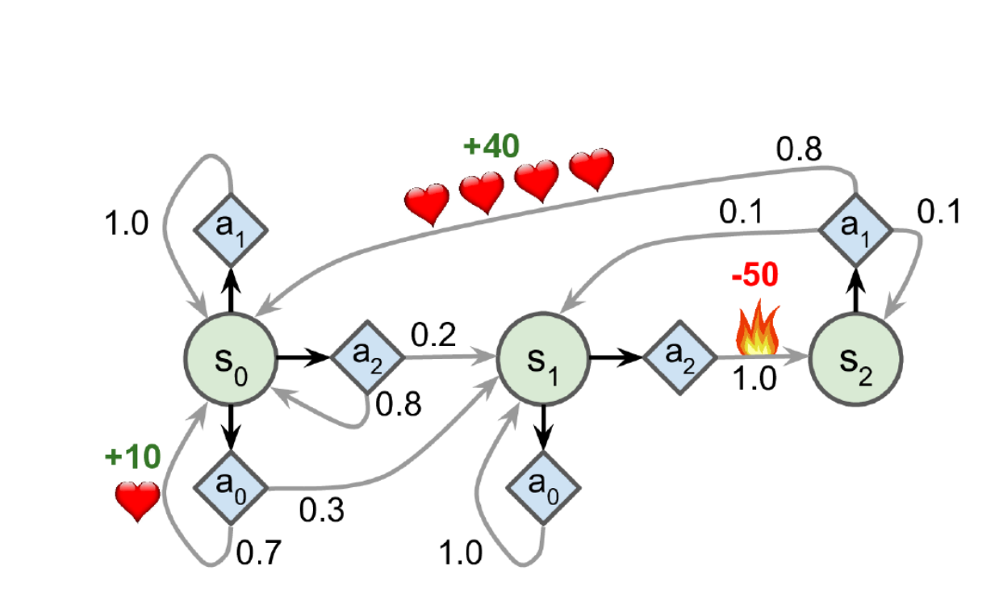

In [11]:
transition_probabilities = [ # shape=[s, a, s']
        [[0.7, 0.3, 0.0], [1.0, 0.0, 0.0], [0.8, 0.2, 0.0]],
        [[0.0, 1.0, 0.0], None, [0.0, 0.0, 1.0]],
        [None, [0.8, 0.1, 0.1], None]
]
rewards = [ # shape=[s, a, s']
        [[+10, 0, 0], [0, 0, 0], [0, 0, 0]],
        [[0, 0, 0], [0, 0, 0], [0, 0, -50]],
        [[0, 0, 0], [+40, 0, 0], [0, 0, 0]]]
possible_actions = [[0, 1, 2], [0, 2], [1]]

# Q-Value Iteration

Now we will initialize all the Q-Values to 0 (except for the the impossible actions, for which we set the Q-Values to –∞):

In [12]:
Q_values = np.full((3, 3), -np.inf) # -np.inf for impossible actions
for state, actions in enumerate(possible_actions):
    Q_values[state, actions] = 0.0  # for all possible actions

Now let's run the Q-Value Iteration algorithm:

In [14]:
gamma = 0.90  # the discount factor

history1 = [] # Not shown in the book (for the figure below)
for iteration in range(50):
    Q_prev = Q_values.copy()
    history1.append(Q_prev) # Not shown
    for s in range(3):
        for a in possible_actions[s]:
            Q_values[s, a] = np.sum([
                    transition_probabilities[s][a][sp]
                    * (rewards[s][a][sp] + gamma * np.max(Q_prev[sp]))
                for sp in range(3)])

history1 = np.array(history1) # Not shown

That’s it! The resulting Q-Values look like this:

In [15]:
Q_values

array([[18.91891892, 17.02702703, 13.62162162],
       [ 0.        ,        -inf, -4.87971488],
       [       -inf, 50.13365013,        -inf]])

For each state, let’s look at the action that has the highest Q-Value:

In [16]:
np.argmax(Q_values, axis=1)

array([0, 0, 1])

The optimal policy for this MDP, when using a discount factor of 0.90, is to choose action a0 when in state s0, and choose action a0 when in state s1, and finally choose action a1 (the only possible action) when in state s2.

Let's try again with a discount factor of 0.95:

In [ ]:
Q_values = np.full((3, 3), -np.inf) # -np.inf for impossible actions
for state, actions in enumerate(possible_actions):
    Q_values[state, actions] = 0.0  # for all possible actions

In [ ]:
gamma = 0.95  # the discount factor

for iteration in range(50):
    Q_prev = Q_values.copy()
    for s in range(3):
        for a in possible_actions[s]:
            Q_values[s, a] = np.sum([
                    transition_probabilities[s][a][sp]
                    * (rewards[s][a][sp] + gamma * np.max(Q_prev[sp]))
                for sp in range(3)])

In [ ]:
Q_values

In [ ]:
np.argmax(Q_values, axis=1)

Now the policy has changed! In state s1, we now prefer to go through the fire (choose action a2). This is because the discount factor is larger so the agent values the future more, and it is therefore ready to pay an immediate penalty in order to get more future rewards.

**Go Back to Slides**

# Q-Learning

Q-Learning works by watching an agent play (e.g., randomly) and gradually improving its estimates of the Q-Values. Once it has accurate Q-Value estimates (or close enough), then the optimal policy consists in choosing the action that has the highest Q-Value (i.e., the greedy policy).

We will need to simulate an agent moving around in the environment, so let's define a function to perform some action and get the new state and a reward:

In [ ]:
def step(state, action):
    probas = transition_probabilities[state][action]
    next_state = np.random.choice([0, 1, 2], p=probas)
    reward = rewards[state][action][next_state]
    return next_state, reward

We also need an exploration policy, which can be any policy, as long as it visits every possible state many times. We will just use a random policy, since the state space is very small:

In [ ]:
def exploration_policy(state):
    return np.random.choice(possible_actions[state])

Now let's initialize the Q-Values like earlier, and run the Q-Learning algorithm:

In [ ]:
np.random.seed(42)

Q_values = np.full((3, 3), -np.inf)
for state, actions in enumerate(possible_actions):
    Q_values[state][actions] = 0

alpha0 = 0.05 # initial learning rate
decay = 0.005 # learning rate decay
gamma = 0.90 # discount factor
state = 0 # initial state
history2 = [] # Not shown in the book

for iteration in range(10000):
    history2.append(Q_values.copy()) # Not shown
    action = exploration_policy(state)
    next_state, reward = step(state, action)
    next_value = np.max(Q_values[next_state]) # greedy policy at the next step
    alpha = alpha0 / (1 + iteration * decay)
    Q_values[state, action] *= 1 - alpha
    Q_values[state, action] += alpha * (reward + gamma * next_value)
    state = next_state

history2 = np.array(history2) # Not shown

In [ ]:
Q_values

In [ ]:
np.argmax(Q_values, axis=1) # optimal action for each state

In [ ]:
true_Q_value = history1[-1, 0, 0]

fig, axes = plt.subplots(1, 2, figsize=(10, 4), sharey=True)
axes[0].set_ylabel("Q-Value$(s_0, a_0)$", fontsize=14)
axes[0].set_title("Q-Value Iteration", fontsize=14)
axes[1].set_title("Q-Learning", fontsize=14)
for ax, width, history in zip(axes, (50, 10000), (history1, history2)):
    ax.plot([0, width], [true_Q_value, true_Q_value], "k--")
    ax.plot(np.arange(width), history[:, 0, 0], "b-", linewidth=2)
    ax.set_xlabel("Iterations", fontsize=14)
    ax.axis([0, width, 0, 24])

The Q-Value Iteration algorithm (left) converges very quickly, in fewer than 20 iterations, while the Q-Learning algorithm (right) takes about 8,000 iterations to converge. Obviously, not knowing the transition probabilities or the rewards makes finding the optimal policy significantly harder!

**Go Back to the Slides**

# Deep Q-Network

Let's build the DQN. Given a state, it will estimate, for each possible action, the sum of discounted future rewards it can expect after it plays that action (but before it sees its outcome):

In [6]:
keras.backend.clear_session()
tf.random.set_seed(42)
np.random.seed(42)

env = gym.make("CartPole-v1")
input_shape = [4] # == env.observation_space.shape
n_outputs = 2 # == env.action_space.n

model = keras.models.Sequential([
    keras.layers.Dense(32, activation="elu", input_shape=input_shape),
    keras.layers.Dense(32, activation="elu"),
    keras.layers.Dense(n_outputs)
])

To select an action using this DQN, we just pick the action with the largest predicted Q-value. However, to ensure that the agent explores the environment, we choose a random action with probability `epsilon`.

In [7]:
x = np.array([1,2,3])
x[np.newaxis] ==> [[1,2,3]]

[[5.0, 9.0, 10.0, 0.6]]

SyntaxError: invalid syntax (<ipython-input-7-016c6db08c5f>, line 2)

In [8]:
def epsilon_greedy_policy(state, epsilon=0):
    if np.random.rand() < epsilon:
        return np.random.randint(2)
    else:
        Q_values = model.predict(state[np.newaxis])
        return np.argmax(Q_values[0])

We will also need a replay memory. It will contain the agent's experiences, in the form of tuples: `(obs, action, reward, next_obs, done)`. We can use the `deque` class for that:

In [9]:
from collections import deque

replay_memory = deque(maxlen=2000)

And let's create a function to sample experiences from the replay memory. It will return 5 NumPy arrays: `[obs, actions, rewards, next_obs, dones]`.

In [10]:
def sample_experiences(batch_size):
    indices = np.random.randint(len(replay_memory), size=batch_size)
    batch = [replay_memory[index] for index in indices]
    states, actions, rewards, next_states, dones = [
        np.array([experience[field_index] for experience in batch])
        for field_index in range(5)]
    return states, actions, rewards, next_states, dones

Now we can create a function that will use the DQN to play one step, and record its experience in the replay memory:

In [11]:
def play_one_step(env, state, epsilon):
    action = epsilon_greedy_policy(state, epsilon)
    next_state, reward, done, info = env.step(action)
    replay_memory.append((state, action, reward, next_state, done))
    return next_state, reward, done, info

Lastly, let's create a function that will sample some experiences from the replay memory and perform a training step:

**Note**: the first 3 releases of the 2nd edition were missing the `reshape()` operation which converts `target_Q_values` to a column vector (this is required by the `loss_fn()`).

In [12]:
batch_size = 32
discount_rate = 0.95
optimizer = keras.optimizers.Adam(lr=1e-3)
loss_fn = keras.losses.mean_squared_error

def training_step(batch_size):
    experiences = sample_experiences(batch_size)
    states, actions, rewards, next_states, dones = experiences
    next_Q_values = model.predict(next_states)
    max_next_Q_values = np.max(next_Q_values, axis=1)
    target_Q_values = (rewards +
                       (1 - dones) * discount_rate * max_next_Q_values)
    target_Q_values = target_Q_values.reshape(-1, 1)
    
    # model.fit(states, target_Q_values)
    
    mask = tf.one_hot(actions, n_outputs)
    with tf.GradientTape() as tape:
        all_Q_values = model(states)
        Q_values = tf.reduce_sum(all_Q_values * mask, axis=1, keepdims=True)
        loss = tf.reduce_mean(loss_fn(target_Q_values, Q_values))
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

And now, let's train the model!

In [13]:
env.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

rewards = [] 
best_score = 0

**Please note:** We have set the number of episode range to 100, and step range to 50 in order to reduce the execution time during lectures. Please feel free to uncomment the original code and run it in the lab.

In [19]:
# for episode in range(600):
for episode in range(600):
    obs = env.reset()
    # for step in range(200):
    for step in range(500):
        epsilon = 0.9 #max(1 - episode / 500, 0.01)
#         epsilon = max(1 - episode / 10, 0.01)
        obs, reward, done, info = play_one_step(env, obs, epsilon)
        if done:
            break
    rewards.append(step) # Not shown in the book
    if step > best_score: # Not shown
        best_weights = model.get_weights() # Not shown
        best_score = step # Not shown
    print("\rEpisode: {}, Steps: {}, eps: {:.3f}".format(episode, step + 1, epsilon), end="") # Not shown
    if episode > 50:
        training_step(batch_size)

model.set_weights(best_weights)

Episode: 599, Steps: 12, eps: 0.9000

![cart-pole](images/cart-pole-image3.png "Cart-Pole")

As you can see, the algorithm made no apparent progress at all for almost 300 episodes. Then its performance suddenly
skyrocketed up to 200. That’s great news: the algorithm worked fine, and it actually ran much faster than the Policy Gradient algorithm!

But just a few episodes later, it forgot everything it knew, and its performance dropped below 25! This is called catastrophic forgetting, and it is one of the big problems facing virtually all RL algorithms!

Also, we didn't plot the loss since it is a poor indicator of the model’s performance. The loss might go down, yet the agent might perform worse and vice-versa.

<video controls src="videos/cart-pole-video5.mp4" />

Not bad at all!

The basic Deep Q-Learning algorithm we’ve been using so far would be too unstable to learn to play Atari games. So how did DeepMind do it? Well, they tweaked the algorithm!

**Go Back to the Slides**

## Double DQN

In [ ]:
keras.backend.clear_session()
tf.random.set_seed(42)
np.random.seed(42)

model = keras.models.Sequential([
    keras.layers.Dense(32, activation="elu", input_shape=[4]),
    keras.layers.Dense(32, activation="elu"),
    keras.layers.Dense(n_outputs)
])

target = keras.models.clone_model(model)
target.set_weights(model.get_weights())

In [ ]:
batch_size = 32
discount_rate = 0.95
optimizer = keras.optimizers.Adam(lr=1e-3)
loss_fn = keras.losses.Huber()

def training_step(batch_size):
    experiences = sample_experiences(batch_size)
    states, actions, rewards, next_states, dones = experiences
    next_Q_values = model.predict(next_states)
    best_next_actions = np.argmax(next_Q_values, axis=1)
    next_mask = tf.one_hot(best_next_actions, n_outputs).numpy()
    next_best_Q_values = (target.predict(next_states) * next_mask).sum(axis=1)
    target_Q_values = (rewards + 
                       (1 - dones) * discount_rate * next_best_Q_values)
    target_Q_values = target_Q_values.reshape(-1, 1)
    mask = tf.one_hot(actions, n_outputs)
    with tf.GradientTape() as tape:
        all_Q_values = model(states)
        Q_values = tf.reduce_sum(all_Q_values * mask, axis=1, keepdims=True)
        loss = tf.reduce_mean(loss_fn(target_Q_values, Q_values))
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

In [ ]:
replay_memory = deque(maxlen=2000)

**Please note:** We have set the number of episode range to 100, and step range to 50 in order to reduce the execution time during lectures. Please feel free to uncomment the original code and run it in the lab.

In [ ]:
env.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

rewards = []
best_score = 0

# for episode in range(600):
for episode in range(100):
    obs = env.reset()
    # for step in range(200):
    for step in range(50):
        # epsilon = max(1 - episode / 500, 0.01)
        epsilon = max(1 - episode / 10, 0.01)
        obs, reward, done, info = play_one_step(env, obs, epsilon)
        if done:
            break
    rewards.append(step)
    if step > best_score:
        best_weights = model.get_weights()
        best_score = step
    print("\rEpisode: {}, Steps: {}, eps: {:.3f}".format(episode, step + 1, epsilon), end="")
    if episode > 50:
        training_step(batch_size)
    if episode % 50 == 0:
        target.set_weights(model.get_weights())
    # Alternatively, you can do soft updates at each step:
    #if episode > 50:
        #target_weights = target.get_weights()
        #online_weights = model.get_weights()
        #for index in range(len(target_weights)):
        #    target_weights[index] = 0.99 * target_weights[index] + 0.01 * online_weights[index]
        #target.set_weights(target_weights)

model.set_weights(best_weights)

![cart-pole](images/cart-pole-image4.png "Cart-Pole")

<video controls src="videos/cart-pole-video6.mp4" />

**Go Back to the Slides**

# Dueling Double DQN

In [ ]:
keras.backend.clear_session()
tf.random.set_seed(42)
np.random.seed(42)

K = keras.backend
input_states = keras.layers.Input(shape=[4])
hidden1 = keras.layers.Dense(32, activation="elu")(input_states)
hidden2 = keras.layers.Dense(32, activation="elu")(hidden1)
state_values = keras.layers.Dense(1)(hidden2)
raw_advantages = keras.layers.Dense(n_outputs)(hidden2)
advantages = raw_advantages - K.max(raw_advantages, axis=1, keepdims=True)
Q_values = state_values + advantages
model = keras.models.Model(inputs=[input_states], outputs=[Q_values])

target = keras.models.clone_model(model)
target.set_weights(model.get_weights())

In [ ]:
batch_size = 32
discount_rate = 0.95
optimizer = keras.optimizers.Adam(lr=1e-2)
loss_fn = keras.losses.Huber()

def training_step(batch_size):
    experiences = sample_experiences(batch_size)
    states, actions, rewards, next_states, dones = experiences
    next_Q_values = model.predict(next_states)
    best_next_actions = np.argmax(next_Q_values, axis=1)
    next_mask = tf.one_hot(best_next_actions, n_outputs).numpy()
    next_best_Q_values = (target.predict(next_states) * next_mask).sum(axis=1)
    target_Q_values = (rewards + 
                       (1 - dones) * discount_rate * next_best_Q_values)
    target_Q_values = target_Q_values.reshape(-1, 1)
    mask = tf.one_hot(actions, n_outputs)
    with tf.GradientTape() as tape:
        all_Q_values = model(states)
        Q_values = tf.reduce_sum(all_Q_values * mask, axis=1, keepdims=True)
        loss = tf.reduce_mean(loss_fn(target_Q_values, Q_values))
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

In [ ]:
replay_memory = deque(maxlen=2000)

**Please note:** We have set the number of episode range to 100, and step range to 50 in order to reduce the execution time during lectures. Please feel free to uncomment the original code and run it in the lab.

In [ ]:
env.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

rewards = []
best_score = 0

# for episode in range(600):
for episode in range(100):
    obs = env.reset()
    # for step in range(200):
    for step in range(50):
        # epsilon = max(1 - episode / 500, 0.01)
        epsilon = max(1 - episode / 10, 0.01)
        obs, reward, done, info = play_one_step(env, obs, epsilon)
        if done:
            break
    rewards.append(step)
    if step > best_score:
        best_weights = model.get_weights()
        best_score = step
    print("\rEpisode: {}, Steps: {}, eps: {:.3f}".format(episode, step + 1, epsilon), end="")
    if episode > 50:
        training_step(batch_size)
    if episode % 200 == 0:
        target.set_weights(model.get_weights())

model.set_weights(best_weights)

![cart-pole](images/cart-pole-image5.png "Cart-Pole")

<video controls src="videos/cart-pole-video7.mp4" />

This looks like a pretty robust agent!

In [ ]:
env.close()

**Go Back to the Slides**

# Using TF-Agents to Beat Breakout

Let's use TF-Agents to create an agent that will learn to play Breakout. We will use the Deep Q-Learning algorithm, so you can easily compare the components with the previous implementation, but TF-Agents implements many other (and more sophisticated) algorithms!

## TF-Agents Environments

In [ ]:
tf.random.set_seed(42)
np.random.seed(42)

In [ ]:
from tf_agents.environments import suite_gym

env = suite_gym.load("Breakout-v4")
env

In [ ]:
env.gym

In [ ]:
env.seed(42)
env.reset()

In [ ]:
env.step(1) # Fire

![cart-pole](images/breakout-plot-image1.png "Cart-Pole")

In [ ]:
env.current_time_step()

## Environment Specifications

In [ ]:
env.observation_spec()

In [ ]:
env.action_spec()

In [ ]:
env.time_step_spec()

## Environment Wrappers

You can wrap a TF-Agents environments in a TF-Agents wrapper:

In [ ]:
from tf_agents.environments.wrappers import ActionRepeat

repeating_env = ActionRepeat(env, times=4)
repeating_env

In [ ]:
repeating_env.unwrapped

Here is the list of available wrappers:

In [ ]:
import tf_agents.environments.wrappers

for name in dir(tf_agents.environments.wrappers):
    obj = getattr(tf_agents.environments.wrappers, name)
    if hasattr(obj, "__base__") and issubclass(obj, tf_agents.environments.wrappers.PyEnvironmentBaseWrapper):
        print("{:27s} {}".format(name, obj.__doc__.split("\n")[0]))

`ActionClipWrapper` = Clips the actions to the action spec.

`ActionDiscretizeWrapper` = Quantizes a continuous action space to a discrete action space.

`ActionRepeat` = Repeats each action over n steps, while accumulating the rewards. In many environments, this can speed up training significantly.

`RunStats` = Records environment statistics such as the number of steps and the number of episodes.

`TimeLimit` = Interrupts the environment if it runs for longer than a maximum number of steps.

`VideoWrapper` = Records a video of the environment.

The `suite_gym.load()` function can create an env and wrap it for you, both with TF-Agents environment wrappers and Gym environment wrappers (the latter are applied first).

In [ ]:
from functools import partial
from gym.wrappers import TimeLimit

limited_repeating_env = suite_gym.load(
    "Breakout-v4",
    gym_env_wrappers=[partial(TimeLimit, max_episode_steps=10000)],
    env_wrappers=[partial(ActionRepeat, times=4)],
)

Here is the list of preprocessing steps `AtariPreprocessing` wrapper supports:

Grayscale and downsampling = Observations are converted to grayscale and downsampled.

Max pooling = The last two frames of the game are max-pooled using a 1 × 1 filter to remove the flickering.

Frame skipping = The agent only gets to see every n frames of the game (by default n = 4), and its actions are repeated for each frame, collecting all the rewards.

End on life lost = In some games, the rewards are just based on the score, so the agent gets no immediate penalty for losing a life. One solution is to end the game immediately whenever a life is lost.

In [ ]:
limited_repeating_env

Create an Atari Breakout environment, and wrap it to apply the default Atari preprocessing steps:

In [ ]:
limited_repeating_env.unwrapped

In [ ]:
from tf_agents.environments import suite_atari
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4

max_episode_steps = 27000 # <=> 108k ALE frames since 1 step = 4 frames
environment_name = "BreakoutNoFrameskip-v4"

env = suite_atari.load(
    environment_name,
    max_episode_steps=max_episode_steps,
    gym_env_wrappers=[AtariPreprocessing, FrameStack4])

In [ ]:
env

Play a few steps just to see what happens:

In [ ]:
env.seed(42)
env.reset()
time_step = env.step(1) # FIRE
for _ in range(4):
    time_step = env.step(3) # LEFT

In [ ]:
def plot_observation(obs):
    # Since there are only 3 color channels, you cannot display 4 frames
    # with one primary color per frame. So this code computes the delta between
    # the current frame and the mean of the other frames, and it adds this delta
    # to the red and blue channels to get a pink color for the current frame.
    obs = obs.astype(np.float32)
    img = obs[..., :3]
    current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
    img[..., 0] += current_frame_delta
    img[..., 2] += current_frame_delta
    img = np.clip(img / 150, 0, 1)
    plt.imshow(img)
    plt.axis("off")

![cart-pole](images/breakout-plot-image2.png "Cart-Pole")

From this single observation, the agent can see that the ball is going toward the lower-left corner, and that it should continue to move the paddle to the left.

Convert the Python environment to a TF environment:

In [ ]:
from tf_agents.environments.tf_py_environment import TFPyEnvironment

tf_env = TFPyEnvironment(env)

**Go Back to the Slides**

## Creating the DQN

Create a small class to normalize the observations. Images are stored using bytes from 0 to 255 to use less RAM, but we want to pass floats from 0.0 to 1.0 to the neural network:

Create the Q-Network:

This QNetwork takes an observation as input and outputs one Q-Value per action, so we must give it the specifications of the observations and the actions.

In [ ]:
from tf_agents.networks.q_network import QNetwork

# Casts the observations to 32-bit floats and normalizes them (the values will range from 0.0 to 1.0)
preprocessing_layer = keras.layers.Lambda(
                          lambda obs: tf.cast(obs, np.float32) / 255.)

# Encoding network will optionally apply a list of convolutions sequentially
# provided you specify their parameters via the next layer
conv_layer_params=[(32, (8, 8), 4), (64, (4, 4), 2), (64, (3, 3), 1)]

# After these convolutional layers, the encoding network will optionally apply
# a sequence of dense layers, if you set the next layer fc_layer_params argument
fc_layer_params=[512]

q_net = QNetwork(
    tf_env.observation_spec(),
    tf_env.action_spec(),
    preprocessing_layers=preprocessing_layer,
    conv_layer_params=conv_layer_params,
    fc_layer_params=fc_layer_params)

![cart-pole](images/encoding-network.png "Cart-Pole")

Create the DQN Agent:

In [ ]:
from tf_agents.agents.dqn.dqn_agent import DqnAgent

# see TF-agents issue #113
#optimizer = keras.optimizers.RMSprop(lr=2.5e-4, rho=0.95, momentum=0.0,
#                                     epsilon=0.00001, centered=True)

train_step = tf.Variable(0)
update_period = 4 # run a training step every 4 collect steps
optimizer = tf.compat.v1.train.RMSPropOptimizer(learning_rate=2.5e-4, decay=0.95, momentum=0.0,
                                     epsilon=0.00001, centered=True)

# Compute the ε value for the ε-greedy collect policy, given the current training step
epsilon_fn = keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=1.0, # initial ε
    decay_steps=250000 // update_period, # <=> 1,000,000 ALE frames
    end_learning_rate=0.01) # final ε
agent = DqnAgent(tf_env.time_step_spec(),
                 tf_env.action_spec(),
                 q_network=q_net,
                 optimizer=optimizer,
                 target_update_period=2000, # <=> 32,000 ALE frames
                 td_errors_loss_fn=keras.losses.Huber(reduction="none"),
                 gamma=0.99, # discount factor
                 train_step_counter=train_step,
                 epsilon_greedy=lambda: epsilon_fn(train_step))
agent.initialize()

The TF-Agents library provides various replay buffer implementations in the `tf_agents.replay_buffers` package. We will use the `TFUniformReplayBuffer` class in the `tf_agents.replay_buffers.tf_uniform_replay_buffer` package. It provides a high-performance implementation of a replay buffer with uniform sampling:

**Plase note:** We have changed the buffer size to 1000 to suit our environment.

In [ ]:
from tf_agents.replay_buffers import tf_uniform_replay_buffer

replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
    # Specification of the data that will be saved in the replay buffer
    data_spec=agent.collect_data_spec,
    # Number of trajectories that will be added at each step
    batch_size=tf_env.batch_size,
    # The maximum size of the replay buffer
    # max_length=1000000
    max_length=1000)

replay_buffer_observer = replay_buffer.add_batch

Create a simple custom observer that counts and displays the number of times it is called (except when it is passed a trajectory that represents the boundary between two episodes, as this does not count as a step):

In [ ]:
class ShowProgress:
    def __init__(self, total):
        self.counter = 0
        self.total = total
    def __call__(self, trajectory):
        if not trajectory.is_boundary():
            self.counter += 1
        if self.counter % 100 == 0:
            print("\r{}/{}".format(self.counter, self.total), end="")

TF-Agents implements several RL metrics in the `tf_agents.metrics` package, some purely in Python and some based on TensorFlow. Let's add some training metrics:

In [ ]:
from tf_agents.metrics import tf_metrics

train_metrics = [
    tf_metrics.NumberOfEpisodes(),
    tf_metrics.EnvironmentSteps(),
    tf_metrics.AverageReturnMetric(),
    tf_metrics.AverageEpisodeLengthMetric(),
]

In [ ]:
train_metrics[0].result()

In [ ]:
from tf_agents.eval.metric_utils import log_metrics
import logging
logging.getLogger().setLevel(logging.INFO)
log_metrics(train_metrics)

Create the collect driver:

In [ ]:
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver

collect_driver = DynamicStepDriver(
    tf_env,
    agent.collect_policy,
    observers=[replay_buffer_observer] + train_metrics,
    num_steps=update_period) # collect 4 steps for each training iteration

There are two main driver classes: `DynamicStepDriver` and `DynamicEpisodeDriver`. The first one collects experiences for a given number of steps, while the second collects experiences for a given number of episodes. We want to collect experiences for four steps for each training iteration (as was done in the 2015 DQN paper), so let’s create a `DynamicStepDriver` and collect the initial experiences, before training:

**Please note:** We have changed the number of steps.

In [ ]:
from tf_agents.policies.random_tf_policy import RandomTFPolicy

initial_collect_policy = RandomTFPolicy(tf_env.time_step_spec(),
                                        tf_env.action_spec())
init_driver = DynamicStepDriver(
    tf_env,
    initial_collect_policy,
    observers=[replay_buffer.add_batch, ShowProgress(20000)],
    num_steps=2000)
    # num_steps=20000) # <=> 80,000 ALE frames
final_time_step, final_policy_state = init_driver.run()

The following code will sample a small batch of two trajectories (subepisodes), each containing three consecutive steps. Let's sample 2 sub-episodes, with 3 time steps each and display them:

In [ ]:
tf.random.set_seed(888) # chosen to show an example of trajectory at the end of an episode

trajectories, buffer_info = replay_buffer.get_next(
    sample_batch_size=2, num_steps=3)

In [ ]:
trajectories._fields

In [ ]:
trajectories.observation.shape

In [ ]:
from tf_agents.trajectories.trajectory import to_transition

time_steps, action_steps, next_time_steps = to_transition(trajectories)
time_steps.observation.shape

In [ ]:
trajectories.step_type.numpy()

In [ ]:
plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        plot_observation(trajectories.observation[row, col].numpy())
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()

Each trajectory is a concise representation of a sequence of consecutive time steps and action steps, designed to avoid redundancy.

![cart-pole](images/trajectories.png "Cart-Pole")

Now let's create the dataset:

In [ ]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=2,
    num_parallel_calls=3).prefetch(3)

Convert the main functions to TF Functions for better performance:

In [ ]:
from tf_agents.utils.common import function

collect_driver.run = function(collect_driver.run)
agent.train = function(agent.train)

And now we are ready to run the main loop!

In [ ]:
def train_agent(n_iterations):
    time_step = None
    policy_state = agent.collect_policy.get_initial_state(tf_env.batch_size)
    iterator = iter(dataset)
    for iteration in range(n_iterations):
        time_step, policy_state = collect_driver.run(time_step, policy_state)
        trajectories, buffer_info = next(iterator)
        train_loss = agent.train(trajectories)
        print("\r{} loss:{:.5f}".format(
            iteration, train_loss.loss.numpy()), end="")
        if iteration % 1000 == 0:
            log_metrics(train_metrics)

Run the next cell to train the agent for 10,000 steps. Then look at its behavior by running the following cell. You can run these two cells as many times as you wish. The agent will keep improving!

**Please note:** We have changed the number of iterations.

In [ ]:
# train_agent(n_iterations=10000)
train_agent(n_iterations=100)

In [ ]:
frames = []
def save_frames(trajectory):
    global frames
    frames.append(tf_env.pyenv.envs[0].render(mode="rgb_array"))

prev_lives = tf_env.pyenv.envs[0].ale.lives()
def reset_and_fire_on_life_lost(trajectory):
    global prev_lives
    lives = tf_env.pyenv.envs[0].ale.lives()
    if prev_lives != lives:
        tf_env.reset()
        tf_env.pyenv.envs[0].step(1)
        prev_lives = lives

watch_driver = DynamicStepDriver(
    tf_env,
    agent.policy,
    observers=[save_frames, reset_and_fire_on_life_lost, ShowProgress(1000)],
    num_steps=1000)
final_time_step, final_policy_state = watch_driver.run()

<video controls src="videos/breakout-plot-video1.mp4" />

**Go Back to the Slides**